# Future Sales Prediction: Russian Market


Check data folder

In [1]:
# always start with checking out the files!
!ls /home/bapanes/Data/kaggle/Future_Sales/input/*

/home/bapanes/Data/kaggle/Future_Sales/input/item_categories.csv
/home/bapanes/Data/kaggle/Future_Sales/input/items.csv
/home/bapanes/Data/kaggle/Future_Sales/input/sales_train.csv.gz
/home/bapanes/Data/kaggle/Future_Sales/input/sales_train_v2.csv
/home/bapanes/Data/kaggle/Future_Sales/input/sample_submission.csv
/home/bapanes/Data/kaggle/Future_Sales/input/sample_submission.csv.gz
/home/bapanes/Data/kaggle/Future_Sales/input/shops.csv
/home/bapanes/Data/kaggle/Future_Sales/input/test.csv
/home/bapanes/Data/kaggle/Future_Sales/input/test.csv.gz


# keras and Tensorflow are required

For the installation of these packages you can follow

http://inmachineswetrust.com/posts/deep-learning-setup/
    
which is working in ubuntu 16.04 and Anaconda (Anaconda3-2018.12-Linux-x86_64.sh)

In [2]:
import os
import math
import time
import shutil

# Basic packages
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import random as rd # generating random numbers
import datetime # manipulating date formats
# Viz
import matplotlib.pyplot as plt # basic plotting
import seaborn as sns # for prettier plots


# TIME SERIES
#from statsmodels.tsa.arima_model import ARIMA
#from statsmodels.tsa.statespace.sarimax import SARIMAX
from pandas.plotting import autocorrelation_plot

#from statsmodels.tsa.stattools import adfuller, acf, pacf,arma_order_select_ic
#import statsmodels.formula.api as smf
#import statsmodels.tsa.api as smt
#import statsmodels.api as sm
import scipy.stats as scs

import datetime as dt

from numpy import newaxis
from keras.layers import Dense, Activation, Dropout, LSTM
from keras.models import Sequential, load_model
from keras.callbacks import EarlyStopping, ModelCheckpoint

import matplotlib.pyplot as plt


# settings
import warnings
warnings.filterwarnings("ignore")

from tqdm import tqdm_notebook, tnrange

from statsmodels.tsa.holtwinters import Holt
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_squared_error

Using TensorFlow backend.


# Import all data using pandas  


In [3]:
FOLDER_DATA = "/home/bapanes/Data/kaggle/Future_Sales/input/"

# Import all data inmediately  
sales=pd.read_csv(FOLDER_DATA + "sales_train_v2.csv")

# settings
import warnings
warnings.filterwarnings("ignore")

item_cat=pd.read_csv(FOLDER_DATA + "item_categories.csv")
item=pd.read_csv(FOLDER_DATA + "items.csv")
sub=pd.read_csv(FOLDER_DATA + "sample_submission.csv")
shops=pd.read_csv(FOLDER_DATA + "shops.csv")
test=pd.read_csv(FOLDER_DATA + "test.csv")

In [4]:
sales.head()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
0,02.01.2013,0,59,22154,999.00,1.0
1,03.01.2013,0,25,2552,899.00,1.0
2,05.01.2013,0,25,2552,899.00,-1.0
3,06.01.2013,0,25,2554,1709.05,1.0
4,15.01.2013,0,25,2555,1099.00,1.0


In [5]:
item.head()

,item_name,item_id,item_category_id
0,! ВО ВЛАСТИ НАВАЖДЕНИЯ (ПЛАСТ.) D,0,40
1,!ABBYY FineReader 12 Professional Edition Full...,1,76
2,***В ЛУЧАХ СЛАВЫ (UNV) D,2,40
3,***ГОЛУБАЯ ВОЛНА (Univ) D,3,40
4,***КОРОБКА (СТЕКЛО) D,4,40


In [6]:
item_cat.head()

,item_category_name,item_category_id
0,PC - Гарнитуры/Наушники,0
1,Аксессуары - PS2,1
2,Аксессуары - PS3,2
3,Аксессуары - PS4,3
4,Аксессуары - PSP,4


In [7]:
test.head()

,ID,shop_id,item_id
0,0,5,5037
1,1,5,5320
2,2,5,5233
3,3,5,5232
4,4,5,5268


# Formatting the date column propertly

In [8]:
sales.date=sales.date.apply(lambda x:datetime.datetime.strptime(x, '%d.%m.%Y'))
# check
print(sales.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2935849 entries, 0 to 2935848
Data columns (total 6 columns):
date              datetime64[ns]
date_block_num    int64
shop_id           int64
item_id           int64
item_price        float64
item_cnt_day      float64
dtypes: datetime64[ns](1), float64(2), int64(3)
memory usage: 134.4 MB
None


In [9]:
sales.head()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
0,2013-01-02,0,59,22154,999.00,1.0
1,2013-01-03,0,25,2552,899.00,1.0
2,2013-01-05,0,25,2552,899.00,-1.0
3,2013-01-06,0,25,2554,1709.05,1.0
4,2013-01-15,0,25,2555,1099.00,1.0


In [10]:
sales.tail()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
2935844,2015-10-10,33,25,7409,299.0,1.0
2935845,2015-10-09,33,25,7460,299.0,1.0
2935846,2015-10-14,33,25,7459,349.0,1.0
2935847,2015-10-22,33,25,7440,299.0,1.0
2935848,2015-10-03,33,25,7460,299.0,1.0


# Some numbers to take into account

In [11]:
amount_of_nodes_test = len(test)
amount_of_nodes_test

214200

In [12]:
total_number_of_sales = sales['item_cnt_day'].sum()
total_number_of_sales

3648206.0

In [13]:
total_number_of_sales/amount_of_nodes_test

17.031774042950513

So, we have around 10 sales for each node along 33 months. This is less than one sale for each month. With this satatistics seems difficult to have some level of prediction based on the information for each node only. Therefore we choose to group by some other variable, for instance the item_category_id

In [14]:
sales_extd = sales.join(item, on='item_id', rsuffix='_').join(item_cat, on='item_category_id', rsuffix='_').drop(['item_id_', 'item_category_id_', 'item_name', 'item_category_name'], axis=1)    
sales_extd_sort_by_item_category = sales_extd.sort_values('item_category_id')
sales_extd_sort_by_item_category.head()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id
5558,2013-01-10,0,25,16257,148.0,1.0,0
439377,2013-04-02,3,38,16256,22.4,1.0,0
182616,2013-02-28,1,0,16255,93.0,1.0,0
112968,2013-01-10,0,45,5606,148.0,1.0,1
181531,2013-02-20,1,0,5740,283.0,1.0,1


In [15]:
number_of_cats_unique_in_sales = len(sales_extd_sort_by_item_category.item_category_id.value_counts())
number_of_cats_unique_in_sales

84

In [31]:
test_extd = test.join(item, on='item_id', rsuffix='_').join(item_cat, on='item_category_id', rsuffix='_').drop(['item_id_', 'item_category_id_', 'item_name', 'item_category_name'], axis=1)    
test_extd_sort_by_item_category = test_extd.sort_values('item_category_id')
test_extd_sort_by_item_category.head()

,ID,shop_id,item_id,item_category_id
156514,156514,55,5441,0
100414,100414,19,5441,0
49414,49414,31,5441,0
105514,105514,42,5441,0
13714,13714,6,5441,0


In [17]:
number_of_cats_unique_in_test = len(test_extd_sort_by_item_category.item_category_id.value_counts())
number_of_cats_unique_in_test

62

In [18]:
sales_per_category = total_number_of_sales/number_of_cats_unique_in_test/33
sales_per_category

1783.0918866080156

In [38]:
test_extd_sort_by_item_category.shape

(214200, 4)

In [36]:
test_extd_sort_by_item_category.iloc[0,2]

5441

In [30]:
test_extd.head()

,ID,shop_id,item_id,item_category_id
0,0,5,5037,19
1,1,5,5320,55
2,2,5,5233,19
3,3,5,5232,23
4,4,5,5268,20


So, we see that in average we have 1000s sales per category per month. This indicates that at the category level we have much more statistics. However, we still have to check the distribution of measurements per category, in order to extend this average feeling

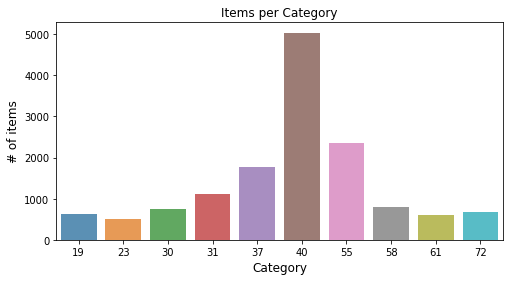

In [39]:
x=item.groupby(['item_category_id']).count()
x=x.sort_values(by='item_id',ascending=False)
x=x.iloc[0:10].reset_index()

#plot
plt.figure(figsize=(8,4))
ax= sns.barplot(x.item_category_id, x.item_id, alpha=0.8)
plt.title("Items per Category")
plt.ylabel('# of items', fontsize=12)
plt.xlabel('Category', fontsize=12)
plt.show()

We can see that there are categories with vastly different amount of items, which implies that the sales are going to be distributed in a similar way, as we will see in the print of item_category_id time series for item_cnt_day.sum

### So, we decide to predict the number of sales per item_category_id

This prediction can be done with different methods. In general, we should consider the time-series for each item category id in order to compute these predictions

In [49]:
sales_extd = sales.join(item, on = 'item_id', rsuffix='_').join(item_cat, on = 'item_category_id', rsuffix = "_").drop(['item_name','item_id_','item_category_id_'], axis =1)
sales_extd.tail()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id,item_category_name
2935844,2015-10-10,33,25,7409,299.0,1.0,55,Музыка - CD локального производства
2935845,2015-10-09,33,25,7460,299.0,1.0,55,Музыка - CD локального производства
2935846,2015-10-14,33,25,7459,349.0,1.0,55,Музыка - CD локального производства
2935847,2015-10-22,33,25,7440,299.0,1.0,57,Музыка - MP3
2935848,2015-10-03,33,25,7460,299.0,1.0,55,Музыка - CD локального производства


In [50]:
# Let's pivot the above dataset to get a monthly time series:
sales_by_cat = sales_extd.pivot_table(index=['item_category_id'], values = ['item_cnt_day'], columns=['date_block_num'], 
                     aggfunc = np.sum, fill_value = 0 ).reset_index()
sales_by_cat.columns = sales_by_cat.columns.droplevel().map(str)
sales_by_cat = sales_by_cat.reset_index(drop=True).rename_axis(None, axis=1)
sales_by_cat.columns.values[0]= 'item_category_id'
sales_by_cat

,item_category_id,0,1,2,3,4,5,6,7,8,...,24,25,26,27,28,29,30,31,32,33
0,0,1,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1390,1190,1025,646,596,667,618,674,792,...,370,307,229,170,146,104,114,132,89,82
3,3,440,302,293,202,146,150,233,300,383,...,1398,834,773,746,667,559,603,975,1090,1059
4,4,251,220,226,160,175,176,179,140,86,...,10,2,2,2,2,1,0,1,0,0
5,5,623,358,354,275,281,329,355,299,289,...,178,85,88,67,44,51,48,45,31,44
6,6,870,668,646,465,441,502,622,637,729,...,700,400,334,266,274,319,243,277,237,242
7,7,0,0,0,0,0,0,0,0,0,...,639,220,269,244,217,238,178,307,244,205
8,8,0,0,0,0,0,0,0,0,0,...,0,0,0,45,147,117,193,483,5128,-1
9,9,149,159,211,138,95,124,83,124,141,...,467,480,492,1003,2005,528,513,276,816,2524


In [42]:
months_array = np.array(['Jan', 'Feb','Mar','Apr','May','Jun','Jul','Ago','Sep','Oct','Nov','Dec','Jan', 'Feb','Mar','Apr','May','Jun','Jul','Ago','Sep','Oct','Nov','Dec','Jan', 'Feb','Mar','Apr','May','Jun','Jul','Ago','Sep','Oct','Nov','Dec'])
months_array

array(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Ago', 'Sep',
       'Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
       'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar',
       'Apr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dec'],
      dtype='<U3')

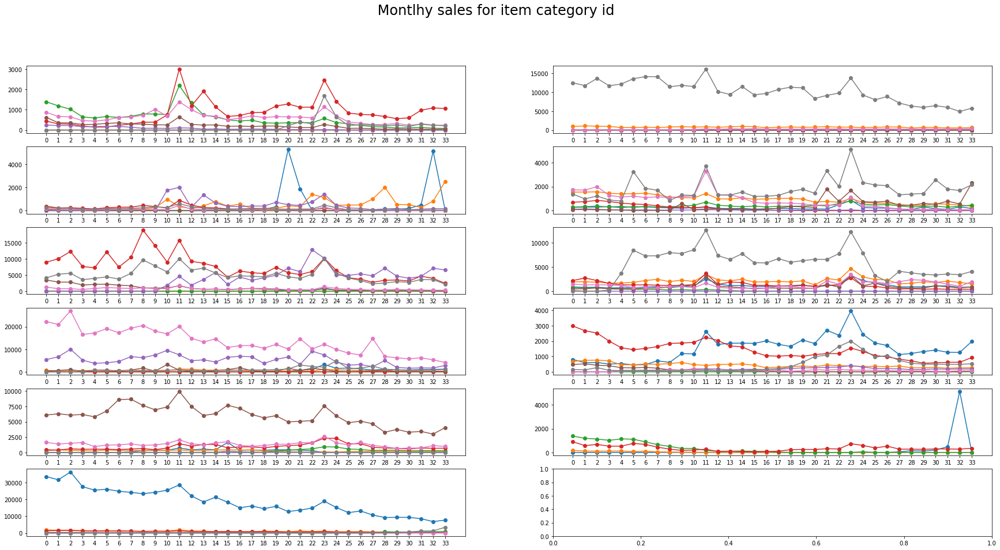

In [43]:
fig, ax = plt.subplots(6,2,figsize = (30,15))
ax[0][0].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[:8,1:].T, 'o-')
ax[1][0].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[8:16,1:].T, 'o-')
ax[2][0].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[16:24,1:].T, 'o-')
ax[3][0].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[24:32,1:].T, 'o-')
ax[4][0].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[32:40,1:].T, 'o-')
ax[5][0].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[40:48,1:].T, 'o-')
ax[0][1].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[48:56,1:].T, 'o-')
ax[1][1].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[56:64,1:].T, 'o-')
ax[2][1].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[64:72,1:].T, 'o-')
ax[3][1].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[72:80,1:].T, 'o-')
ax[4][1].plot(sales_by_cat.columns[1:], sales_by_cat.iloc[80:,1:].T, 'o-')

fig.suptitle(' Montlhy sales for item category id', fontsize = 24)  

plt.show()

In [44]:
months_array[34]

'Nov'

From the behavior of these categories we are going to start with a model that just considers that the prediction of the sales for the next month is equal to the sales of the previous one. Basically, we are assuming that during Novemmber (34th month is November) no big changes are seen in the plot of different categories. 

Anyway, it can be seen that for some categories November is the peak month for sales, thus we agree that this prediction can be improved later to better estimate the November prediction

# Routines to create the time series

In [45]:
months_array

array(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Ago', 'Sep',
       'Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
       'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dec', 'Jan', 'Feb', 'Mar',
       'Apr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dec'],
      dtype='<U3')

In [46]:
months_array[34]

'Nov'

In [47]:
months_array[22]

'Nov'

In [396]:
def sales_ts_catID(prod_cat, sales_by_cat): 
    
    #reduced df filtering by product_category 
    monthly_sales = sales_by_cat[(sales_by_cat.item_category_id == prod_cat)].drop(['item_category_id'],axis=1)

    #reset of months lables
    dates = pd.date_range(start = '2013-01-01',end='2015-10-01', freq = 'MS')
    
    time_series_cat = pd.DataFrame({"node_tot_cnt":[0]*dates.shape[0]},columns=["node_tot_cnt"])
    
    nmonths = monthly_sales.shape[1]
    
    for con in range(nmonths): 
        time_series_cat.iloc[con,0] = monthly_sales.iloc[0,con]

    return time_series_cat


#Multiple Model Prediction uses prod_cat and ntrain

def Multiple_Model_Prediction(sales_by_cat, prod_cat, ntrain, method):
    
    df = sales_ts_catID(prod_cat, sales_by_cat)
    
    total_elements = df.shape[0]
    
    series_full = df.iloc[:total_elements, 0].copy()
    
    series_train_basis = df.iloc[:ntrain,0].copy()
    series_test_basis = df.iloc[ntrain:,0].copy()
    
    #now, we have to chose the train and test series prediction initializers
    
    series_train_pred = df.iloc[:ntrain,0].copy()
    series_test_pred  = df.iloc[ntrain:,0].copy()
        
    if (method == 0):
        series_train_pred, series_test_pred = Naive_Prediction(df,ntrain)
        method_name = 'Naive'
       
    if (method == 1):
        series_train_pred, series_test_pred =  Exponential_Smoothing_Plus_Seasonal_Prediction(df, 10, ntrain)  
        method_name = 'Holt'
        
    error = measure_rmse(series_test_basis, series_test_pred)    
        
    plt.plot(series_full.index, series_full, label='Original Series')
    plt.plot(series_train_pred.index, series_train_pred, label= method_name + ' train pred')
    plt.plot(series_test_pred.index, series_test_pred, label= method_name + ' test pred')
        
    plt.legend(loc='best')
    
    plt.title('Item category id:' + str(prod_cat))
    plt.show()
    
    return error

#Our exponential plus Seasonal function just returns the train and test predicted series
#to ensure the good performance of the predictor we add the parameter delta in order to ensure
#that only possitive values are going to be considered to use df

def Exponential_Smoothing_Plus_Seasonal_Prediction(df, delta, ntrain):

    train = df.iloc[:ntrain,0] + delta
    test  = df.iloc[ntrain:,0] + delta
    
    index_last_test_value = test.index[-1]
    
    train.index.freq = 'MS'
        
    model = ExponentialSmoothing(train, seasonal='mul', seasonal_periods=12).fit()
        
    #the start of the prediction is the array index to be predicted. the last month
    #of our input has index = 33 (k-1) therefore, the solution to our problem is the prediction at k=34
    #we predict two more months to see the tendency
    #if we predict from k-1 to k+1 we can join the previous ts at index=k-1=33 and still
    #the solution to our problem would be for k=34 (index magic, check please)
        
    pred_series_train = model.predict(start=0, end=ntrain-1) - delta   
    pred_series_test = model.predict(start=ntrain, end=index_last_test_value) - delta
            
    return pred_series_train, pred_series_test


def Naive_Prediction(df, ntrain):
    
    total_elements = df.shape[0]  
        
    series_full = df.iloc[:,0].copy()    
    
    pred_series_train = df.iloc[:ntrain,0].copy()
    pred_series_test = df.iloc[ntrain:,0].copy()
    
    for con in range(1,ntrain):
        pred_series_train[con] = series_full[con-1]
        
    for con in range(ntrain,total_elements):
        pred_series_test[con] = series_full[con-1]
    
    #print(series_full)
    #print(pred_series_train)
    #print(pred_series_test)
    
    return pred_series_train, pred_series_test


#Averaged over test point error of predictions 
def measure_rmse(actual, predicted):
    
    rmse = np.average(abs(actual - predicted)**2)
    
    #print(actual, predicted, math.sqrt(rmse))
    return math.sqrt(rmse)

In [341]:
class Timer():

    def __init__(self):
        self.start_dt = None

    def start(self):
        self.start_dt = dt.datetime.now()

    def stop(self):
        end_dt = dt.datetime.now()
        print('Time taken: %s' % (end_dt - self.start_dt))

In [342]:
test_extd_sort_by_item_category.tail()

,ID,shop_id,item_id,item_category_id
31189,31189,10,22091,83
117888,117888,53,22088,83
117889,117889,53,22091,83
41389,41389,28,22091,83
153589,153589,55,22091,83


In [344]:
sales_by_cat.head()

,item_category_id,0,1,2,3,4,5,6,7,8,...,24,25,26,27,28,29,30,31,32,33
0,0,1,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1390,1190,1025,646,596,667,618,674,792,...,370,307,229,170,146,104,114,132,89,82
3,3,440,302,293,202,146,150,233,300,383,...,1398,834,773,746,667,559,603,975,1090,1059
4,4,251,220,226,160,175,176,179,140,86,...,10,2,2,2,2,1,0,1,0,0


# Run over categories to test the models

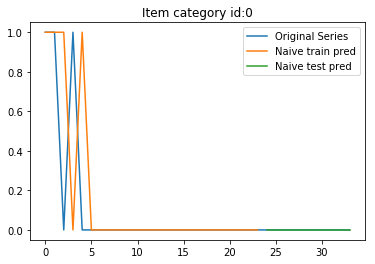

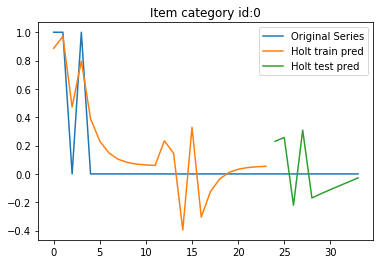

24 0 0.0 0.18300666352644993


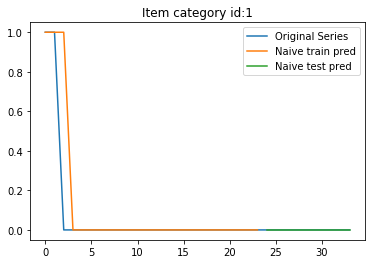

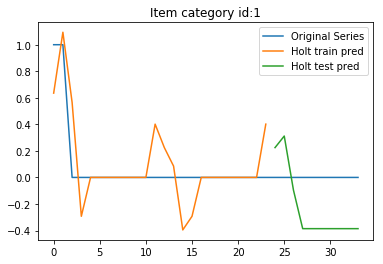

24 1 0.0 0.3463584749544121


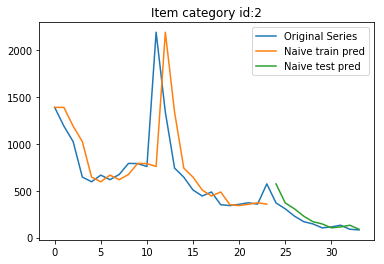

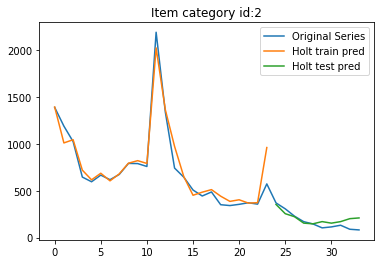

24 2 77.07463914933368 63.1673005340713


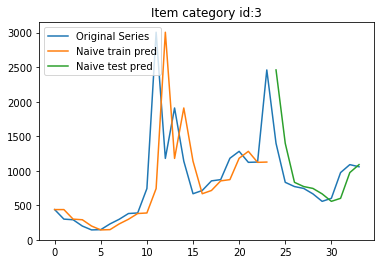

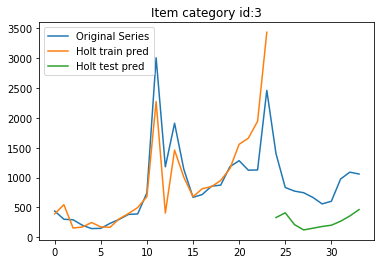

24 3 402.57645236650393 630.9513286079788


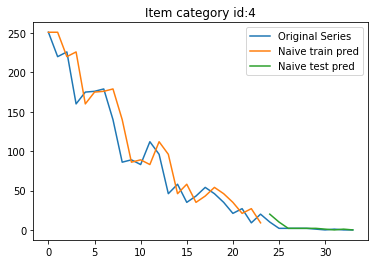

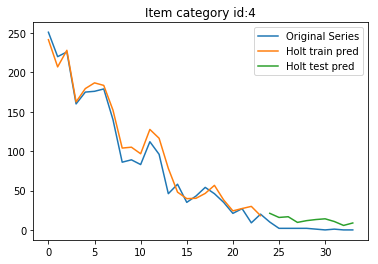

24 4 4.09878030638384 11.113021905059819


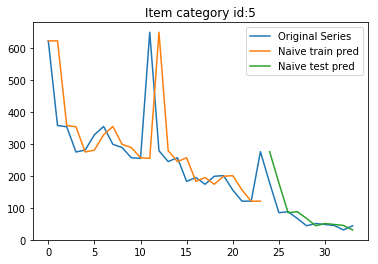

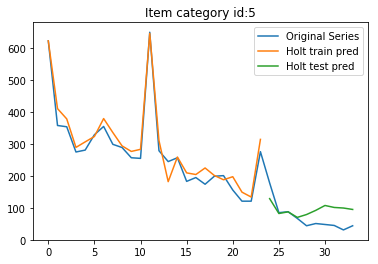

24 5 44.34410896612987 44.028159600850515


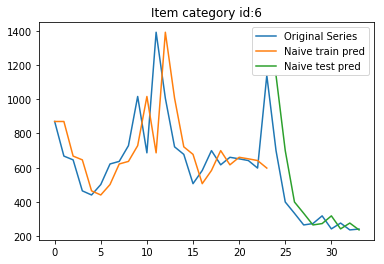

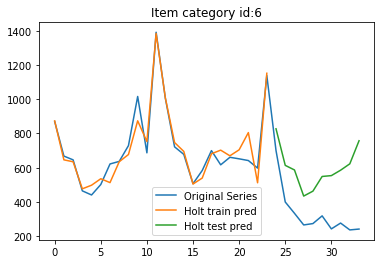

24 6 173.8812813387341 291.4926007037477


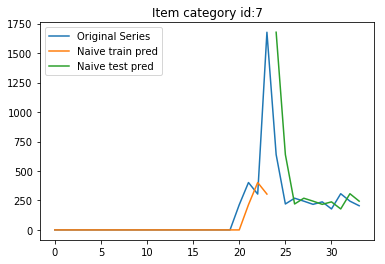

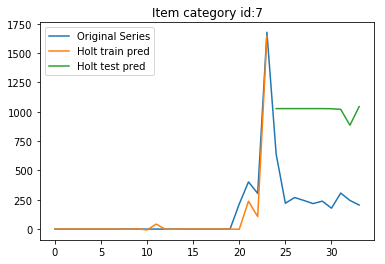

24 7 358.18040147389416 748.615061135075


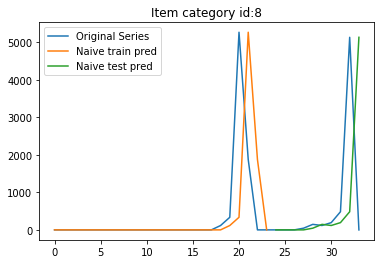

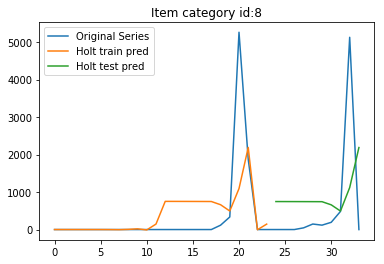

24 8 2190.567757454674 1548.7117521314037


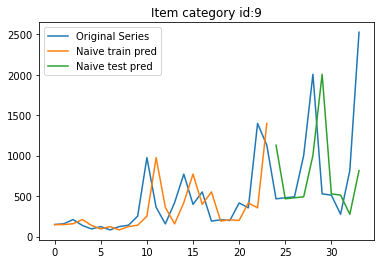

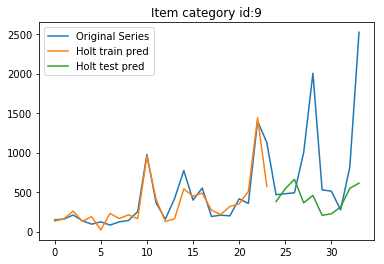

24 9 845.604458361 821.3968009878993


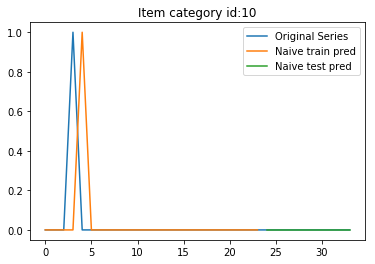

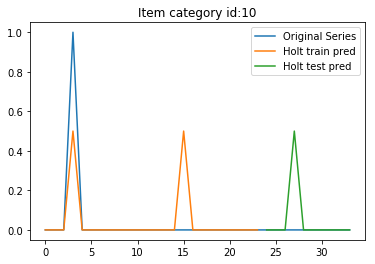

24 10 0.0 0.15811386196994037


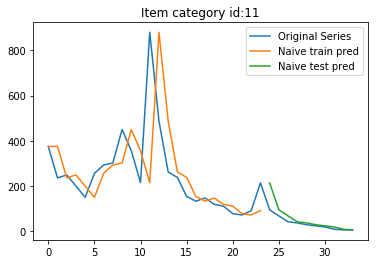

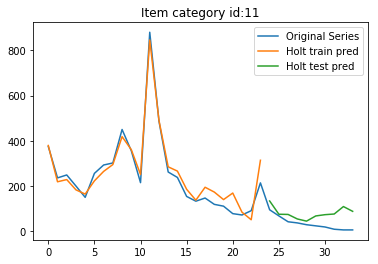

24 11 39.766820340580416 54.77062801437719


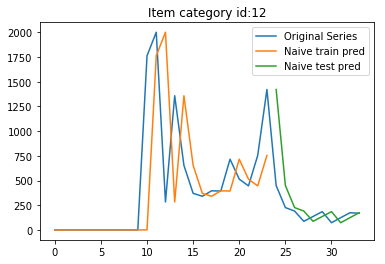

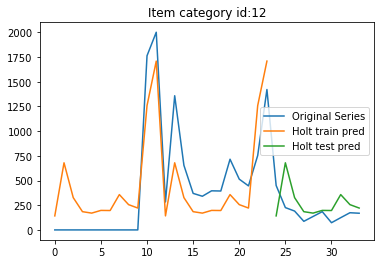

24 12 320.8540166493167 202.35814011442844


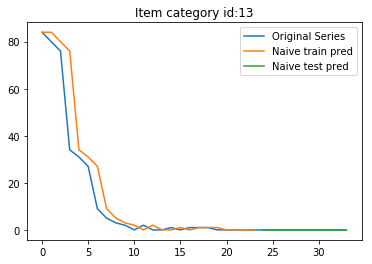

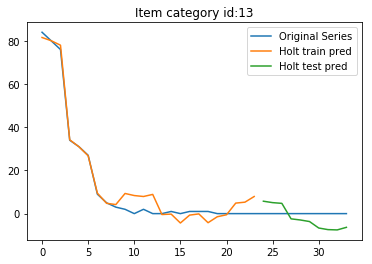

24 13 0.0 5.533622491888069


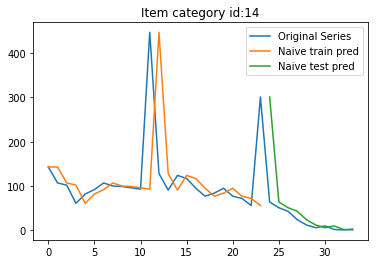

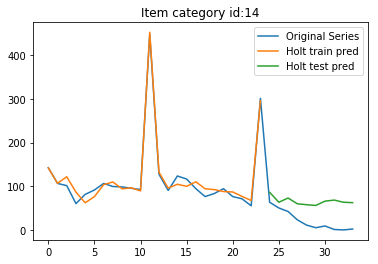

24 14 75.51688552899941 47.962411834251526


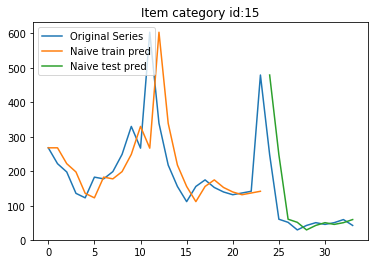

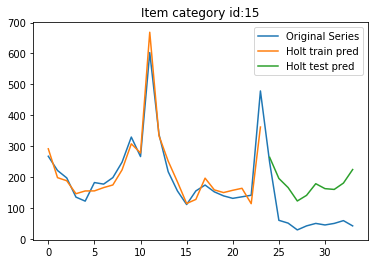

24 15 94.62980502991644 118.48943031881056


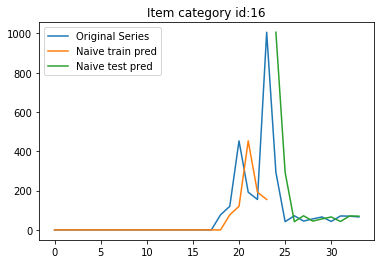

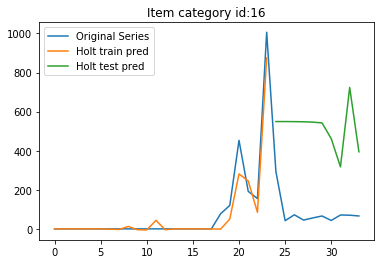

24 16 239.6977263137888 451.7023049745767


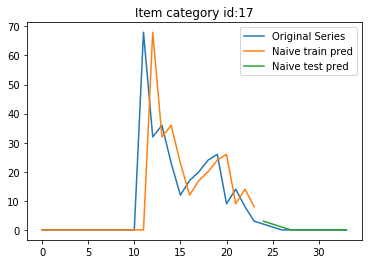

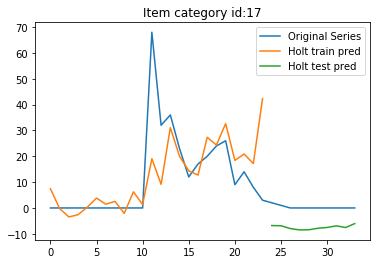

24 17 0.5477225575051661 7.794320011739402


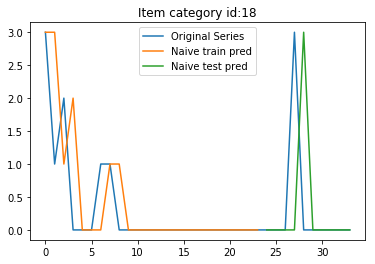

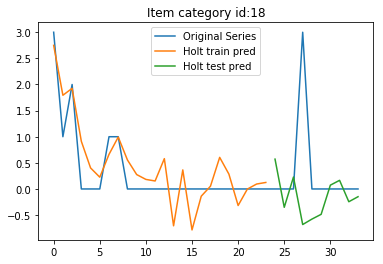

24 18 1.3416407864998738 1.2138244745727857


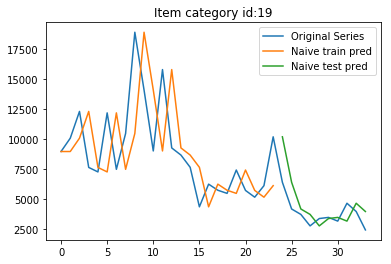

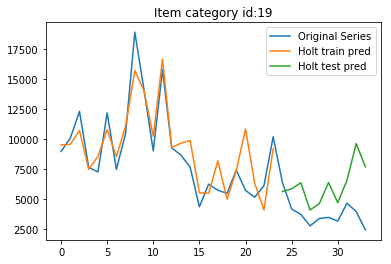

24 19 1612.9317716506175 2963.6585971536424


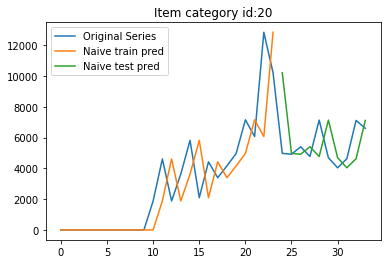

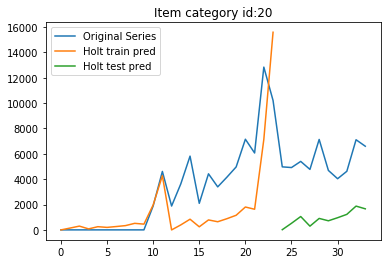

24 20 2163.6639526506883 4583.006384384945


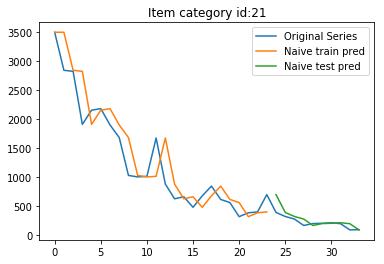

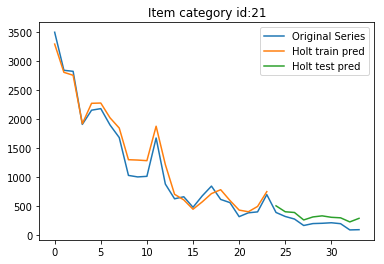

24 21 112.33120670588383 121.0832815528937


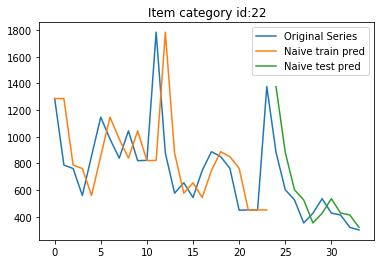

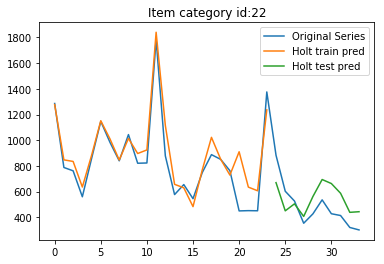

24 22 198.80492951634776 153.09649212147406


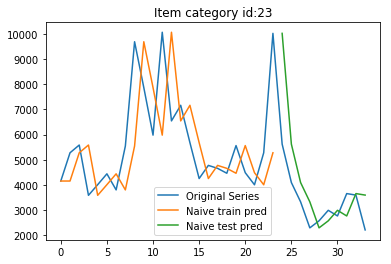

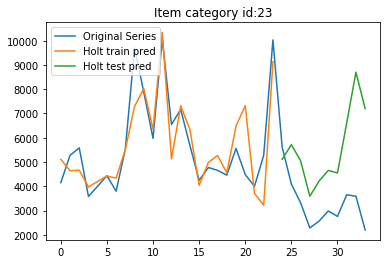

24 23 1627.7941208887567 2760.1154228344994


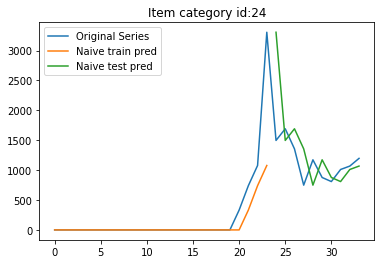

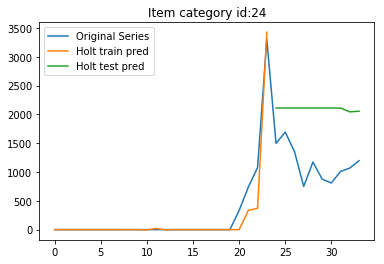

24 24 642.5091439038047 998.6727932150345


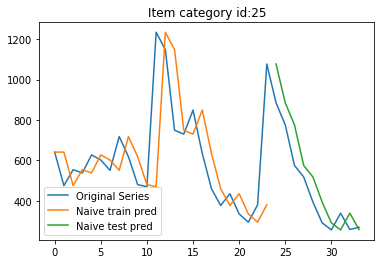

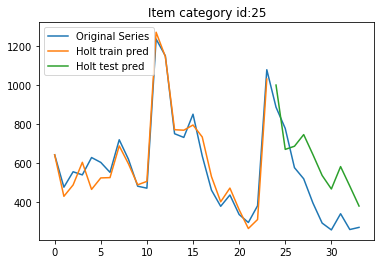

24 25 115.40190639673159 193.03851498048925


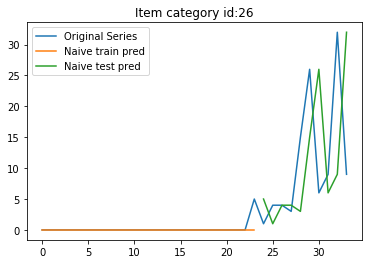

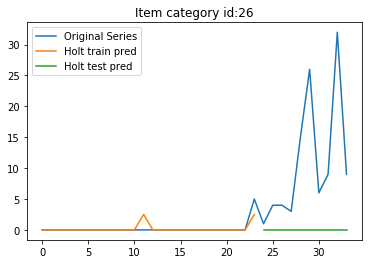

24 26 13.258959235173778 14.713938113924268


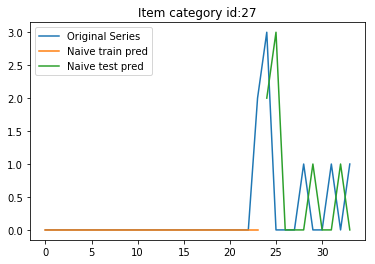

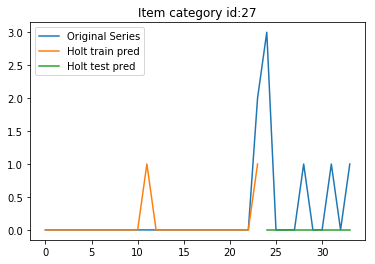

24 27 1.224744871391589 1.0954451409838557


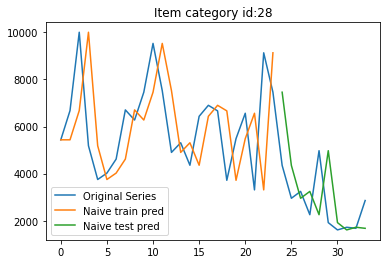

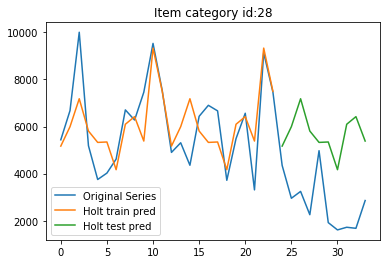

24 28 1757.6245901784603 3231.1016637430284


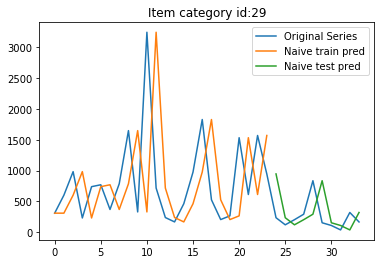

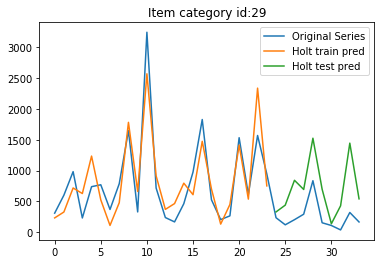

24 29 375.08745646848814 549.0825047971595


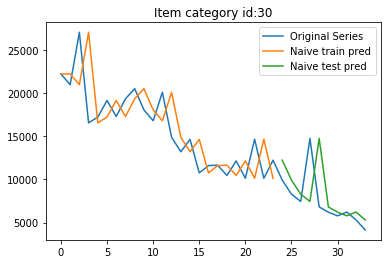

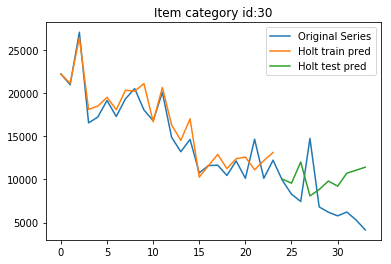

24 30 3577.069415037958 4493.908335724327


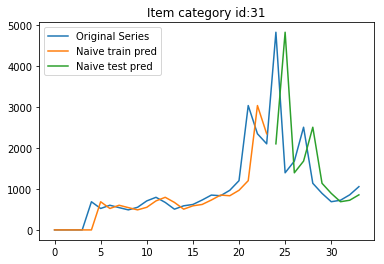

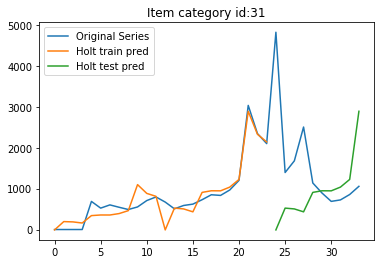

24 31 1482.466154756998 1831.0525256025428


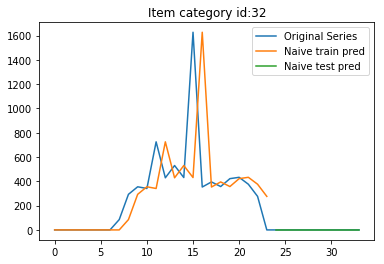

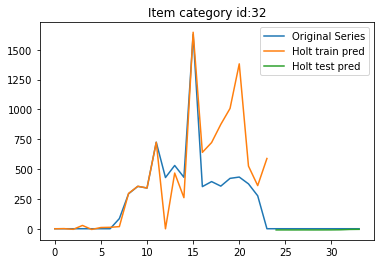

24 32 0.0 8.99387959886467


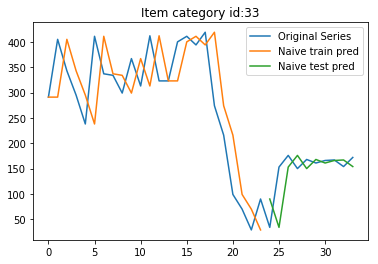

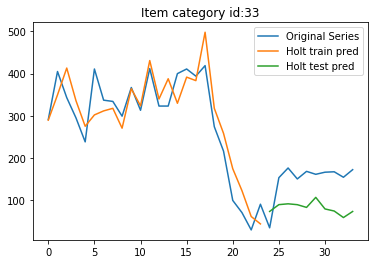

24 33 44.038619415235985 78.84409525370535


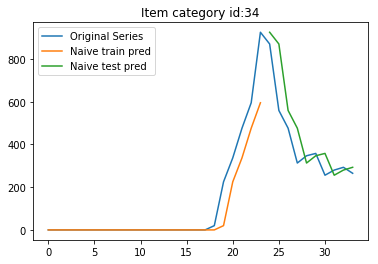

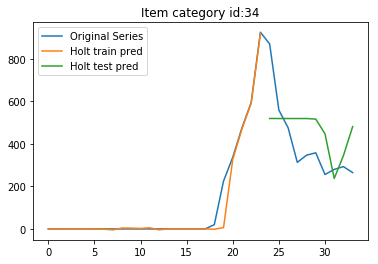

24 34 121.00165288127266 176.51556303012305


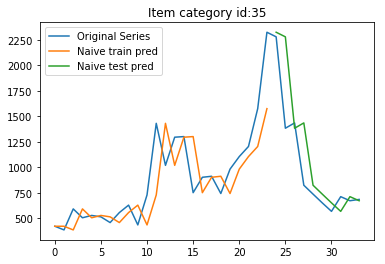

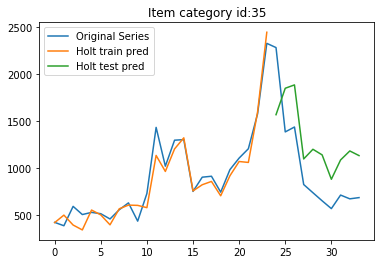

24 35 350.03214138133086 462.92991268530443


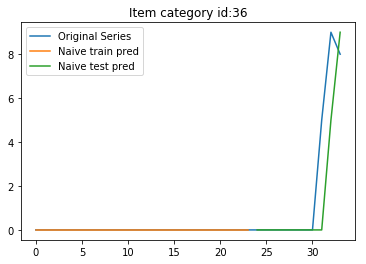

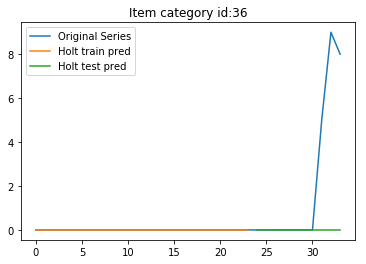

24 36 2.04939015319192 4.123105625617661


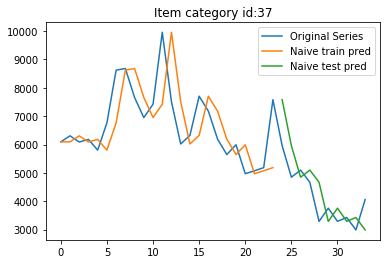

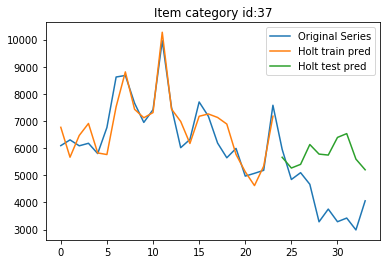

24 37 884.330763911332 2003.3140089226295


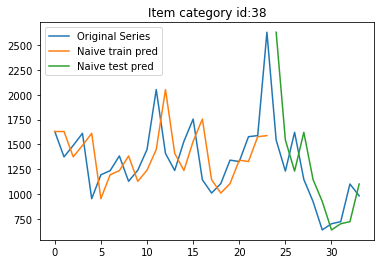

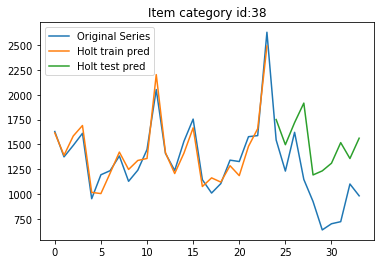

24 38 440.79110698833296 504.14611211305703


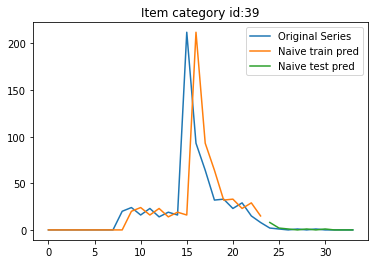

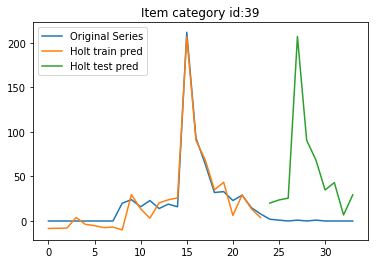

24 39 2.04939015319192 77.9895910417459


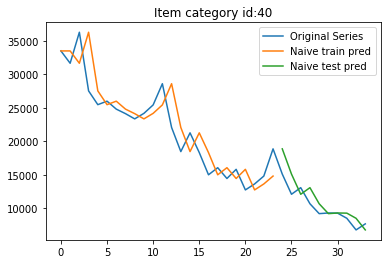

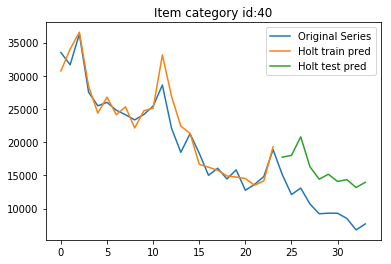

24 40 1912.4373453789278 5756.798678167367


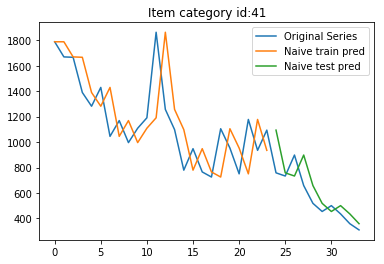

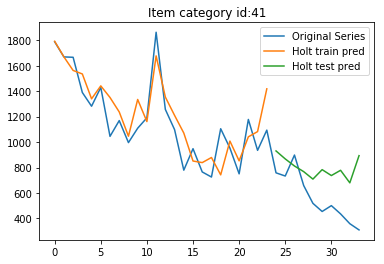

24 41 153.85480168002556 288.13528337561104


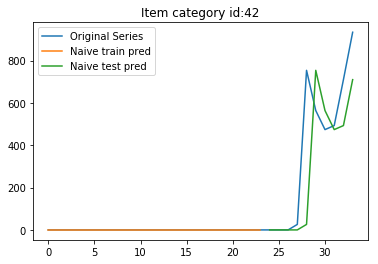

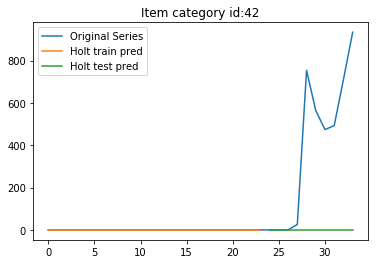

24 42 259.32335027914473 522.6345759706298


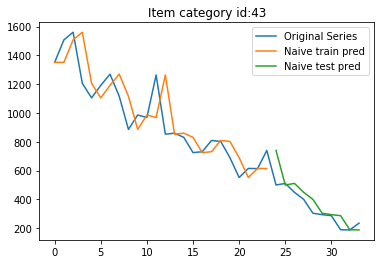

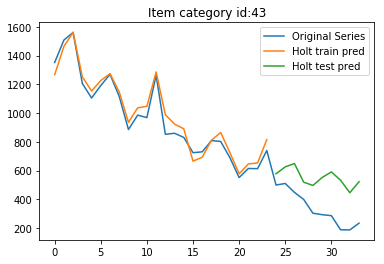

24 43 92.27404835597059 232.19040567076098


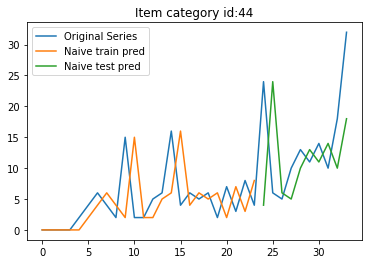

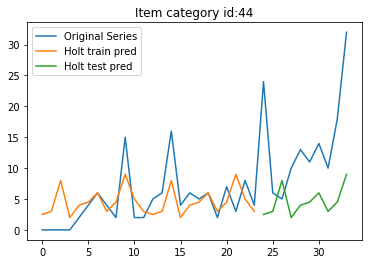

24 44 10.237187113655782 12.213725183198502


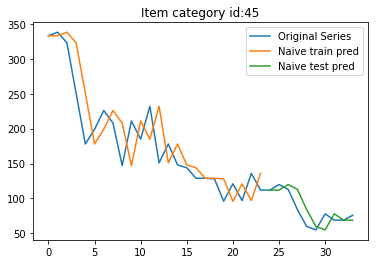

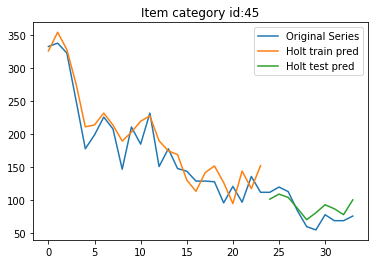

24 45 14.879516121164693 15.299789025717951


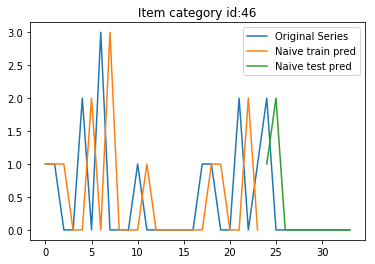

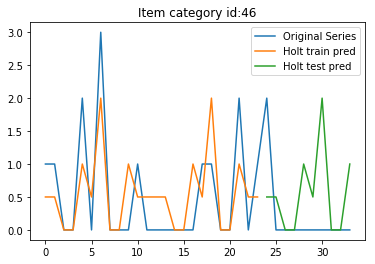

24 46 0.7071067811865476 0.9354143281506212


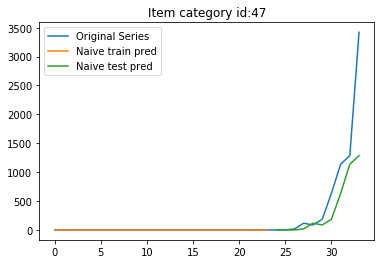

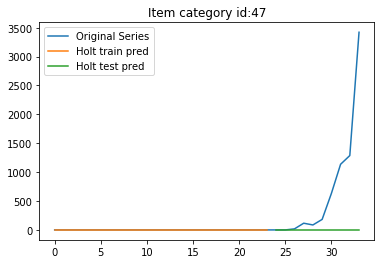

24 47 710.882620409305 1228.8737119818293


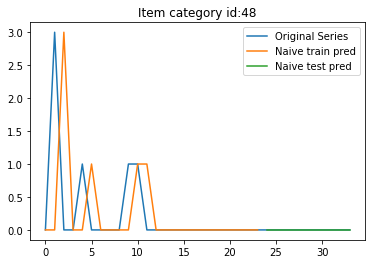

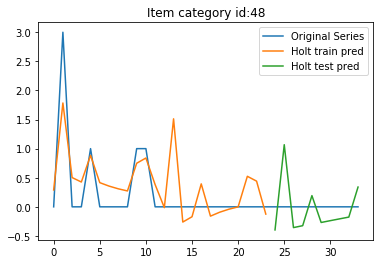

24 48 0.0 0.4341025363382411


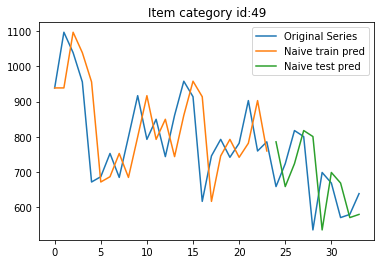

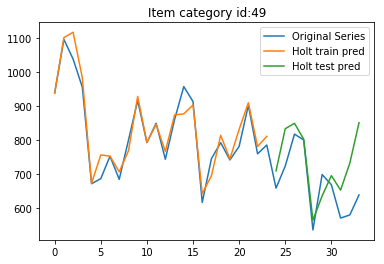

24 49 118.4647626933849 98.22181074184668


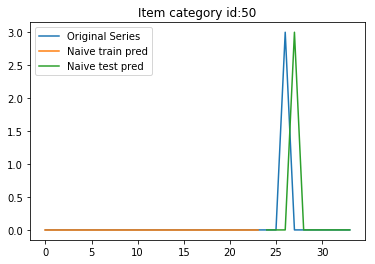

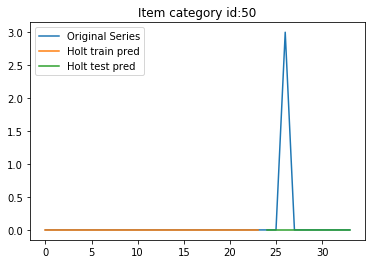

24 50 1.3416407864998738 0.9486832980505138


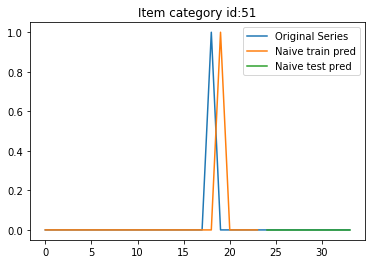

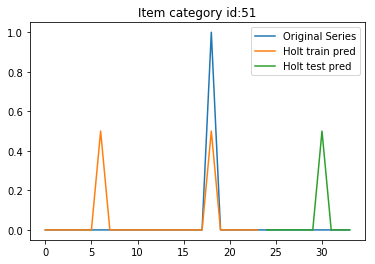

24 51 0.0 0.15811398561201945


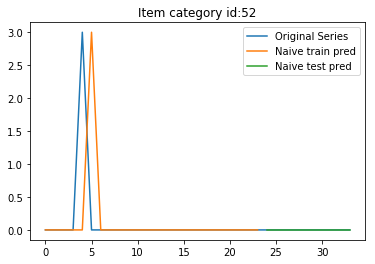

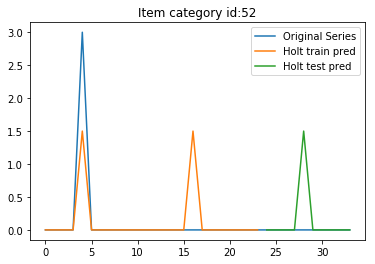

24 52 0.0 0.47433537555877947


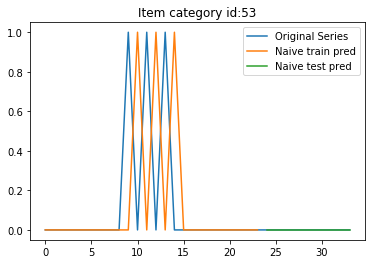

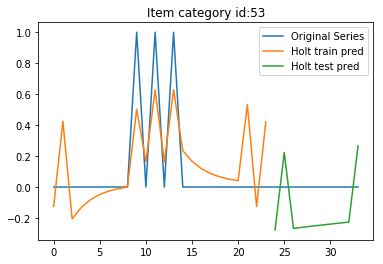

24 53 0.0 0.24964134588240186


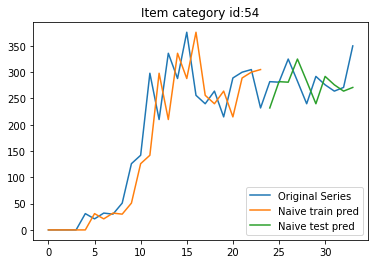

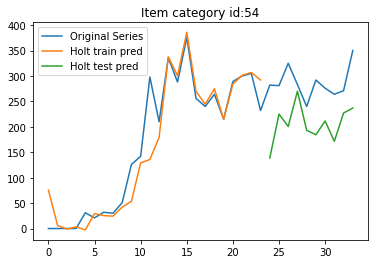

24 54 41.76601489249364 89.72079104100325


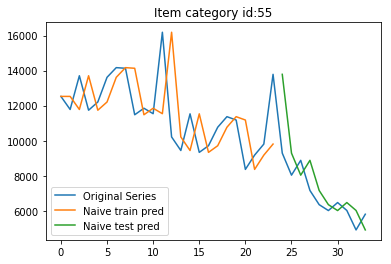

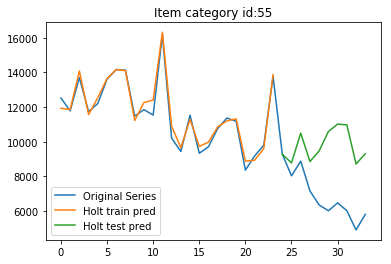

24 55 1692.9404006048176 3296.6898091207336


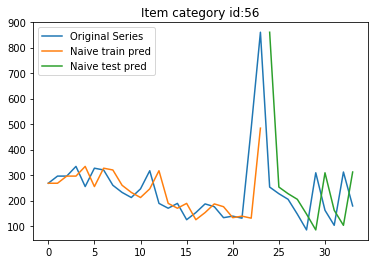

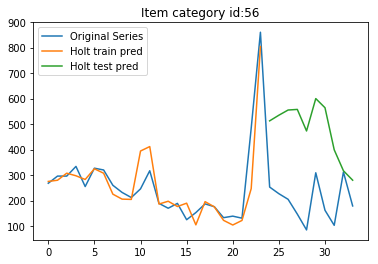

24 56 226.59501318431526 307.8634686824384


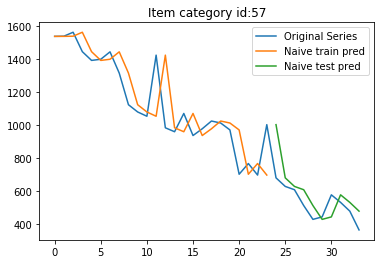

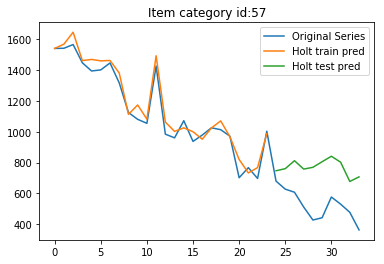

24 57 126.41479343810992 259.46357462168004


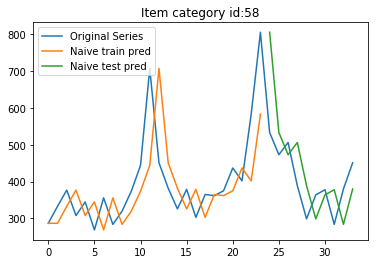

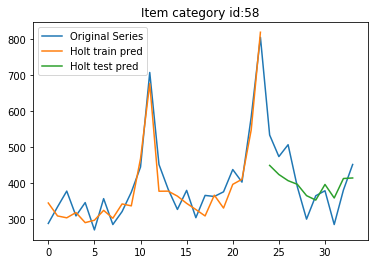

24 58 113.12647789089874 56.82539292928052


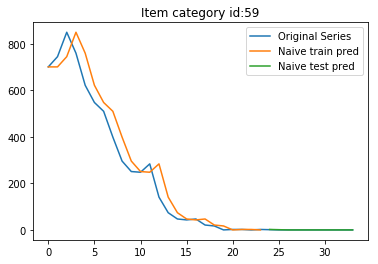

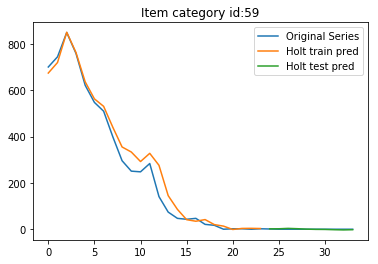

24 59 0.4472135954999579 2.058360315052874


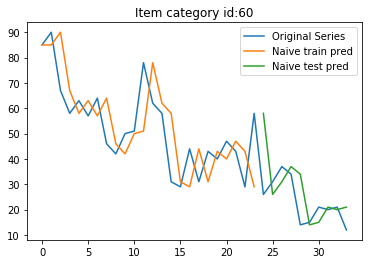

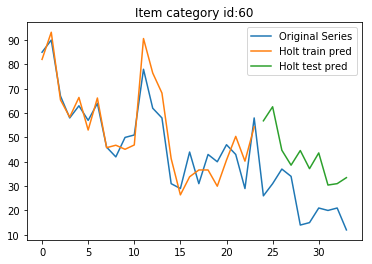

24 60 12.704329970525798 21.54103504097251


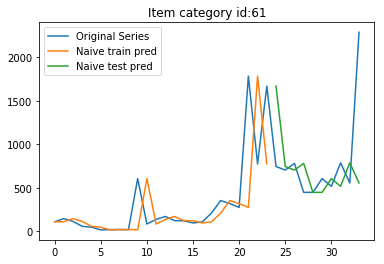

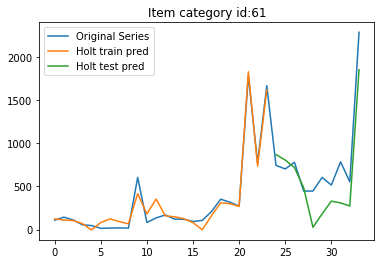

24 61 644.2009003408797 303.1988236045582


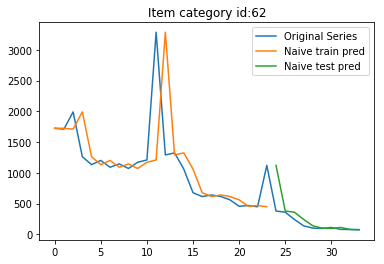

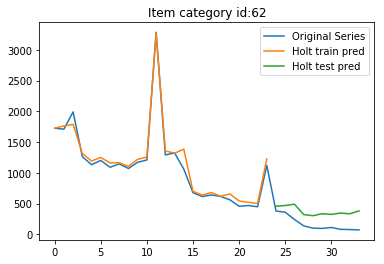

24 62 240.48160012774366 220.7759062850411


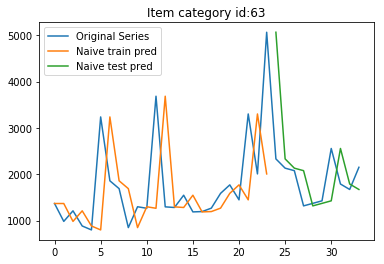

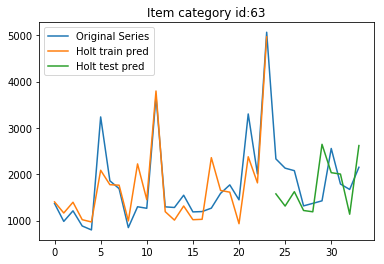

24 63 1010.4339166912401 616.3702845005699


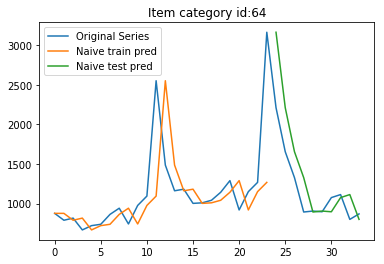

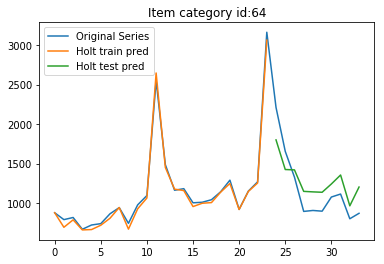

24 64 405.8528058298969 251.14361222268028


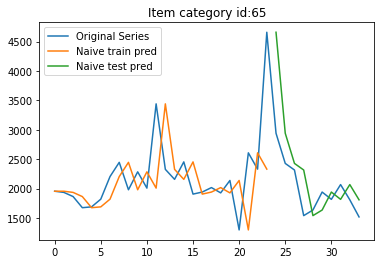

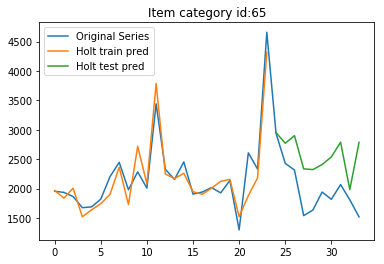

24 65 645.1521525965793 668.083083510266


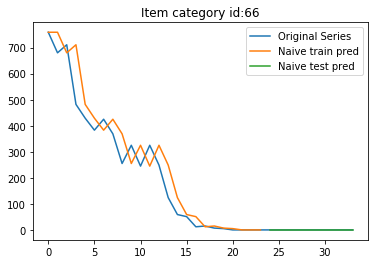

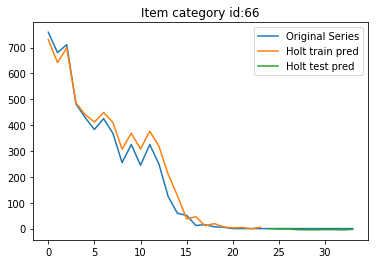

24 66 0.0 3.685020882917572


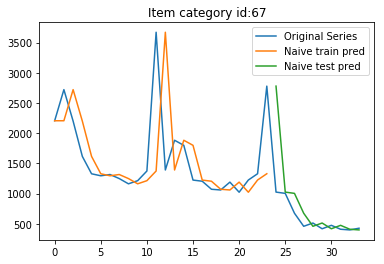

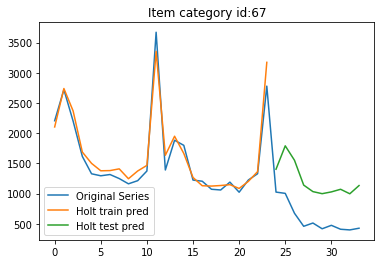

24 67 570.2783530873322 648.4481203767018


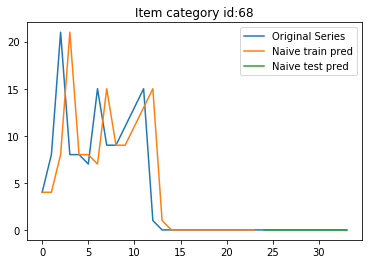

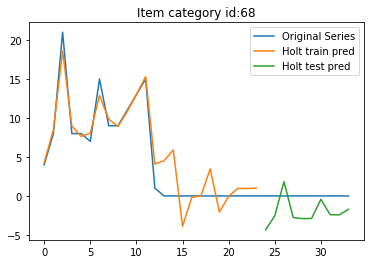

24 68 0.0 2.6100097104952393


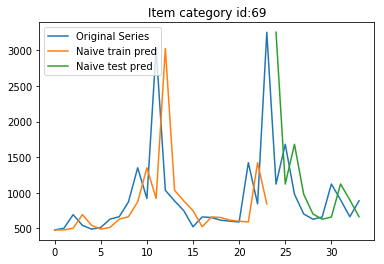

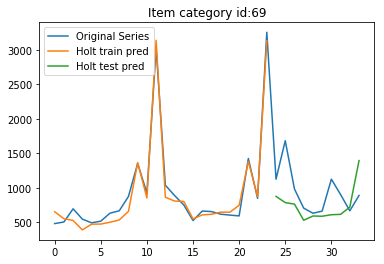

24 69 761.0400120887206 394.8853802916105


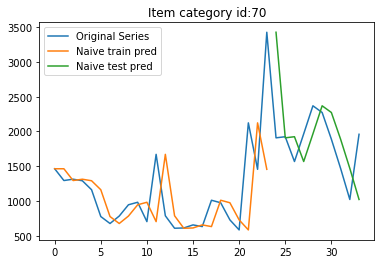

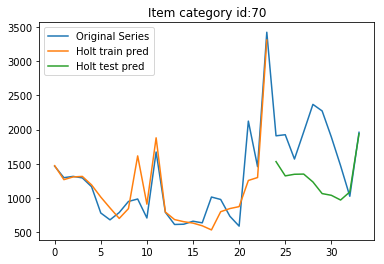

24 70 644.4095747271296 683.4312401035853


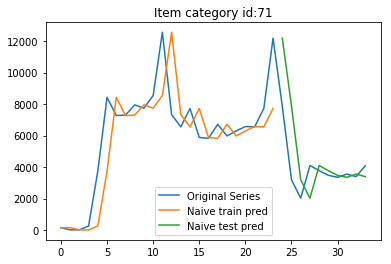

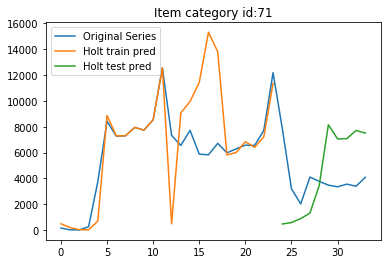

24 71 2167.089499766911 3863.4925283598363


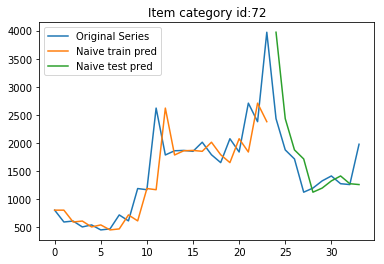

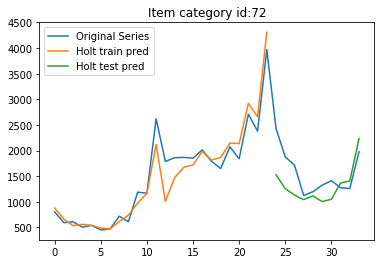

24 72 601.6149100545963 434.48883802667956


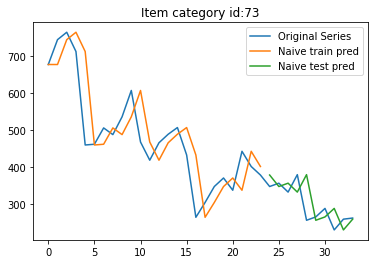

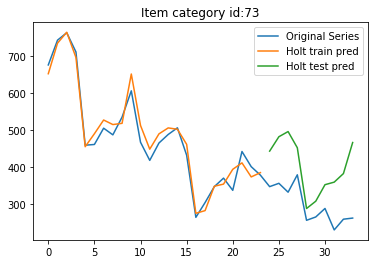

24 73 48.76474136094644 117.41369344862773


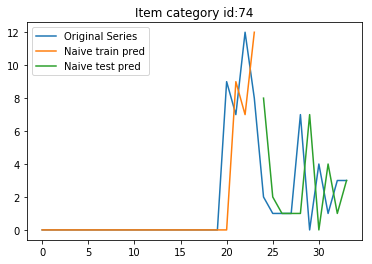

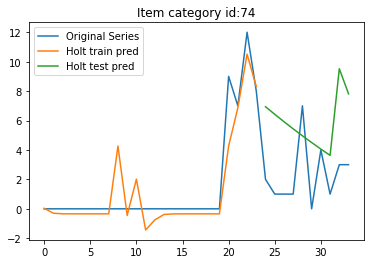

24 74 3.8858718455450894 4.413334659168707


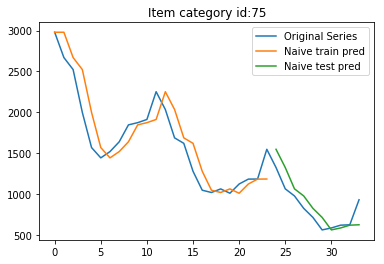

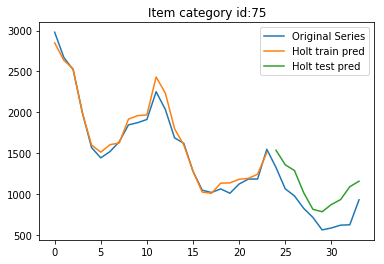

24 75 167.22619412041882 278.1067471883525


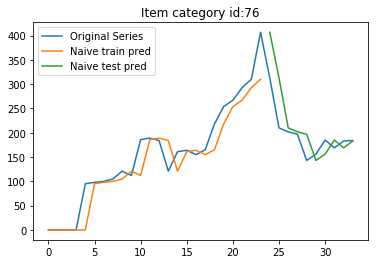

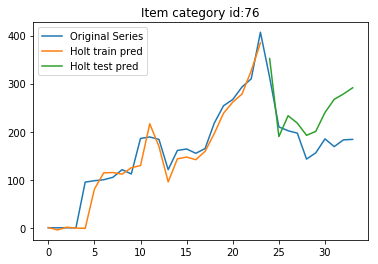

24 76 48.90092023673992 64.12748313752459


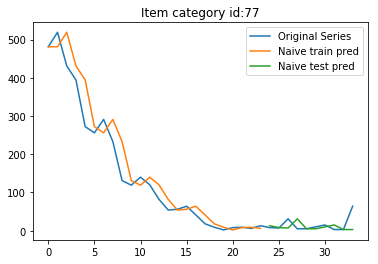

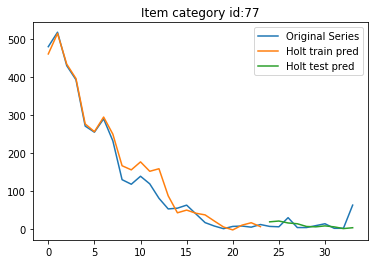

24 77 22.78815481779953 20.662219196423784


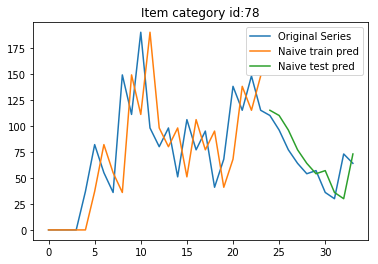

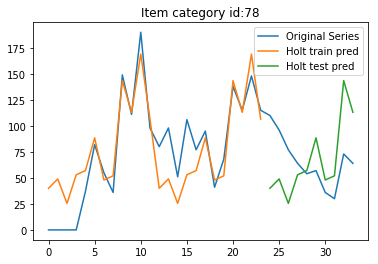

24 78 18.074844397670482 43.4542774545974


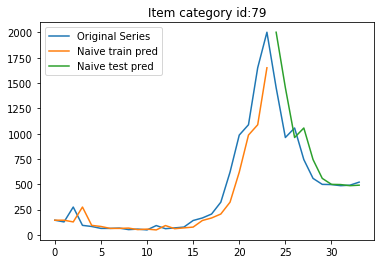

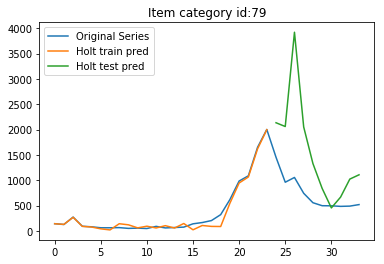

24 79 262.2355811098105 1138.2745703797543


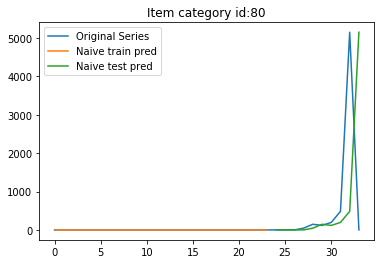

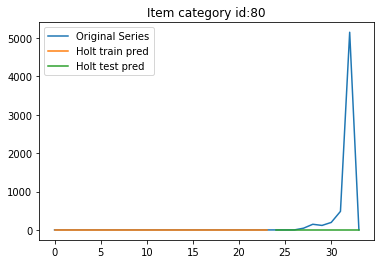

24 80 2199.6843864518382 1637.7068724286407


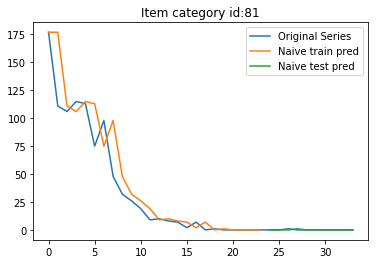

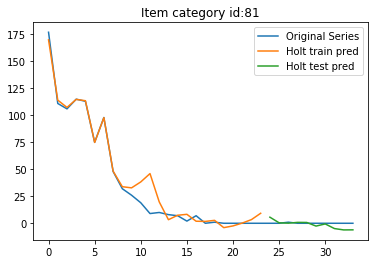

24 81 0.4472135954999579 3.7489050274297906


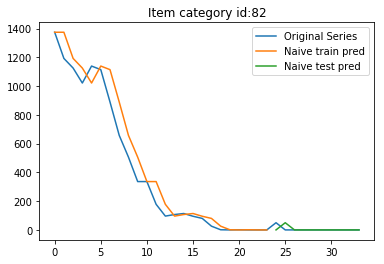

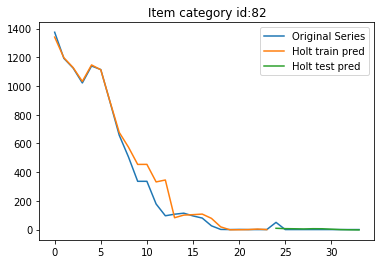

24 82 22.360679774997898 13.658622922628457


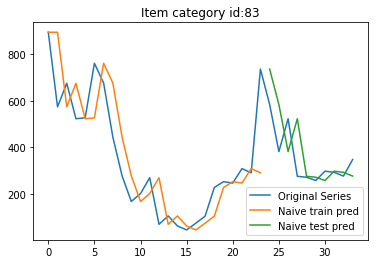

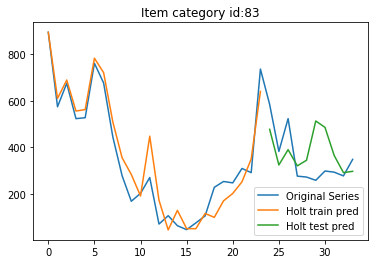

24 83 123.26069933275569 121.58665069133669


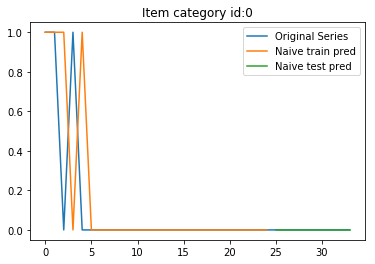

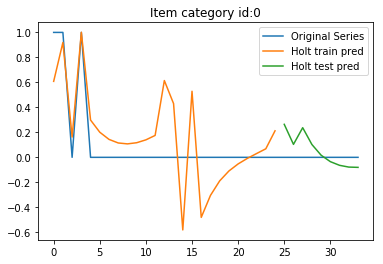

25 0 0.0 0.135628490497907


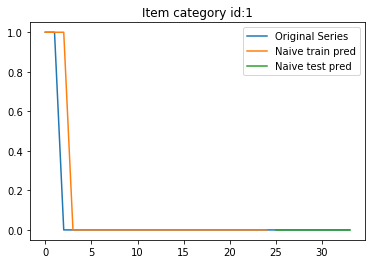

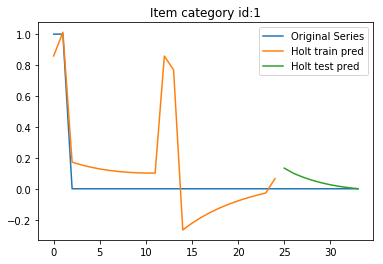

25 1 0.0 0.06593119835469383


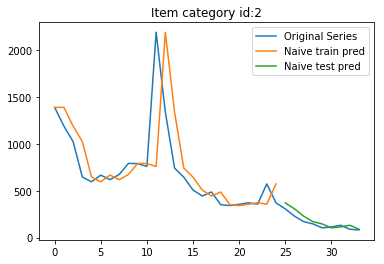

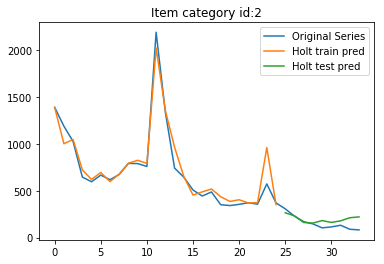

25 2 44.96418327711266 72.22326198186678


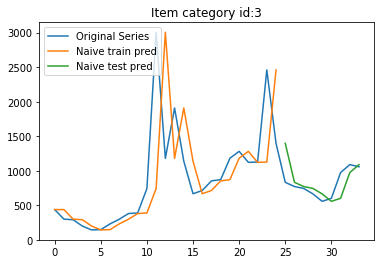

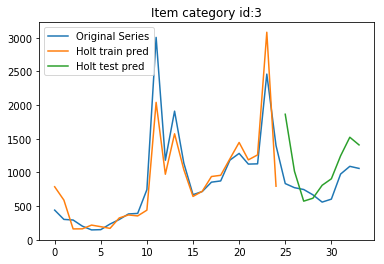

25 3 234.51060151349708 432.75632451606725


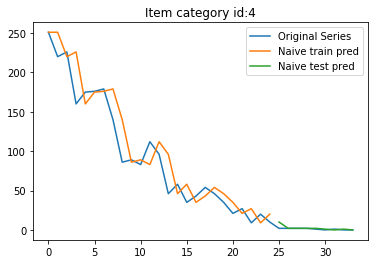

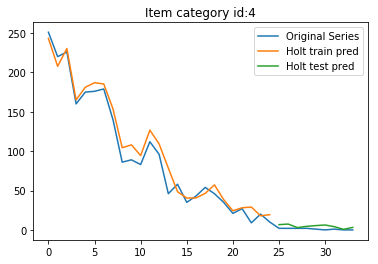

25 4 2.748737083745107 3.923429917586052


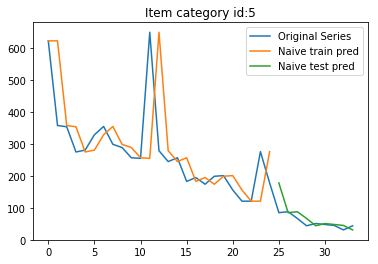

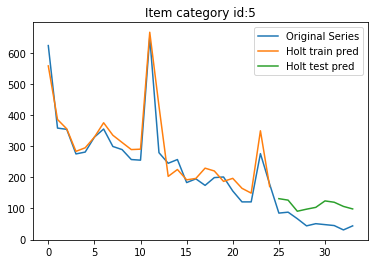

25 5 33.43318378165289 57.64387821611104


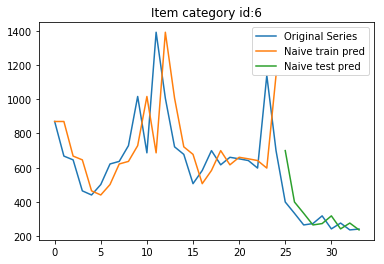

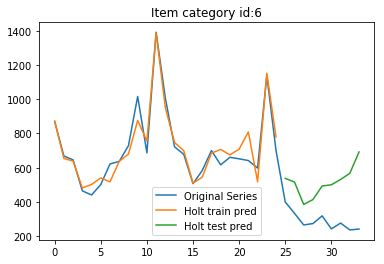

25 6 110.36605758414434 249.336755916337


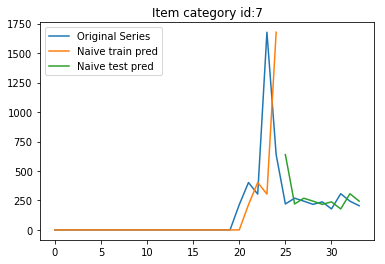

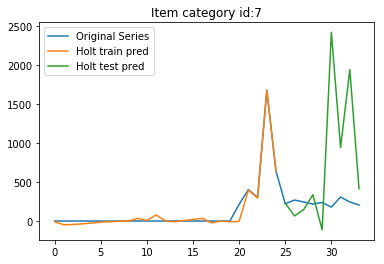

25 7 151.10261414019283 972.9171959711972


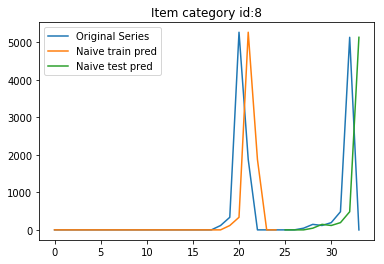

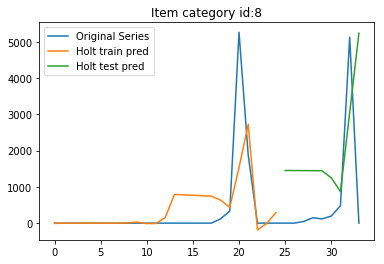

25 8 2309.06116082802 2177.872968541888


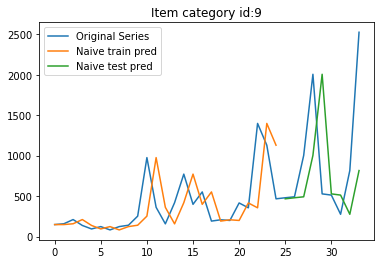

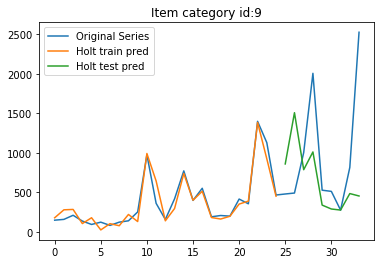

25 9 863.5987365540652 861.8462642913721


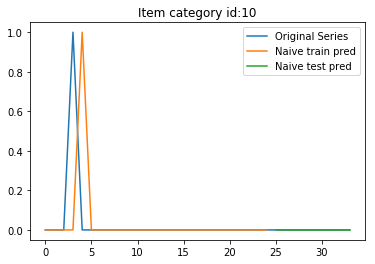

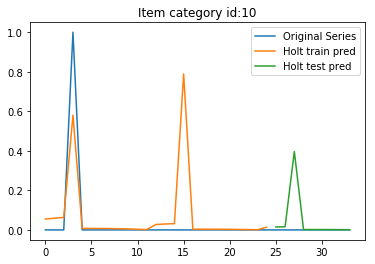

25 10 0.0 0.13242244471388956


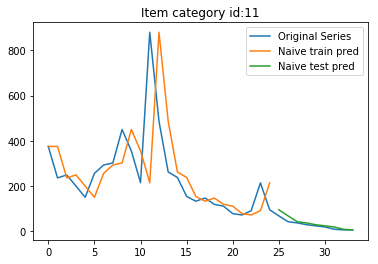

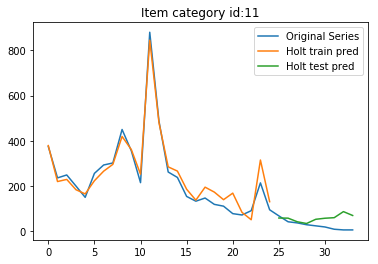

25 11 13.552367566837415 42.12037245117184


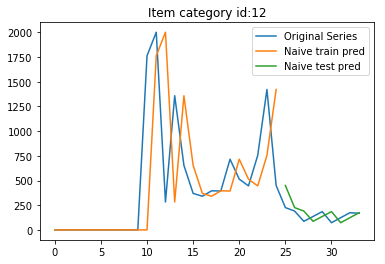

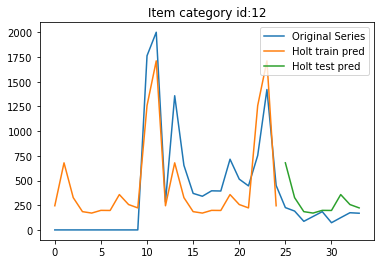

25 12 97.00458179327866 187.05144376146364


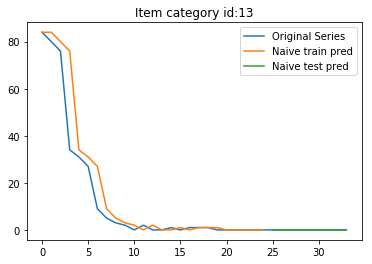

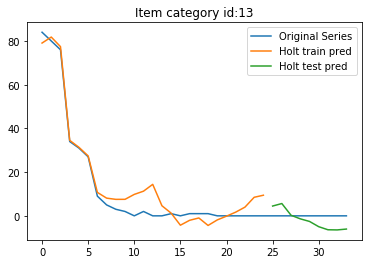

25 13 0.0 4.75736654295382


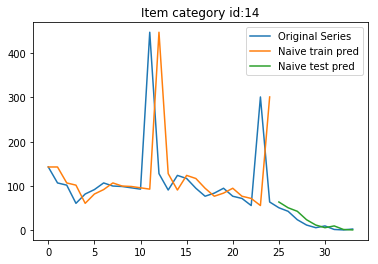

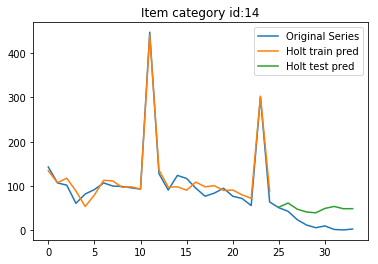

25 14 9.76956725983523 35.8514639950844


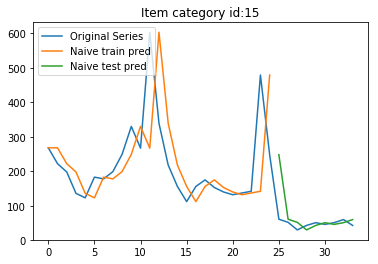

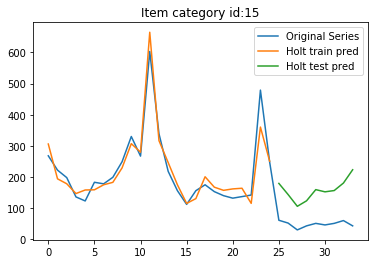

25 15 63.409603198393995 113.43432519887362


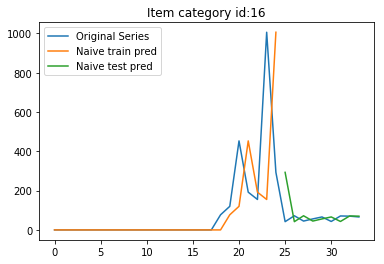

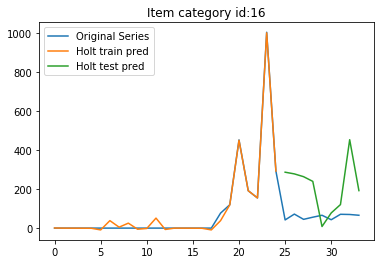

25 16 85.75222705238882 198.68319738411859


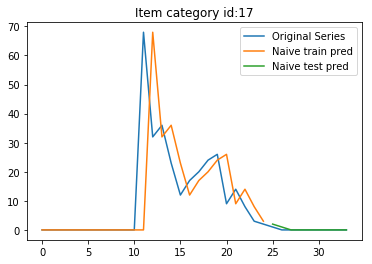

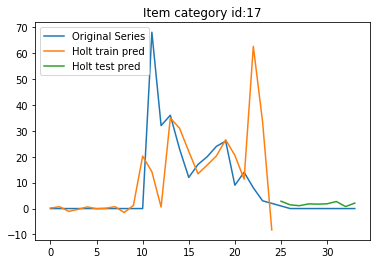

25 17 0.4714045207910317 1.7811014247870671


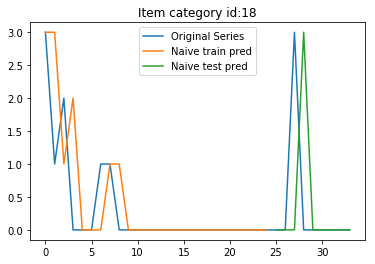

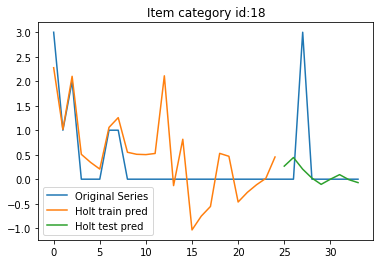

25 18 1.4142135623730951 0.9491147620141366


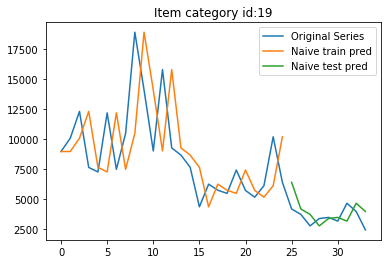

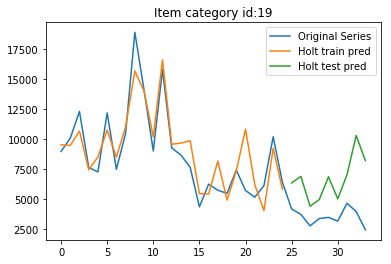

25 19 1135.208253043369 3559.423976550446


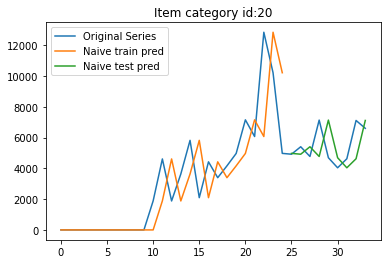

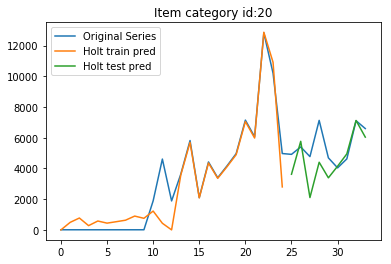

25 20 1468.1326385733832 1434.0024343700868


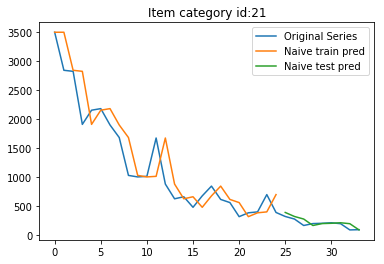

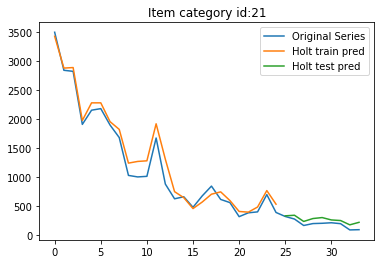

25 21 59.56695579112821 78.3839606659163


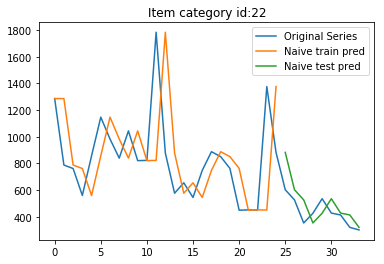

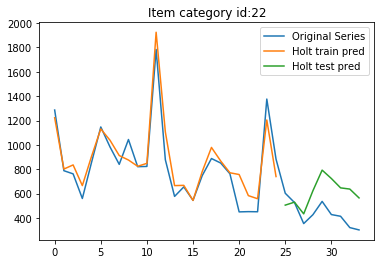

25 22 130.03631971278043 218.91316193972406


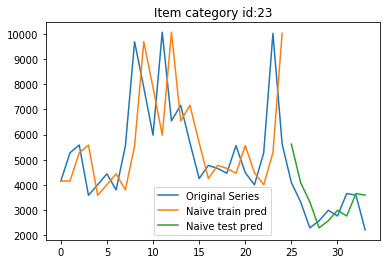

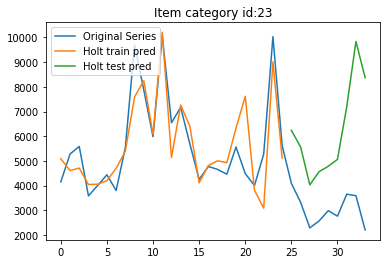

25 23 883.8924645503483 3570.3762545830846


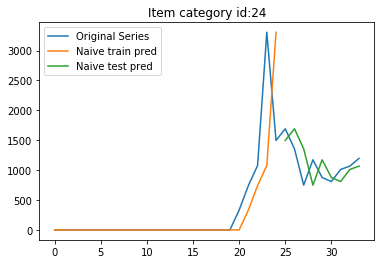

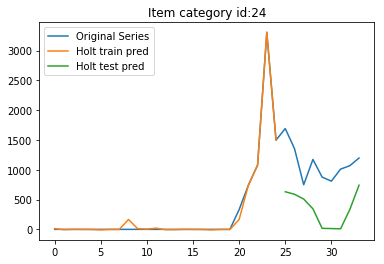

25 24 307.69393161964626 787.4869453655277


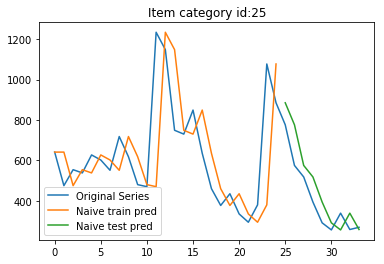

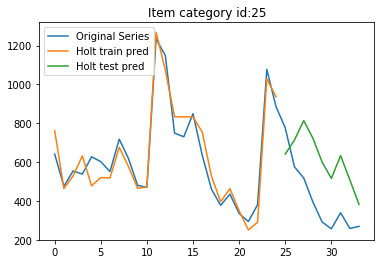

25 25 103.44724903704947 248.6449267720405


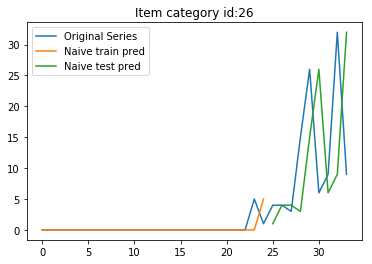

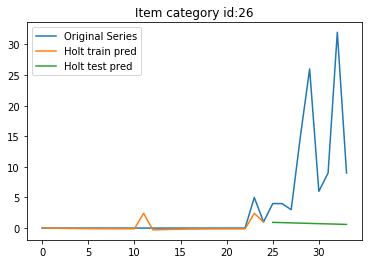

25 26 13.912424503139471 14.955986705716196


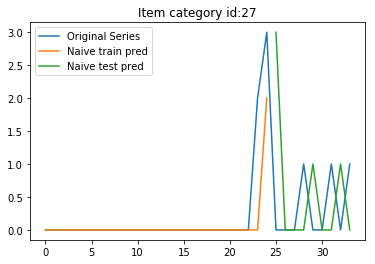

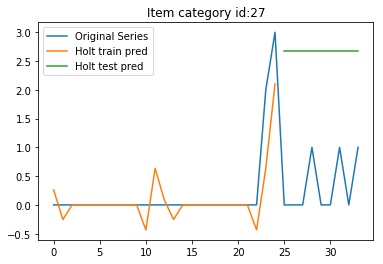

25 27 1.247219128924647 2.383520907974314


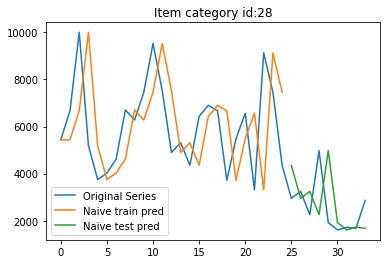

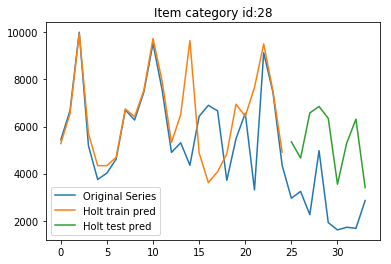

25 28 1535.7430702359618 3124.714202517162


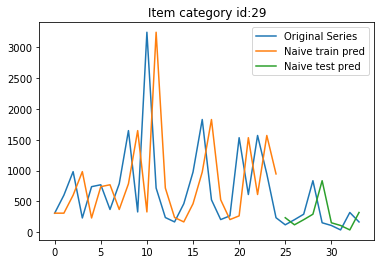

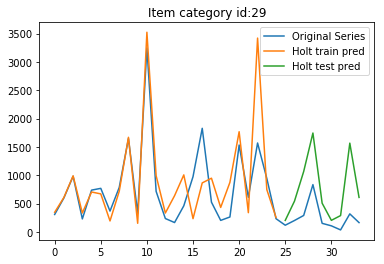

25 29 316.4709921760427 624.1967059863587


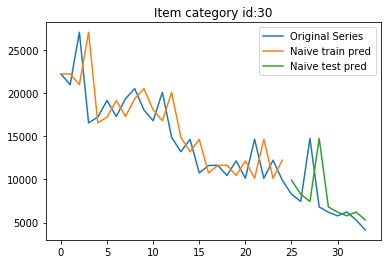

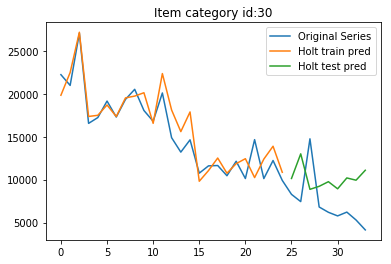

25 30 3690.824358384512 4506.397486105902


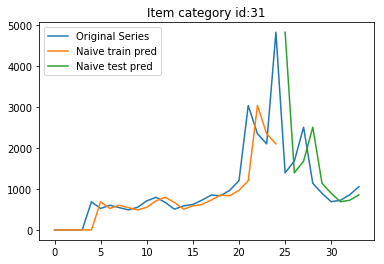

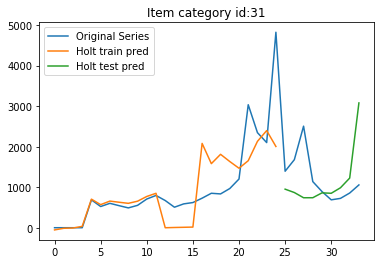

25 31 1272.0207021376134 969.4592213919966


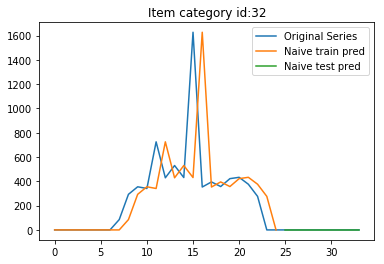

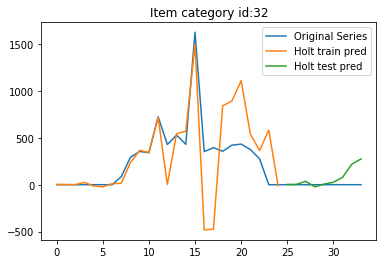

25 32 0.0 121.23454303440117


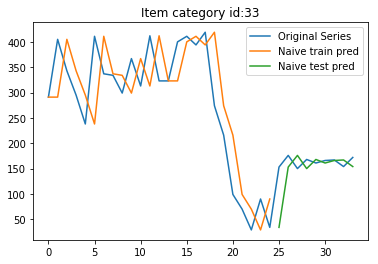

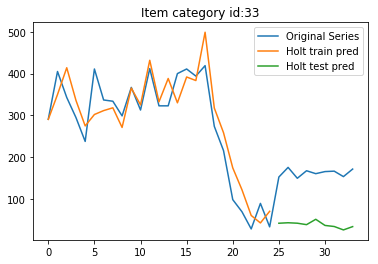

25 33 42.5022875201376 124.15689705618507


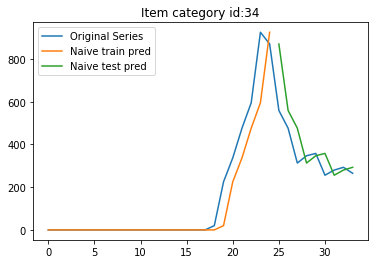

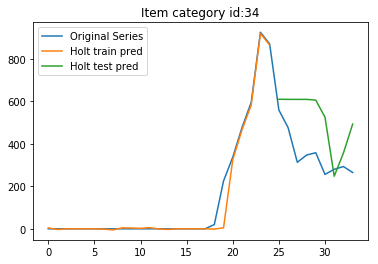

25 34 126.22246674467708 202.06626178925578


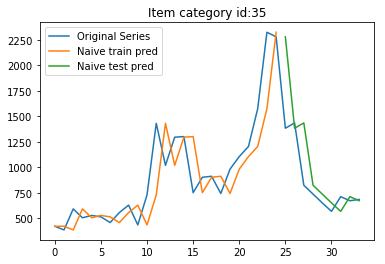

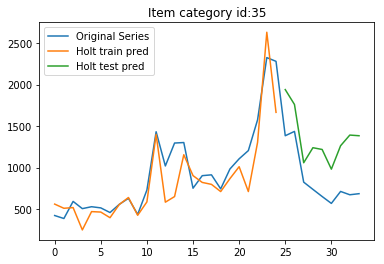

25 35 368.6612416719598 529.0206277426533


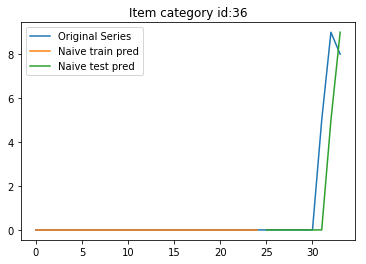

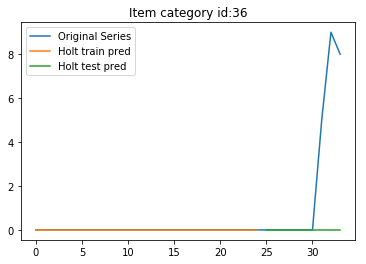

25 36 2.160246899469287 4.346134936801766


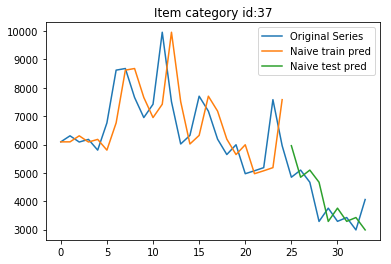

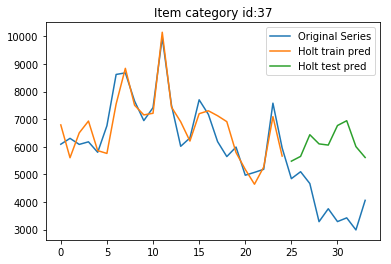

25 37 759.1135180810136 2429.9756573227173


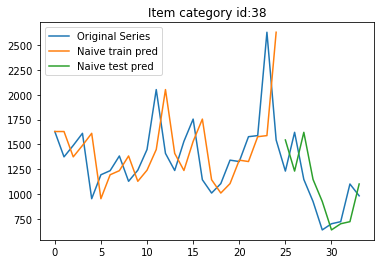

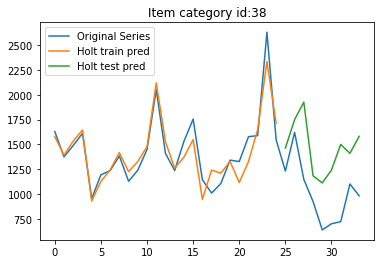

25 38 292.10196088961055 507.35438903825514


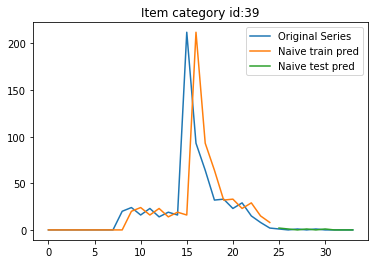

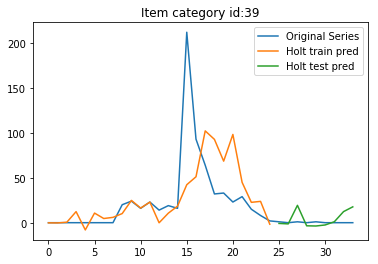

25 39 0.816496580927726 9.693428377900016


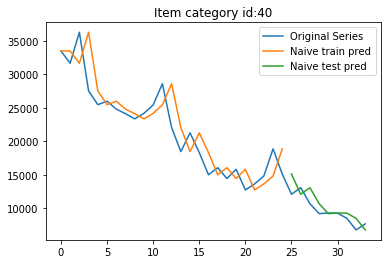

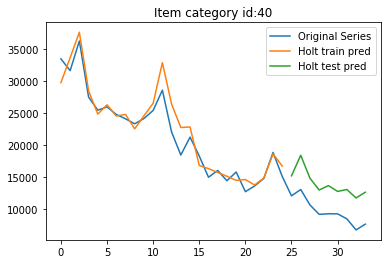

25 40 1577.0534057045895 4378.124880650273


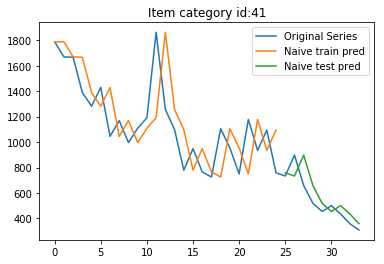

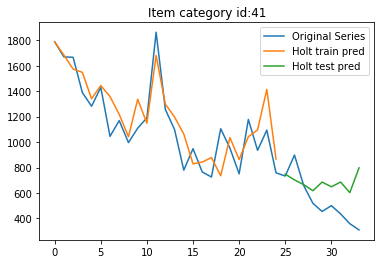

25 41 117.29213291796022 232.13311453458263


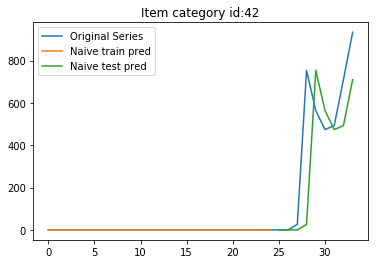

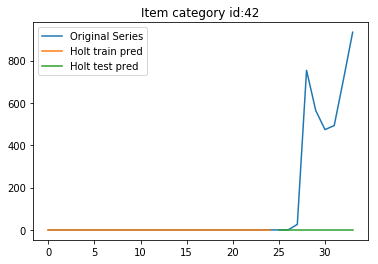

25 42 273.35081244925294 550.9052146744988


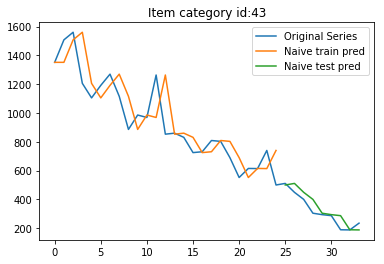

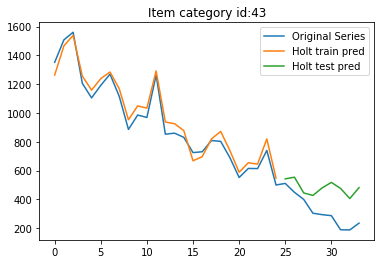

25 43 55.32228805423322 185.01307162234824


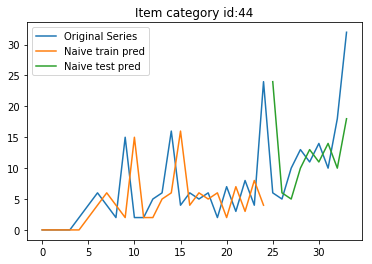

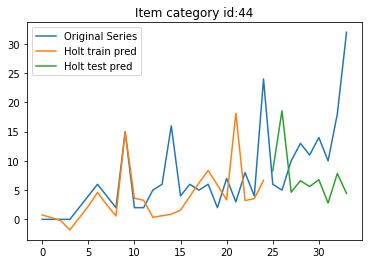

25 44 8.48528137423857 11.809036197031528


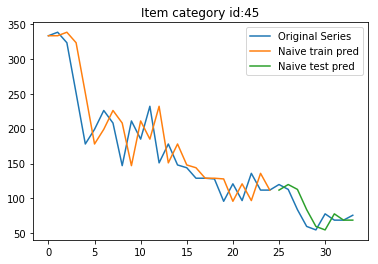

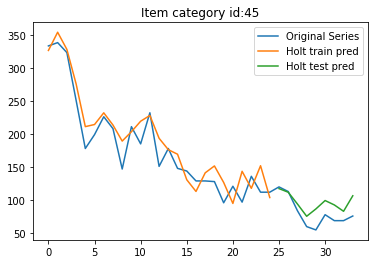

25 45 15.684387141358123 19.770906221827623


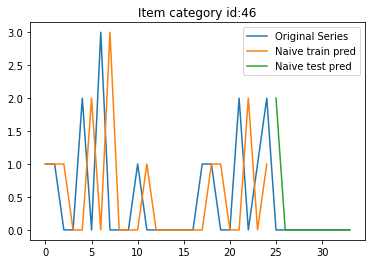

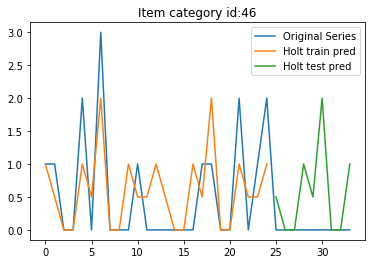

25 46 0.6666666666666666 0.8498365094068027


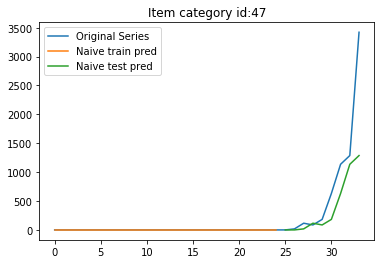

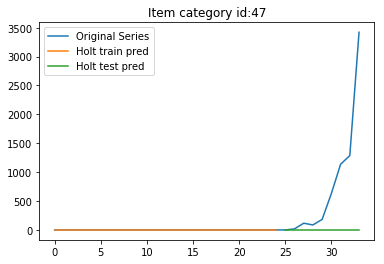

25 47 749.3360765074343 1295.34662885611


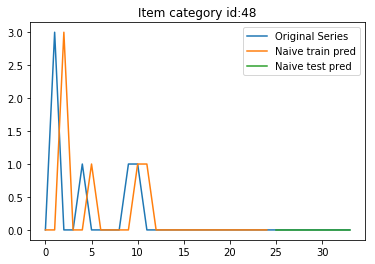

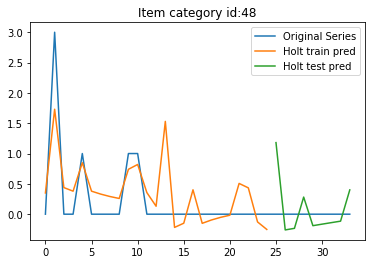

25 48 0.0 0.45335570642958556


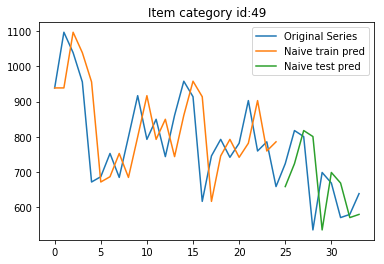

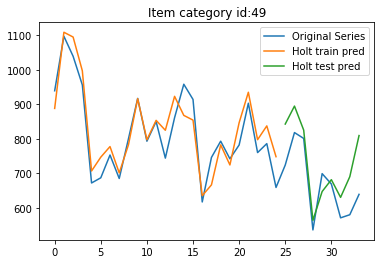

25 49 117.47813035246651 87.45953934243242


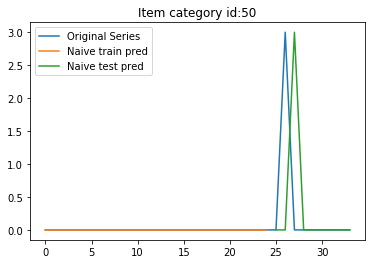

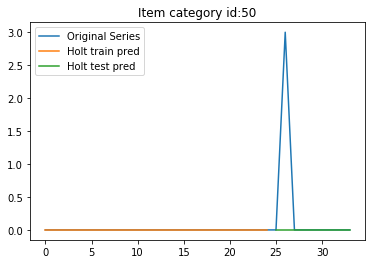

25 50 1.4142135623730951 1.0


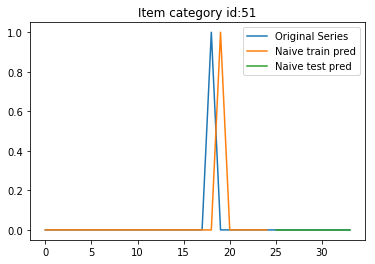

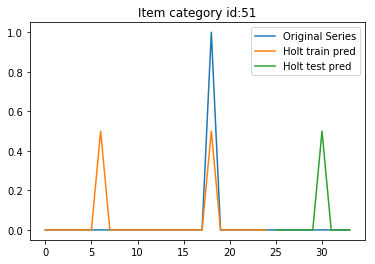

25 51 0.0 0.1666666499231969


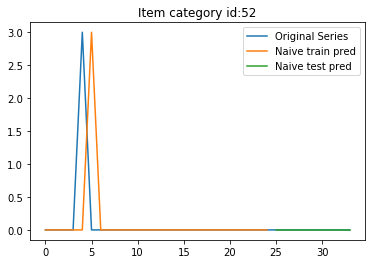

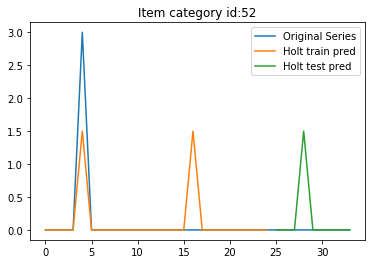

25 52 0.0 0.4999996053690084


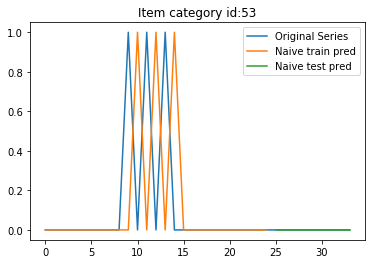

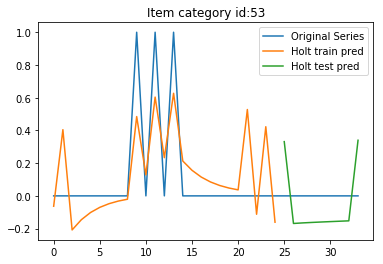

25 53 0.0 0.21213623021698264


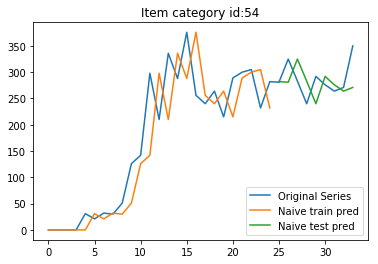

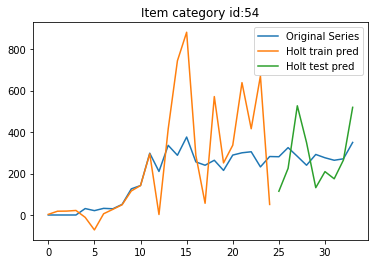

25 54 40.74855143982967 139.79831694614745


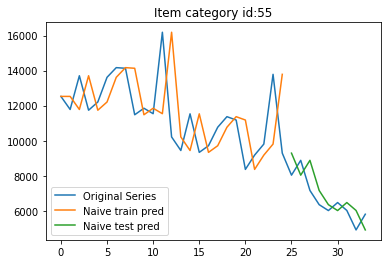

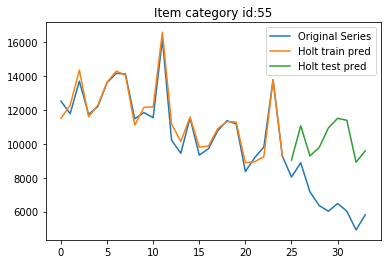

25 55 969.2750440979645 3812.688862482738


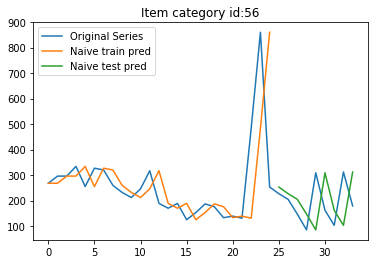

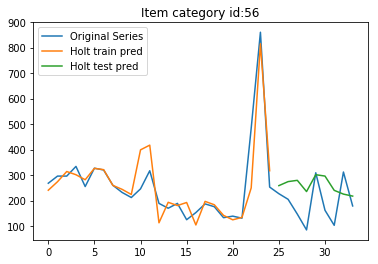

25 56 126.93130250476261 100.98620606155065


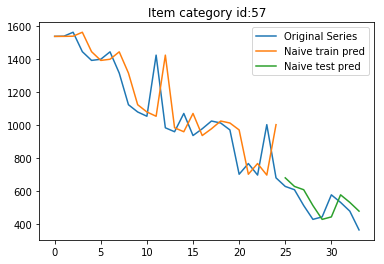

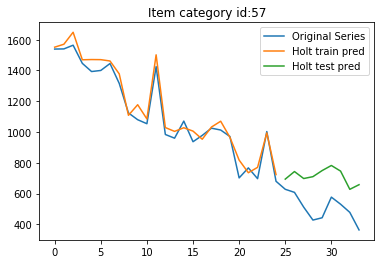

25 57 78.5125609200351 218.05135300120307


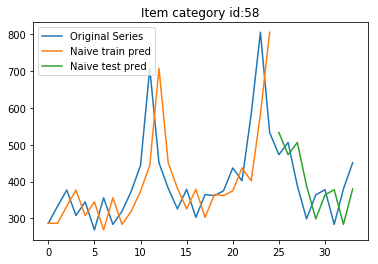

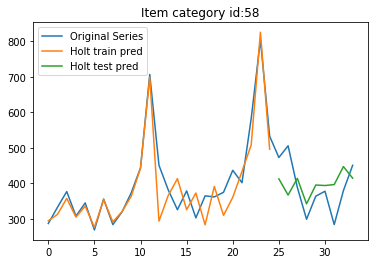

25 58 77.45392895851774 70.8880740080434


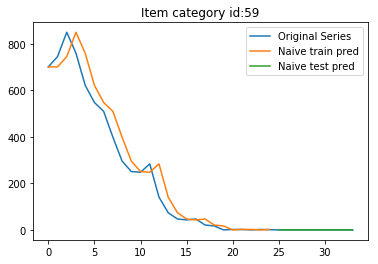

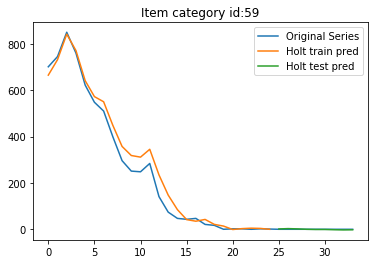

25 59 0.3333333333333333 1.8600930065936834


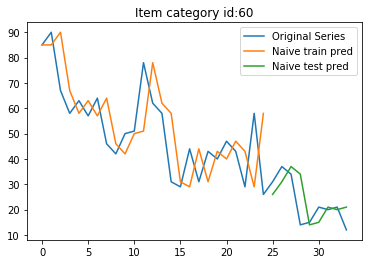

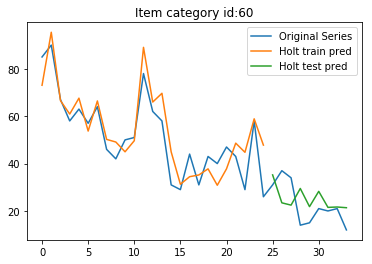

25 60 8.096638534327413 9.219586486181466


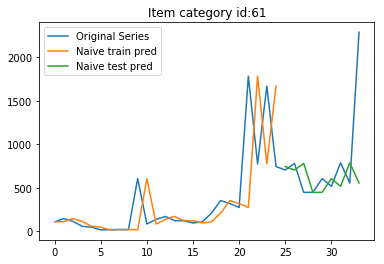

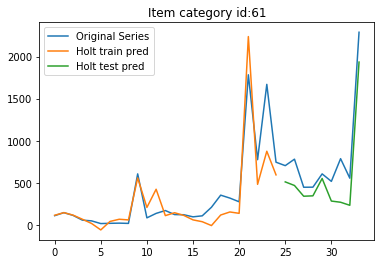

25 61 604.8390052090078 281.67820661565315


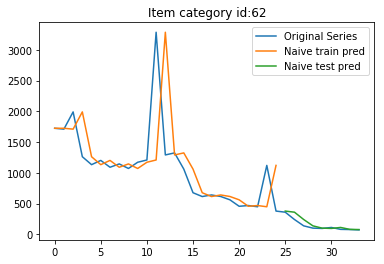

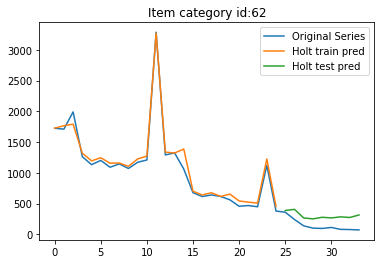

25 62 55.52777082985894 170.86310708931822


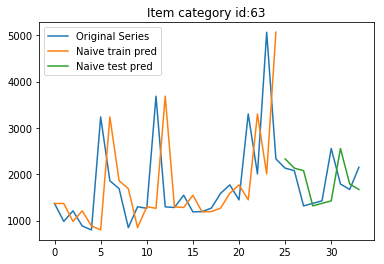

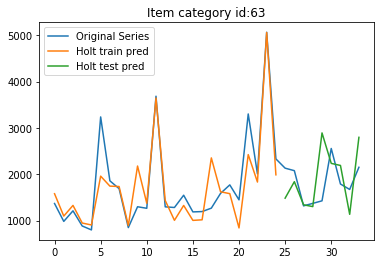

25 63 551.262288852694 632.4475224807094


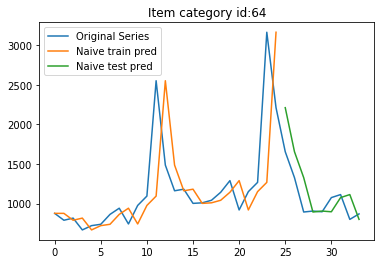

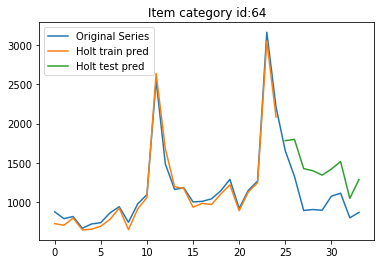

25 64 286.91094243491114 406.0495759719101


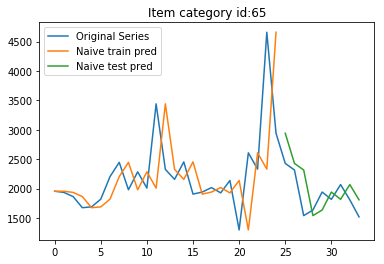

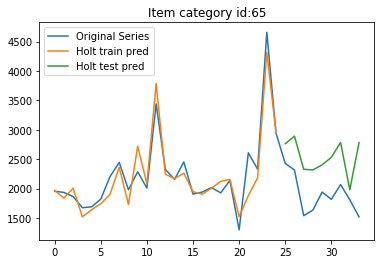

25 65 366.77104574925215 698.8897887587722


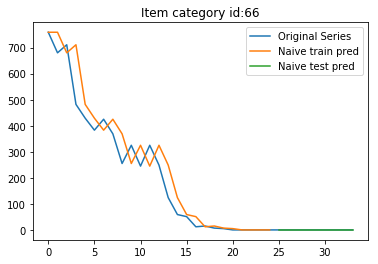

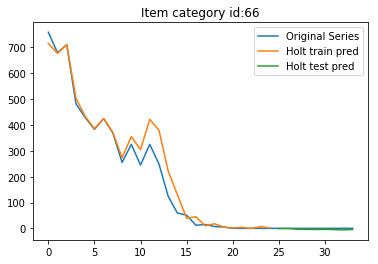

25 66 0.0 4.033612162195315


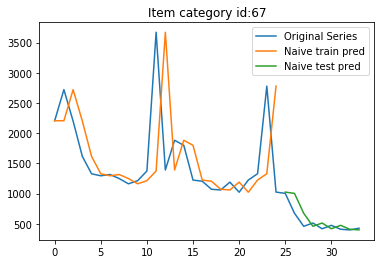

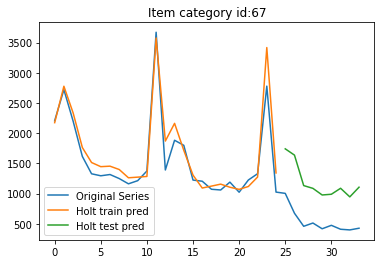

25 67 139.70524526858523 670.8455199478286


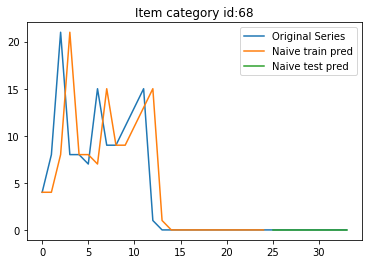

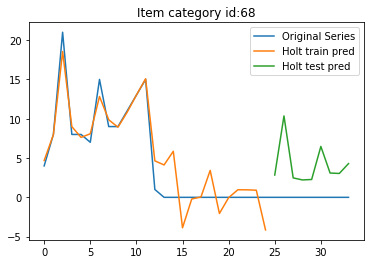

25 68 0.0 4.837305562230957


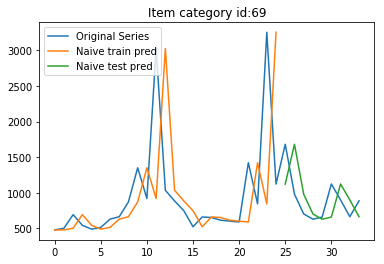

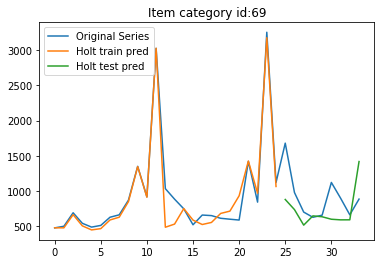

25 69 373.410557489266 392.3844976133223


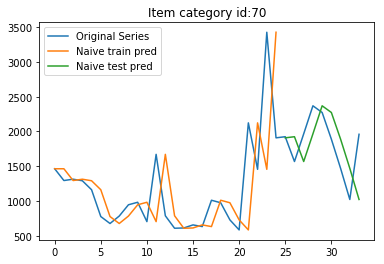

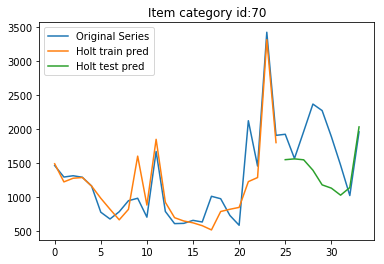

25 70 453.91886205943604 599.967511461999


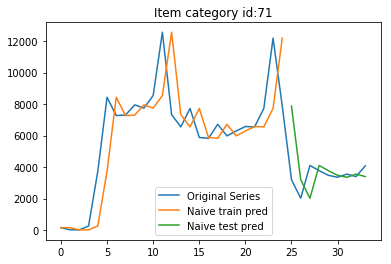

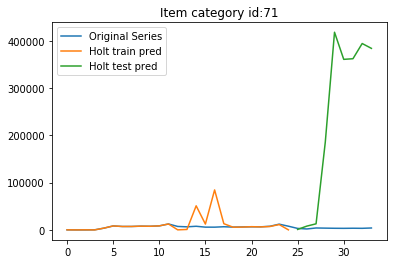

25 71 1774.3516186671307 290269.7522318455


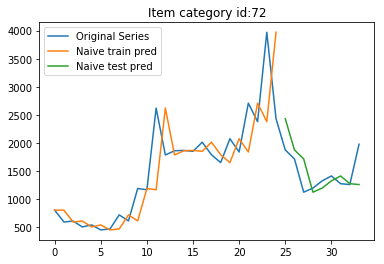

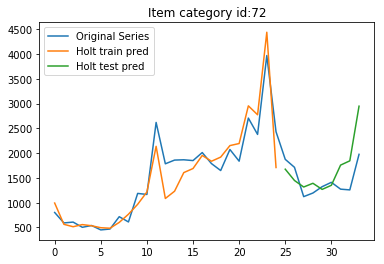

25 72 372.80975189915716 436.98440393681665


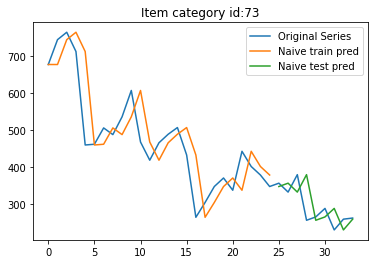

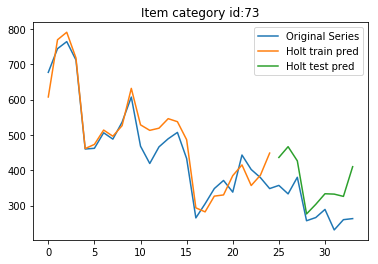

25 73 50.35319696349423 85.77113474639022


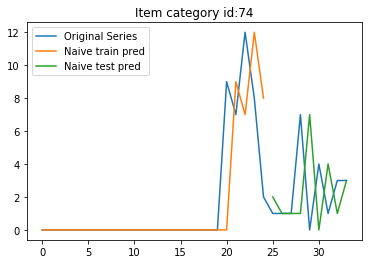

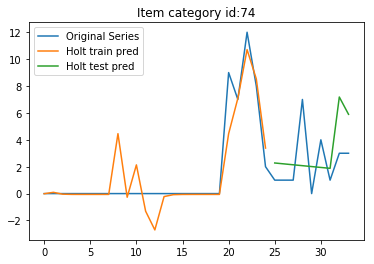

25 74 3.5746017649212027 2.657707387608437


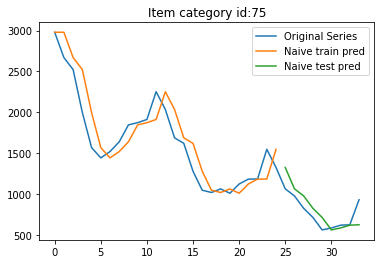

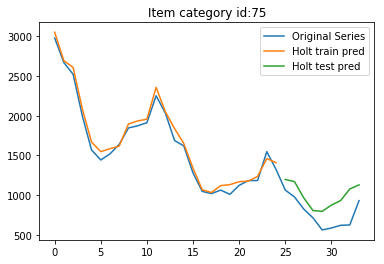

25 75 159.83220368040145 250.33432270098322


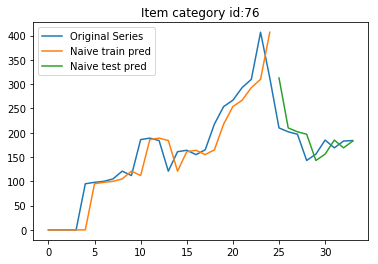

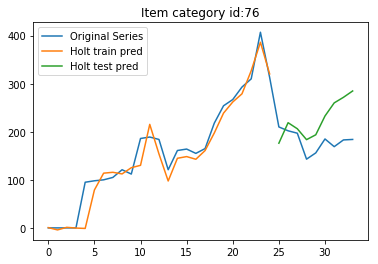

25 76 40.92947864586382 60.71502403025206


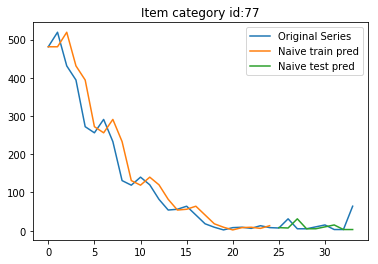

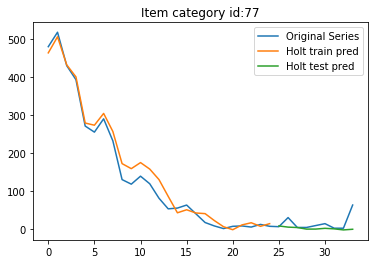

25 77 23.962934340815238 23.523222404633607


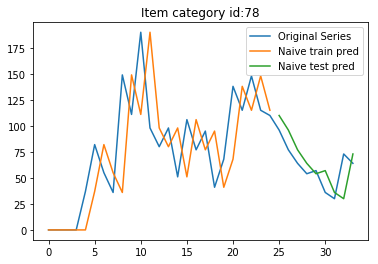

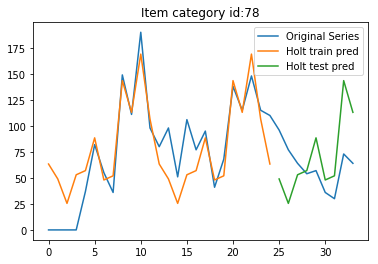

25 78 18.979521127315678 39.416233076433386


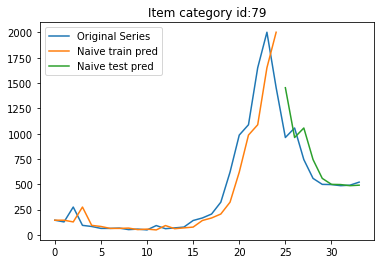

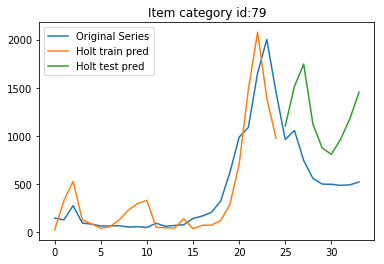

25 79 207.46378532703537 610.6149935745578


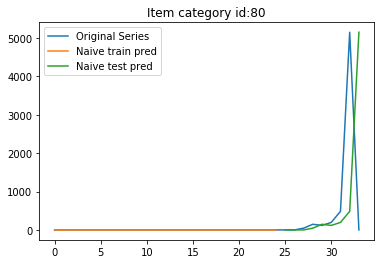

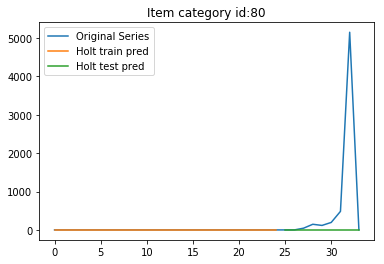

25 80 2318.6709315659455 1726.294618861772


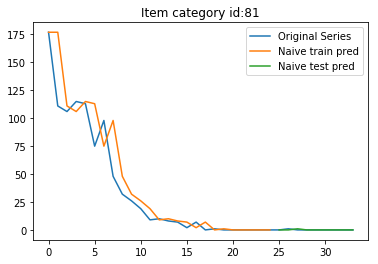

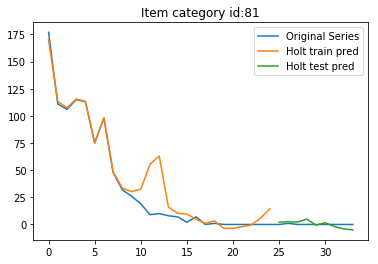

25 81 0.4714045207910317 3.05905498201045


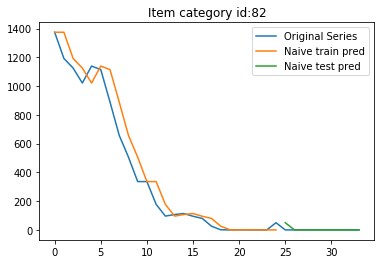

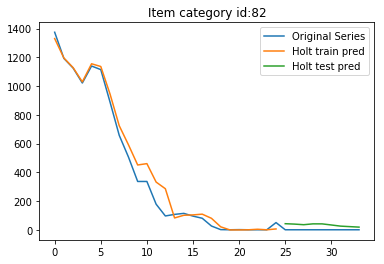

25 82 16.666666666666668 34.18572174627161


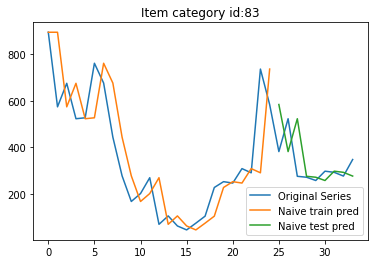

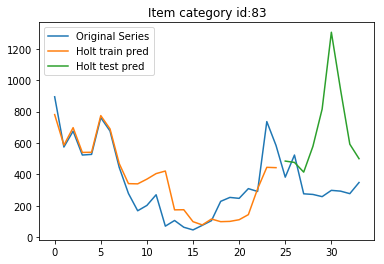

25 83 119.64205875118591 470.1593413052986


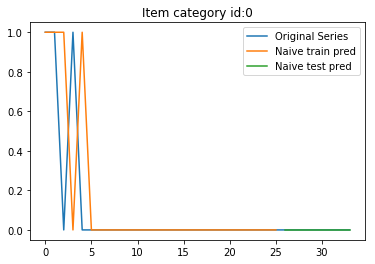

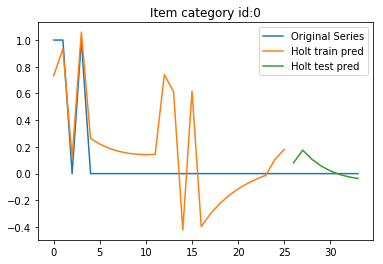

26 0 0.0 0.08254604219921623


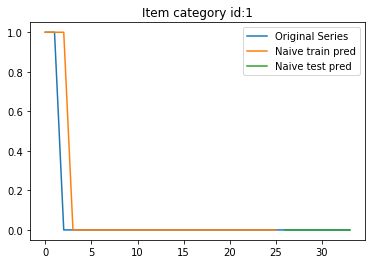

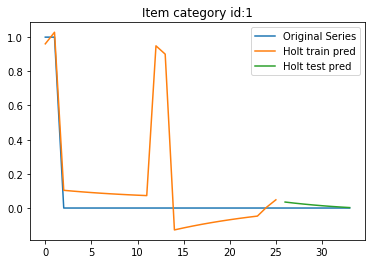

26 1 0.0 0.02009667261224262


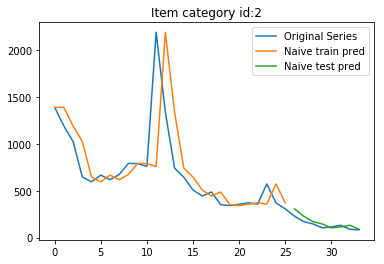

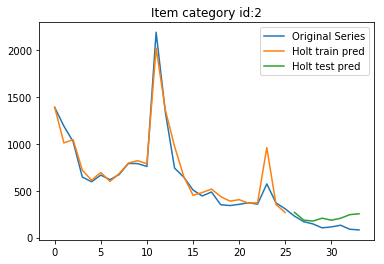

26 2 42.17078372522854 98.82644266743127


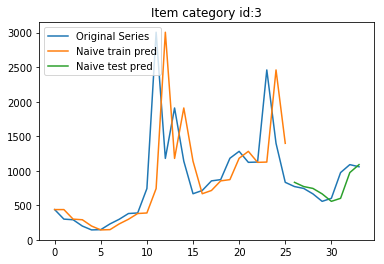

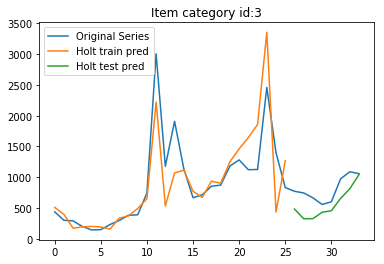

26 3 148.6863309117553 270.9107440468109


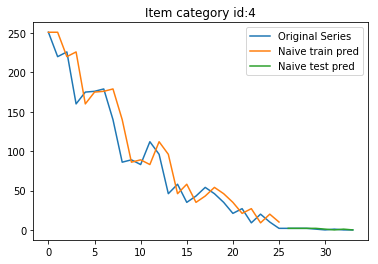

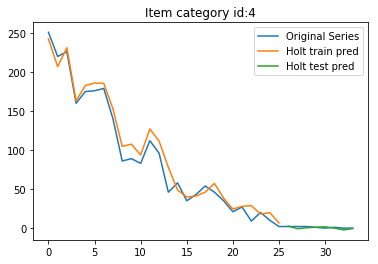

26 4 0.7071067811865476 1.5745574577835526


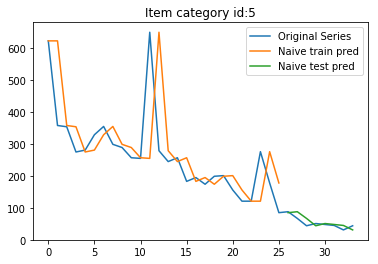

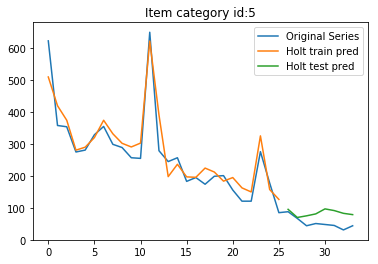

26 5 13.280624985293425 36.07935610593122


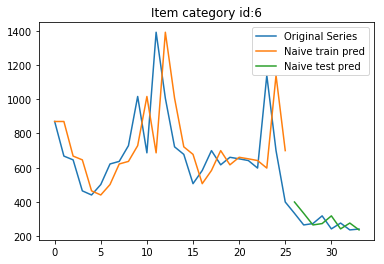

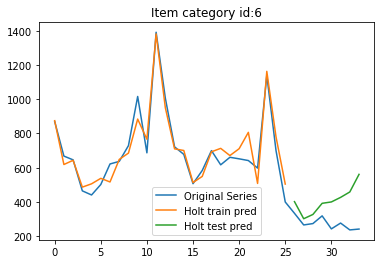

26 6 49.53029376048561 162.98590872936333


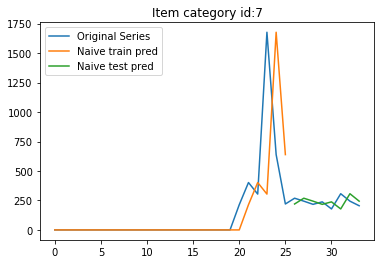

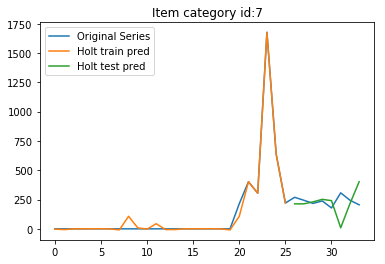

26 7 61.16269287727609 130.7288480470639


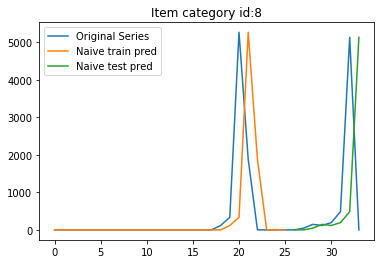

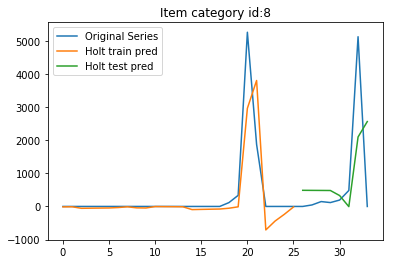

26 8 2449.1292074939615 1444.5773116767555


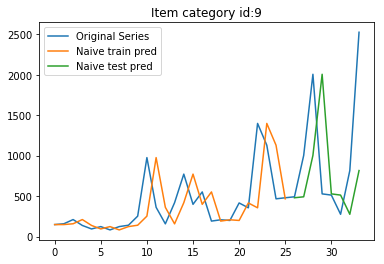

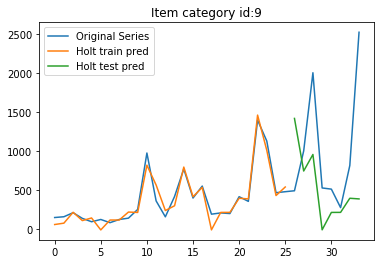

26 9 915.9732528846025 945.0600528736129


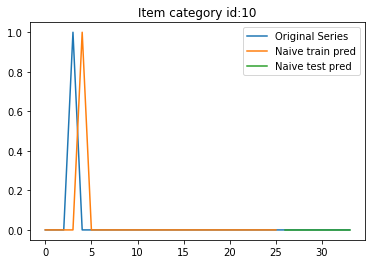

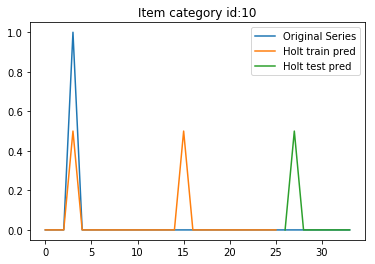

26 10 0.0 0.17677671304683612


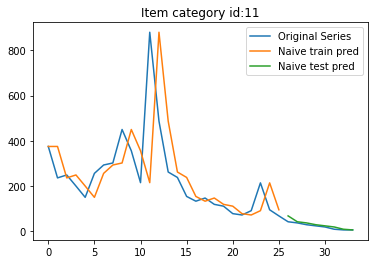

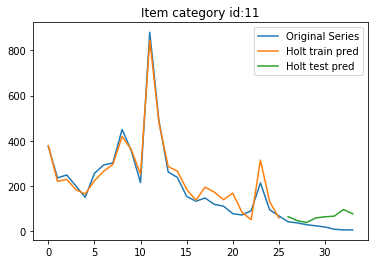

26 11 10.747092630102339 50.67091064399225


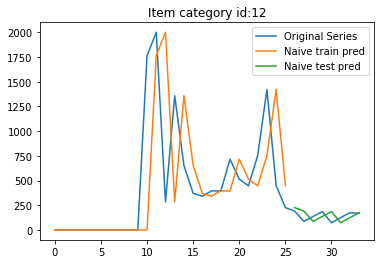

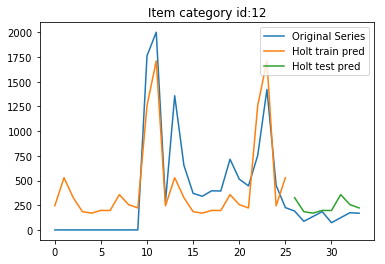

26 12 65.68199905605798 116.4529436992096


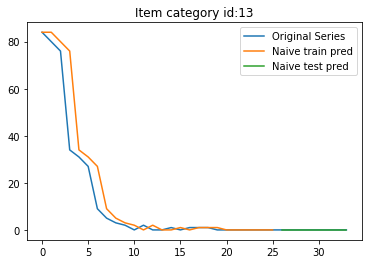

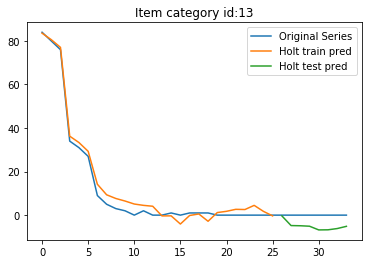

26 13 0.0 5.345729651929023


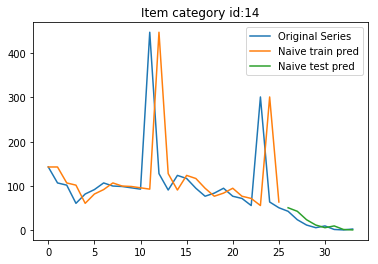

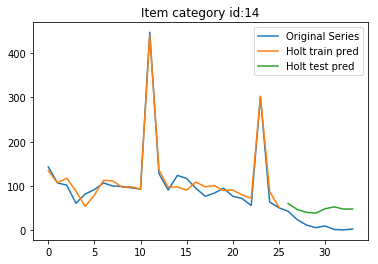

26 14 9.287087810503355 37.24657997820541


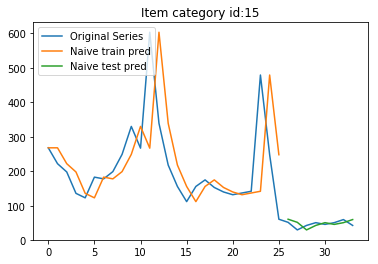

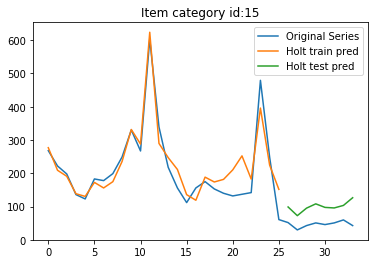

26 15 12.338962679253067 54.335578948430374


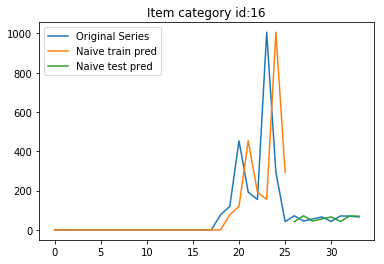

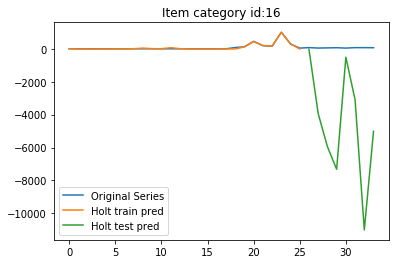

26 16 19.937402037376884 5757.368914804172


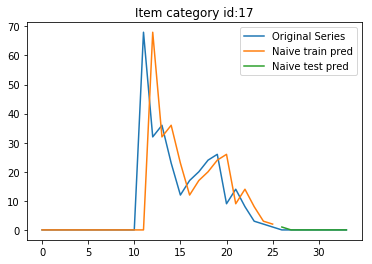

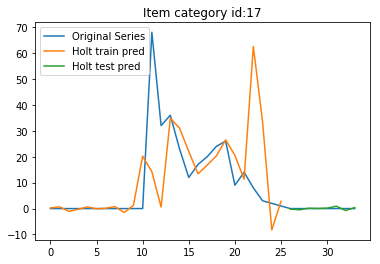

26 17 0.3535533905932738 0.4802709729658436


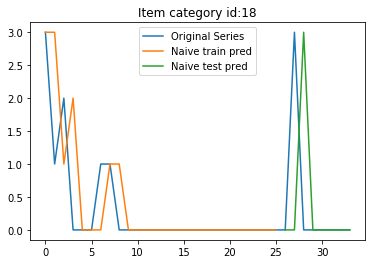

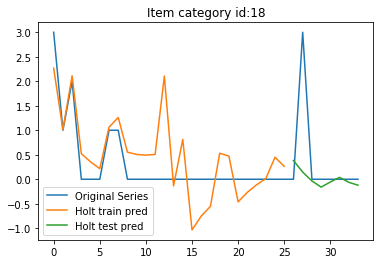

26 18 1.5 1.0211607695690057


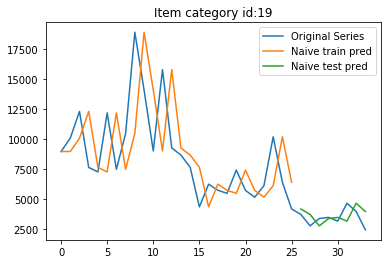

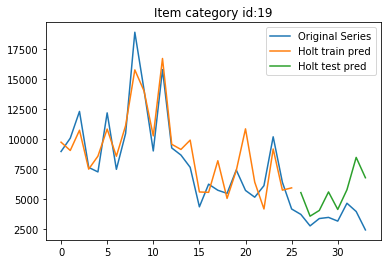

26 19 911.8733464686859 2511.698665166241


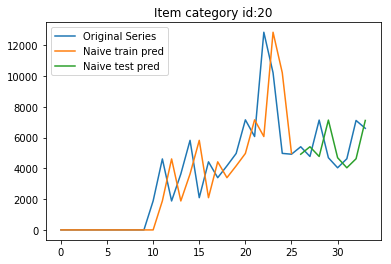

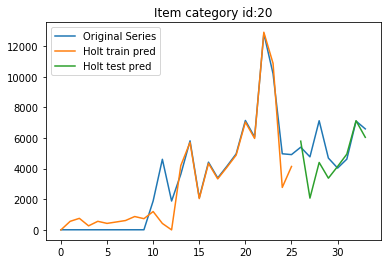

26 20 1557.0727744713797 1458.9328563656811


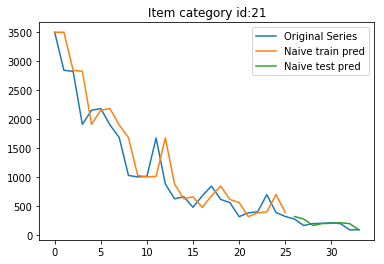

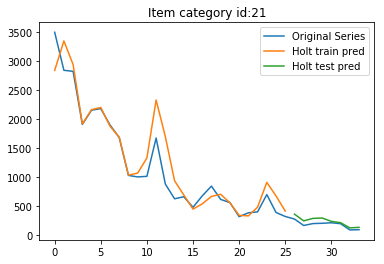

26 21 58.280571376746124 64.45815136482908


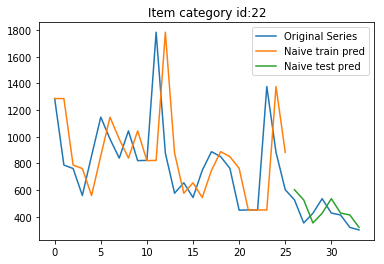

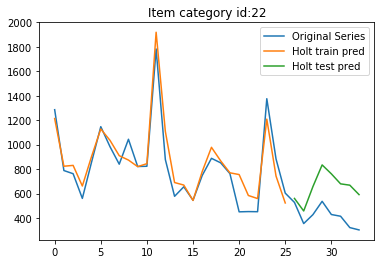

26 22 96.03710220534562 259.35872664466643


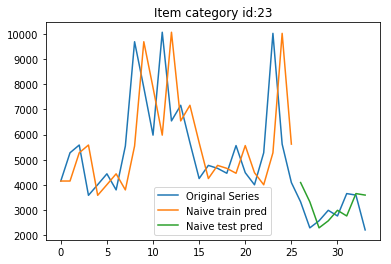

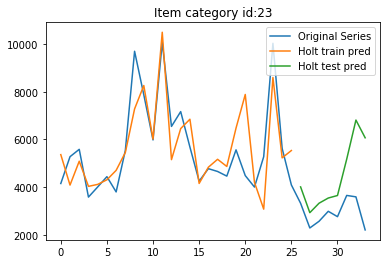

26 23 765.7098830497097 1942.7298954836187


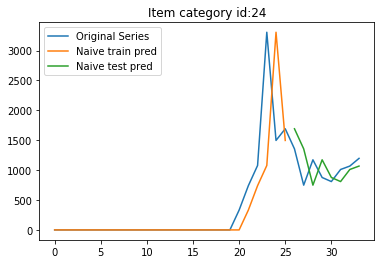

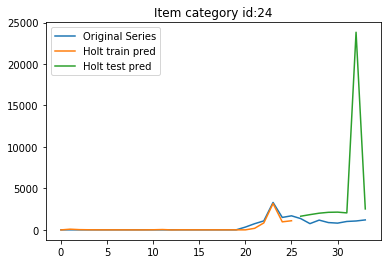

26 24 318.9935344172355 8110.865488628211


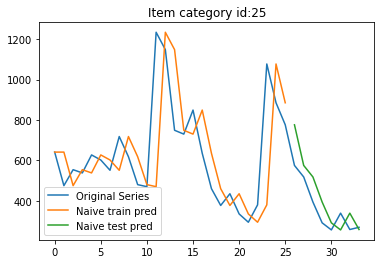

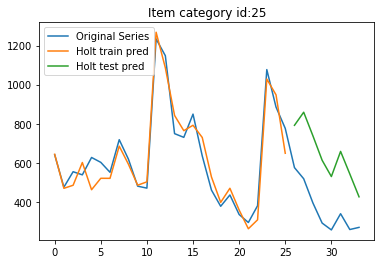

26 25 102.73205439394269 288.65891162759493


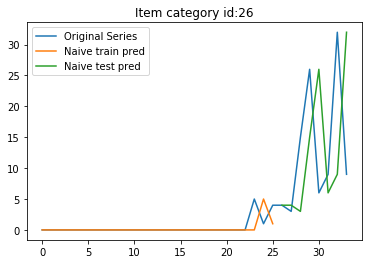

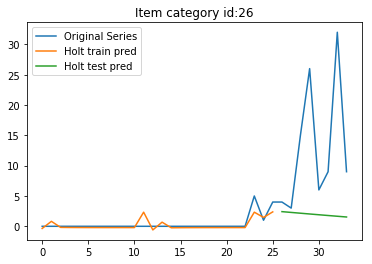

26 26 14.718186029535026 14.949098045601392


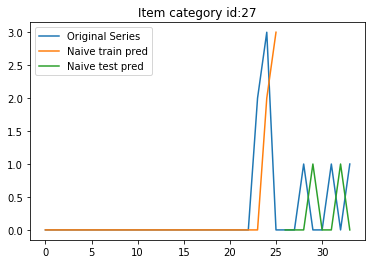

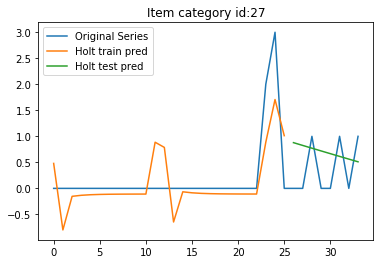

26 27 0.7905694150420949 0.6296550501282808


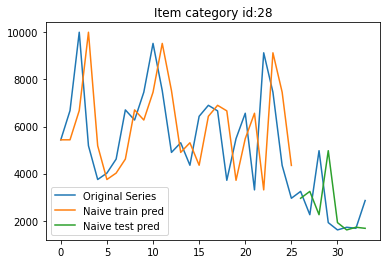

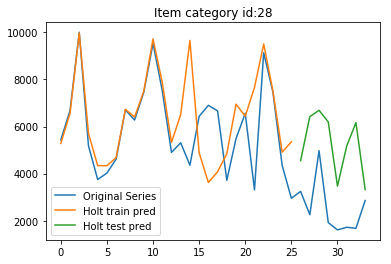

26 28 1552.4390487230087 3081.9729321254745


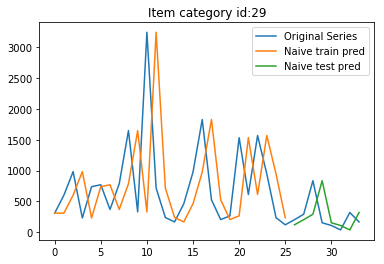

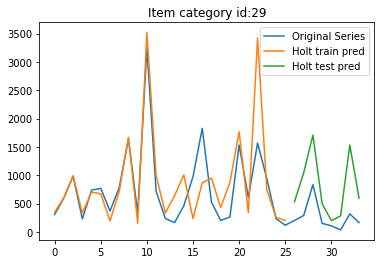

26 29 333.1966386385073 641.0979564514944


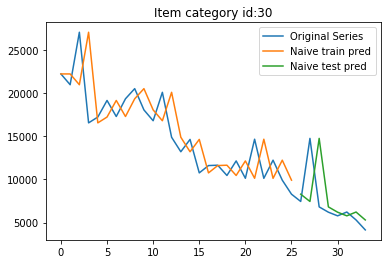

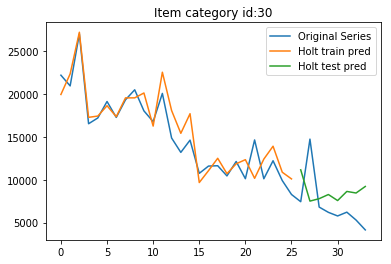

26 30 3872.374659043208 3812.9559643970424


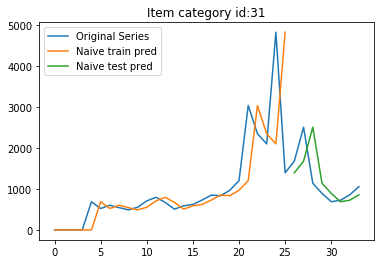

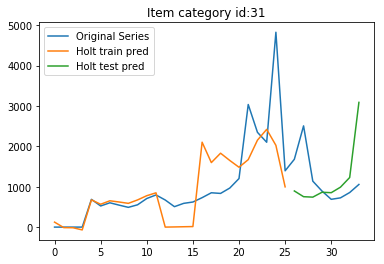

26 31 591.3364101761365 1012.9979417682334


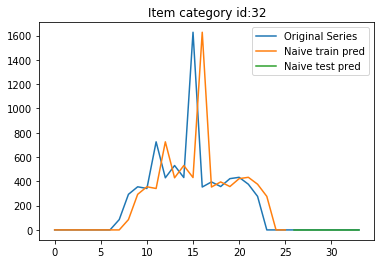

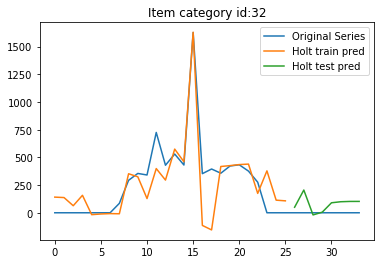

26 32 0.0 102.4471217628158


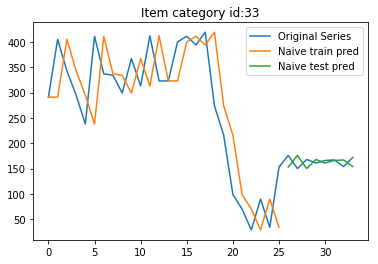

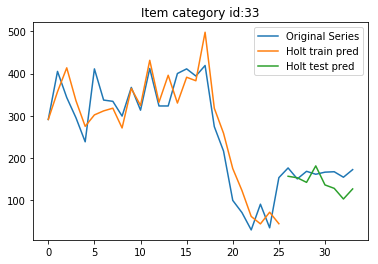

26 33 16.190274858692177 32.99683586514933


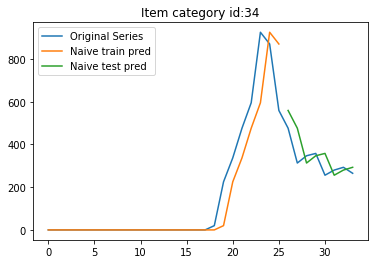

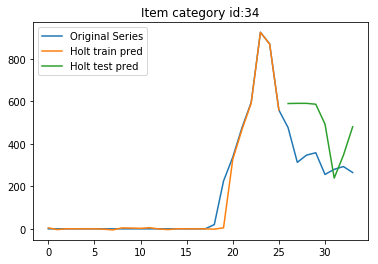

26 34 76.37735266425513 196.31574283445897


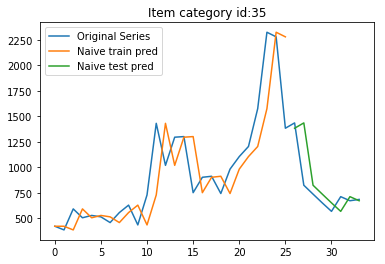

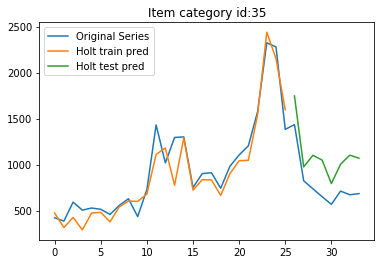

26 35 229.23350540442382 331.85739751326025


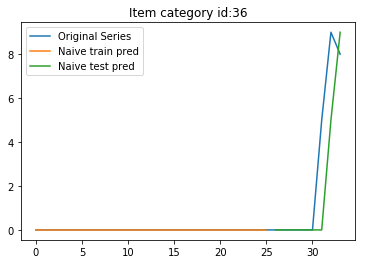

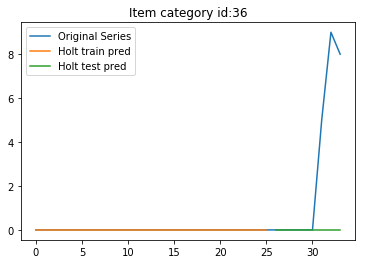

26 36 2.29128784747792 4.6097722286464435


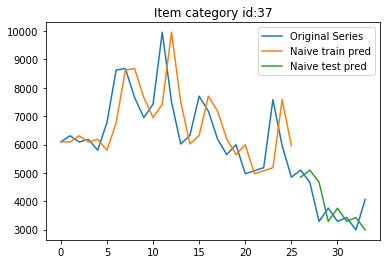

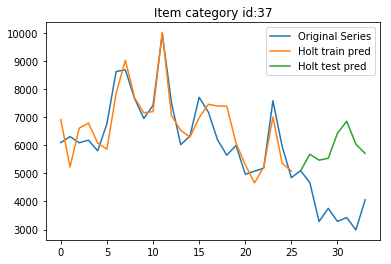

26 37 702.6499839891836 2304.525258499919


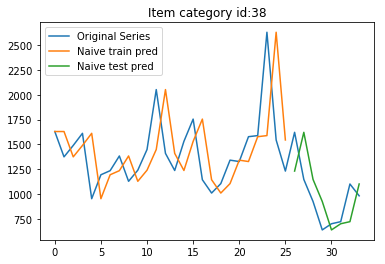

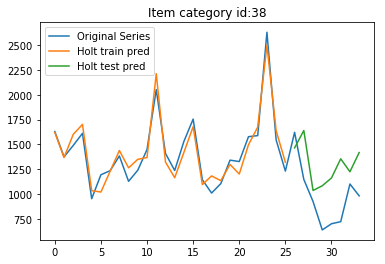

26 38 289.38361218286013 402.09656314598175


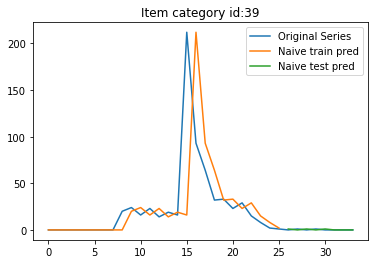

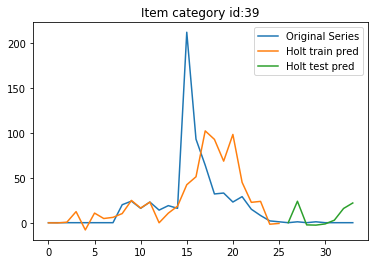

26 39 0.7905694150420949 12.672762730230989


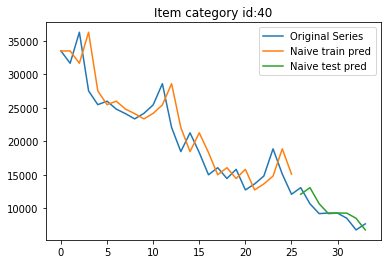

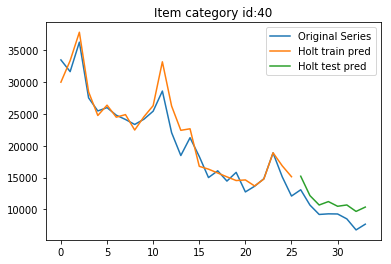

26 40 1290.8231869624901 2078.7867520678396


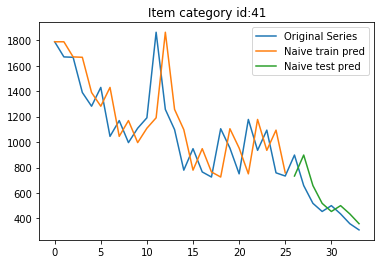

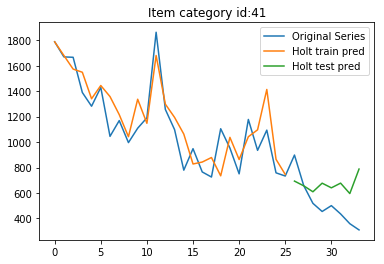

26 41 124.0927072796786 240.68843062643515


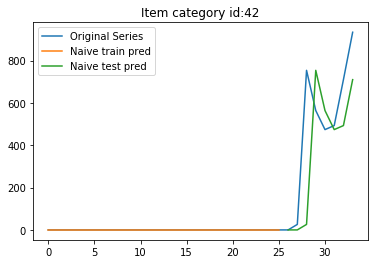

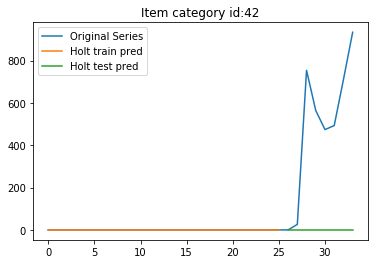

26 42 289.93231968857833 584.3232196310531


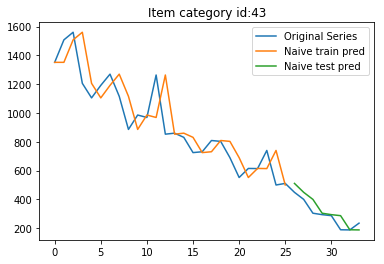

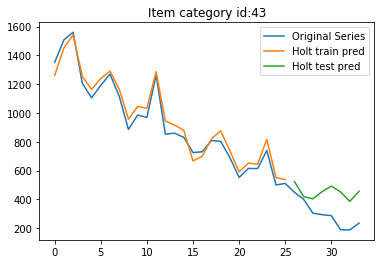

26 43 58.54912467321779 173.63788364916925


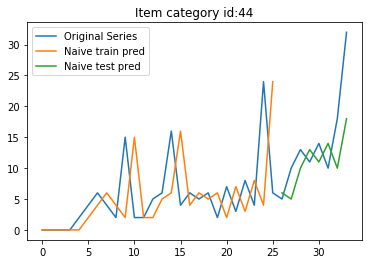

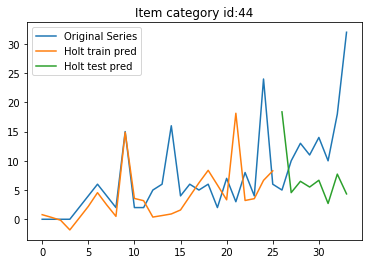

26 44 6.363961030678928 12.54186751349342


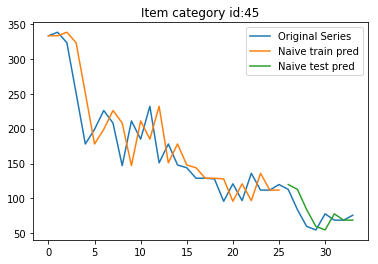

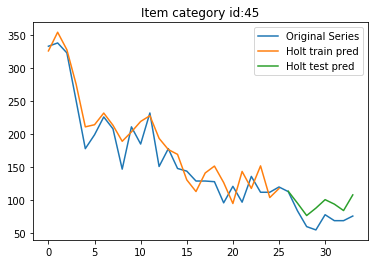

26 45 16.393596310755 22.10687295988423


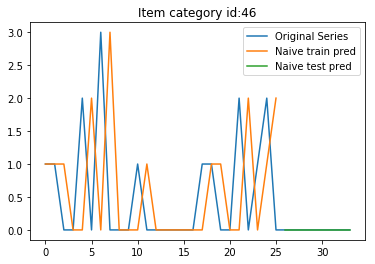

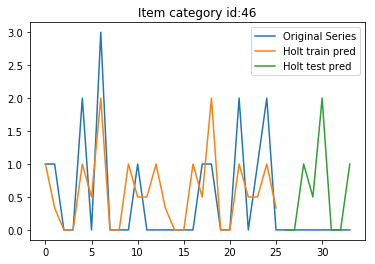

26 46 0.0 0.8838834419044604


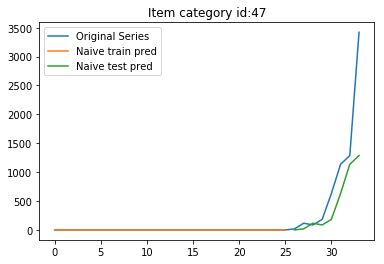

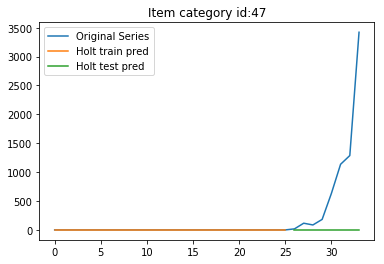

26 47 794.7909316291926 1373.9225778769342


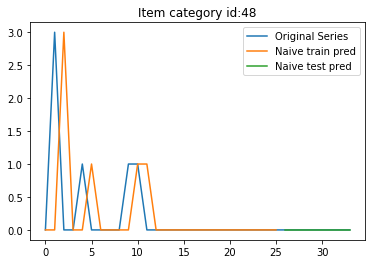

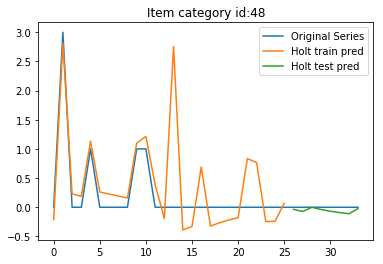

26 48 0.0 0.06498386829140135


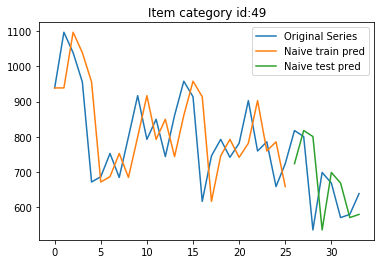

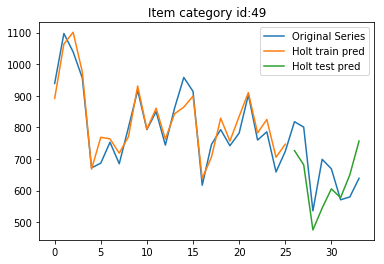

26 49 122.46683224448978 95.46536898814087


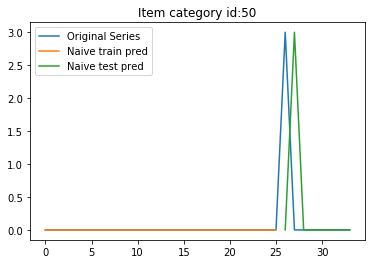

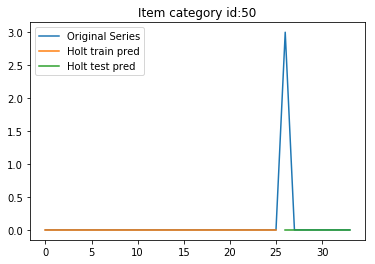

26 50 1.5 1.0606601717798212


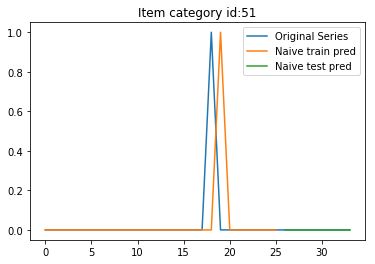

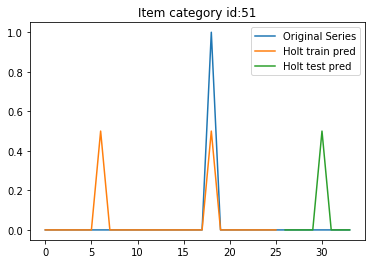

26 51 0.0 0.1767766743298559


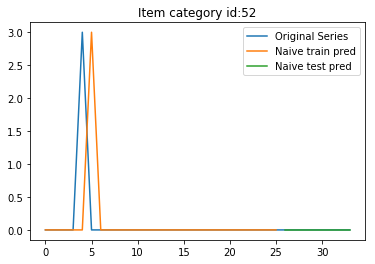

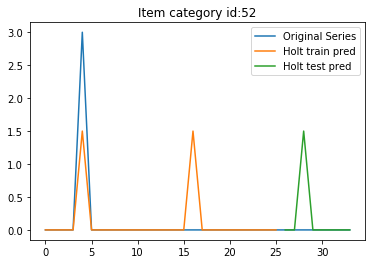

26 52 0.0 0.5303301005919067


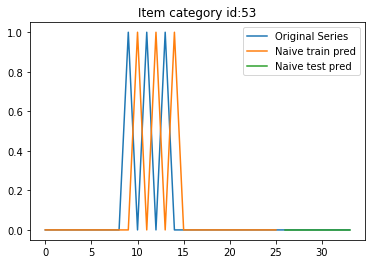

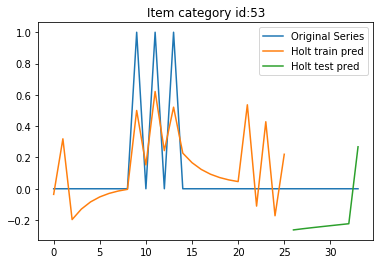

26 53 0.0 0.2462967587457266


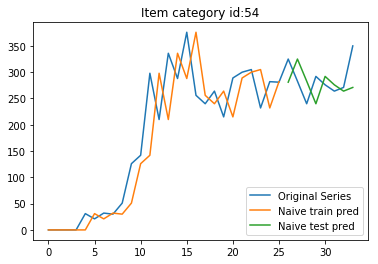

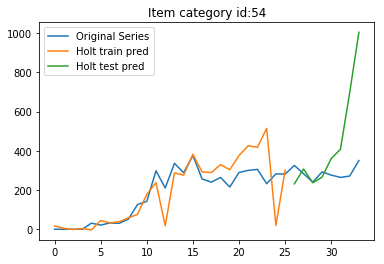

26 54 43.21891946821438 284.2259664685061


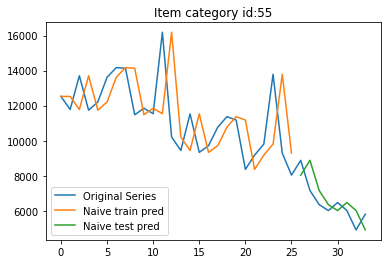

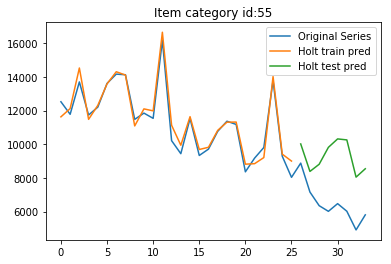

26 55 927.3902900073949 3028.7677144721574


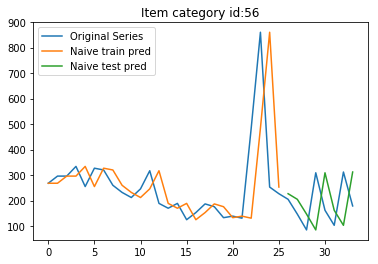

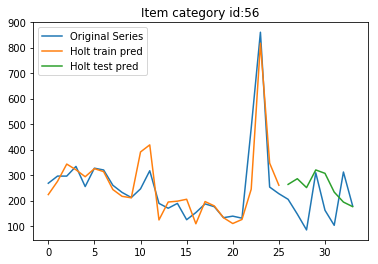

26 56 134.31678971744373 113.00246343472395


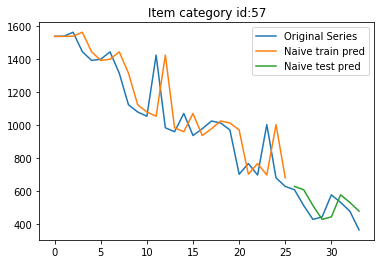

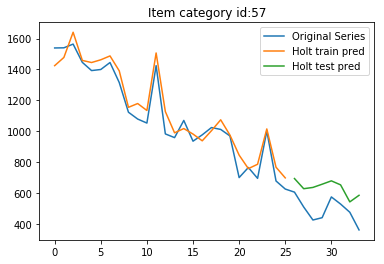

26 57 81.22037921605636 155.41878929490724


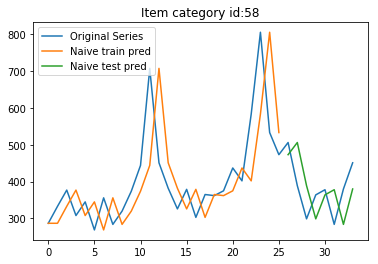

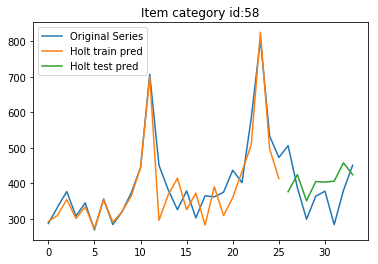

26 58 79.36623967405788 74.81353702942643


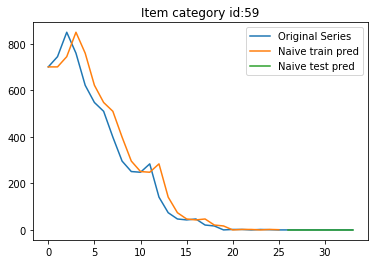

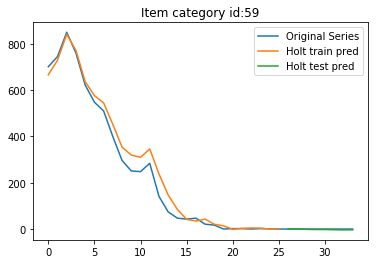

26 59 0.0 2.378061462587112


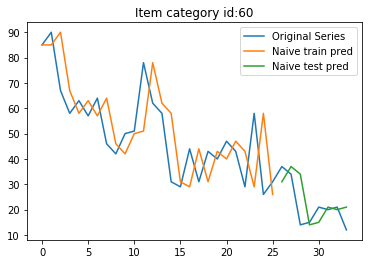

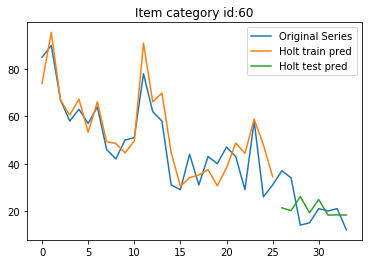

26 60 8.403868156985805 9.12384333575463


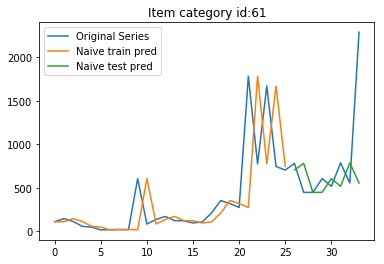

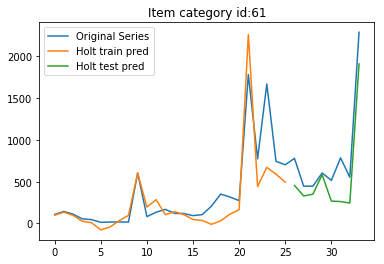

26 61 641.3648532621662 296.6305298432326


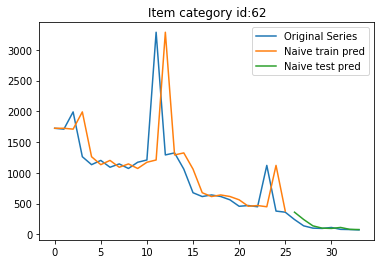

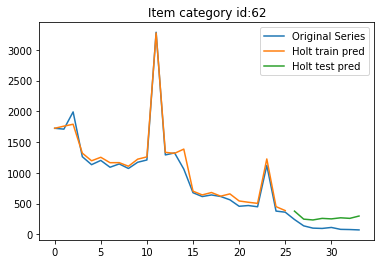

26 62 58.55125959362446 163.2776724917311


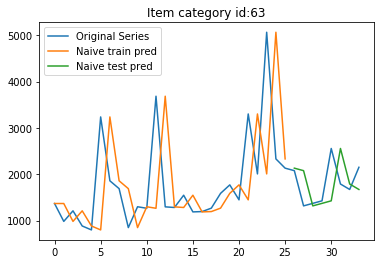

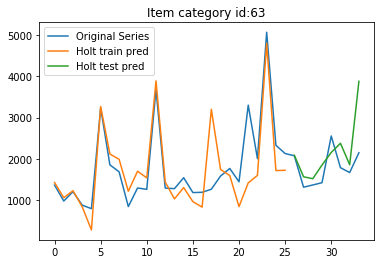

26 63 580.41052281984 689.0456167271559


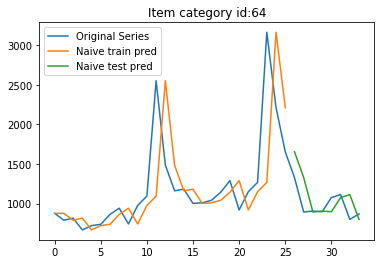

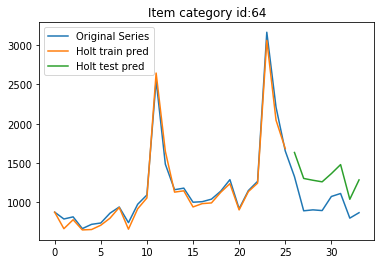

26 64 232.3050257743039 351.51833184420343


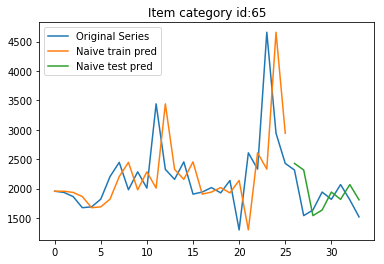

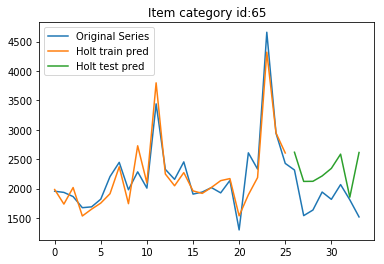

26 65 344.1511295927997 558.0517412077858


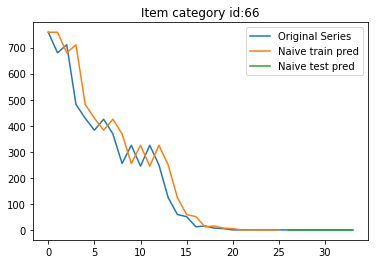

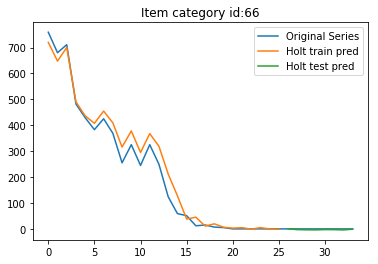

26 66 0.0 2.929310975117239


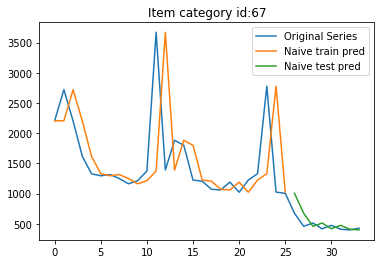

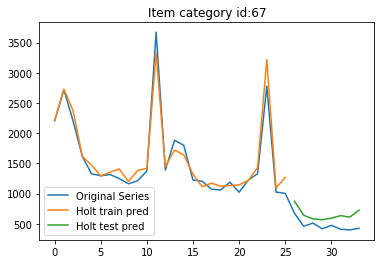

26 67 147.99366540497604 193.66853141177054


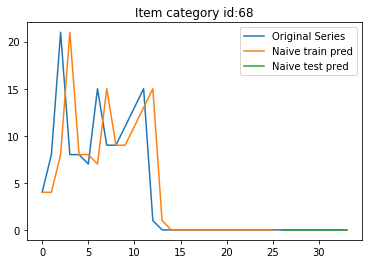

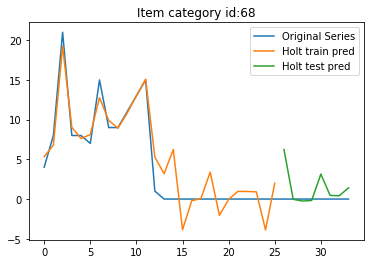

26 68 0.0 2.5314152561441734


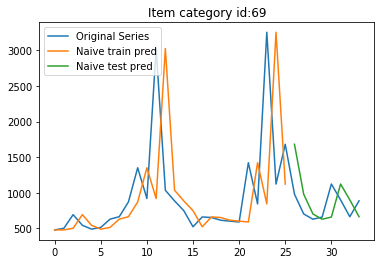

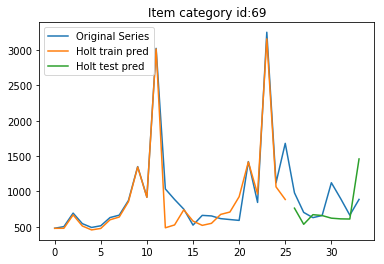

26 69 343.43030588461465 304.61012143638715


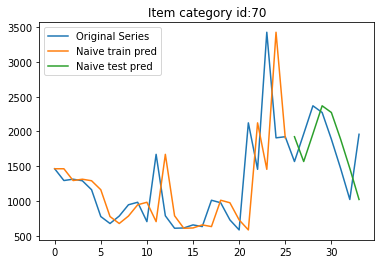

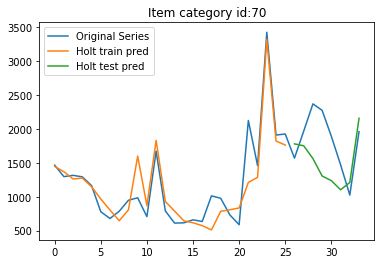

26 70 481.4204243693863 537.7456845281093


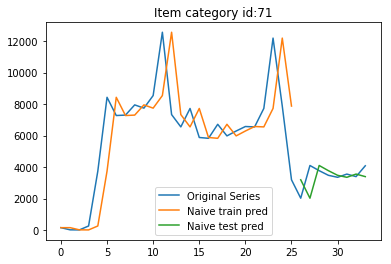

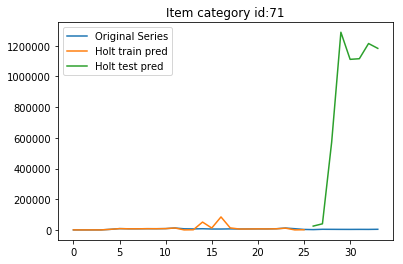

26 71 896.6962278274622 954729.3375342989


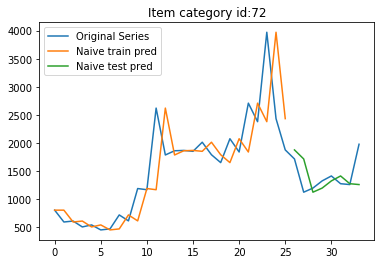

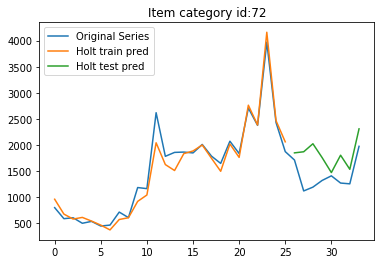

26 72 342.89849081032713 492.31668341552813


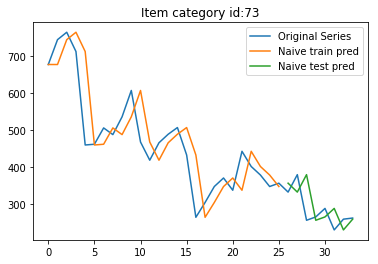

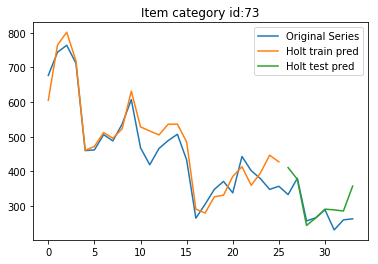

26 73 53.3127564472144 48.962141606315754


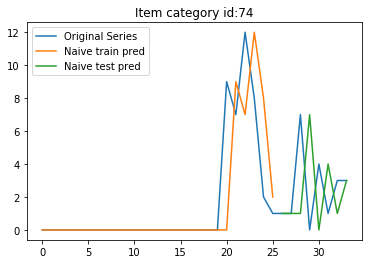

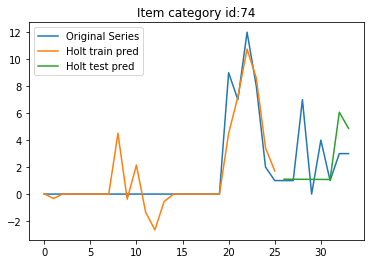

26 74 3.774917217635375 2.68075731820709


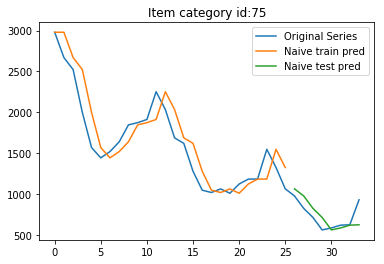

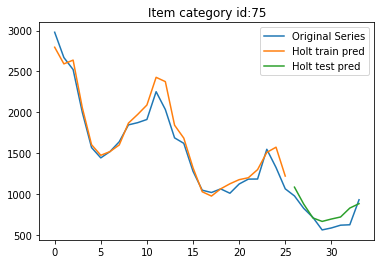

26 75 142.21286861602925 106.83611659969353


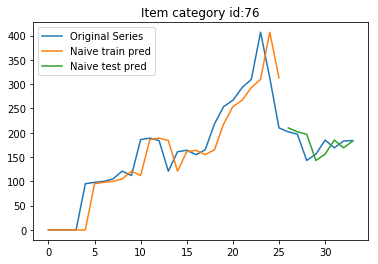

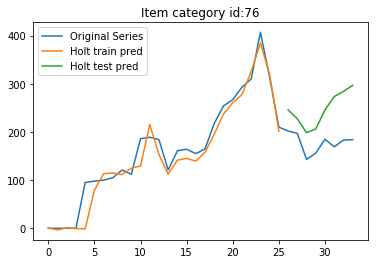

26 76 23.632604596192948 75.79083864658548


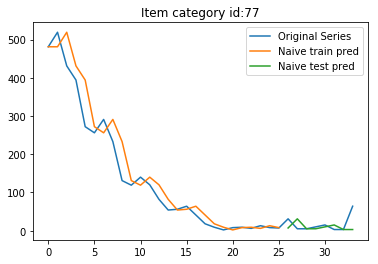

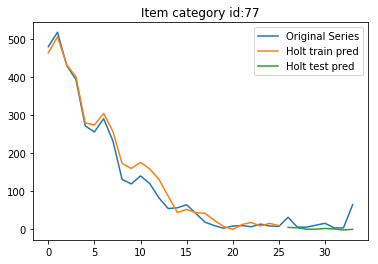

26 77 25.41407090570104 25.687731390872194


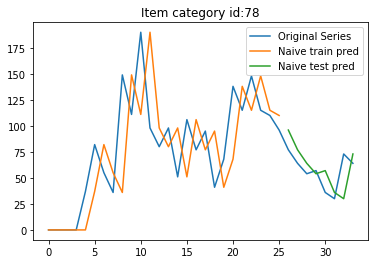

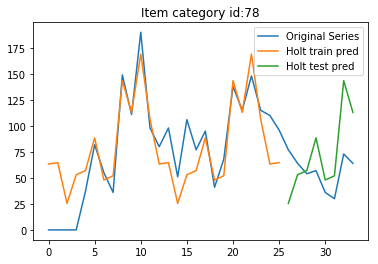

26 78 19.512816301087856 38.36334406372292


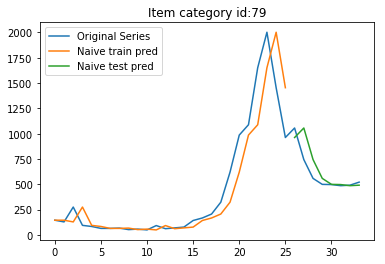

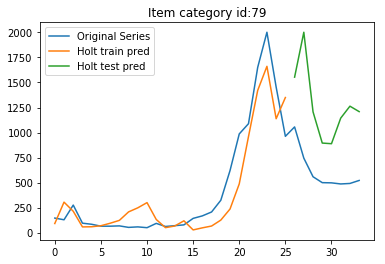

26 79 134.77156599223738 712.57388716891


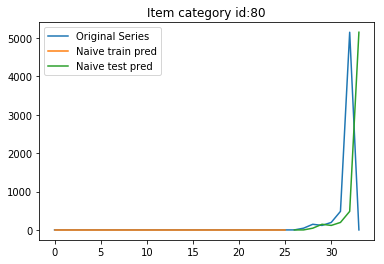

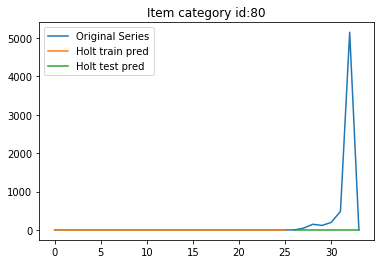

26 80 2459.3219085756136 1831.0119469845083


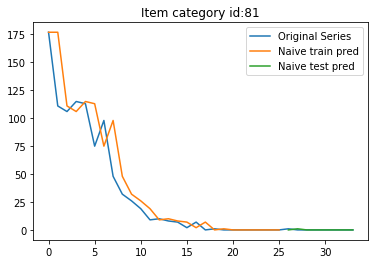

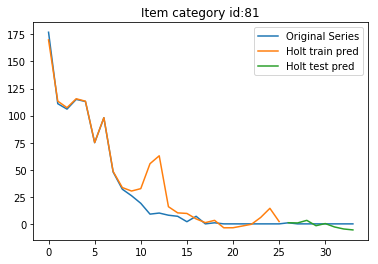

26 81 0.5 3.0734691862806987


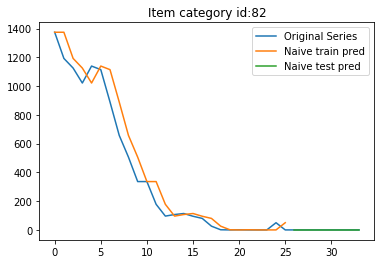

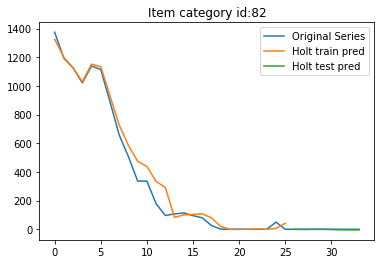

26 82 0.0 2.5868255492105092


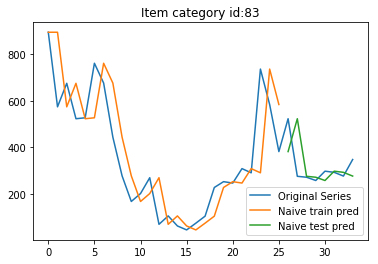

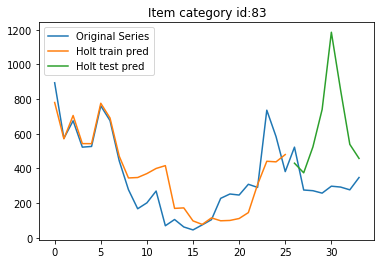

26 83 104.89518578085459 432.3646954469137


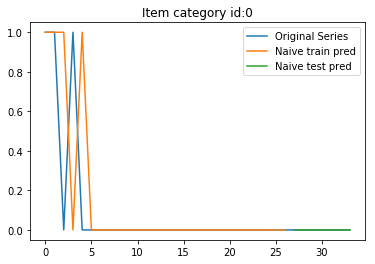

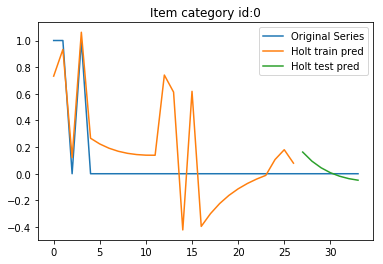

27 0 0.0 0.07696995669680462


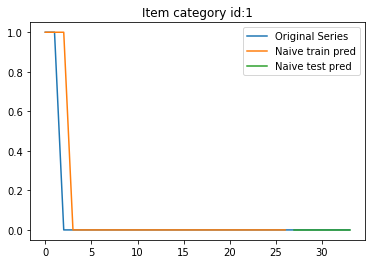

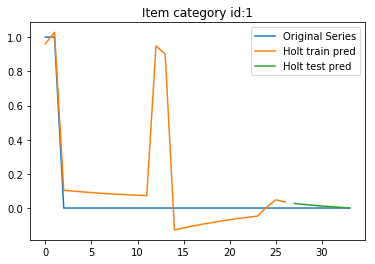

27 1 0.0 0.01537521366221299


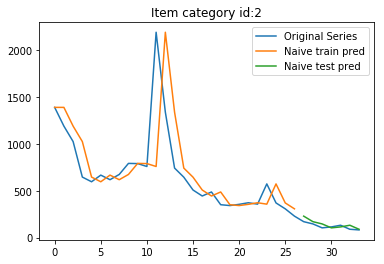

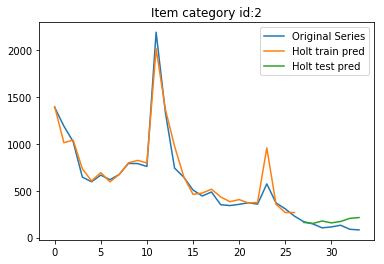

27 2 34.10697456951751 75.43436266119141


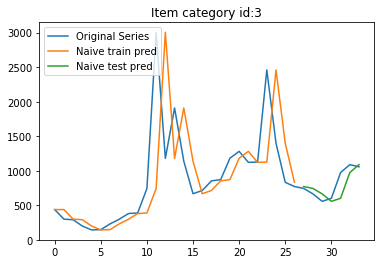

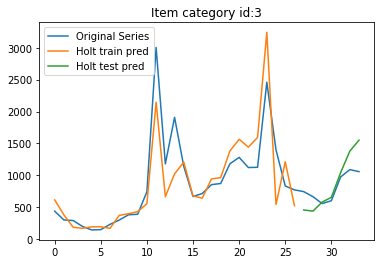

27 3 157.27137601701625 258.8662138754294


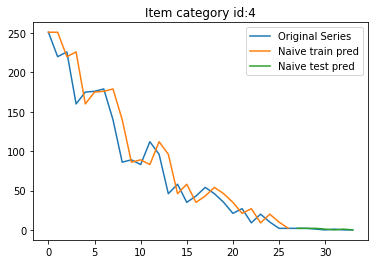

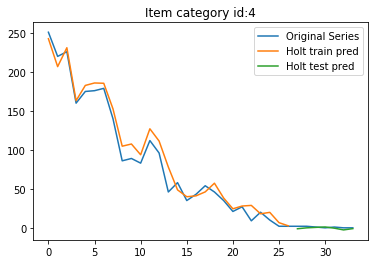

27 4 0.7559289460184544 1.9278479181816568


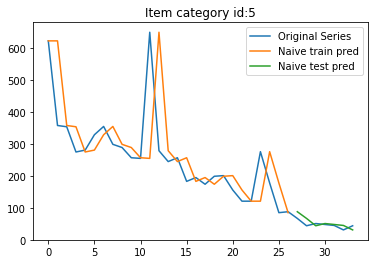

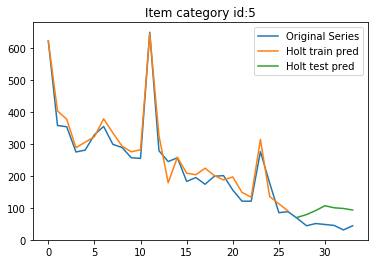

27 5 14.152233544063435 48.31621890965625


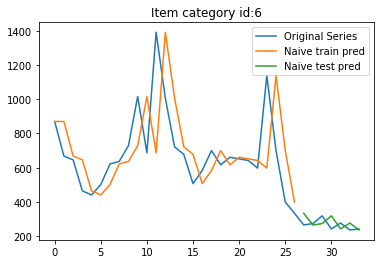

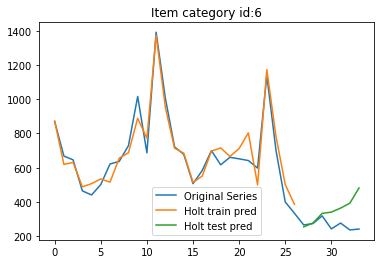

27 6 46.70576593343237 119.14430956292635


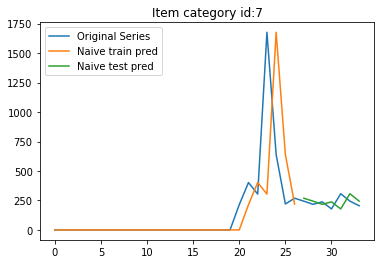

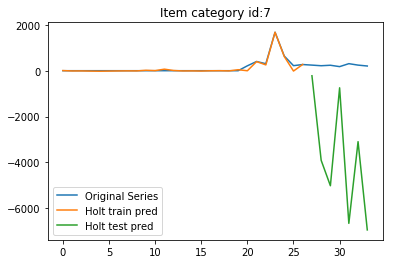

27 7 62.70793980259369 4728.610306430887


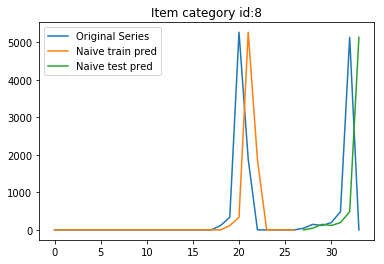

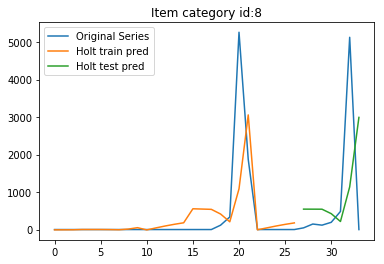

27 8 2618.2292543953113 1912.0178174544478


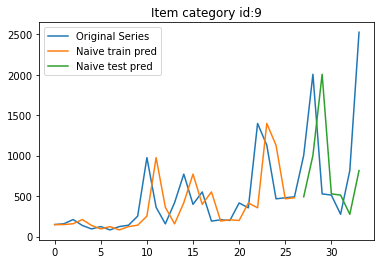

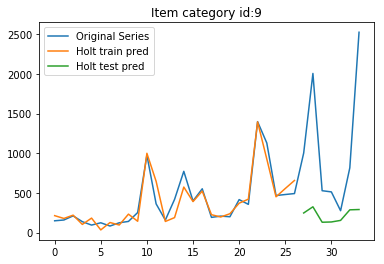

27 9 979.2060924180219 1132.282405115108


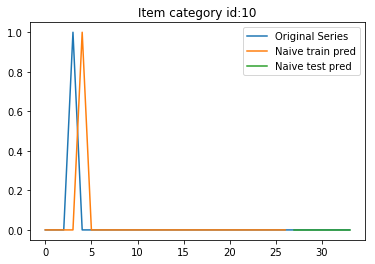

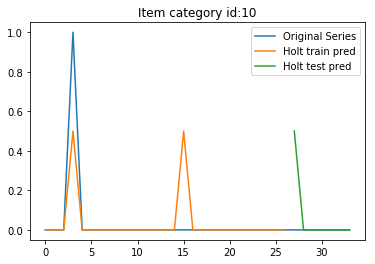

27 10 0.0 0.1889815537146596


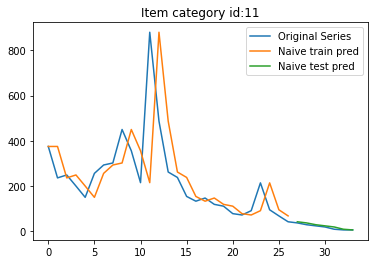

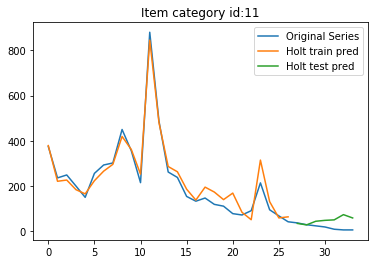

27 11 5.9521904731427595 38.45924572048406


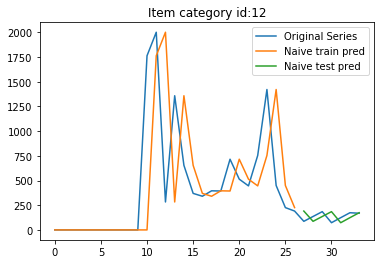

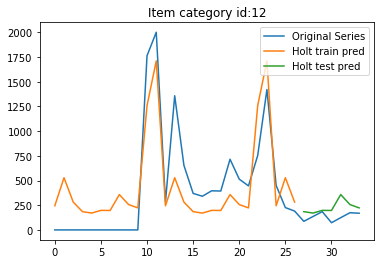

27 12 68.95961551102624 113.91038356852337


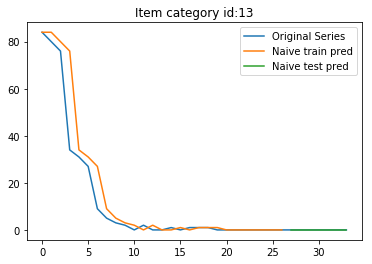

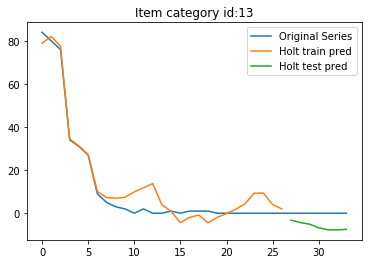

27 13 0.0 6.2718947077218195


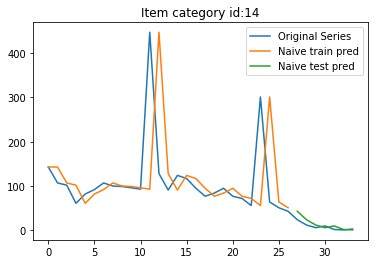

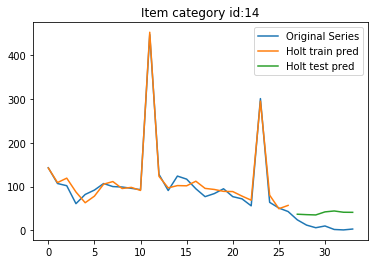

27 14 9.456668093391638 32.736757618239324


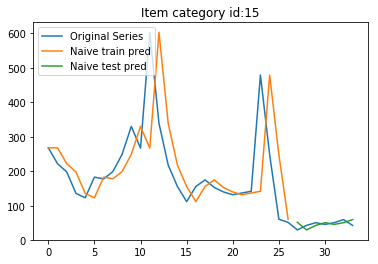

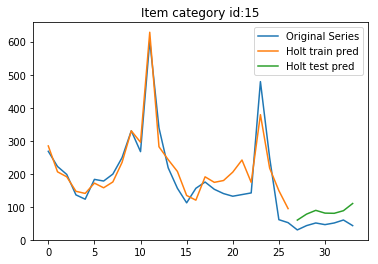

27 15 12.744746816966252 39.47083027143173


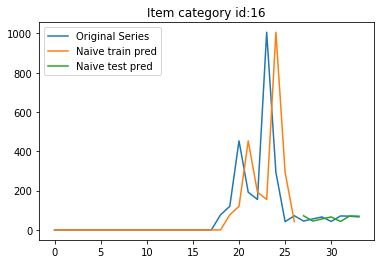

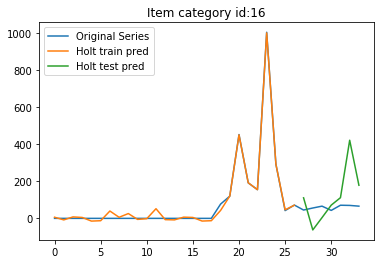

27 16 18.04755622554715 151.9293666606341


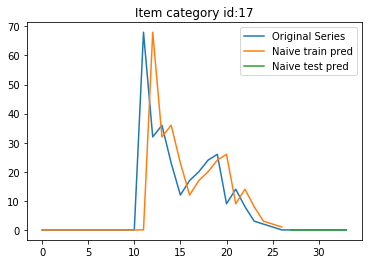

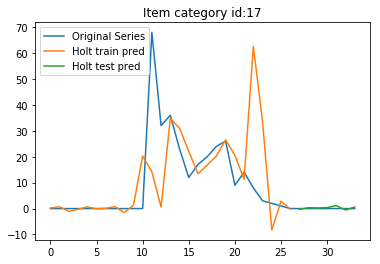

27 17 0.0 0.5787050246927595


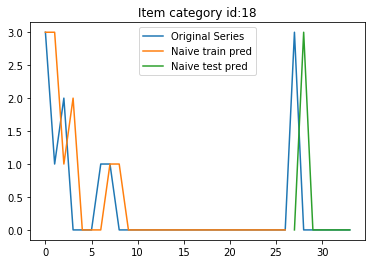

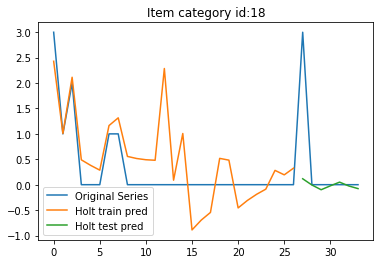

27 18 1.6035674514745464 1.0910993505549456


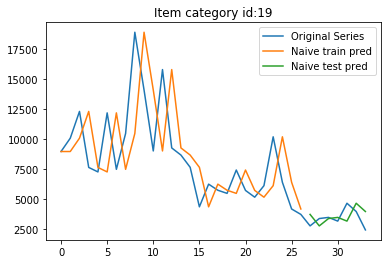

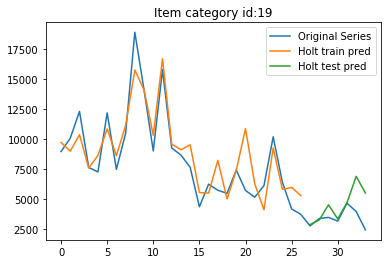

27 19 959.746990468991 1658.365303287596


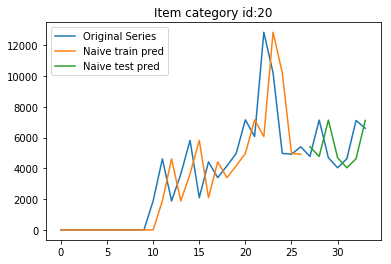

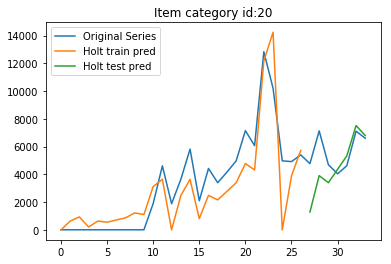

27 20 1654.4981543831177 1892.4864013218073


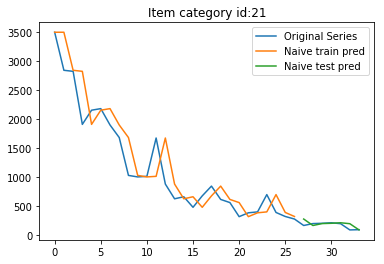

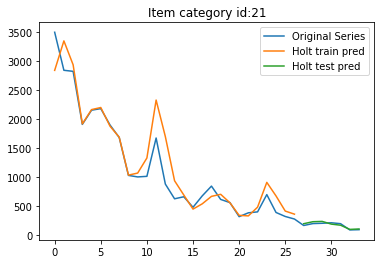

27 21 60.04403146263344 25.262703239493565


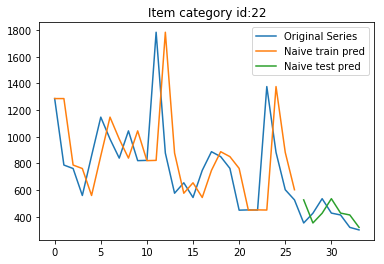

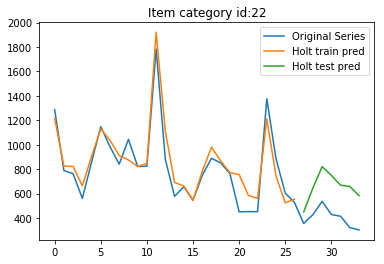

27 22 98.5675982692661 266.3487544719715


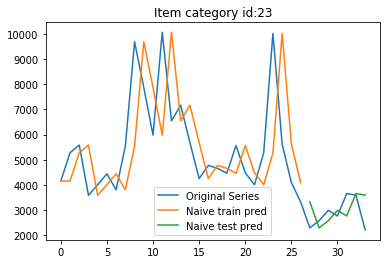

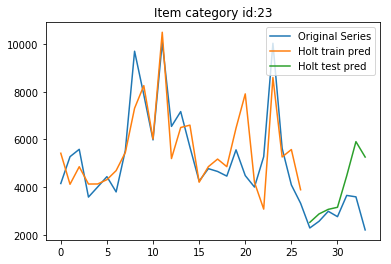

27 23 765.2387115889301 1497.2700925141023


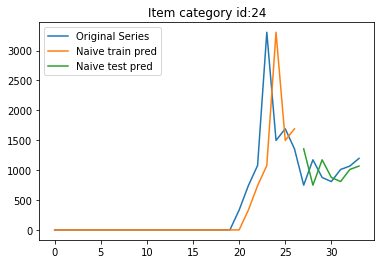

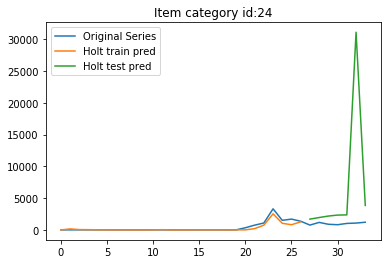

27 24 316.48944915837467 11437.369280064386


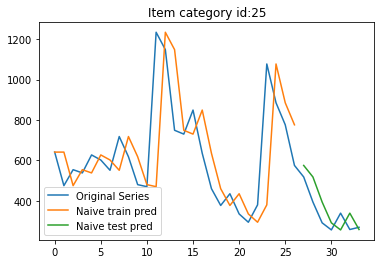

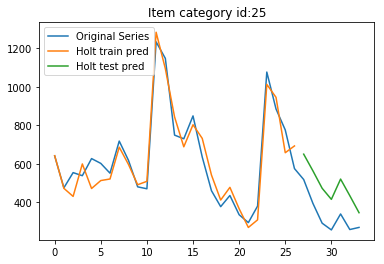

27 25 79.30952023559341 157.6732283911193


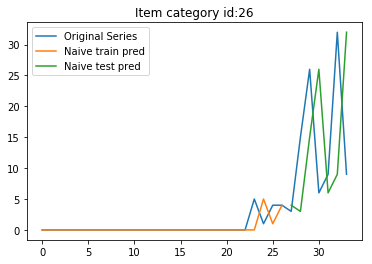

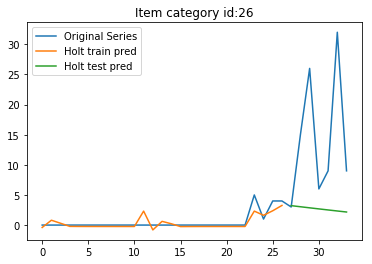

27 26 15.734402707806503 15.390886901178792


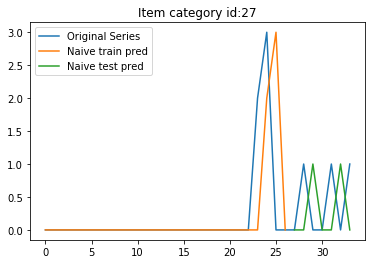

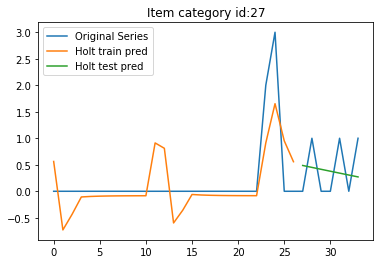

27 27 0.8451542547285166 0.52258075763919


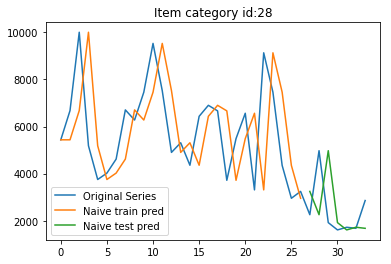

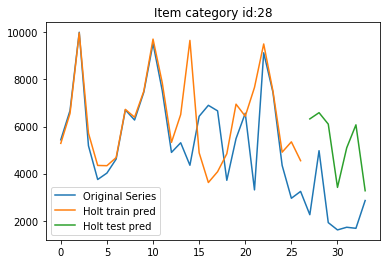

27 28 1655.9785626631765 3179.506262491527


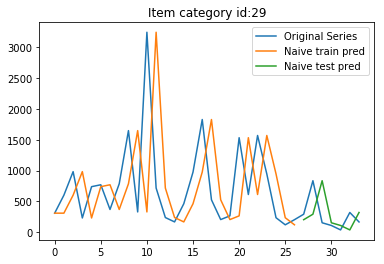

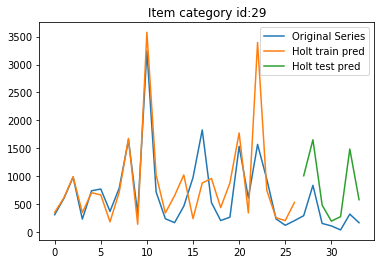

27 29 354.8180620301863 641.6809183762149


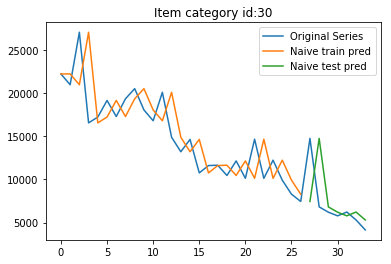

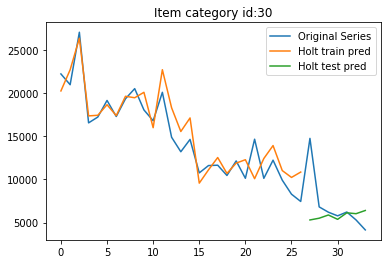

27 30 4127.462641519952 3719.476877525283


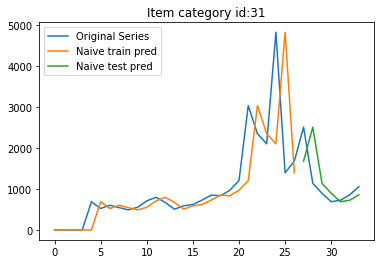

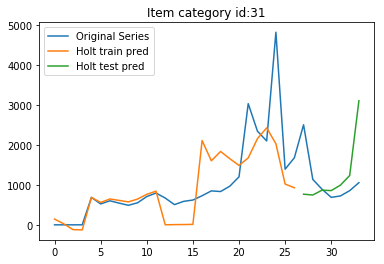

27 31 622.9199673427444 1044.1628510320465


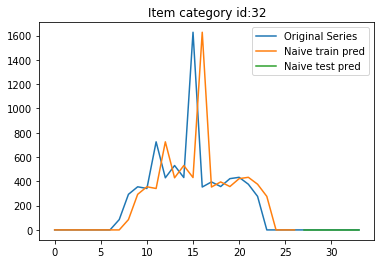

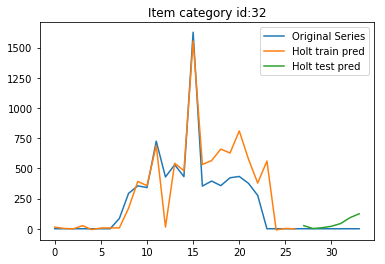

27 32 0.0 61.82391964488037


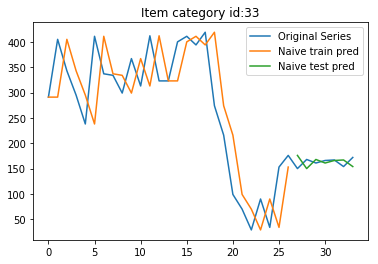

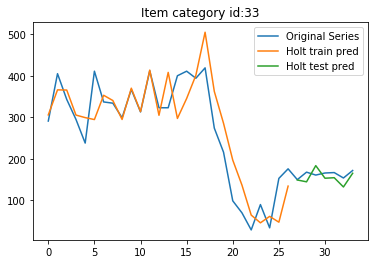

27 33 14.966629547095765 16.38939824397778


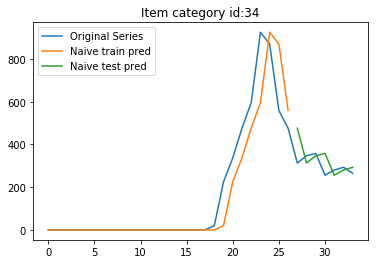

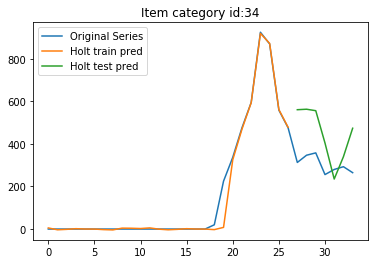

27 34 75.38377999088587 176.21131920873643


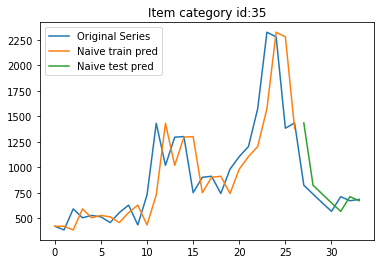

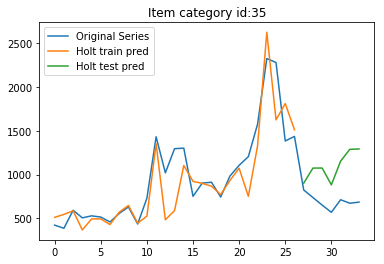

27 35 244.27151170075365 437.10988690495583


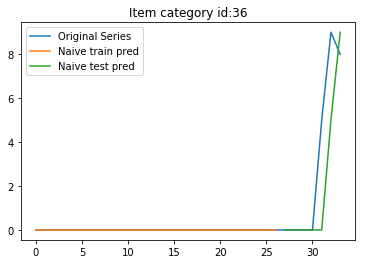

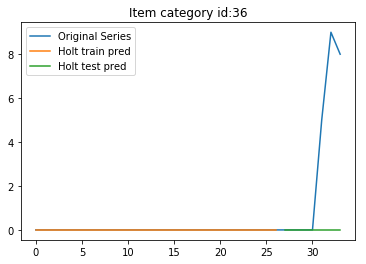

27 36 2.449489742783178 4.928053803045811


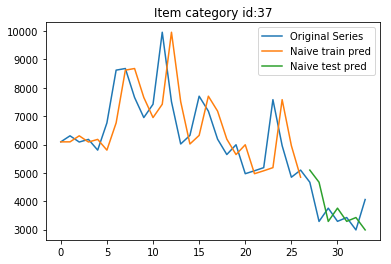

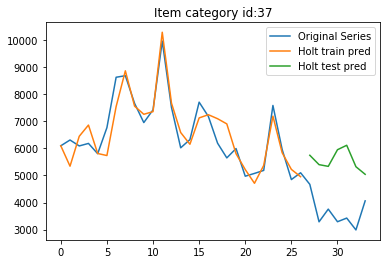

27 37 745.1495535413392 2027.441297470405


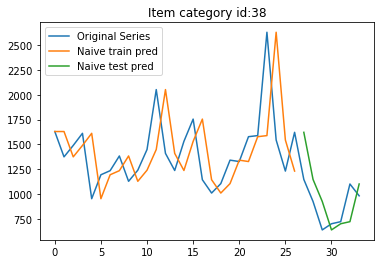

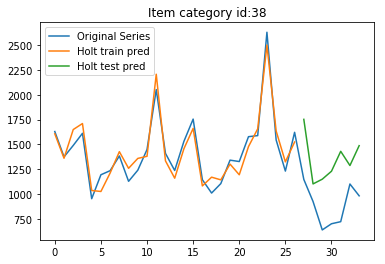

27 38 271.9881825163943 496.70554040536774


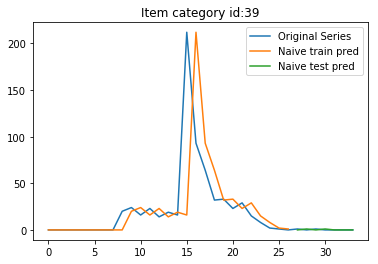

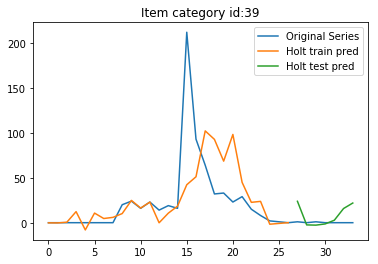

27 39 0.7559289460184544 13.511583204699686


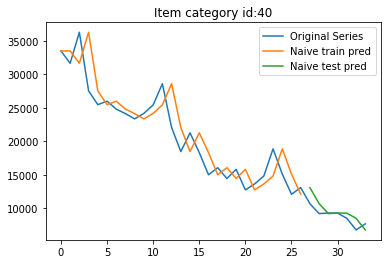

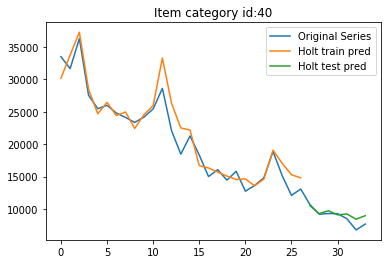

27 40 1328.8846021059487 860.743527084166


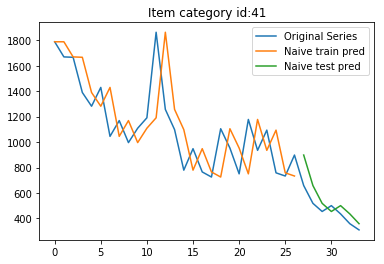

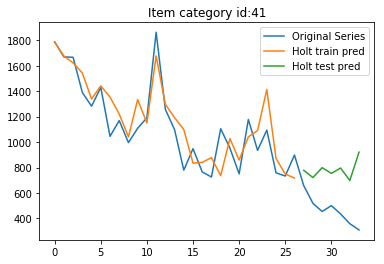

27 41 117.0878790847773 350.2216438326536


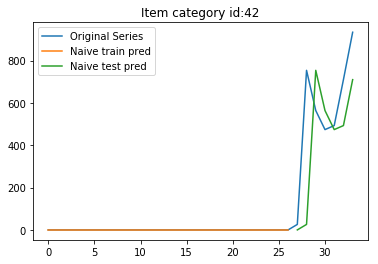

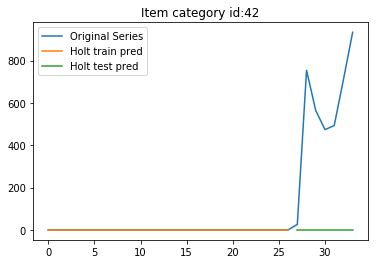

27 42 309.950687322078 624.6677974274463


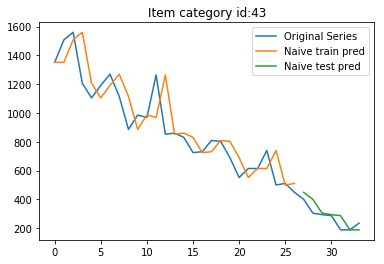

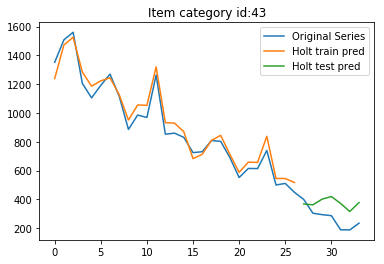

27 43 58.039395487646395 121.90031147347044


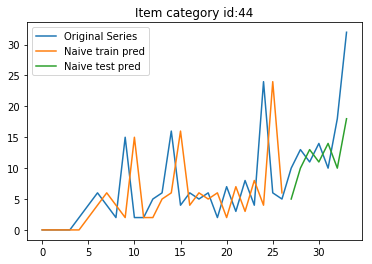

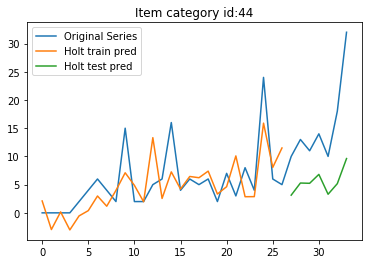

27 44 6.792853387410709 11.351393654900807


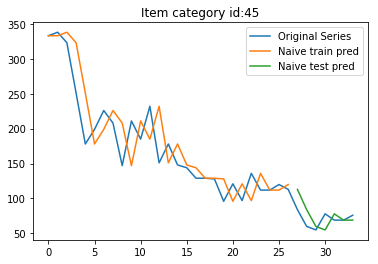

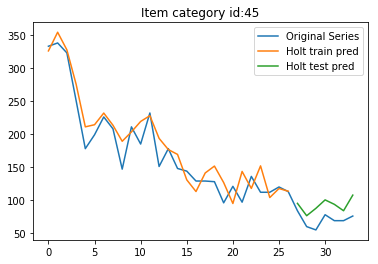

27 45 17.324631515355737 23.3235749311722


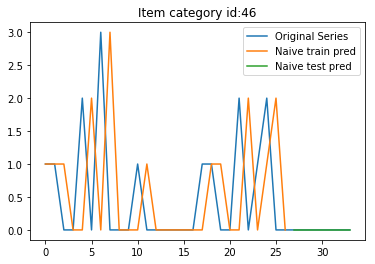

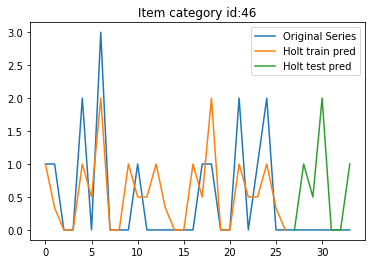

27 46 0.0 0.9449111351133623


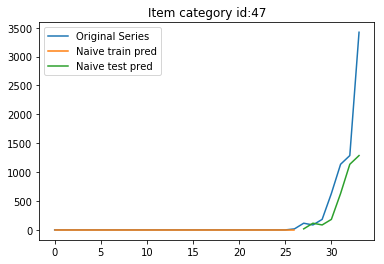

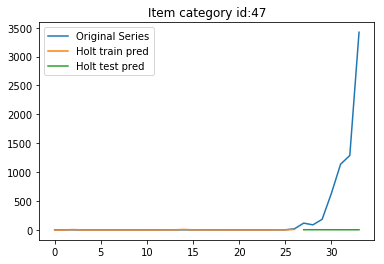

27 47 849.6400078016235 1468.1206938188259


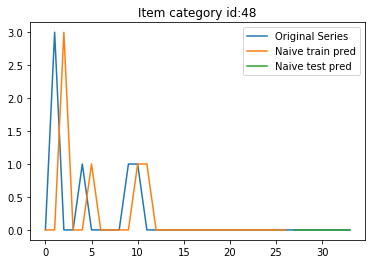

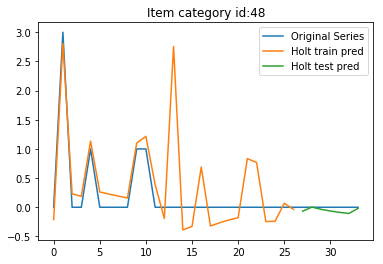

27 48 0.0 0.0649437791110088


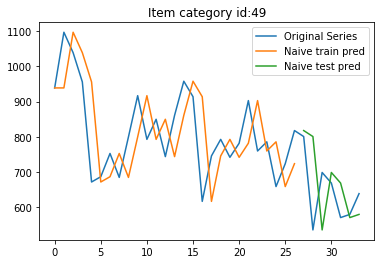

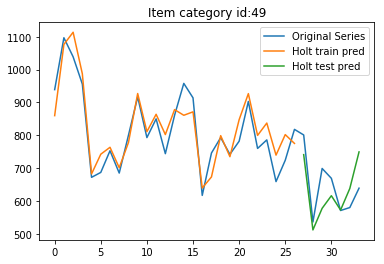

27 49 126.00963681968364 72.95440568257739


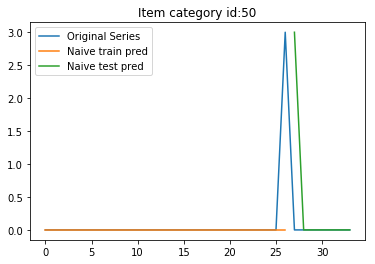

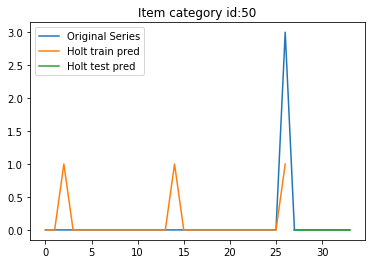

27 50 1.1338934190276817 2.781410537797855e-08


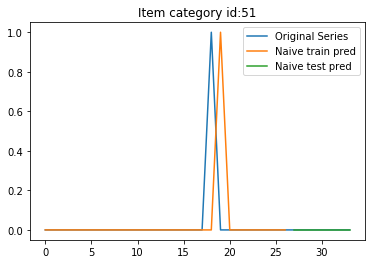

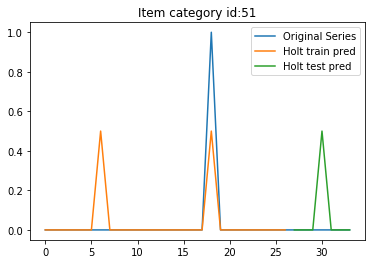

27 51 0.0 0.18898221911750784


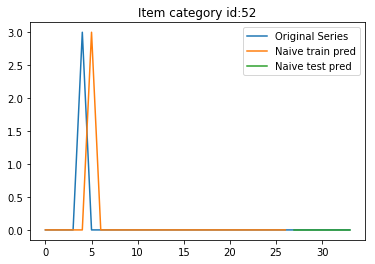

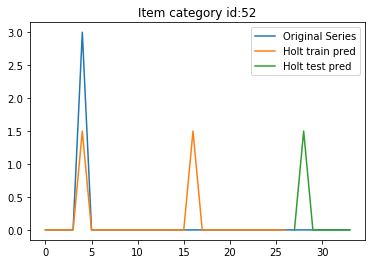

27 52 0.0 0.5669466976479719


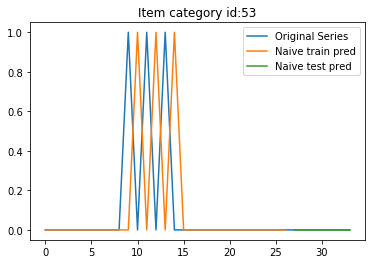

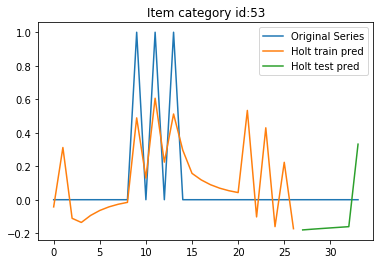

27 53 0.0 0.20164181571643394


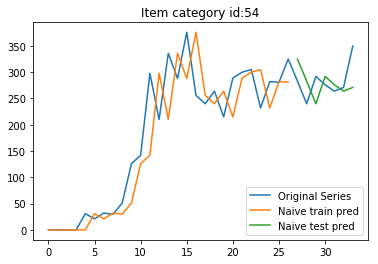

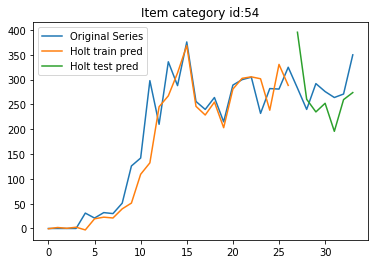

27 54 43.106181194149606 62.627954960821846


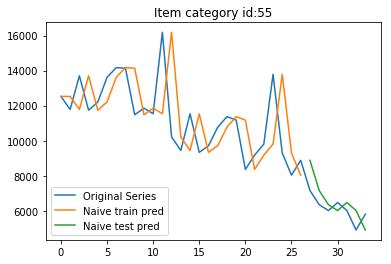

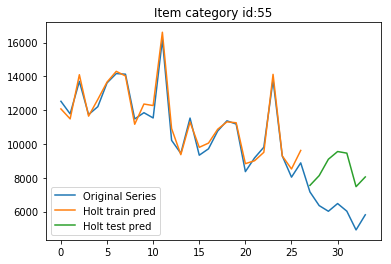

27 55 938.5701130671364 2553.547934151708


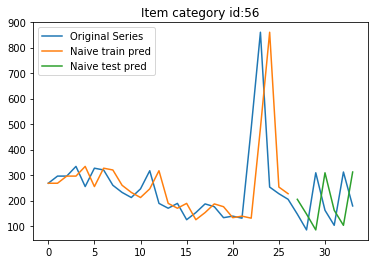

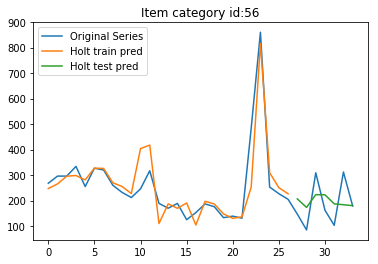

27 56 143.34972220811193 81.01373285287754


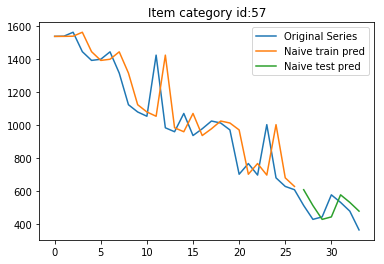

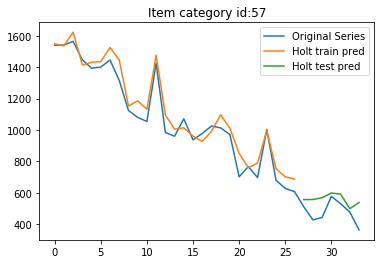

27 57 86.49855490122364 99.62400662796769


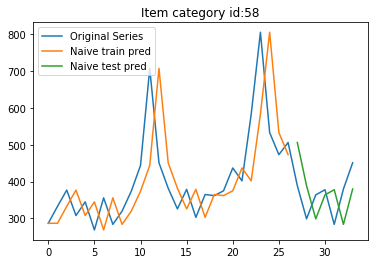

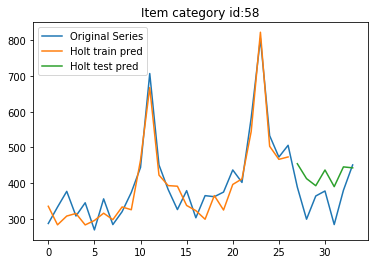

27 58 83.92428560485763 72.83192397910834


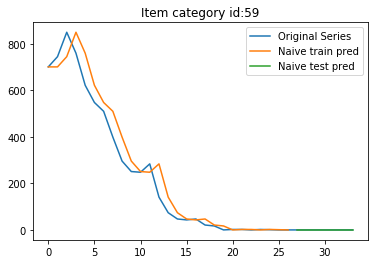

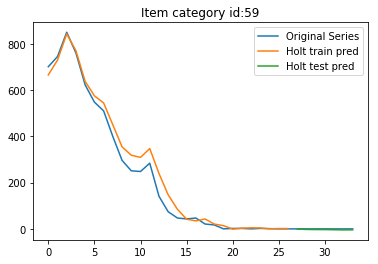

27 59 0.0 3.279674639951028


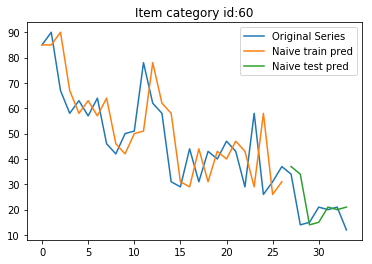

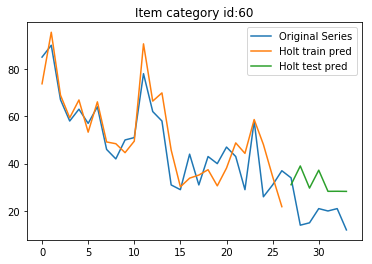

27 60 8.693182879212227 14.639112122635483


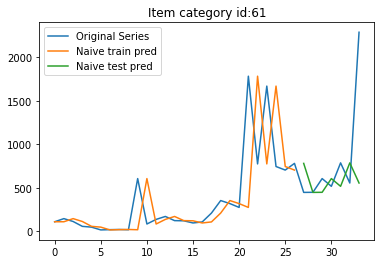

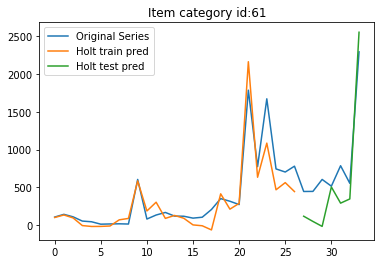

27 61 685.0299263535863 378.4837248289608


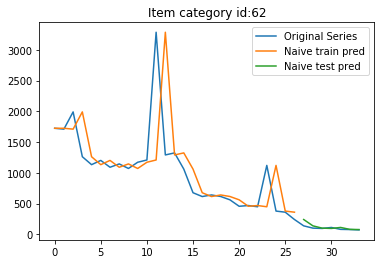

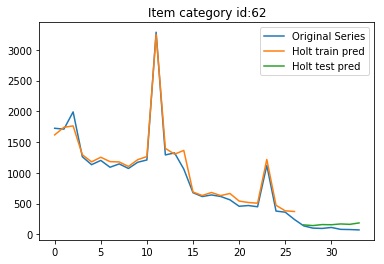

27 62 43.53159771935783 71.36600669412562


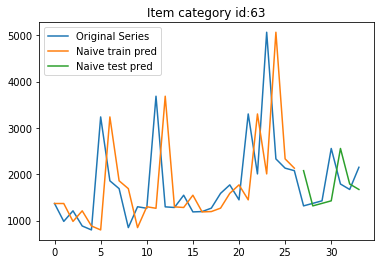

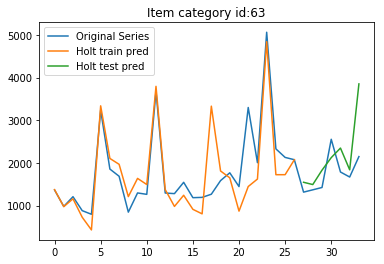

27 63 620.1491756021288 723.6522351532202


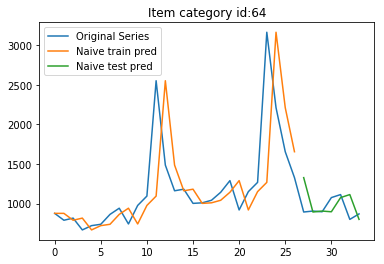

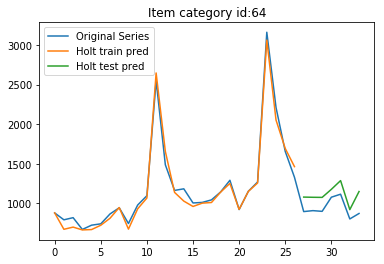

27 64 215.40526588602373 178.85687829130063


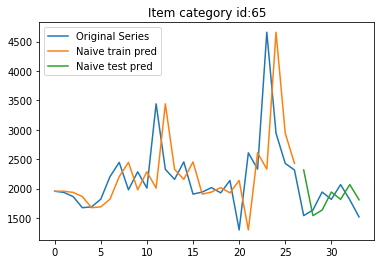

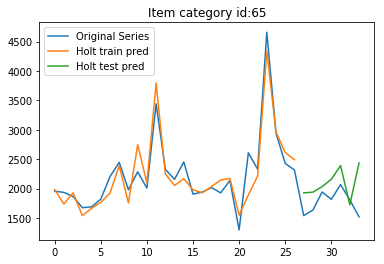

27 65 365.46956097601344 434.35679054385855


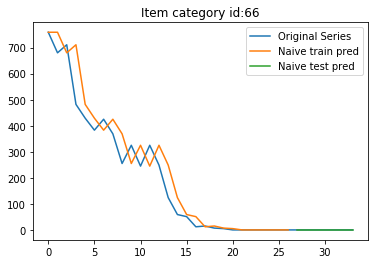

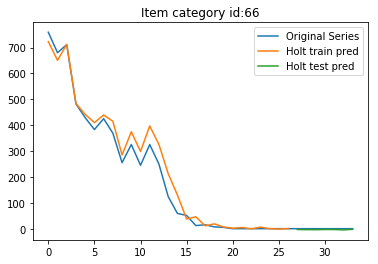

27 66 0.0 3.567018302643202


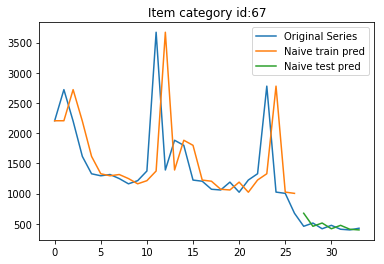

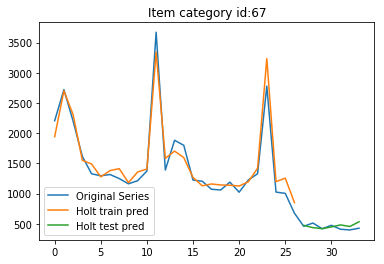

27 67 97.81615408509987 61.54417011356045


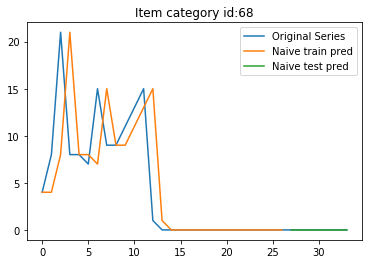

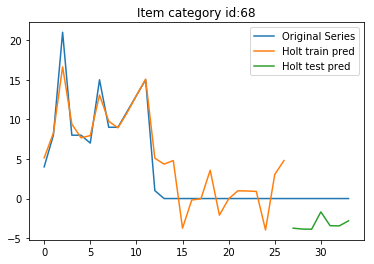

27 68 0.0 3.3441802817854005


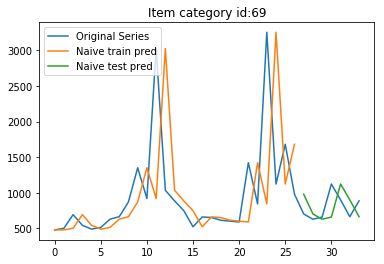

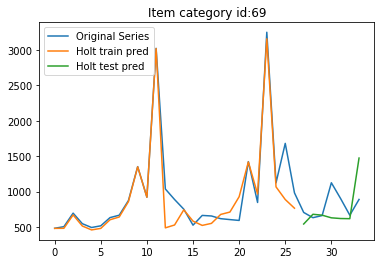

27 69 254.54581400716734 316.25287426902946


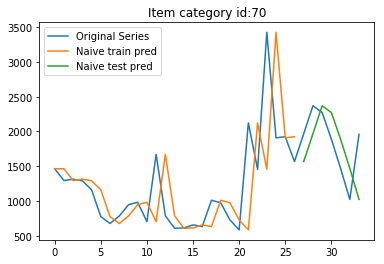

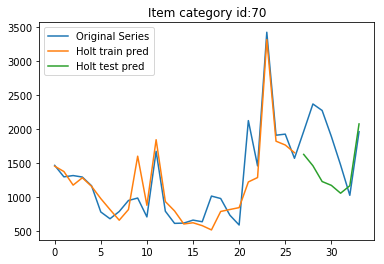

27 70 496.75935536520814 627.9625422812837


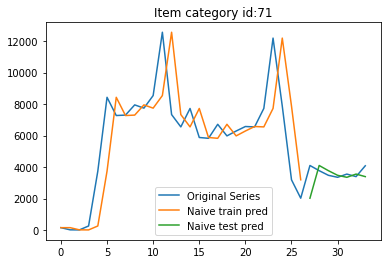

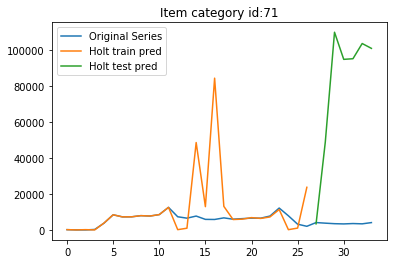

27 71 850.7099556085074 84255.70961563542


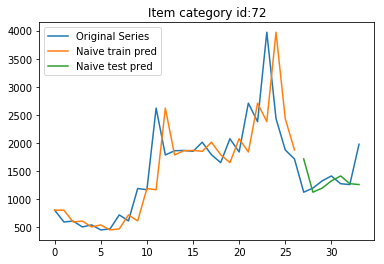

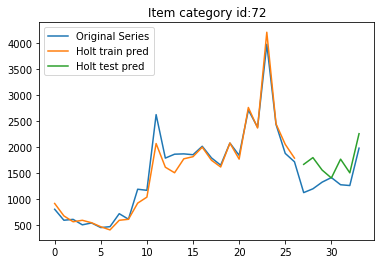

27 72 361.48779864807136 393.8295311973462


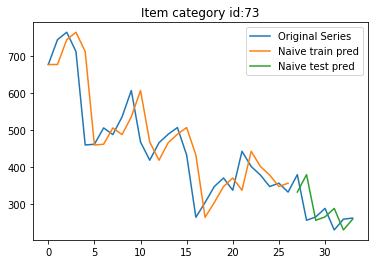

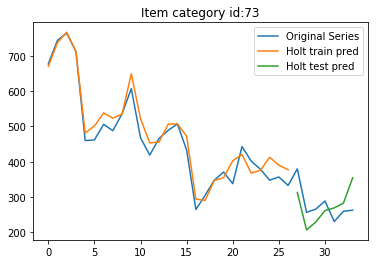

27 73 56.2672195865408 52.68203127536611


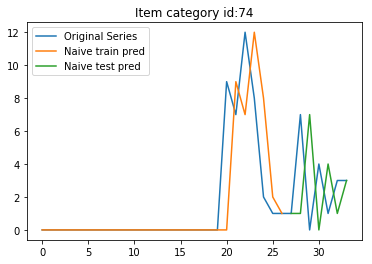

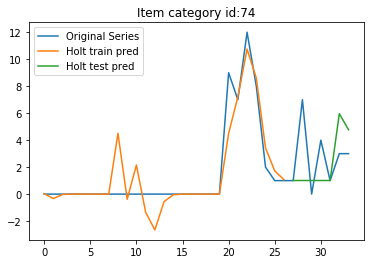

27 74 4.035556254807296 2.873572922365329


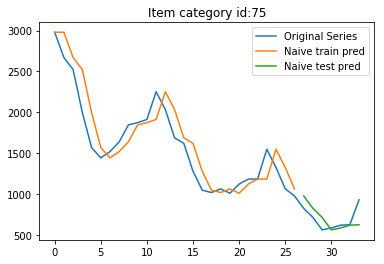

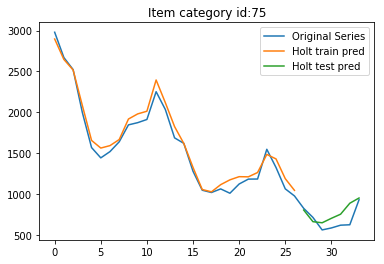

27 75 148.43324617964998 126.86146277980507


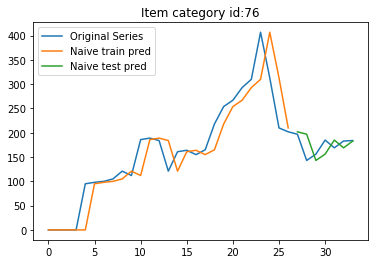

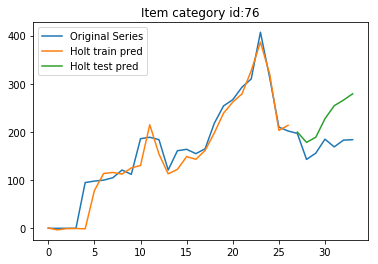

27 76 25.08272028992982 62.59386717511436


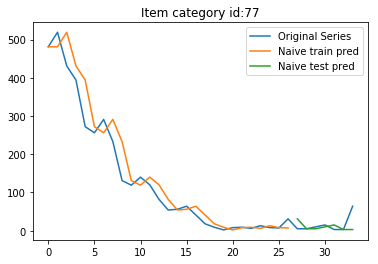

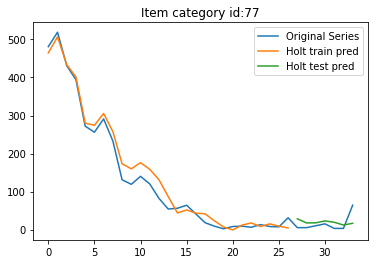

27 77 25.609707980708077 22.091459964740167


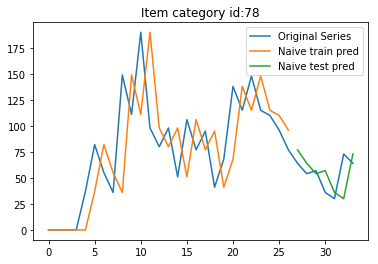

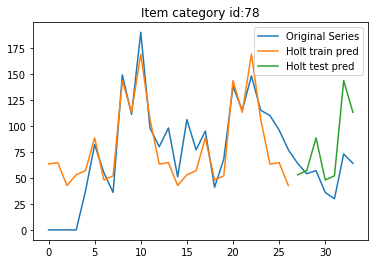

27 78 19.584979667373375 36.09585521596995


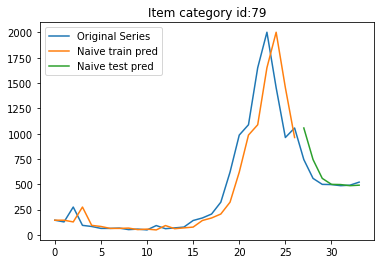

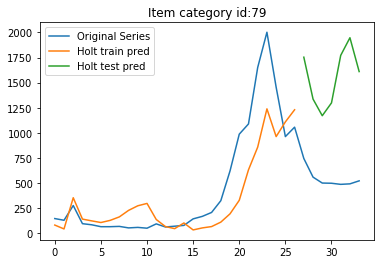

27 79 139.62756584162435 1047.0859560906797


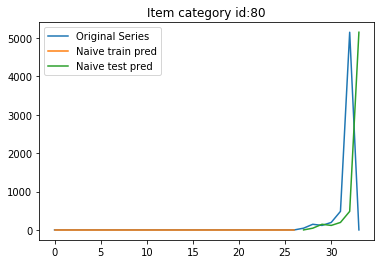

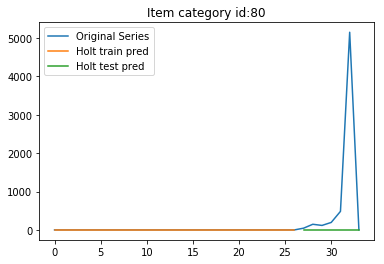

27 80 2629.1257101934093 1957.4341076302635


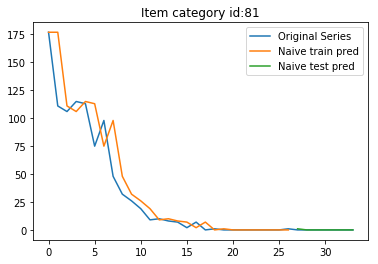

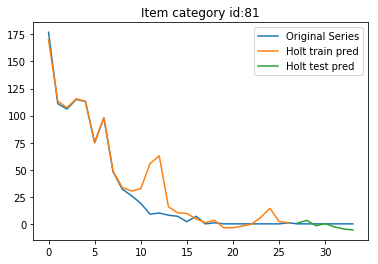

27 81 0.3779644730092272 3.2890787536404136


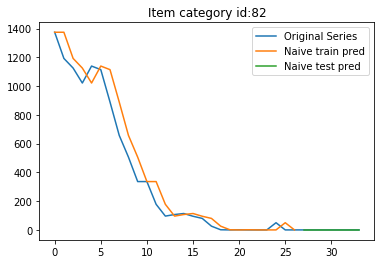

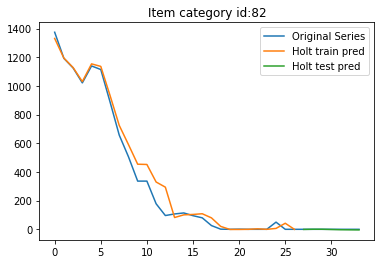

27 82 0.0 2.4667084772285754


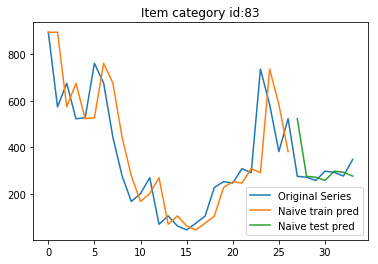

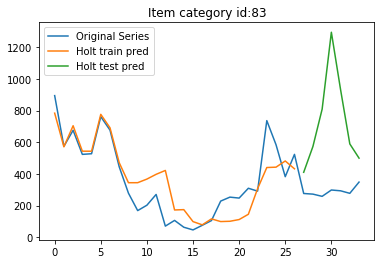

27 83 98.66465570666269 525.2555265748268


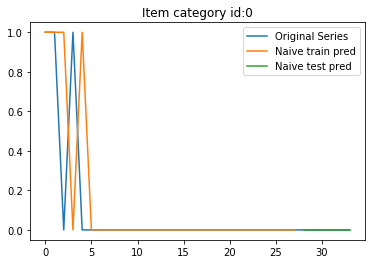

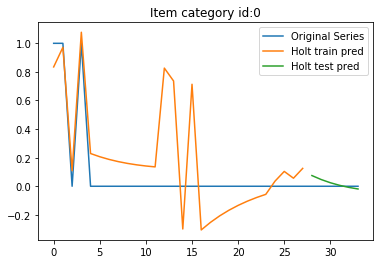

28 0 0.0 0.03849769659575804


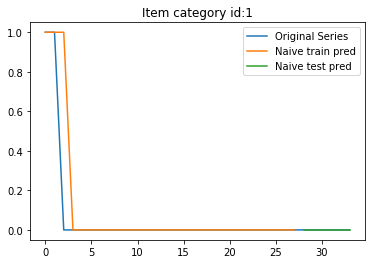

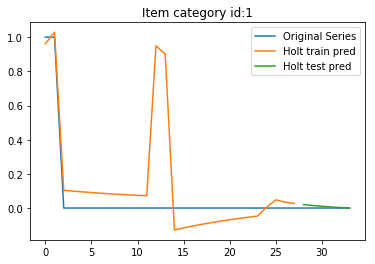

28 1 0.0 0.011303965439782715


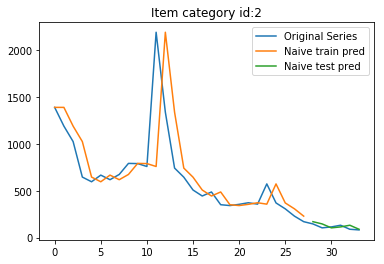

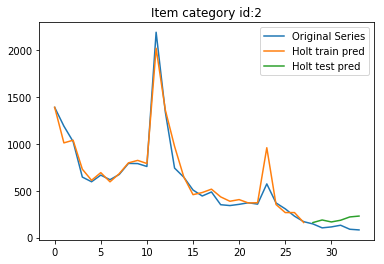

28 2 27.874719729532707 93.15600095996578


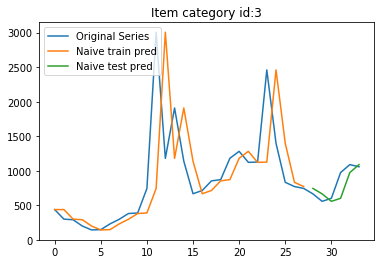

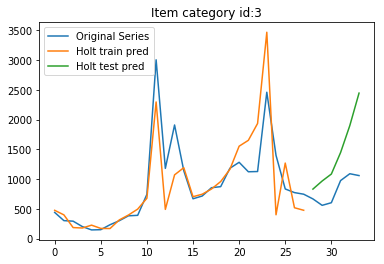

28 3 169.51450282104676 732.828035472708


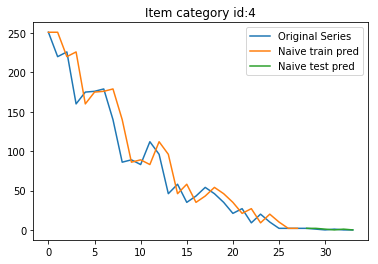

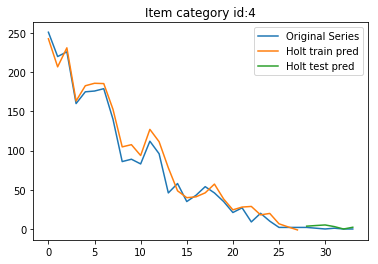

28 4 0.816496580927726 2.8765231698469997


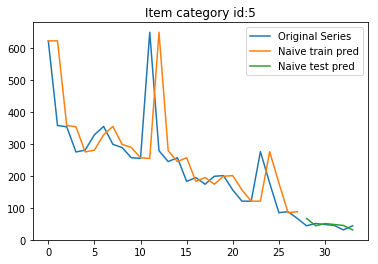

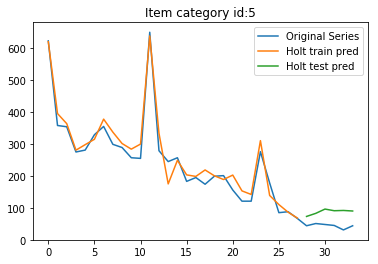

28 5 12.655697004379753 45.041265928420614


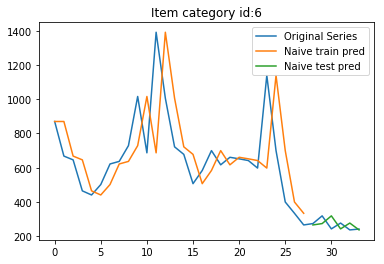

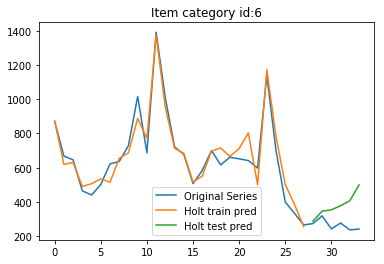

28 6 42.12283624512164 140.93132789484642


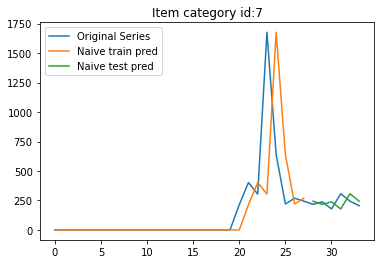

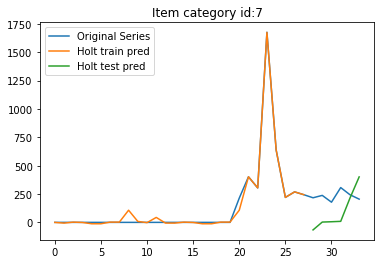

28 7 66.95894264398147 221.18719116375226


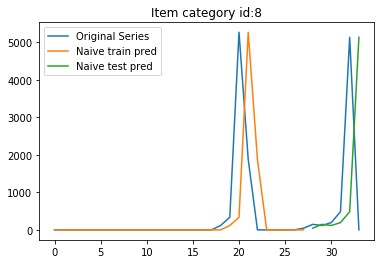

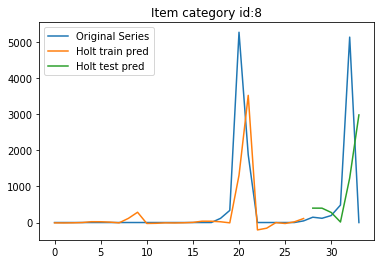

28 8 2827.951142906586 2017.6269591813966


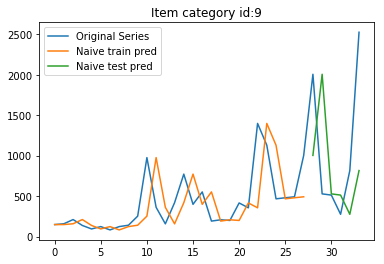

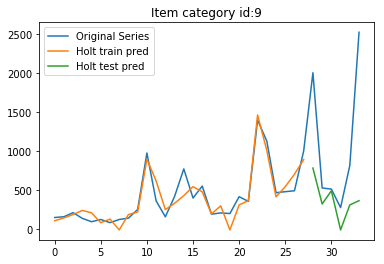

28 9 1036.885641396067 1043.6170319027276


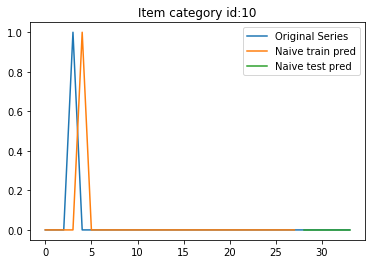

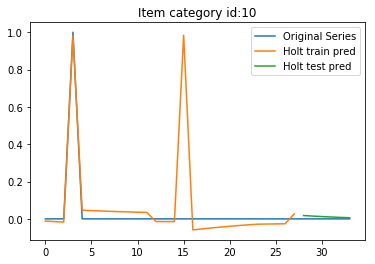

28 10 0.0 0.012212813377266107


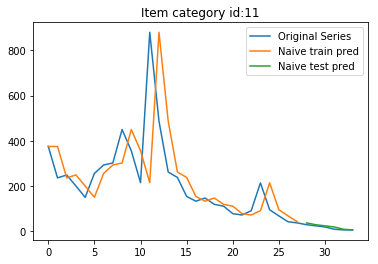

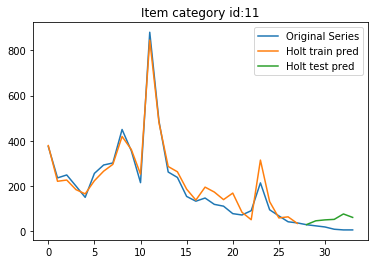

28 11 6.096447052723961 43.620040253856075


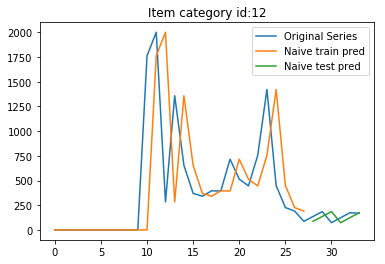

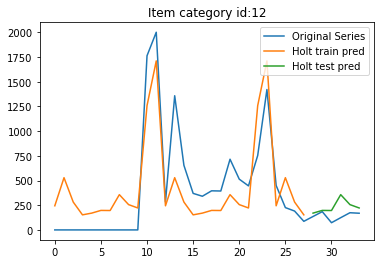

28 12 61.19912853410033 115.83720647838305


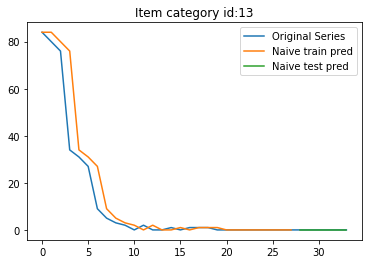

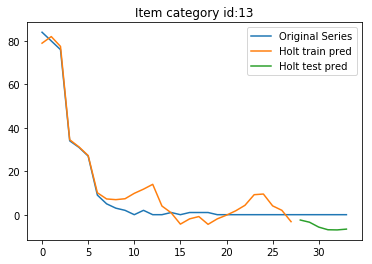

28 13 0.0 5.661252802866541


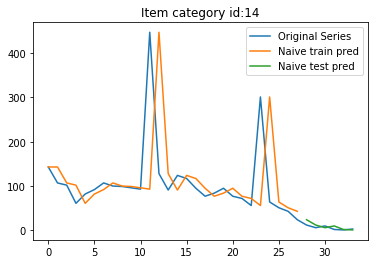

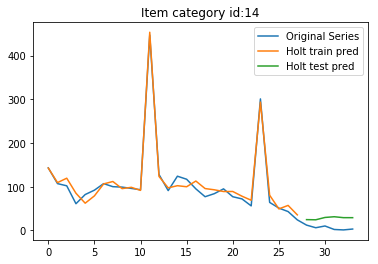

28 14 6.645800679125628 23.04467580776747


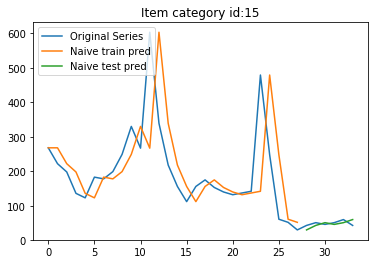

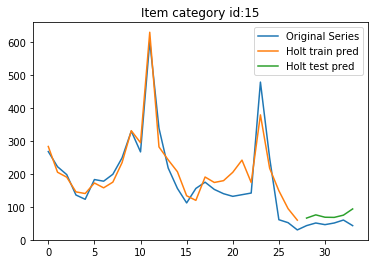

28 15 10.432321569685882 28.078322505415233


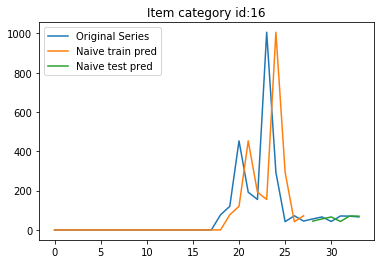

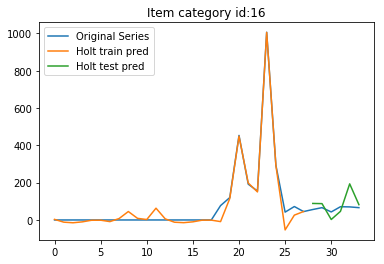

28 16 16.077935190813527 56.68576315437276


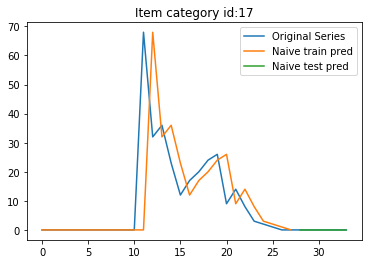

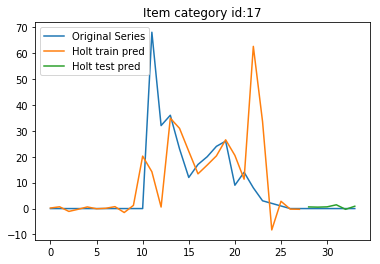

28 17 0.0 0.8300936907243344


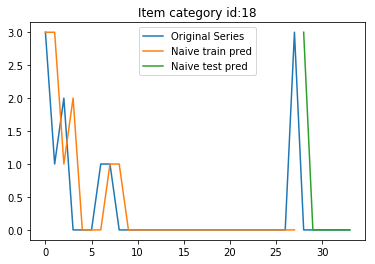

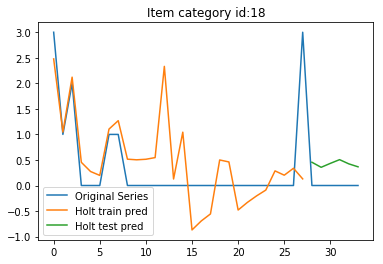

28 18 1.224744871391589 0.4265181451425595


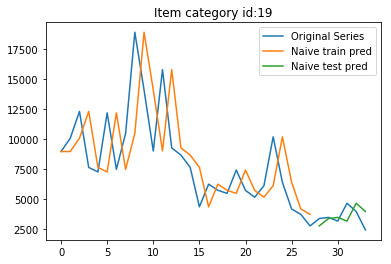

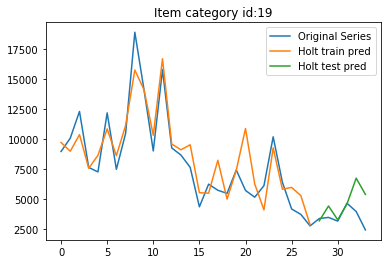

28 19 960.0378464762035 1705.7301174656984


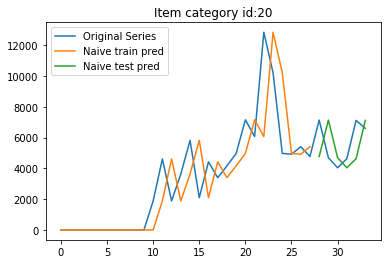

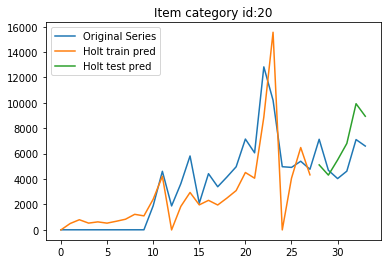

28 20 1768.3979567205265 2026.3680303524586


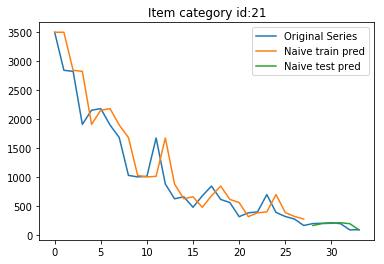

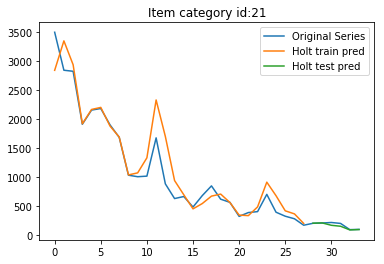

28 21 46.396838972786355 28.090976054674638


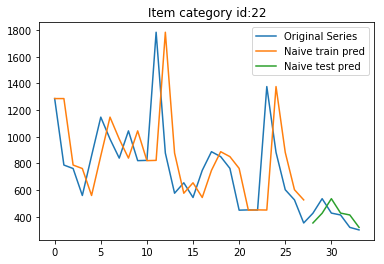

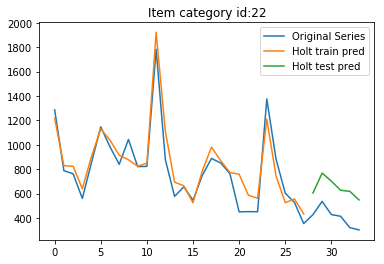

28 22 79.66596931354484 243.08930868829987


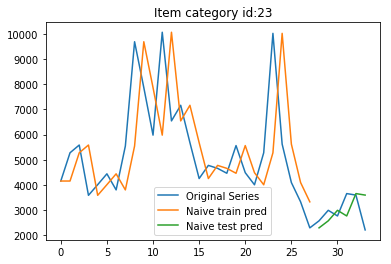

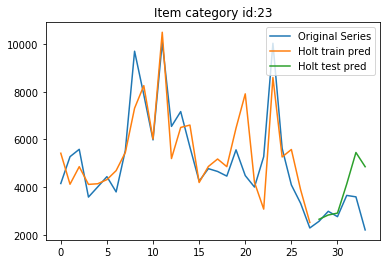

28 23 710.1450556048391 1339.5657077871606


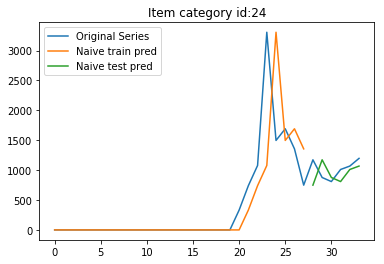

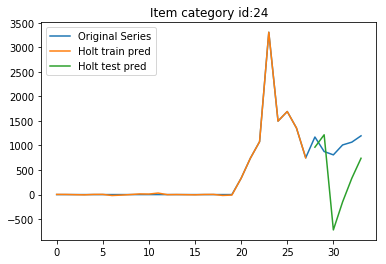

28 24 235.48177565719743 875.1965258598382


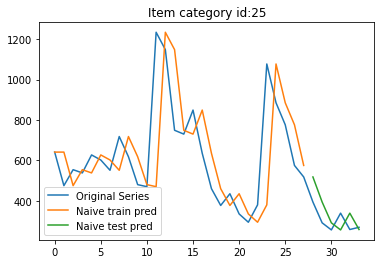

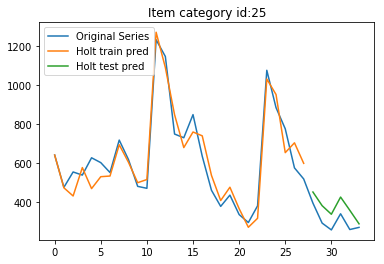

28 25 82.4429095394706 76.65308689295686


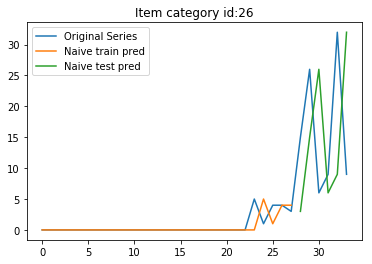

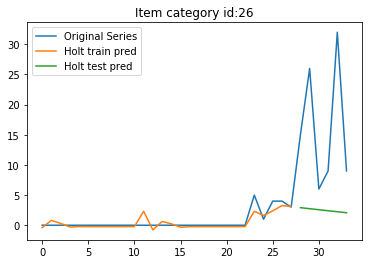

28 26 16.990193249832878 16.71292413843204


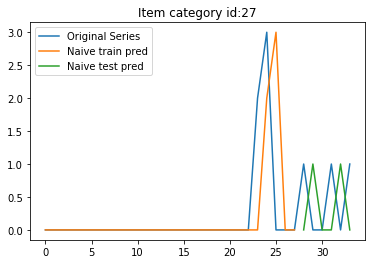

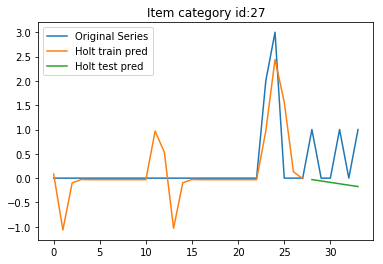

28 27 0.9128709291752769 0.786773023381155


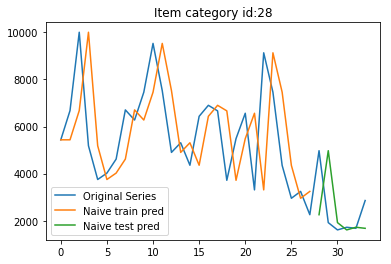

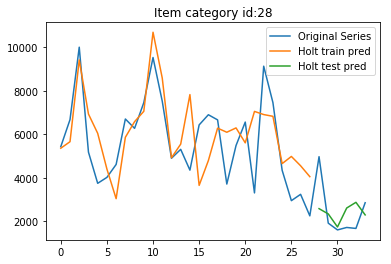

28 28 1742.4950502081779 1186.3621297319885


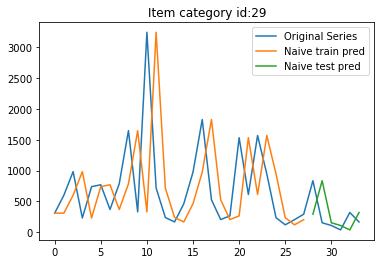

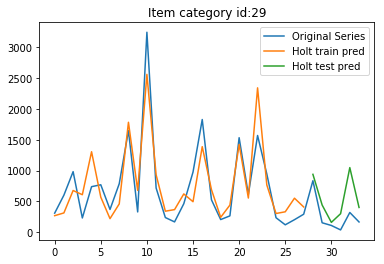

28 29 381.521078491521 353.97498595276625


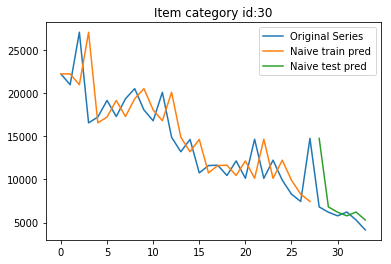

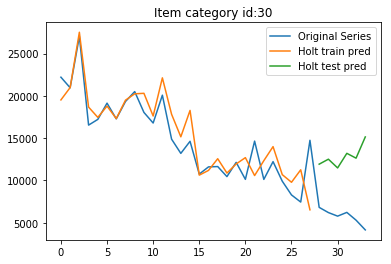

28 30 3313.4573836603563 7327.082331003819


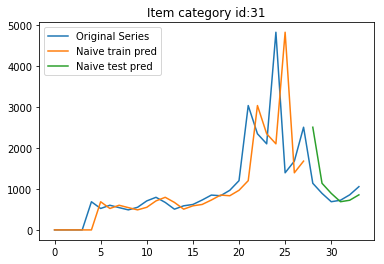

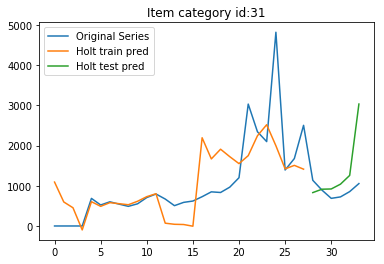

28 31 581.9902633778908 849.8118371566379


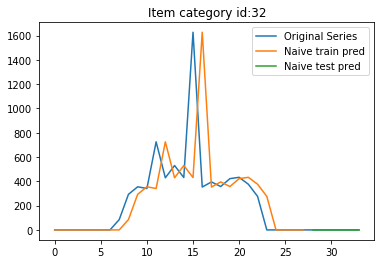

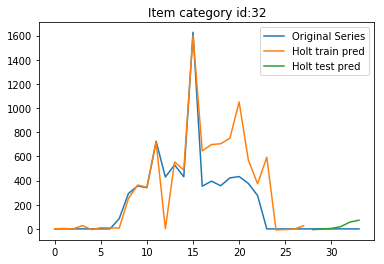

28 32 0.0 38.02745646344027


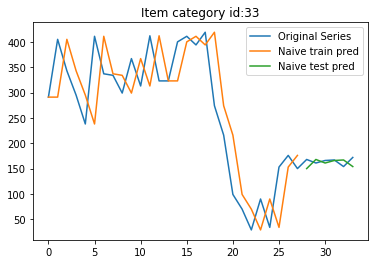

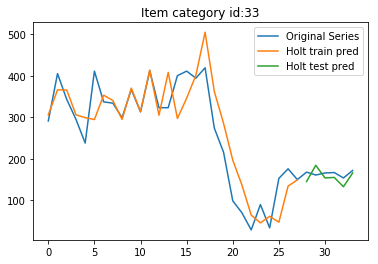

28 33 12.192894105447921 17.418758733946525


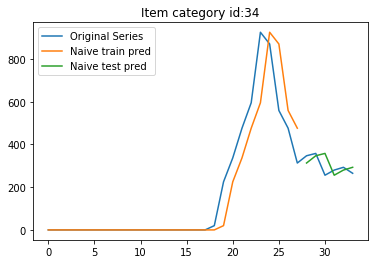

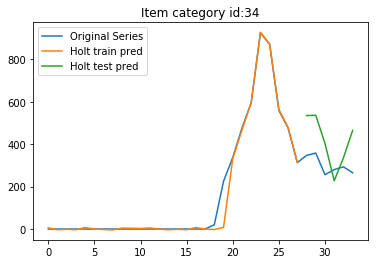

28 34 46.921920960960946 148.88214547518112


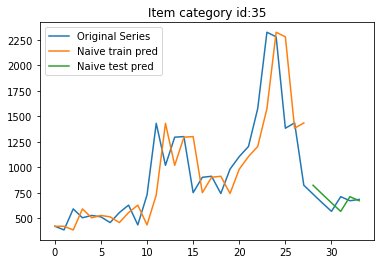

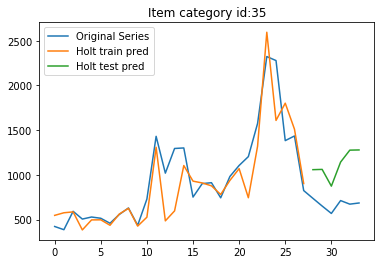

28 35 85.98352555383309 459.66425931718817


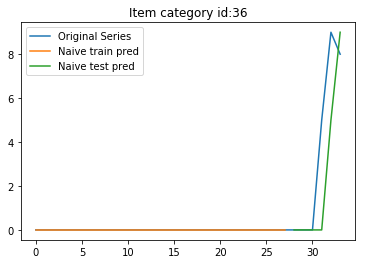

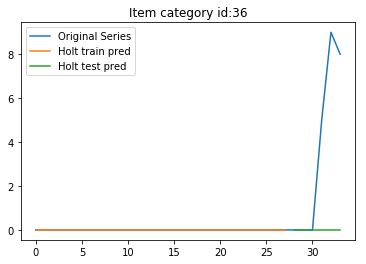

28 36 2.6457513110645907 5.32290647422377


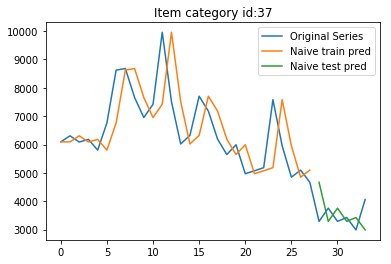

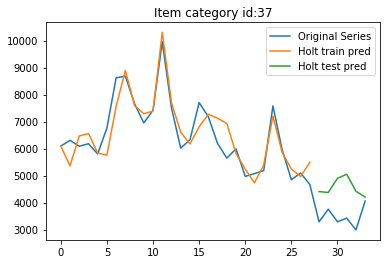

28 37 785.6580044777753 1220.4284749608655


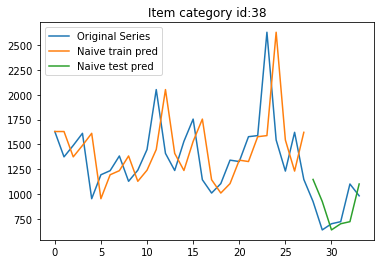

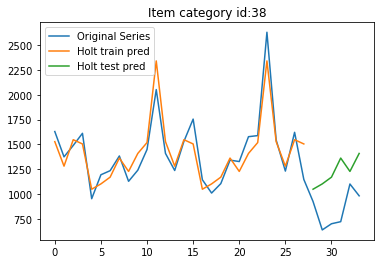

28 38 221.04562123386808 419.73933008643


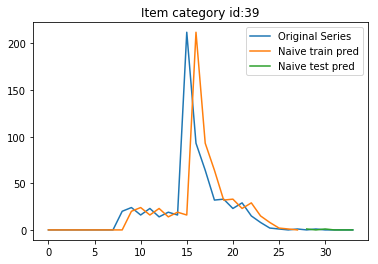

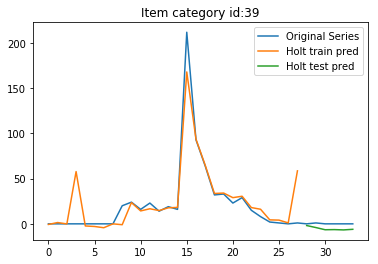

28 39 0.7071067811865476 5.695716910721059


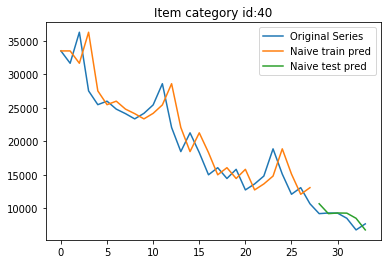

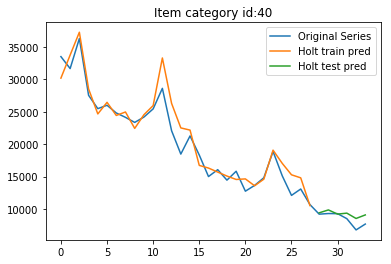

28 40 1048.549712698449 1014.8480674814218


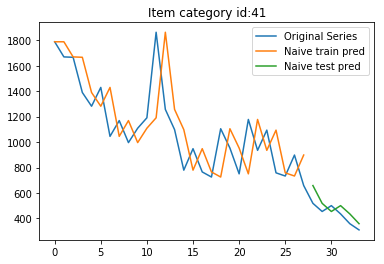

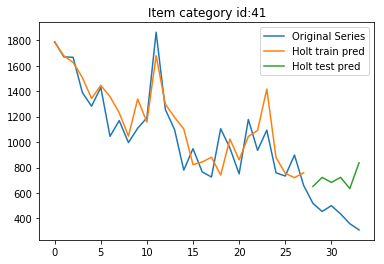

28 41 79.96561761157103 305.8372091856768


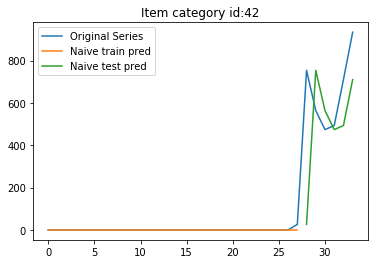

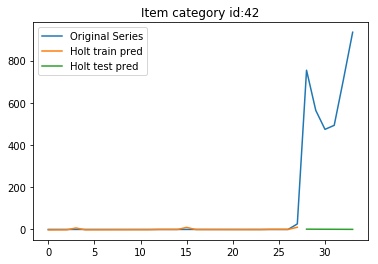

28 42 334.6166961365397 673.8988210196322


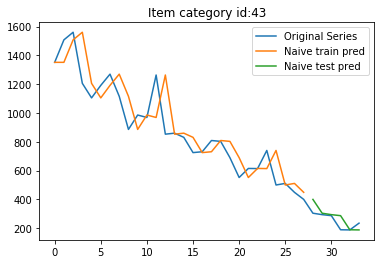

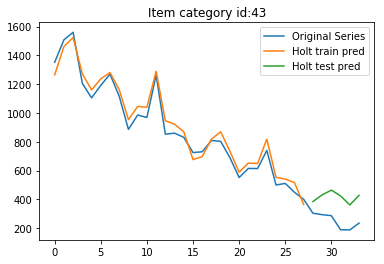

28 43 59.41240050135438 172.87285901554952


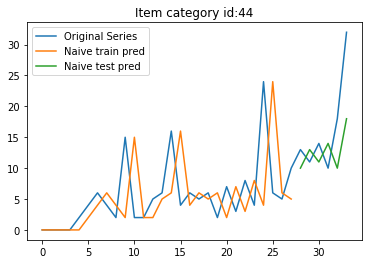

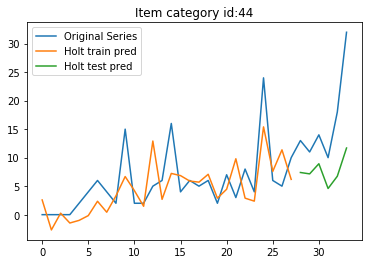

28 44 7.047458170621991 10.330624787248823


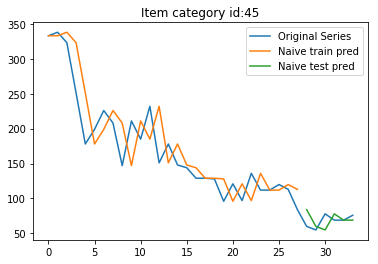

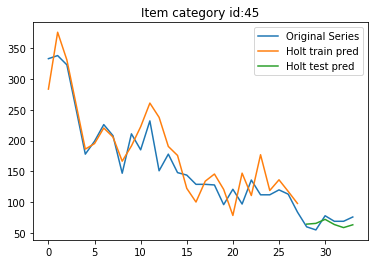

28 45 14.491376746189438 8.746643580007264


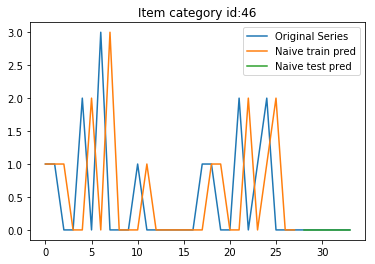

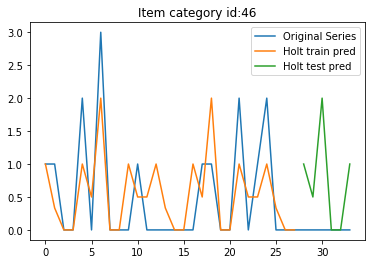

28 46 0.0 1.0206206848429855


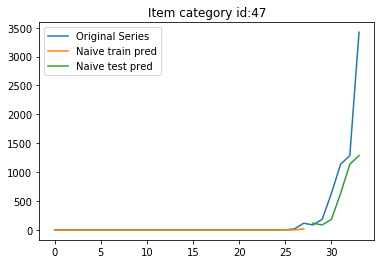

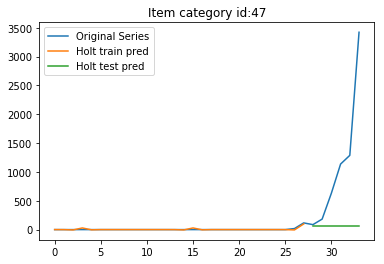

28 47 916.8435889870565 1538.4286212888628


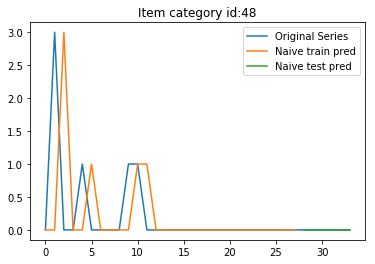

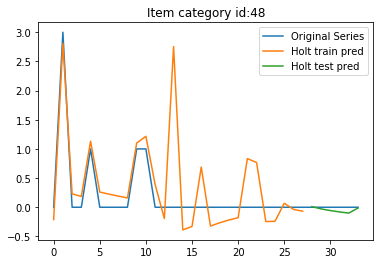

28 48 0.0 0.05876527881073357


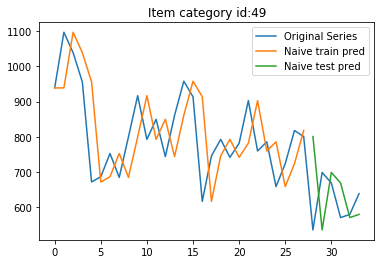

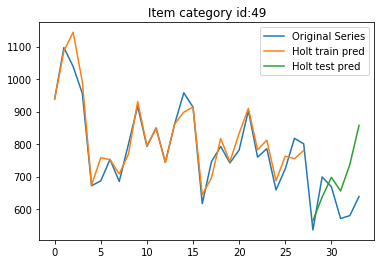

28 49 135.92890298485702 119.16259792463046


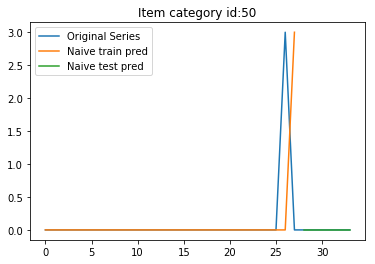

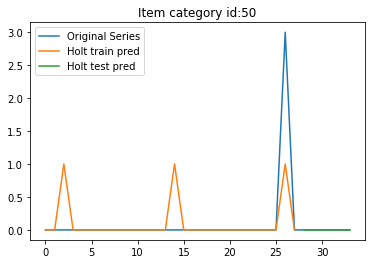

28 50 0.0 2.2616969547996913e-07


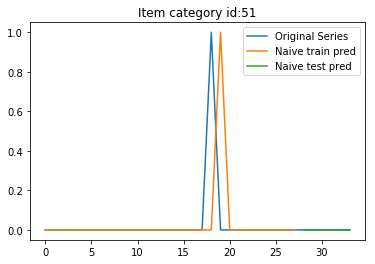

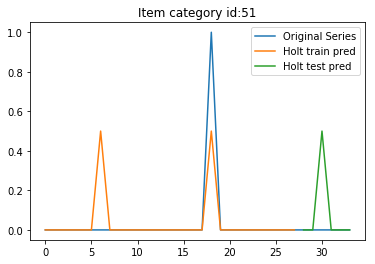

28 51 0.0 0.20412410569144224


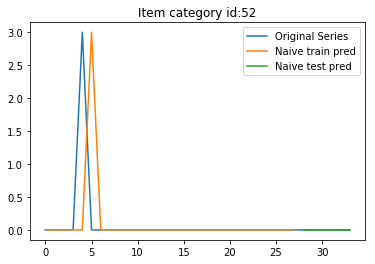

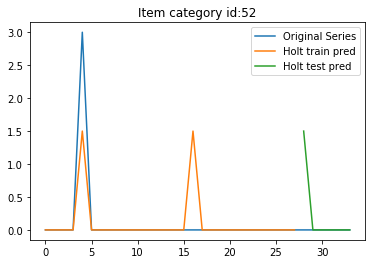

28 52 0.0 0.6123724118352162


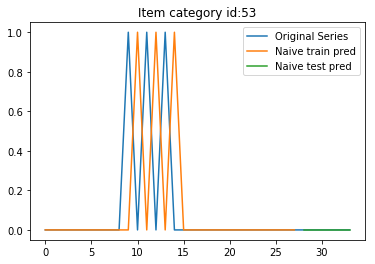

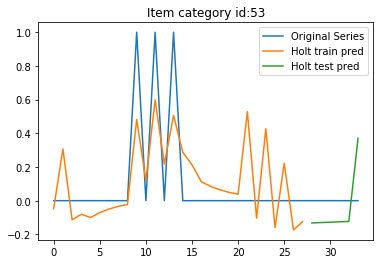

28 53 0.0 0.19089643312784255


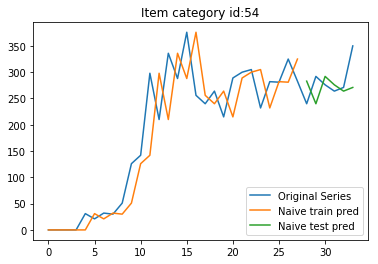

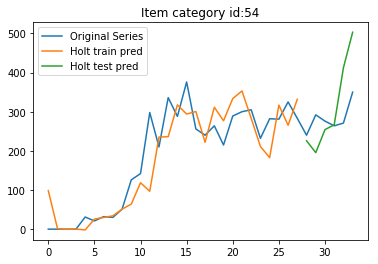

28 54 43.28779658672099 94.36475819250997


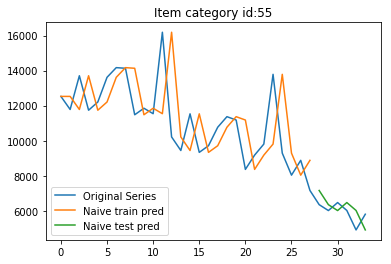

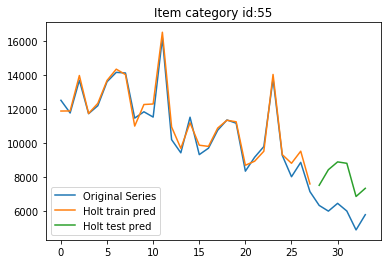

28 55 731.6005285217701 2135.039293113668


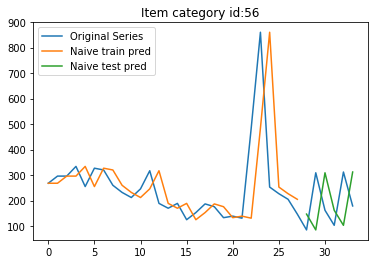

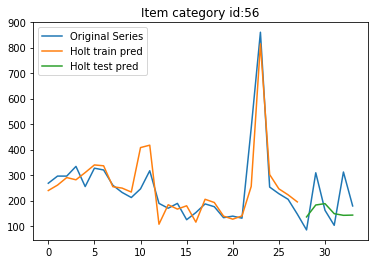

28 56 153.01416056474423 92.58431995921065


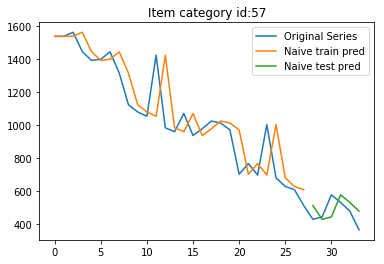

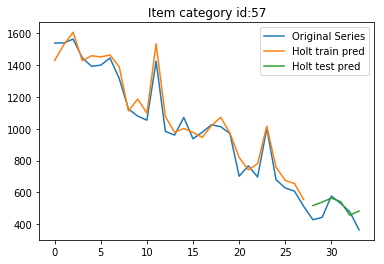

28 57 84.81155581640984 72.91703058661525


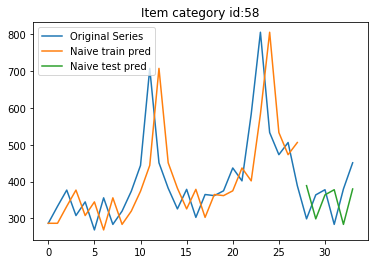

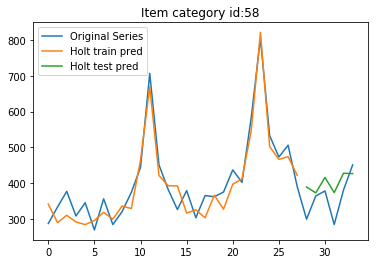

28 58 77.04327788111476 58.408168601229676


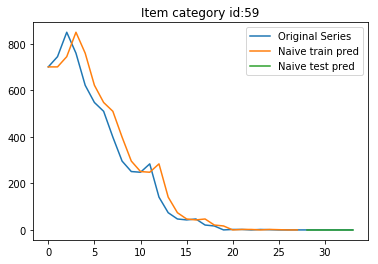

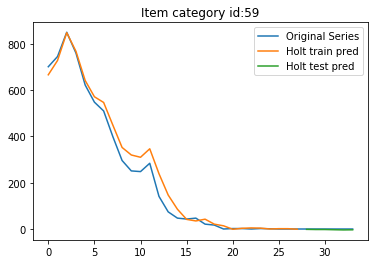

28 59 0.0 2.876390276601599


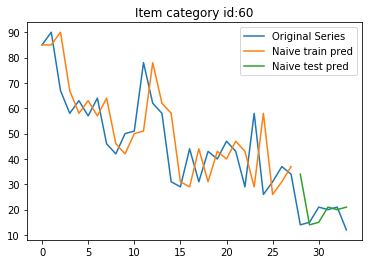

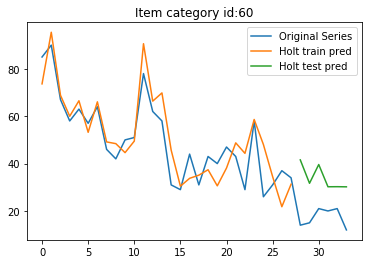

28 60 9.309493362512628 17.817693425931676


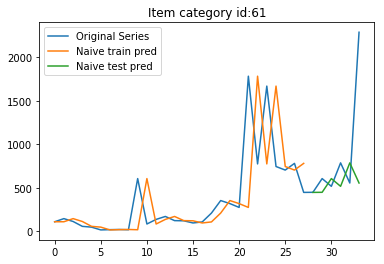

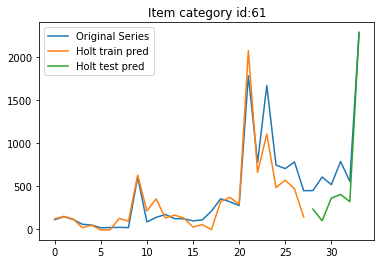

28 61 727.244342249105 298.12467214265143


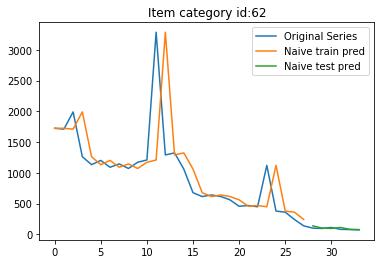

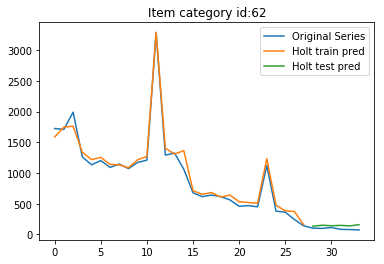

28 62 21.039645117412668 57.13492433912518


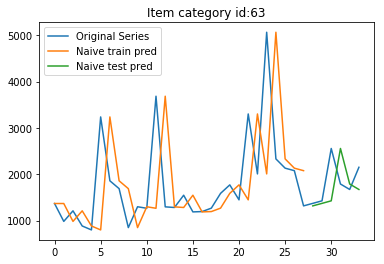

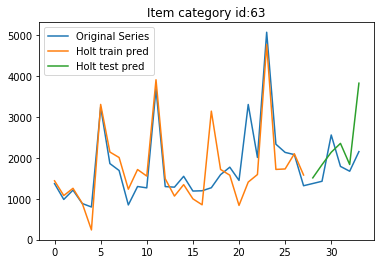

28 63 593.6462190002842 763.3295338676004


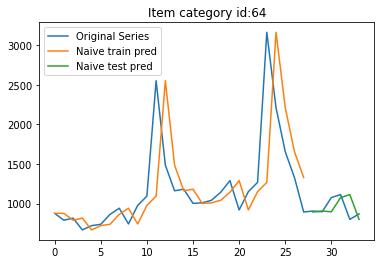

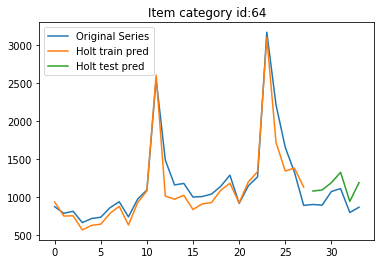

28 64 150.79787796915446 206.05969460467063


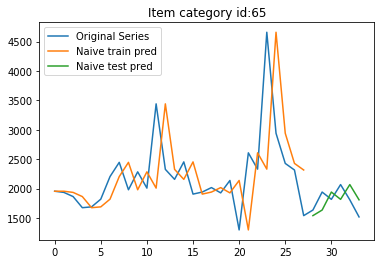

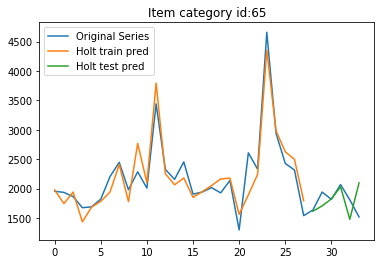

28 65 235.5136231020759 289.22370521000255


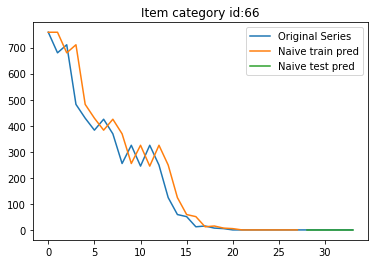

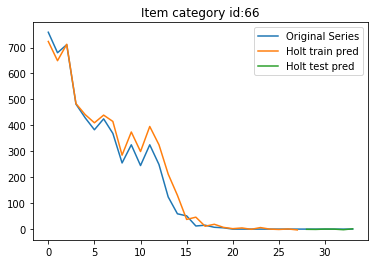

28 66 0.0 1.2221853631125292


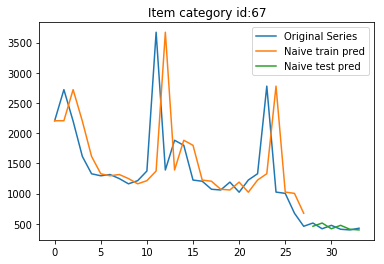

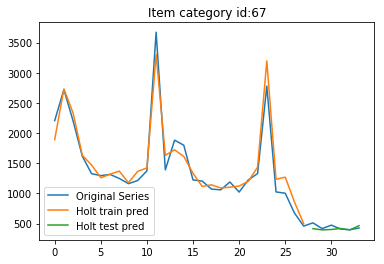

28 67 58.19507424745385 52.29188082094661


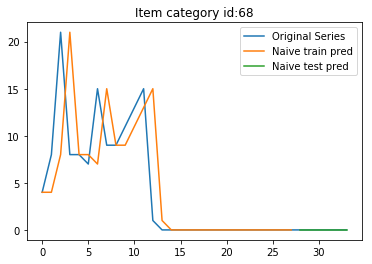

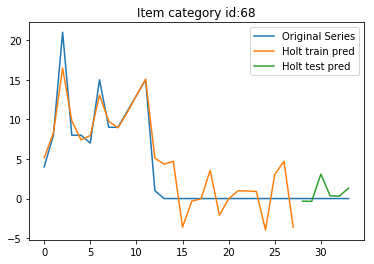

28 68 0.0 1.3967134725503187


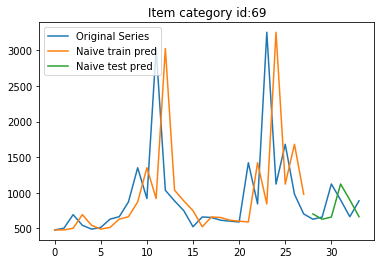

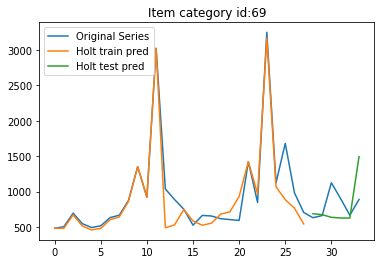

28 69 250.60792751493983 338.1128911783543


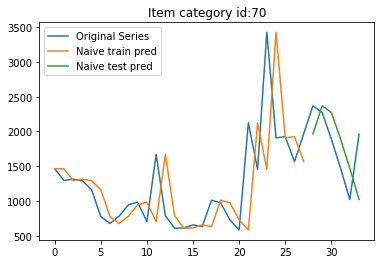

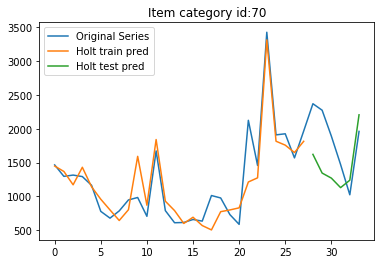

28 70 511.4978005817816 581.4933522572567


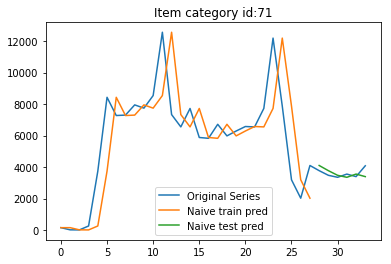

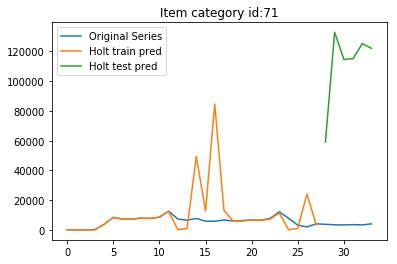

28 71 354.0298951595284 110609.24673440837


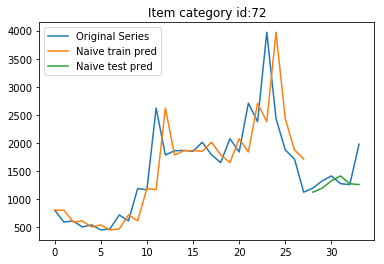

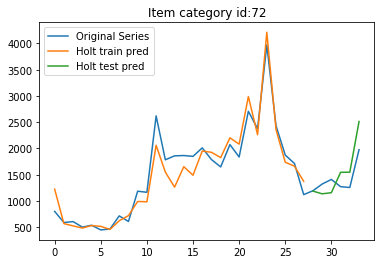

28 72 306.66213764771595 301.95948140124335


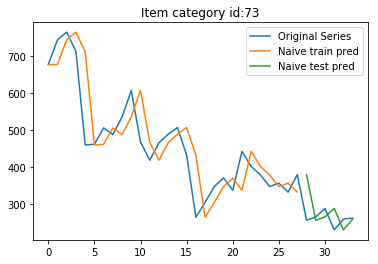

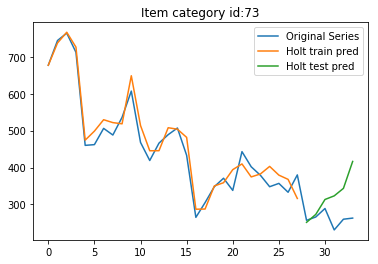

28 73 57.66714836022326 81.34724151185519


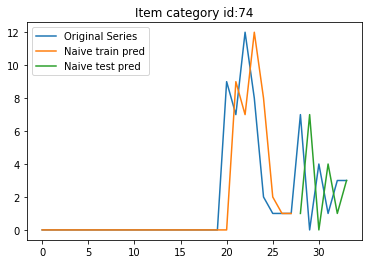

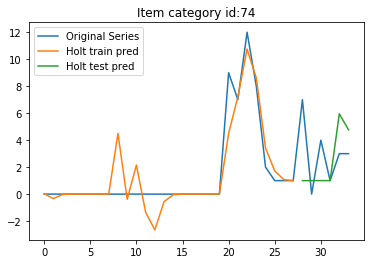

28 74 4.358898943540674 3.1046613009120394


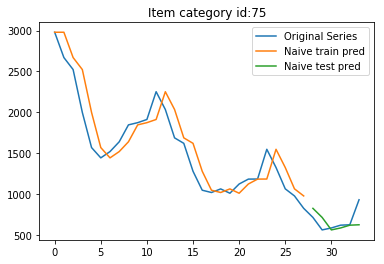

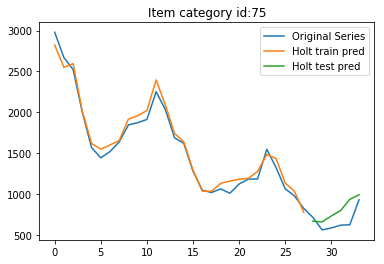

28 75 147.83042086571132 166.35431354256673


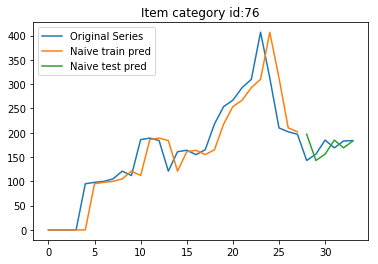

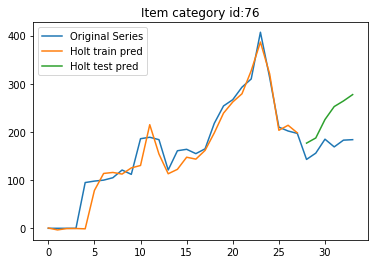

28 76 27.015427691105195 66.06292102966938


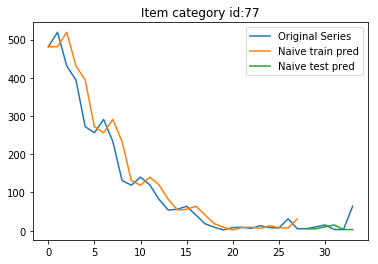

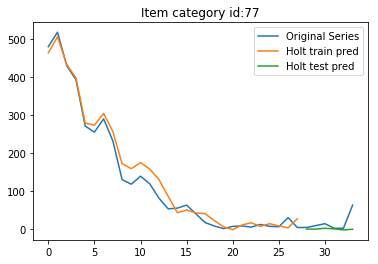

28 77 25.544079548889602 26.82182773090167


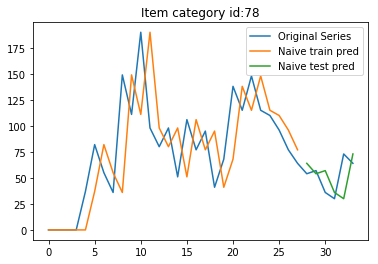

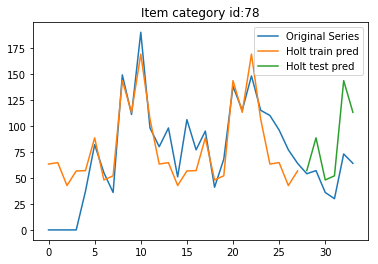

28 78 20.477630071210225 38.73118387751489


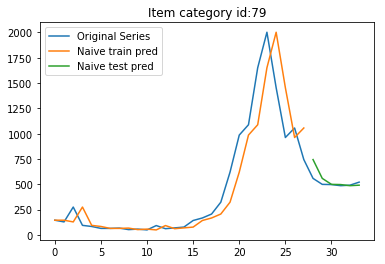

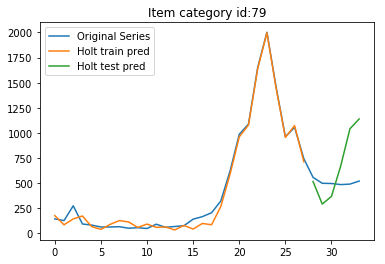

28 79 80.75374088342079 360.60371881465454


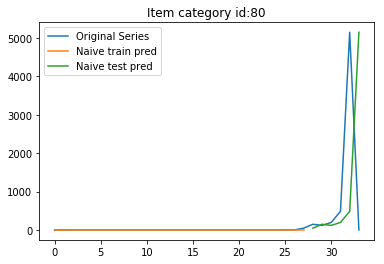

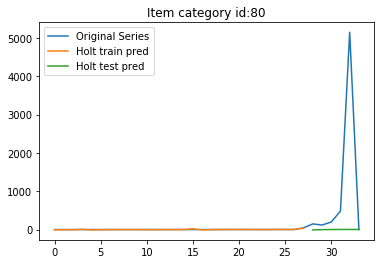

28 80 2839.7209076480267 2113.430605518328


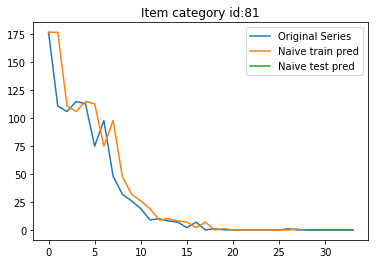

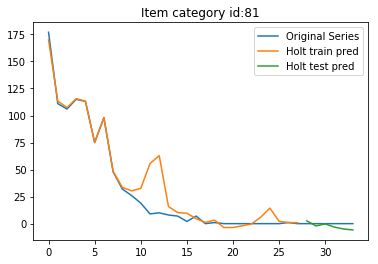

28 81 0.0 3.648083736900358


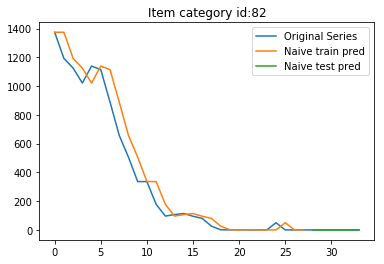

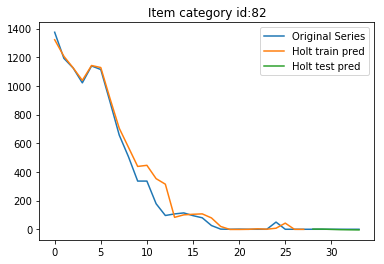

28 82 0.0 2.751022999032001


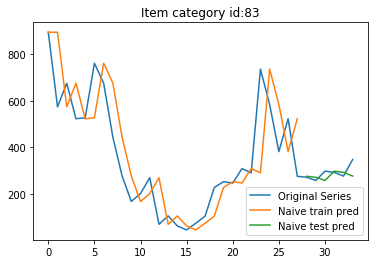

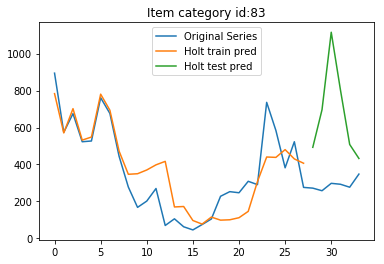

28 83 34.48187929913333 452.6320996428099


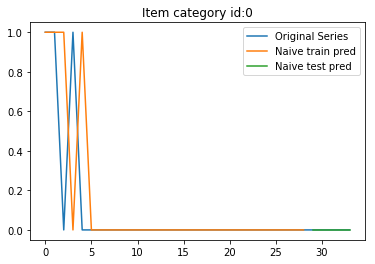

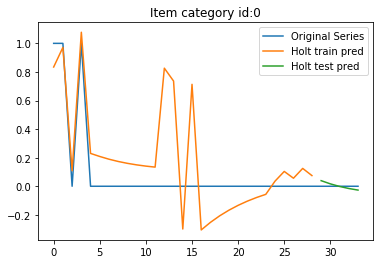

29 0 0.0 0.02358172851285698


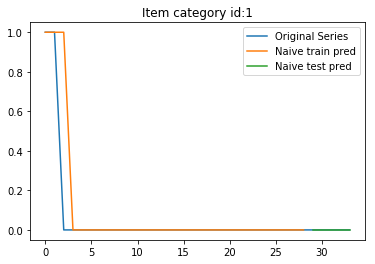

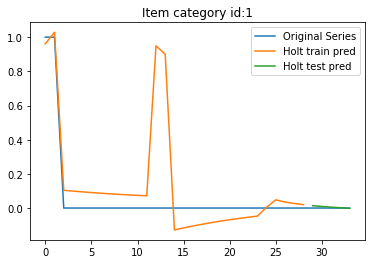

29 1 0.0 0.007834608105788027


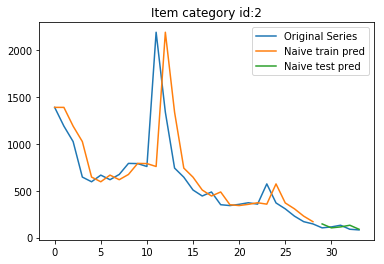

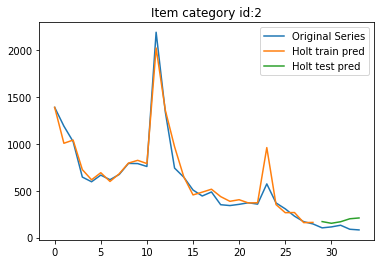

29 2 28.58671019897183 85.08030699673675


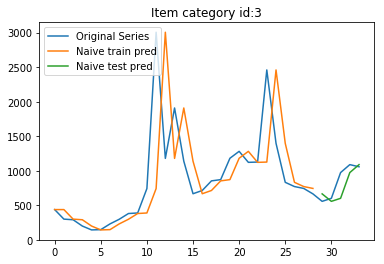

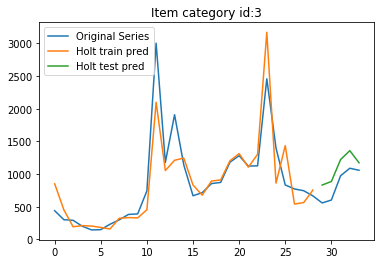

29 3 182.3019473291495 246.1517103456946


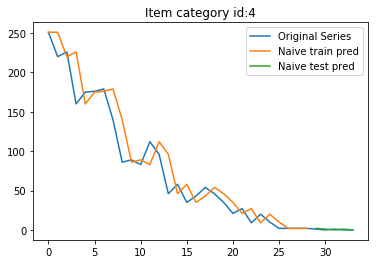

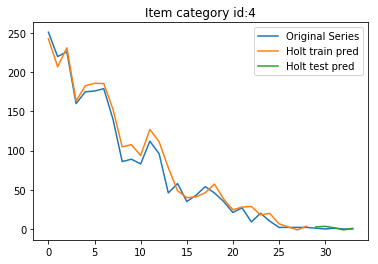

29 4 0.8944271909999159 1.8152987038940267


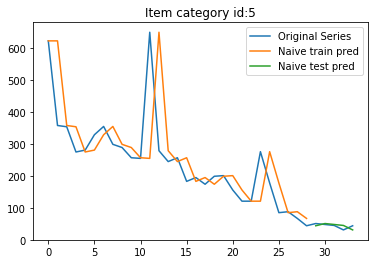

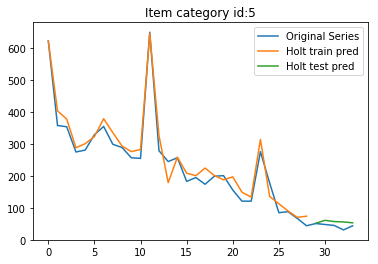

29 5 9.2951600308978 14.337518412653713


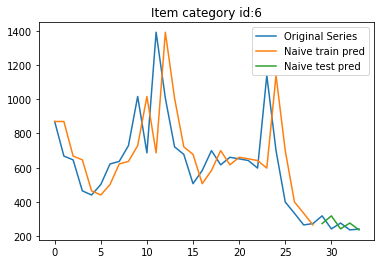

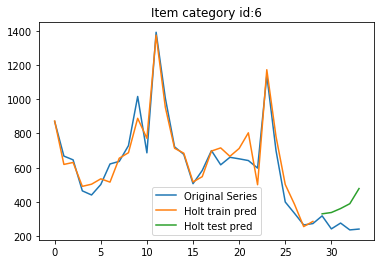

29 6 46.00434762063255 138.4244878601777


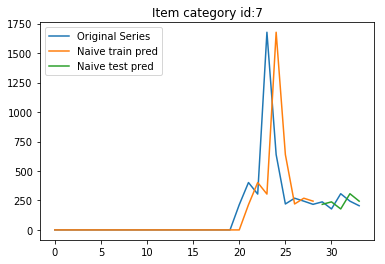

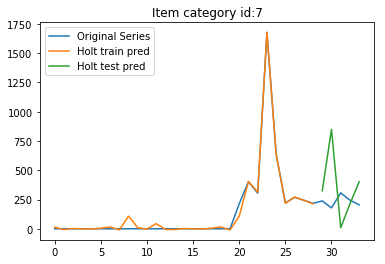

29 7 72.34915341591773 342.3506686208996


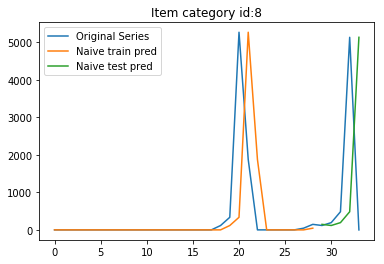

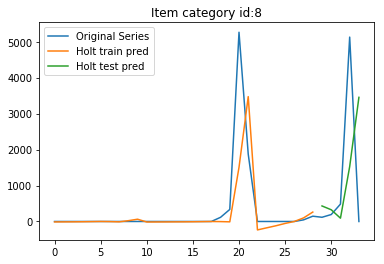

29 8 3097.5294026045985 2243.3907276819787


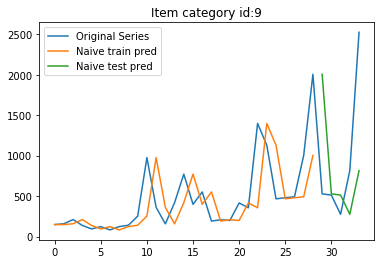

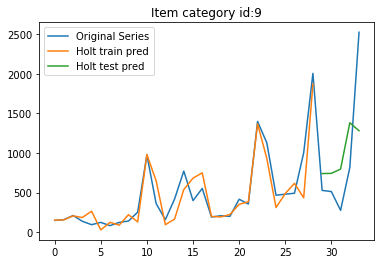

29 9 1043.722855934467 668.584094546749


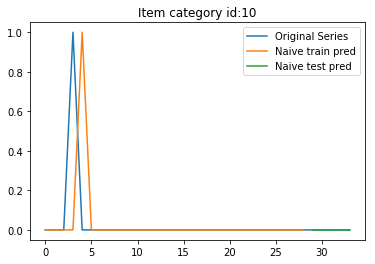

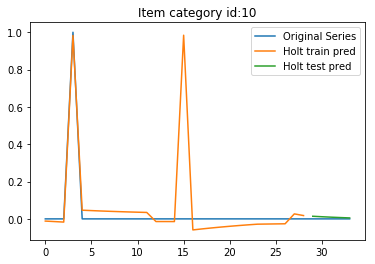

29 10 0.0 0.00985681939562925


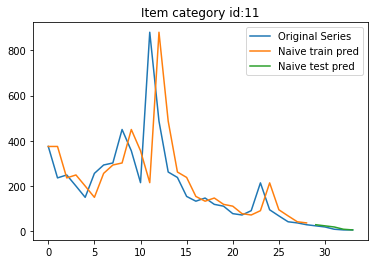

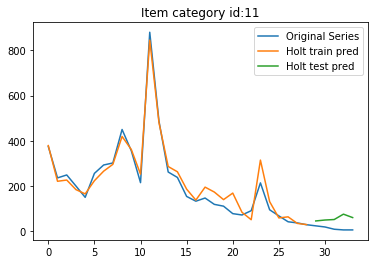

29 11 5.639148871948674 47.09363585450632


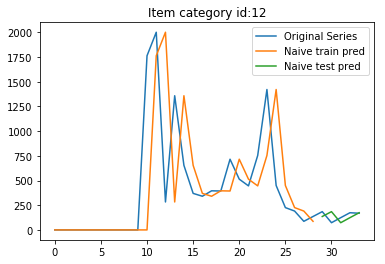

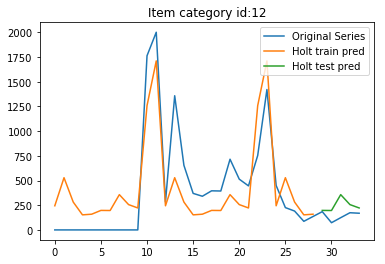

29 12 63.35771460524756 126.05922996219303


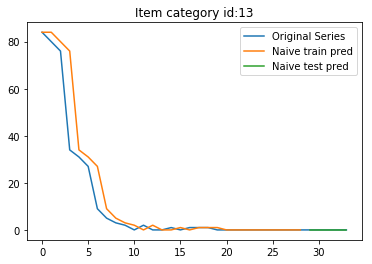

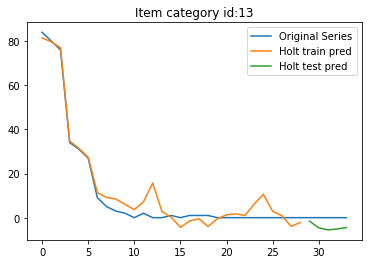

29 13 0.0 4.479499614678563


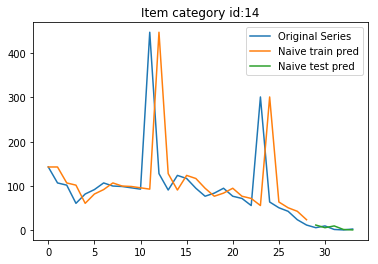

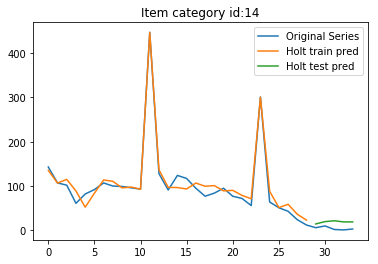

29 14 4.919349550499537 15.096710142105533


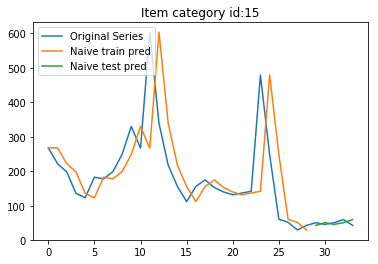

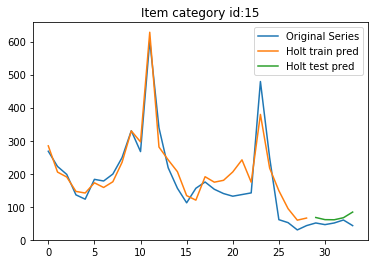

29 15 9.838699100999074 21.569752955315657


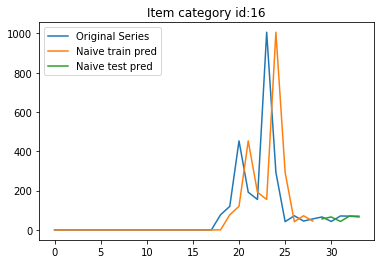

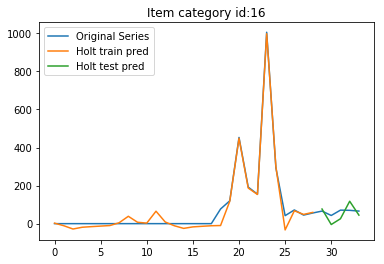

29 16 16.911534525287763 37.840662038746444


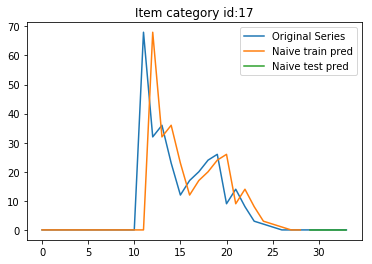

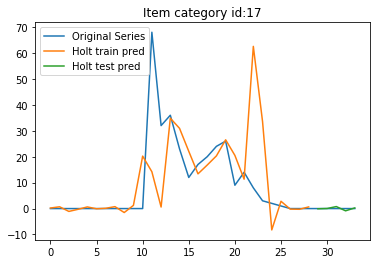

29 17 0.0 0.5335772996645607


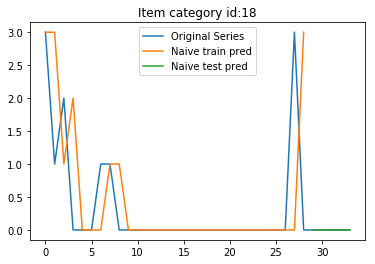

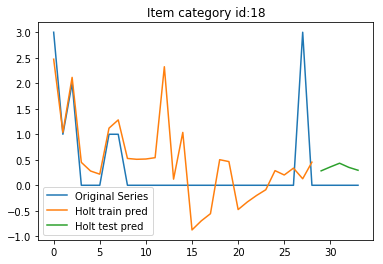

29 18 0.0 0.3482261288665023


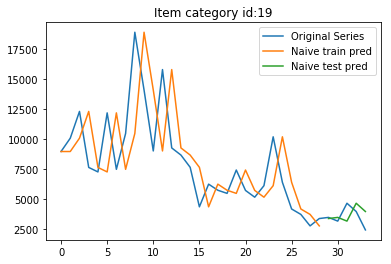

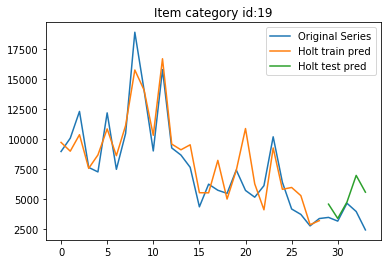

29 19 1015.3095094600463 2012.4977002896146


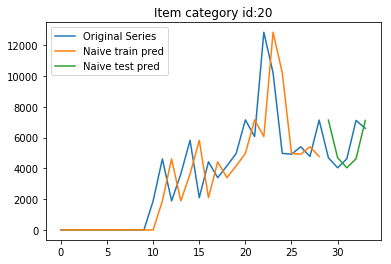

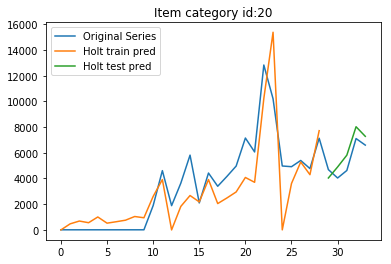

29 20 1623.8438348560492 882.9087855596481


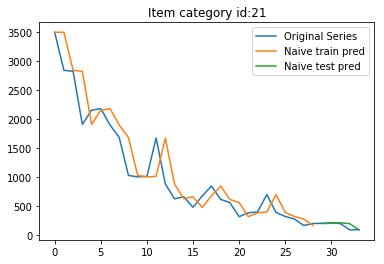

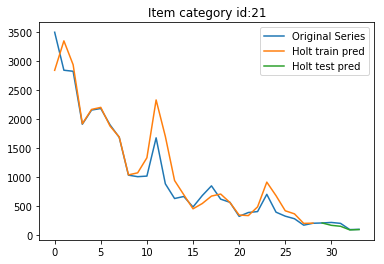

29 21 48.63537806987831 31.666243853670622


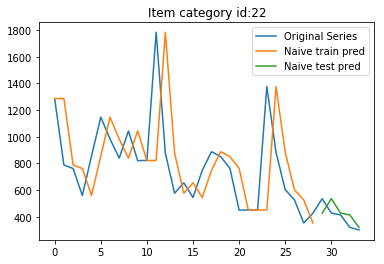

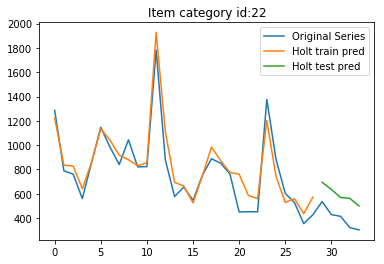

29 22 80.93330587588771 194.2524385652059


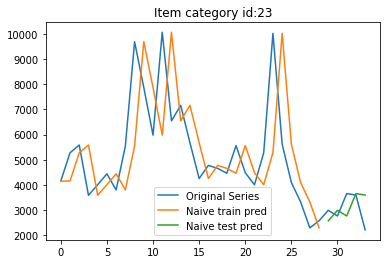

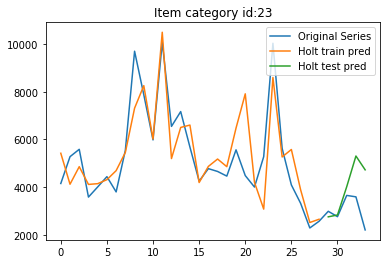

29 23 767.7806978558395 1376.557699871744


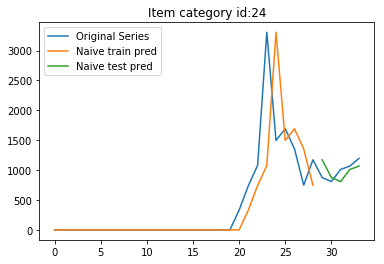

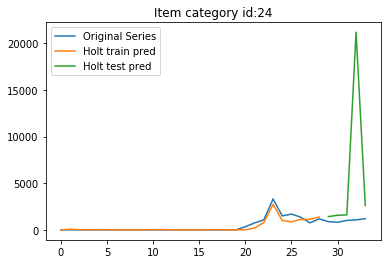

29 24 174.89082308686181 9034.034575291736


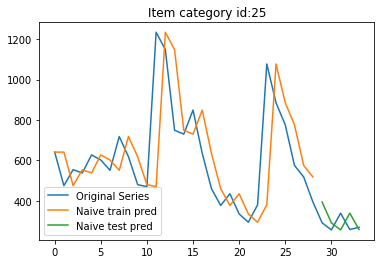

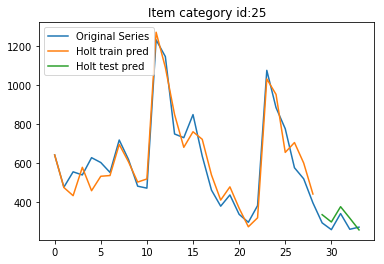

29 25 71.28113354878694 40.17324723058294


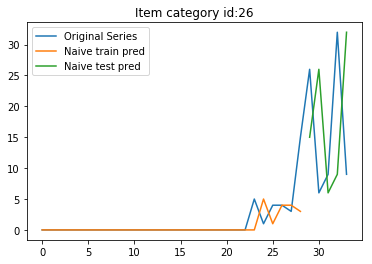

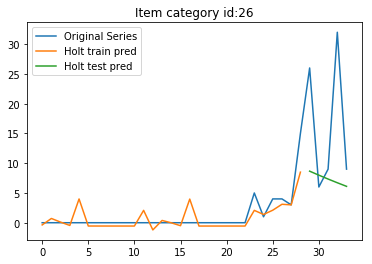

29 26 17.82133552795637 13.820460915290061


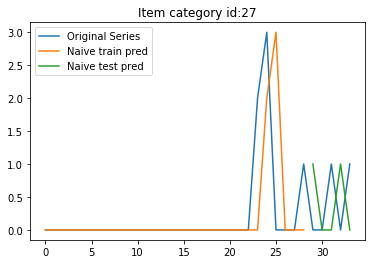

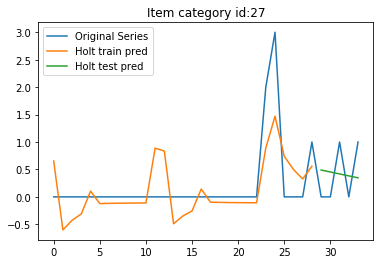

29 27 0.8944271909999159 0.5208512922414632


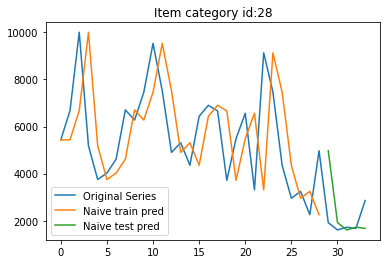

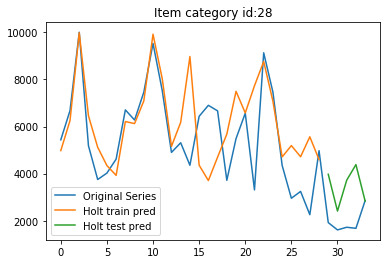

29 28 1471.7479403756608 1797.5641559415599


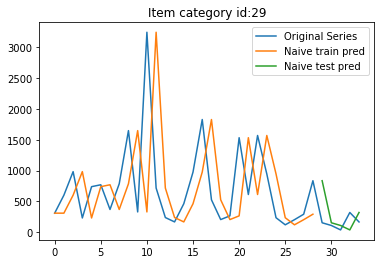

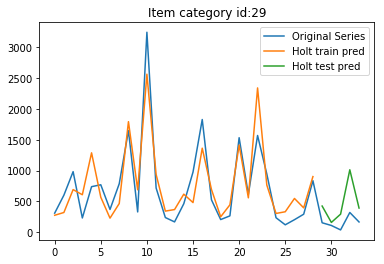

29 29 339.8276033520526 367.0488603506145


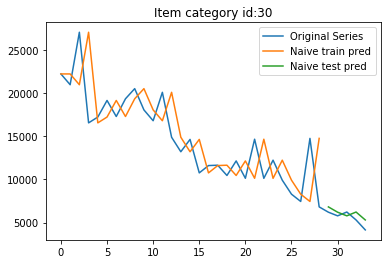

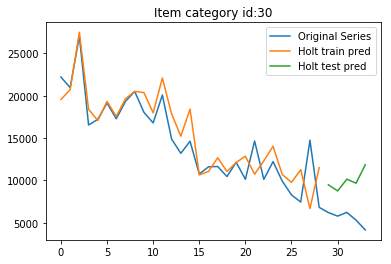

29 30 764.9369908691826 4760.966953227055


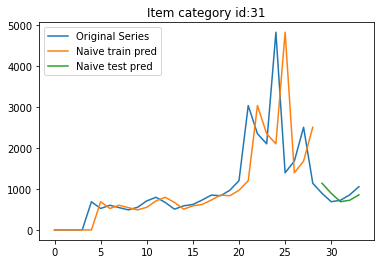

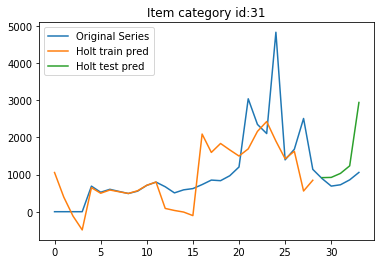

29 31 179.36108831070356 874.7276824590501


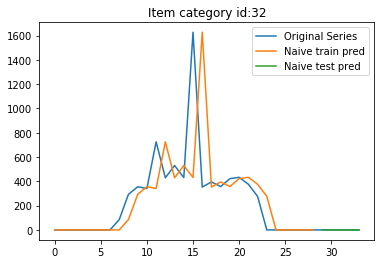

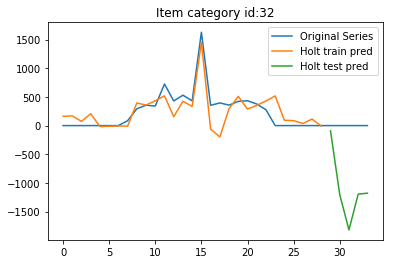

29 32 0.0 1230.778811806783


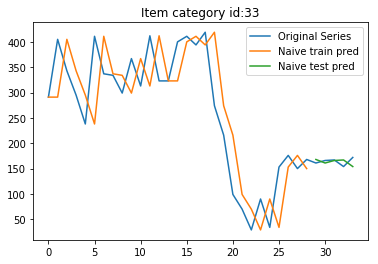

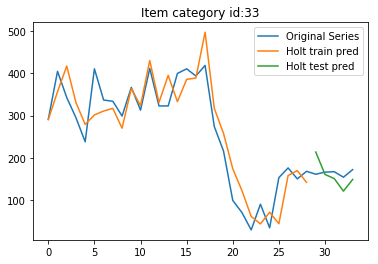

29 33 10.658330075579382 30.68507956357776


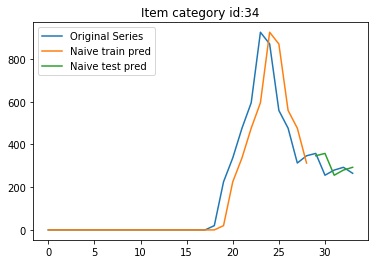

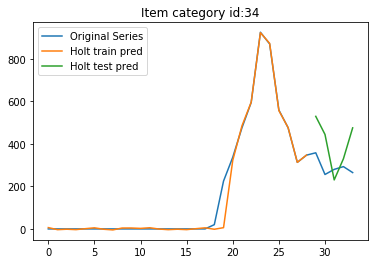

29 34 49.09989816690051 150.26429201720268


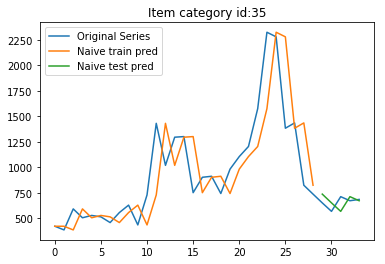

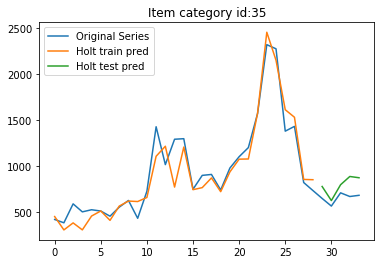

29 35 85.77878525602937 149.86131633823933


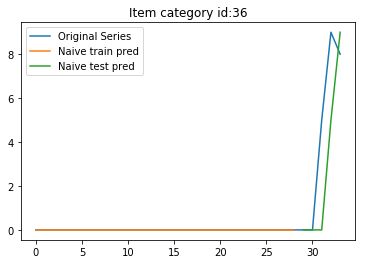

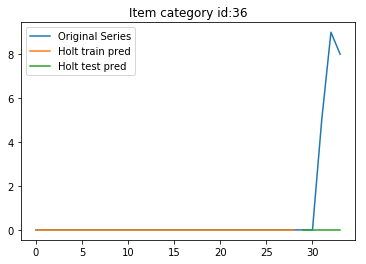

29 36 2.898275349237888 5.830951894845301


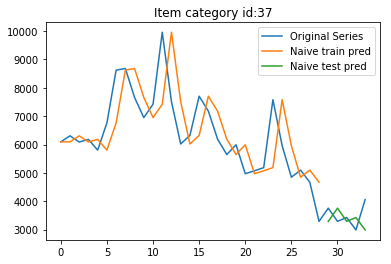

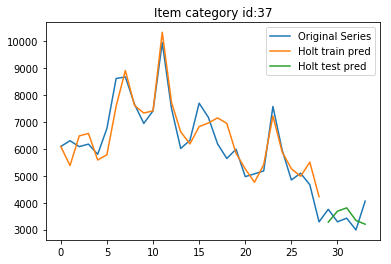

29 37 598.9368915002649 527.6793787963085


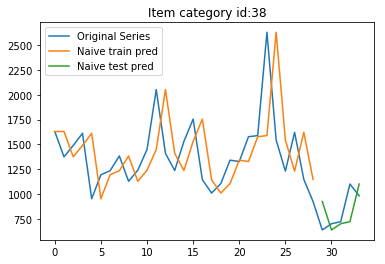

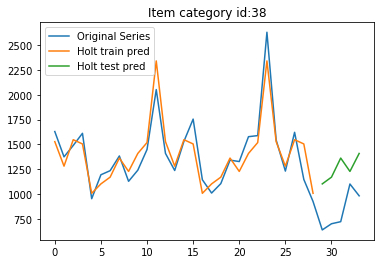

29 38 220.8542505816902 456.4722264721828


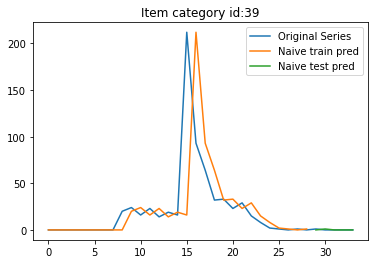

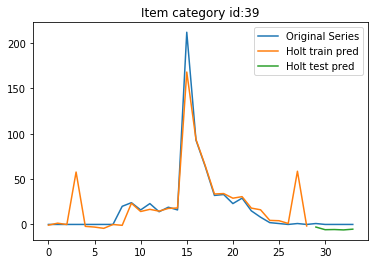

29 39 0.6324555320336759 5.366612844664299


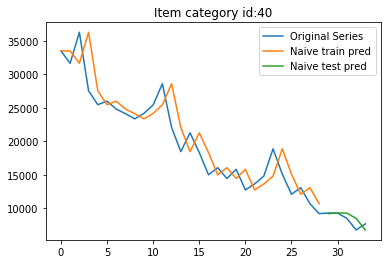

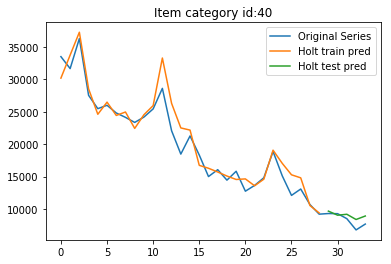

29 40 940.3312182417427 977.4131705565261


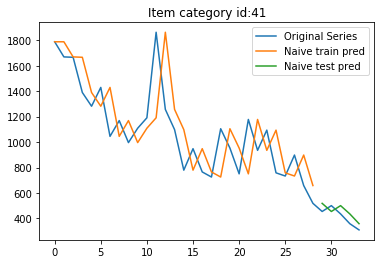

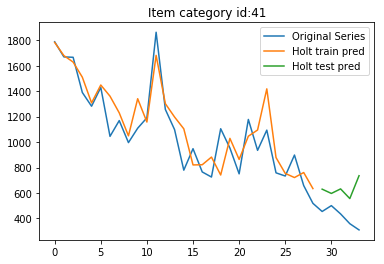

29 41 61.264998163714985 244.7781320471653


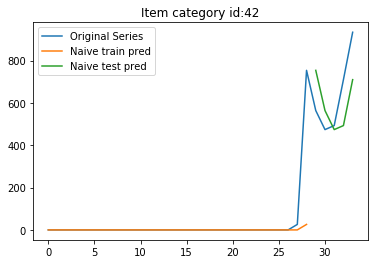

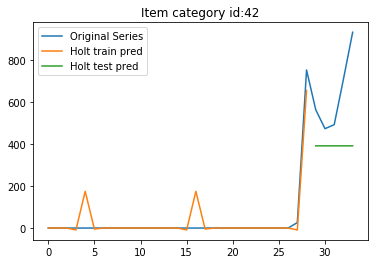

29 42 168.41971381046815 297.0149698055109


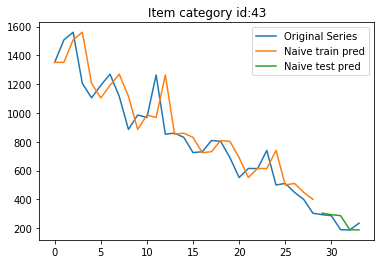

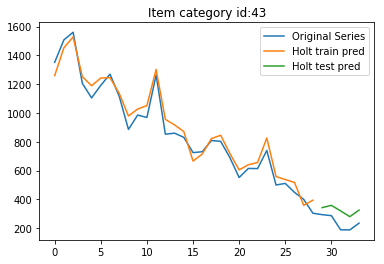

29 43 48.91421061409455 91.04826011987484


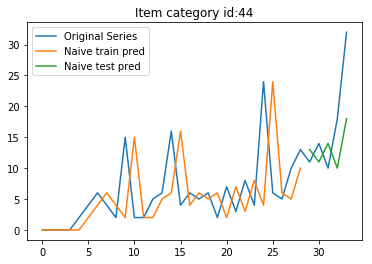

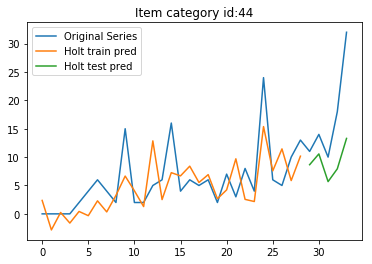

29 44 7.602631123499285 9.87124950451257


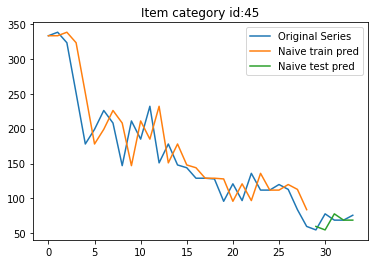

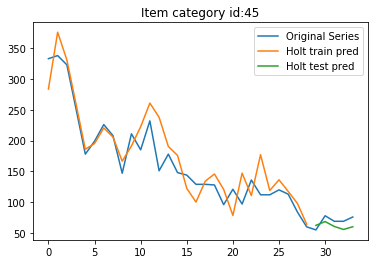

29 45 11.696153213770756 11.308359095329845


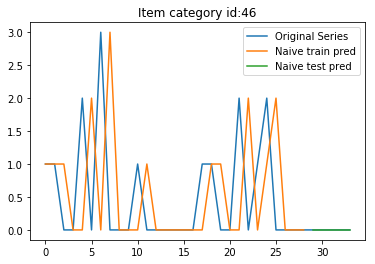

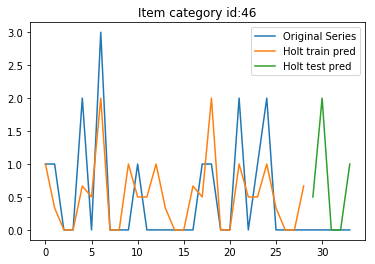

29 46 0.0 1.0246952939300311


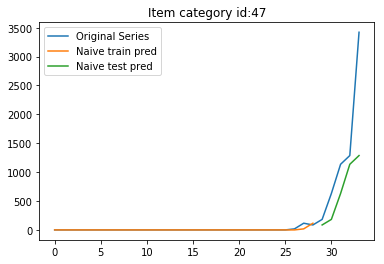

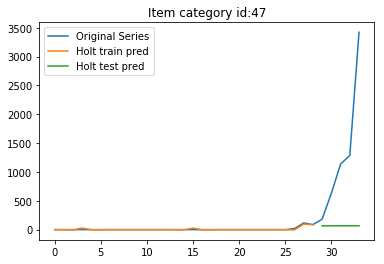

29 47 1004.2622167541703 1685.9802390593488


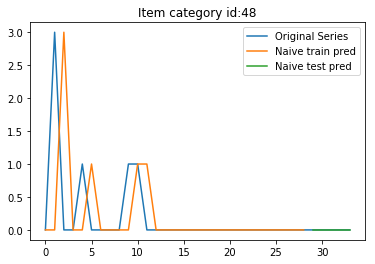

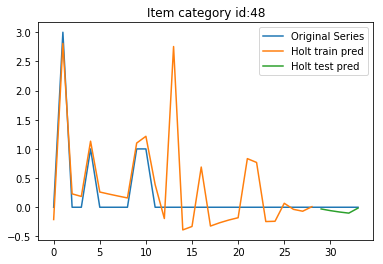

29 48 0.0 0.06513769314586473


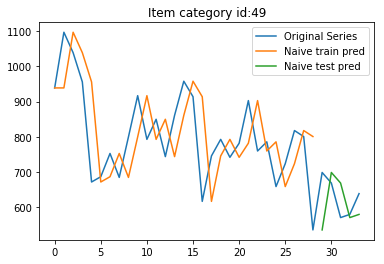

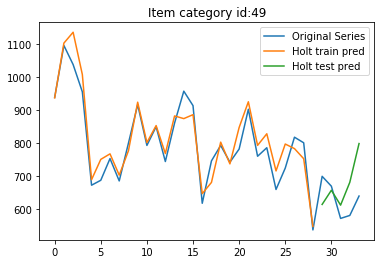

29 49 90.14987520790032 94.60779277534033


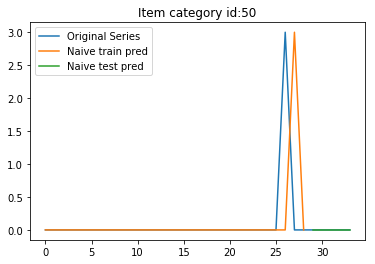

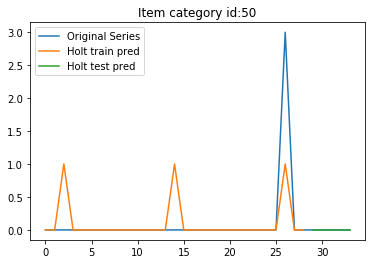

29 50 0.0 4.647621207854737e-08


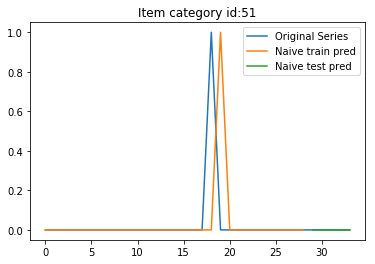

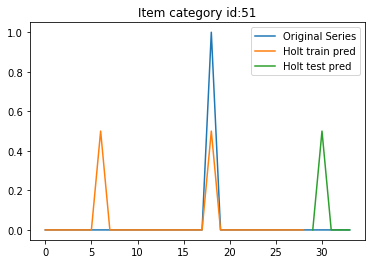

29 51 0.0 0.22360680595319352


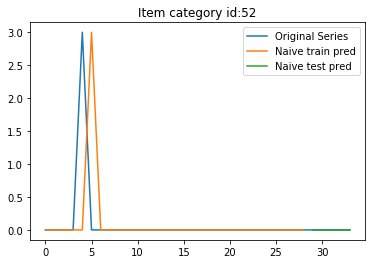

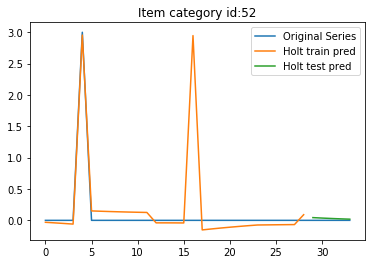

29 52 0.0 0.031643531347280596


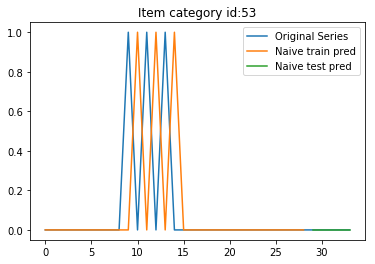

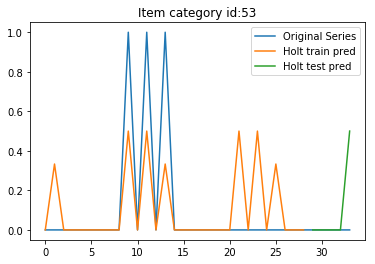

29 53 0.0 0.22360695599023925


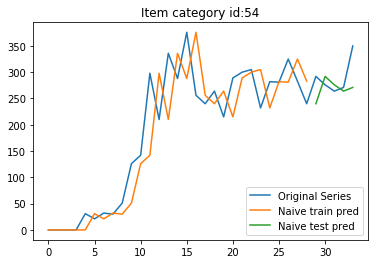

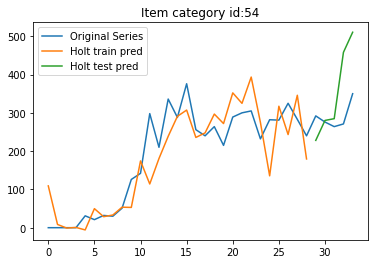

29 54 43.34512660034574 114.26338644475788


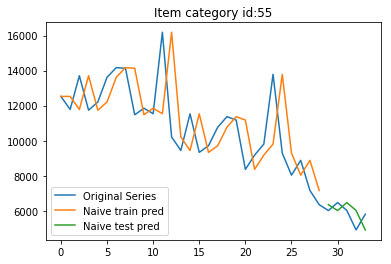

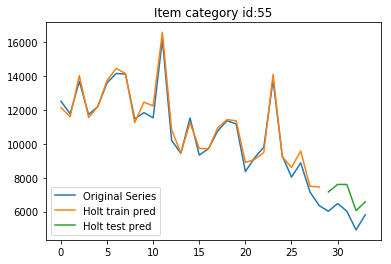

29 55 715.1160744942041 1180.1337833069056


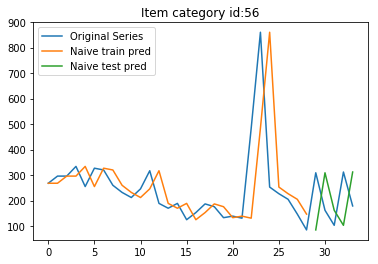

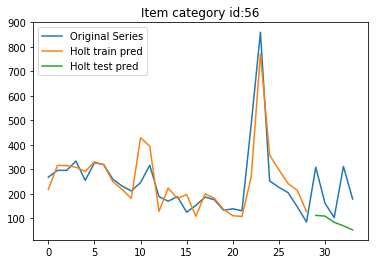

29 56 165.30940687087352 152.7232534570739


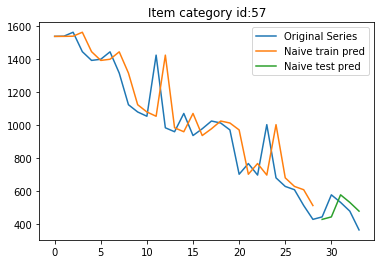

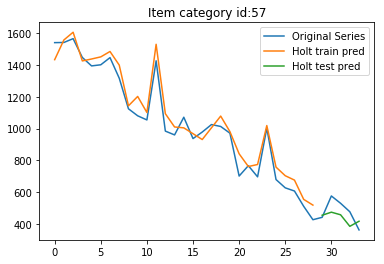

29 57 84.9729368681582 73.53390331167188


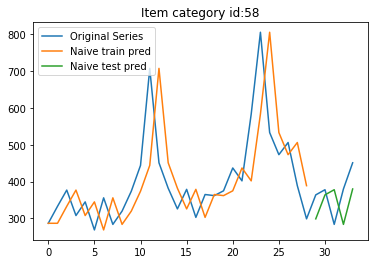

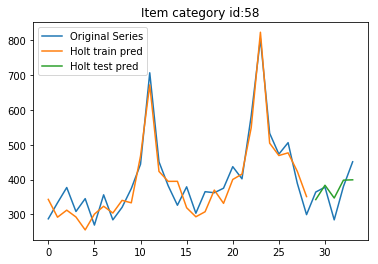

29 58 74.18086006511383 38.637610703679044


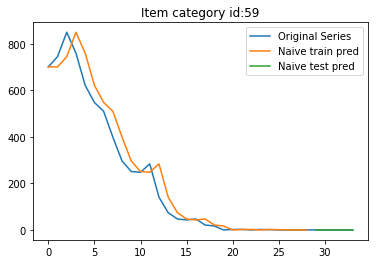

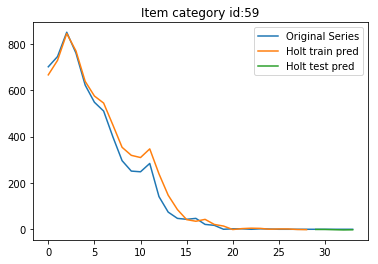

29 59 0.0 1.8574539296097616


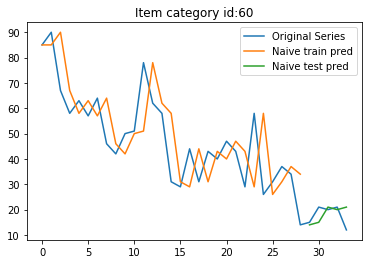

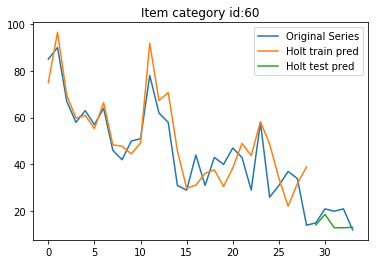

29 60 4.898979485566356 4.94823743956535


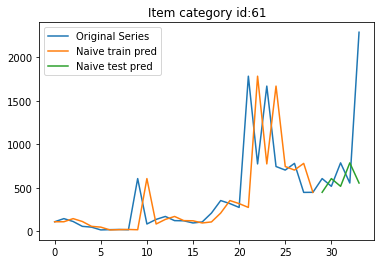

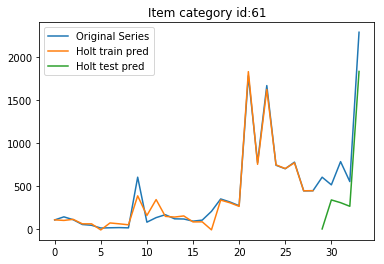

29 61 796.6561366110224 426.800489222954


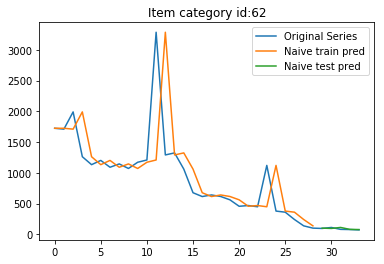

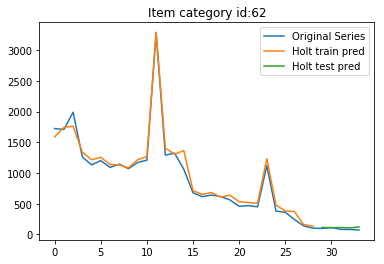

29 62 16.043690348545123 29.08307429245236


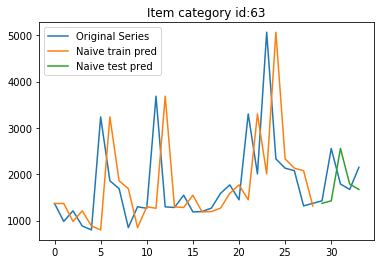

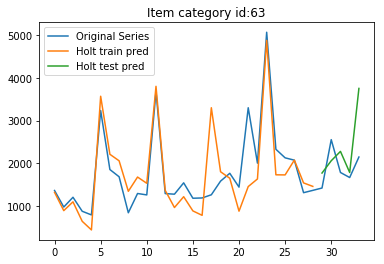

29 63 649.8582922453171 798.673468146433


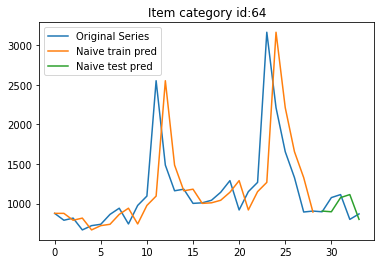

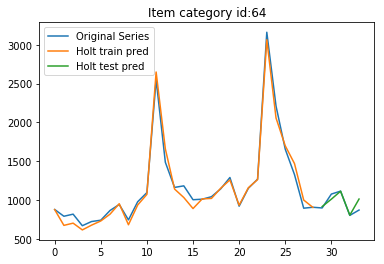

29 64 165.10360383710588 70.38539558055454


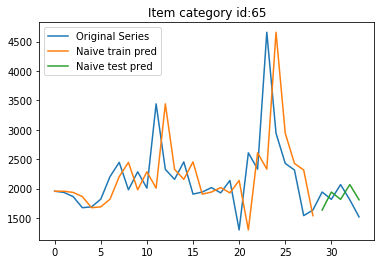

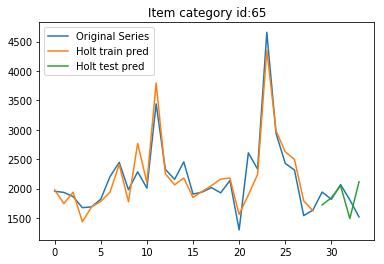

29 65 254.47003752897905 318.2810495213796


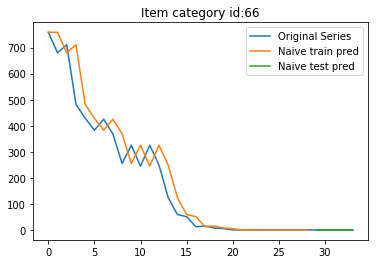

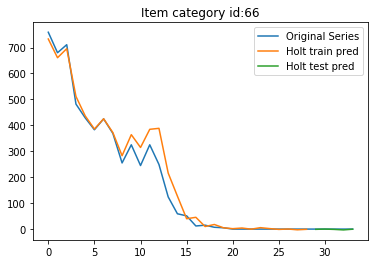

29 66 0.0 1.6152421752319235


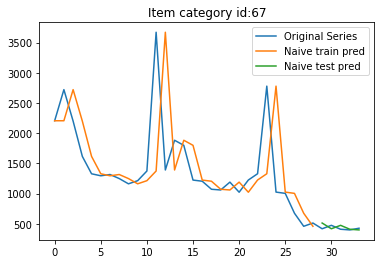

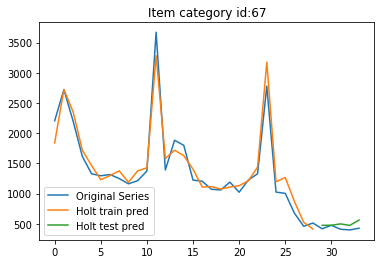

29 67 58.99830506039983 83.55564010503247


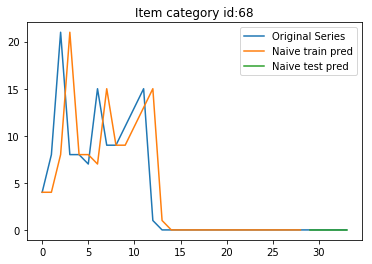

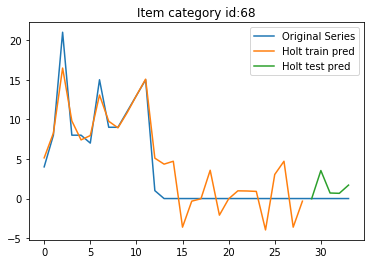

29 68 0.0 1.8066554709452451


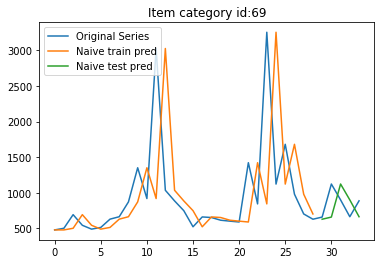

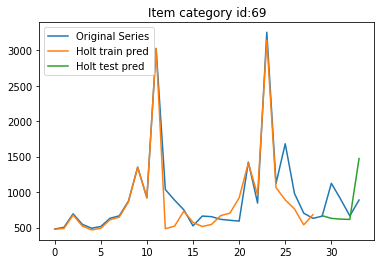

29 69 272.52522818997875 365.5245929077151


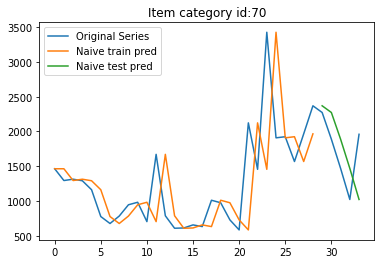

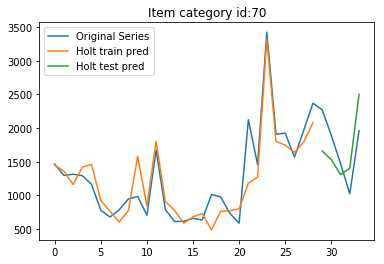

29 70 530.5414215685709 440.1474146593871


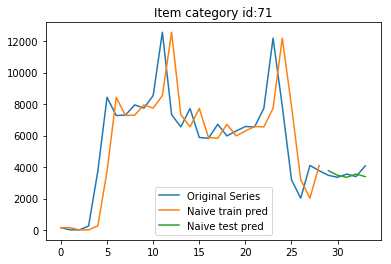

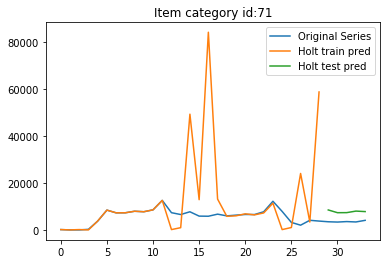

29 71 358.82642043194085 4259.818840101111


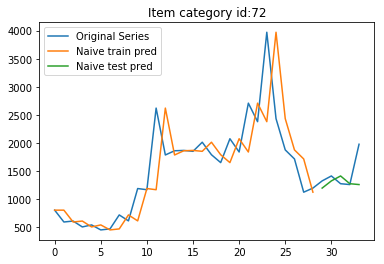

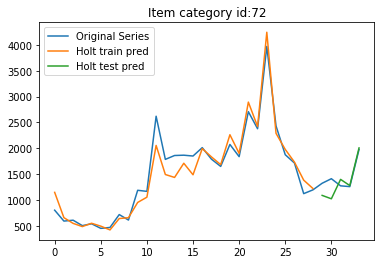

29 72 334.34144224131114 211.21822338952802


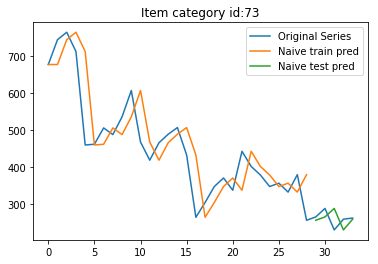

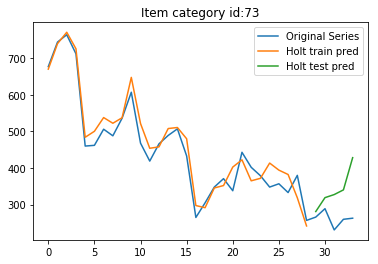

29 73 31.06122985330748 94.06313564356111


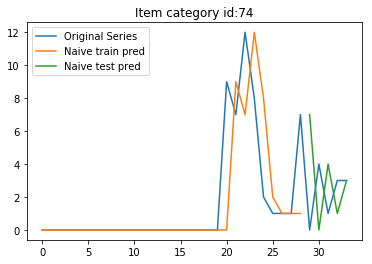

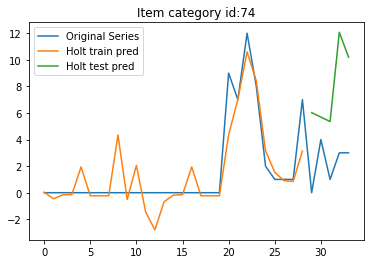

29 74 3.9496835316262997 6.199524869054997


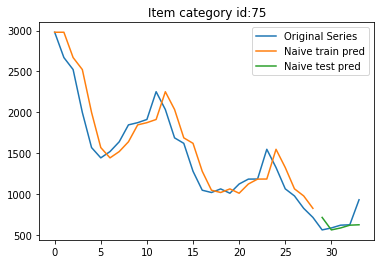

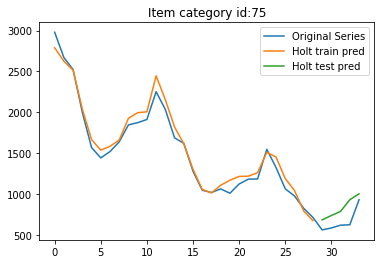

29 75 154.14408843676102 182.22299107926304


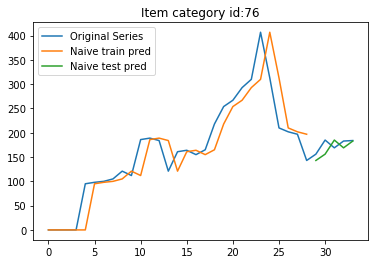

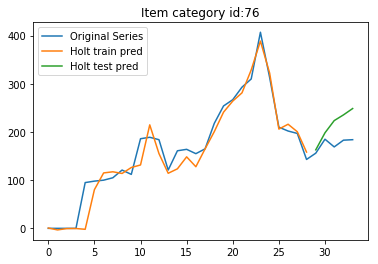

29 76 17.10555465338672 45.03717485122259


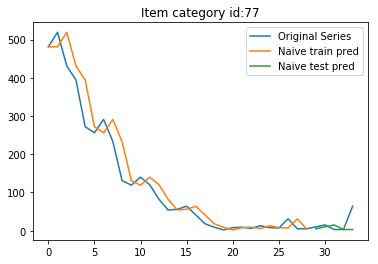

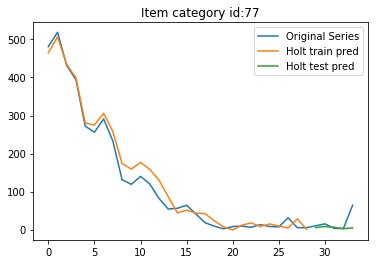

29 77 27.982137159266443 26.908848797453015


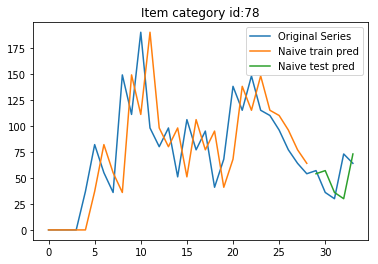

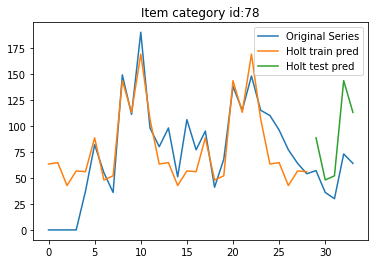

29 78 21.98181066245454 42.40517742004515


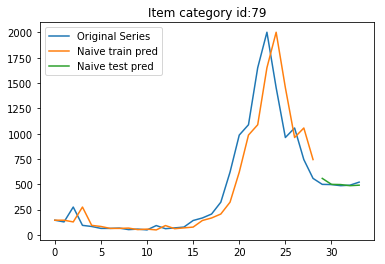

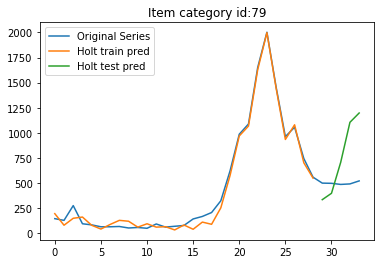

29 79 30.103155980727337 428.98781299839476


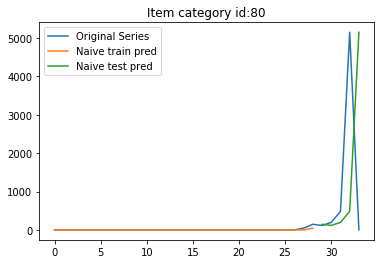

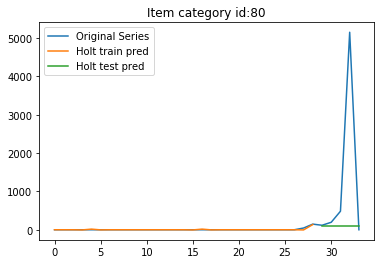

29 80 3110.4239260911045 2267.193475816437


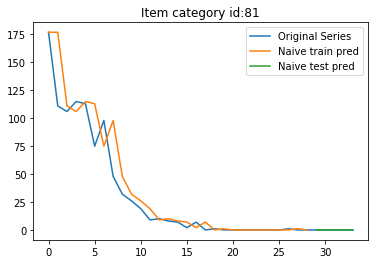

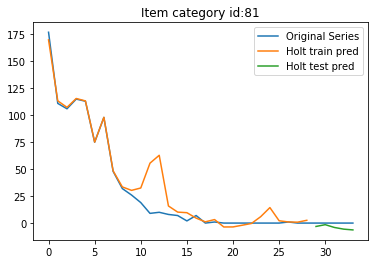

29 81 0.0 4.486039619229693


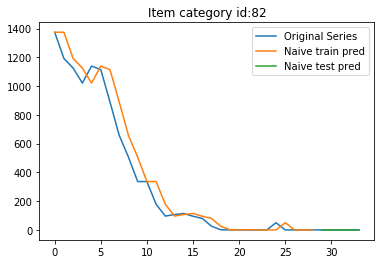

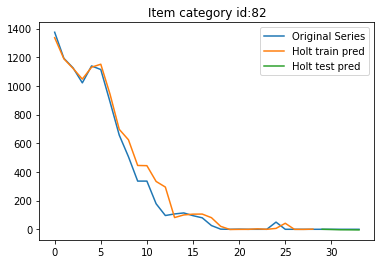

29 82 0.0 2.988147466810074


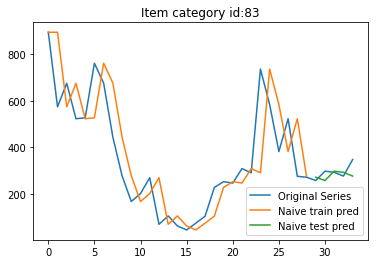

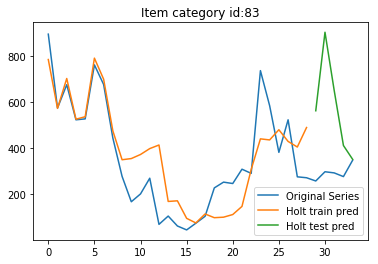

29 83 37.73062416658383 347.3292755940005


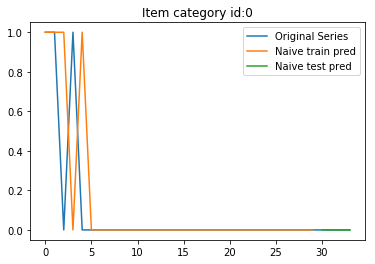

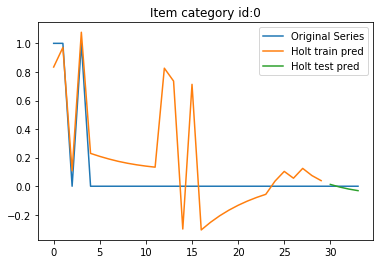

30 0 0.0 0.019583724483027906


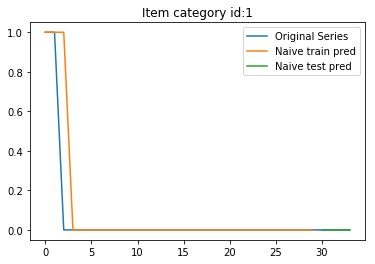

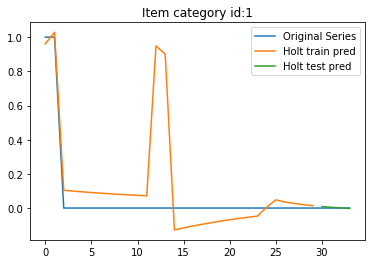

30 1 0.0 0.004962532280988582


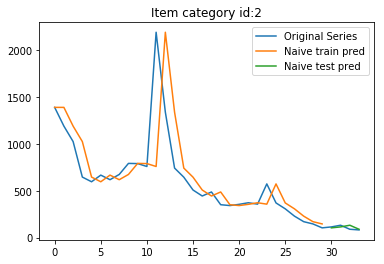

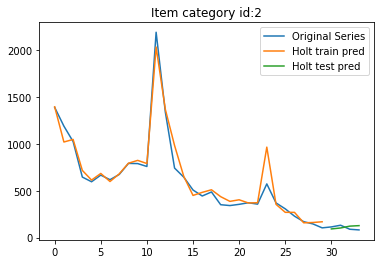

30 2 24.093567606313517 33.63535512078069


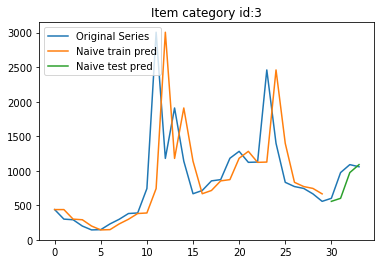

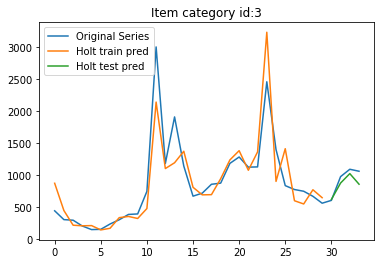

30 3 196.5362561971709 118.3835117349006


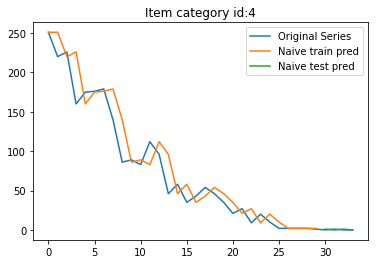

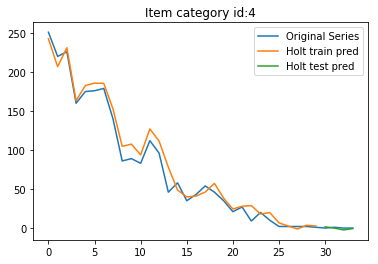

30 4 0.8660254037844386 1.5556082805607598


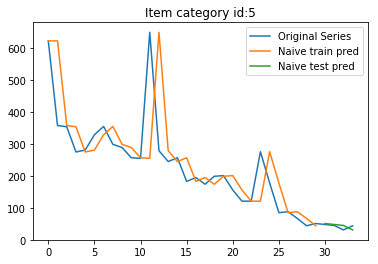

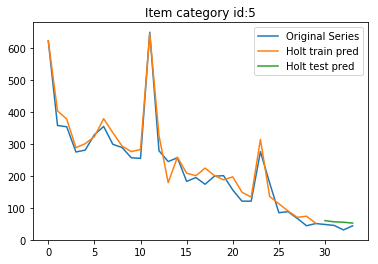

30 5 9.785192895390463 15.199522761971604


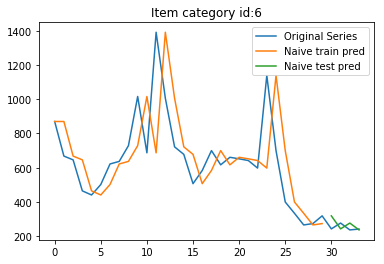

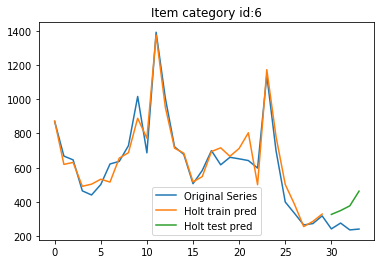

30 6 46.252026982609095 142.47401214086253


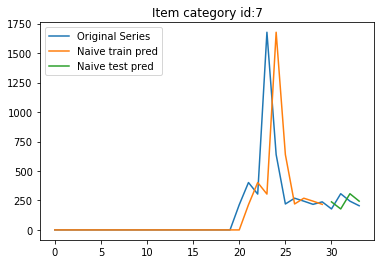

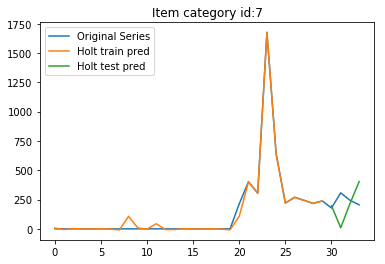

30 7 80.2044263117691 179.62529123141587


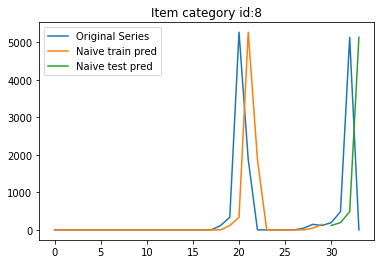

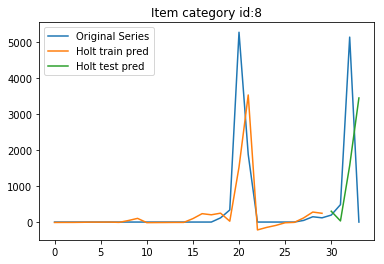

30 8 3463.1106681710303 2487.769858036787


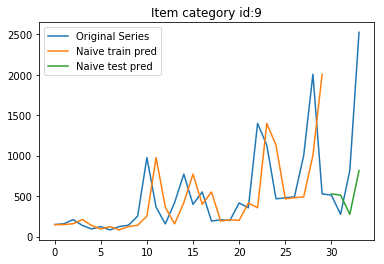

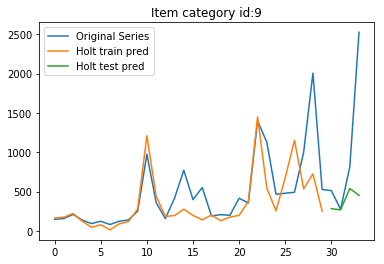

30 9 903.501245156862 1051.4132434734497


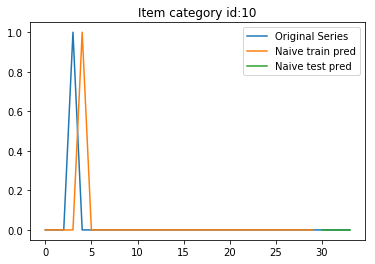

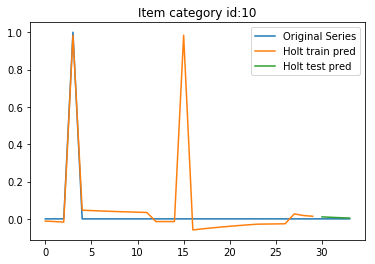

30 10 0.0 0.0077967075365610585


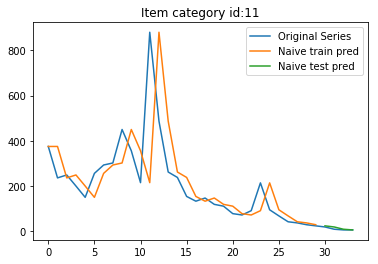

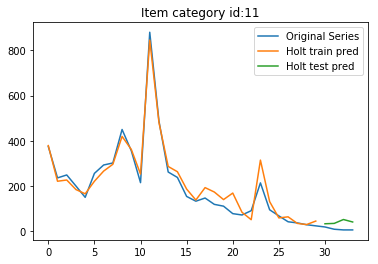

30 11 5.787918451395113 32.443861671972485


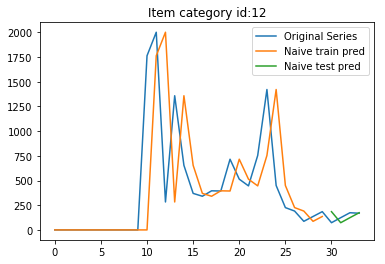

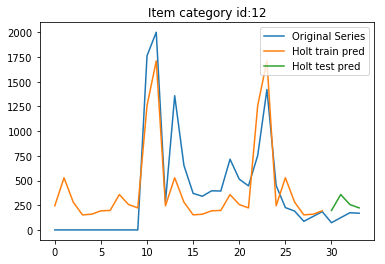

30 12 66.46427611882943 141.3413389034748


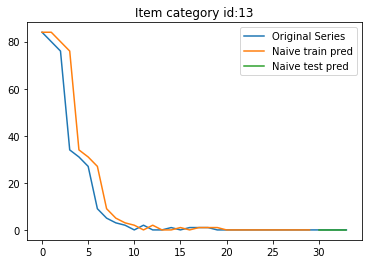

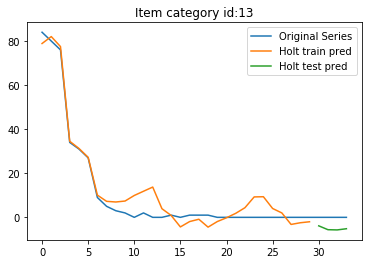

30 13 0.0 5.138080043619877


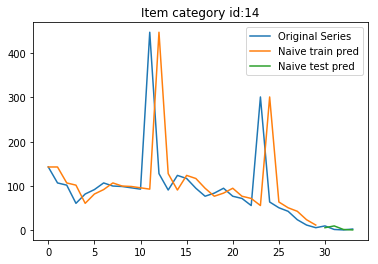

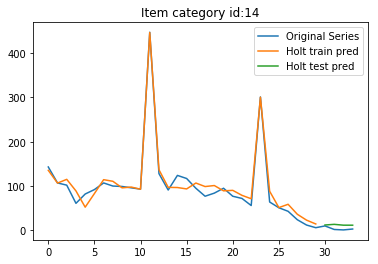

30 14 4.6097722286464435 9.04443852914746


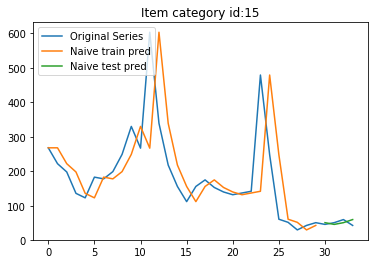

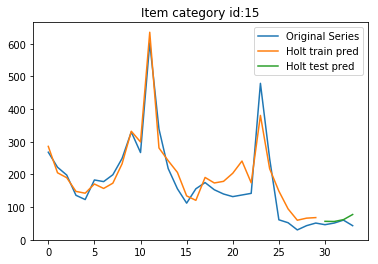

30 15 10.246950765959598 18.043994770359937


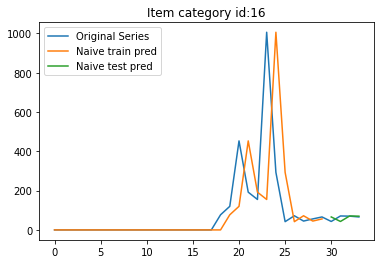

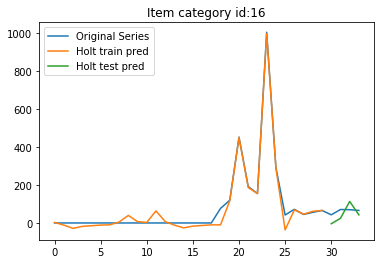

30 16 18.23458252881047 41.313023535407204


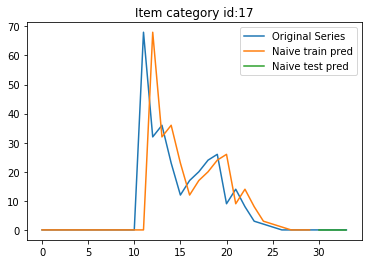

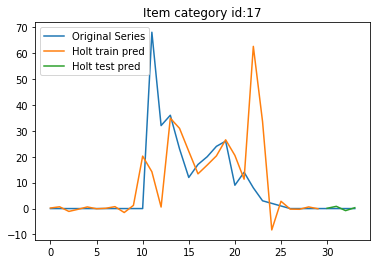

30 17 0.0 0.6113934385977544


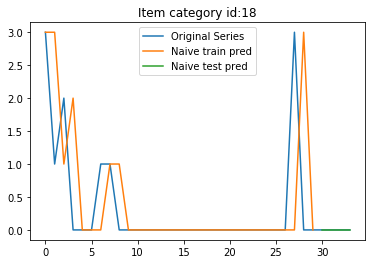

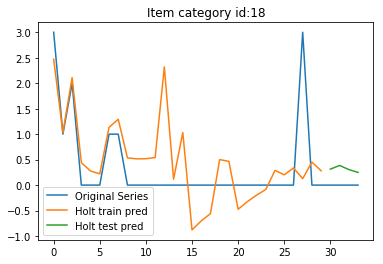

30 18 0.0 0.3170875051205813


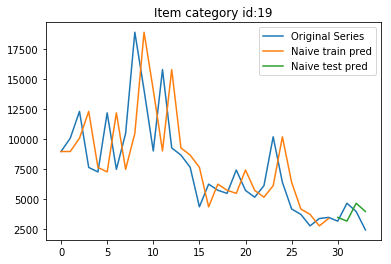

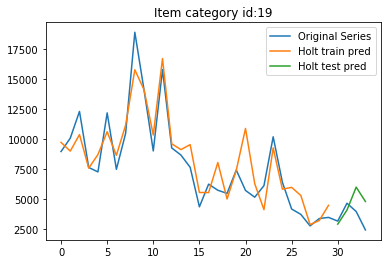

30 19 1134.1562943439499 1592.8157614763084


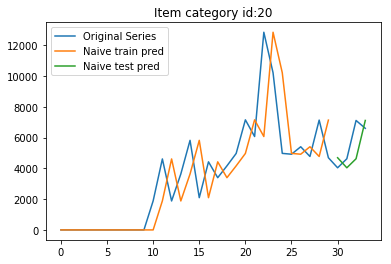

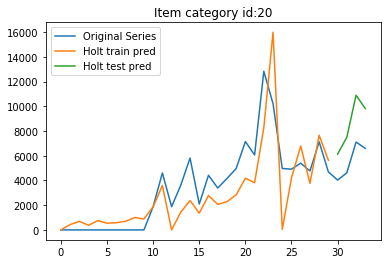

30 20 1343.1395124855794 3059.531441400572


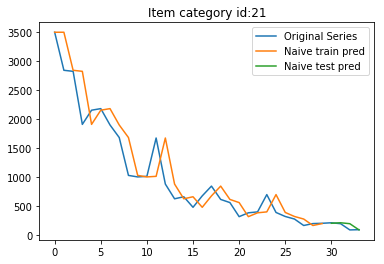

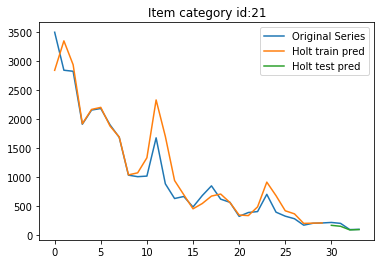

30 21 54.3185051340701 35.39294475637486


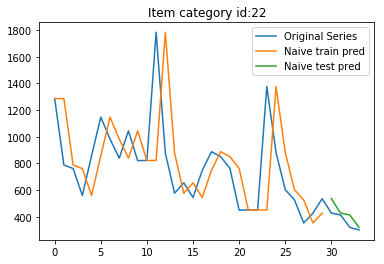

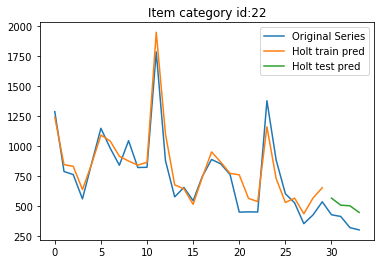

30 22 72.23226425912453 143.19499833037398


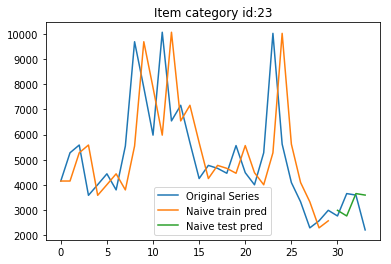

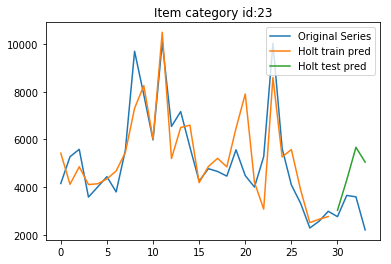

30 23 832.4474457886215 1795.6959300078654


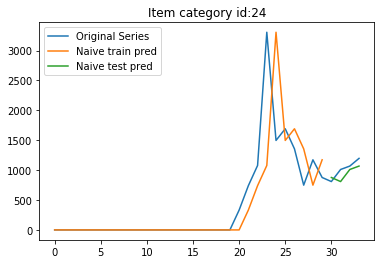

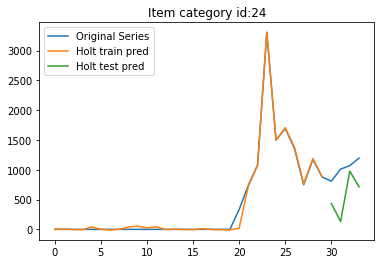

30 24 127.78693203923474 537.7997479227985


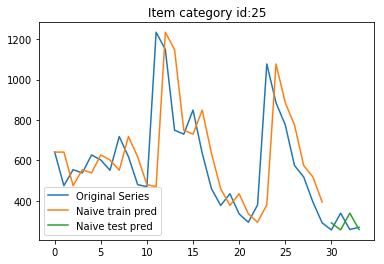

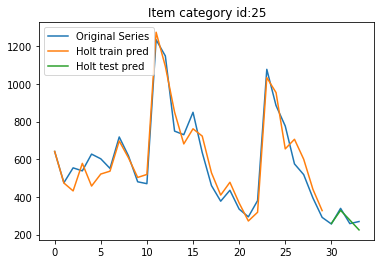

30 25 60.81940479813988 24.798305818316305


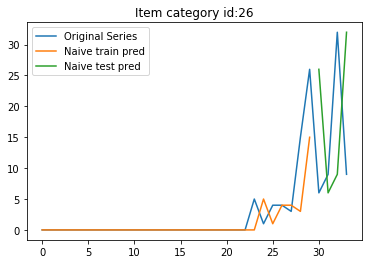

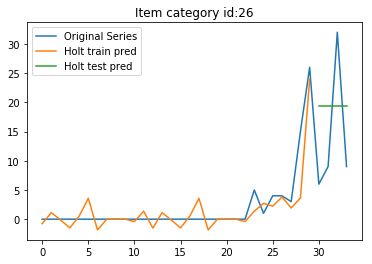

30 26 19.150718002205558 11.76691908253283


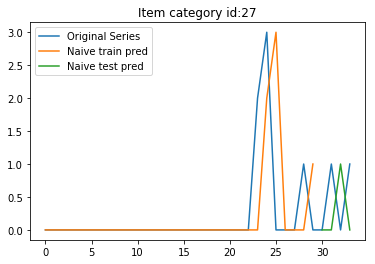

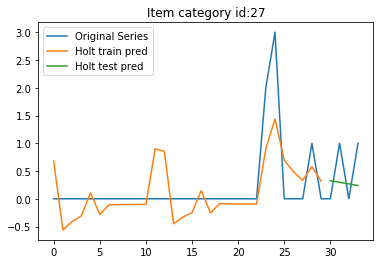

30 27 0.8660254037844386 0.5594948829193344


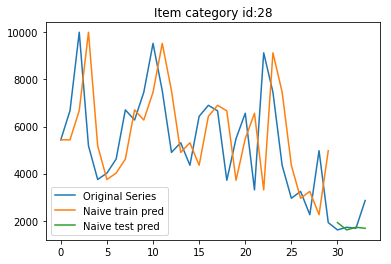

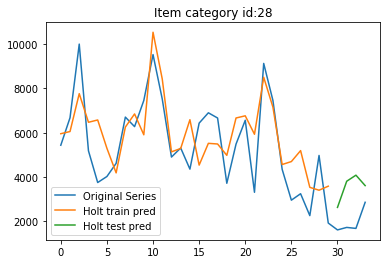

30 28 613.0444518956191 1712.9986723560614


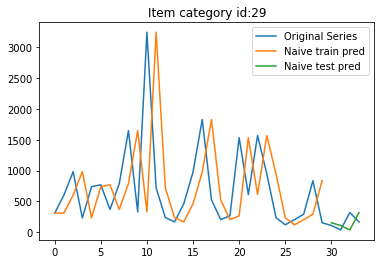

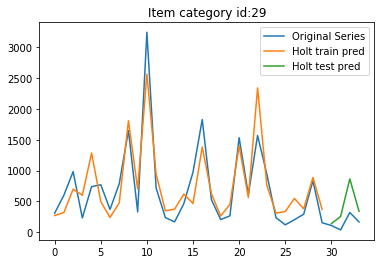

30 29 166.5270248338089 306.6627892507649


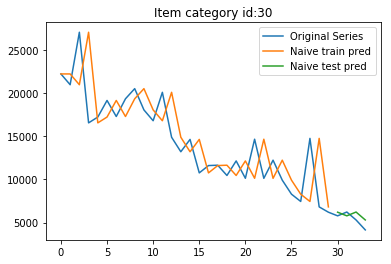

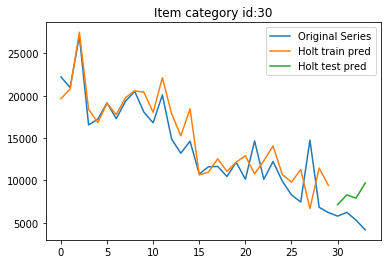

30 30 798.0316409767222 3302.3020824789874


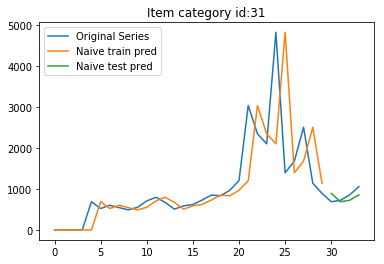

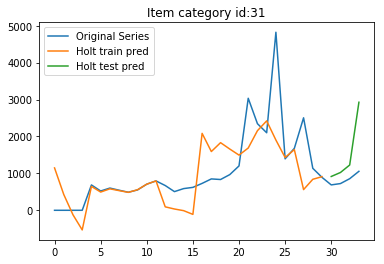

30 31 158.37929157563497 972.3111968515899


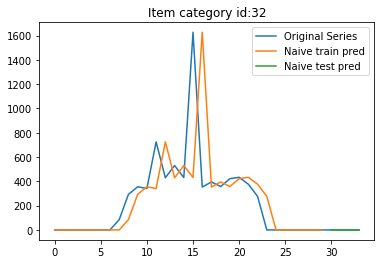

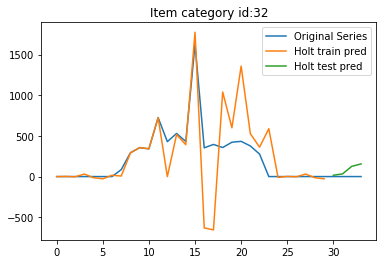

30 32 0.0 101.63604084021502


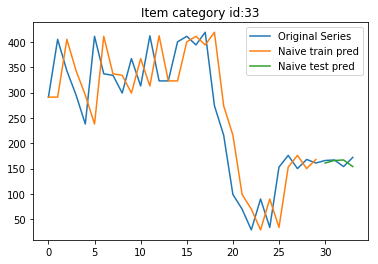

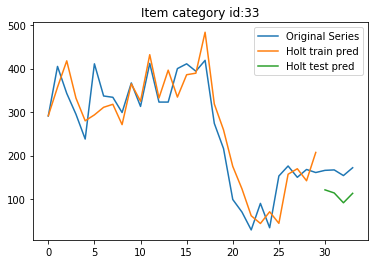

30 33 11.390785749894517 55.2410335149566


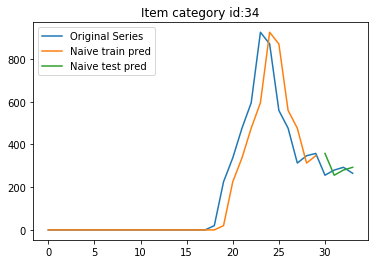

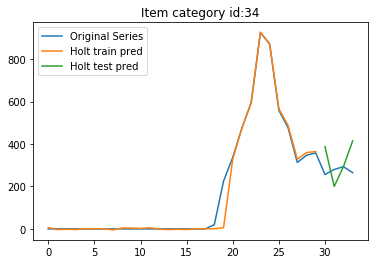

30 34 54.61913584083879 107.15915794472414


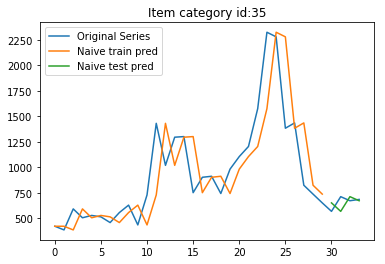

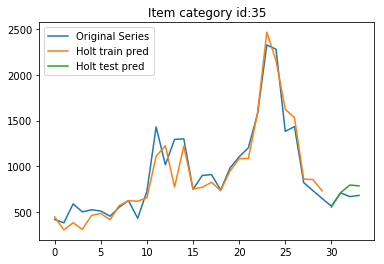

30 35 85.7233923733773 81.71699660185892


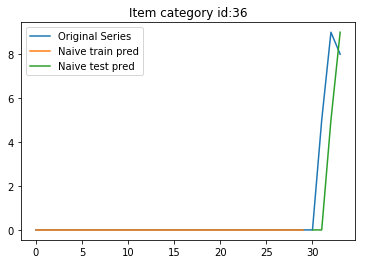

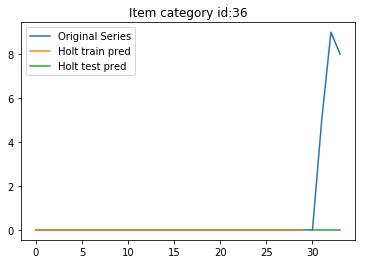

30 36 3.24037034920393 6.519202405202649


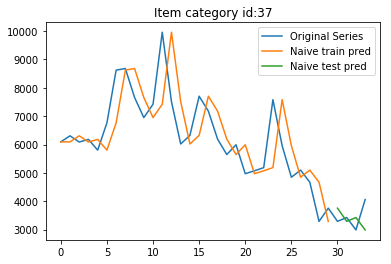

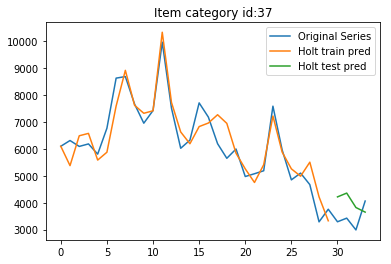

30 37 627.4159306233785 802.6766767913224


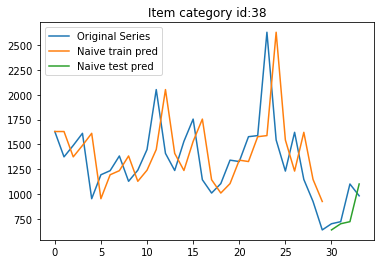

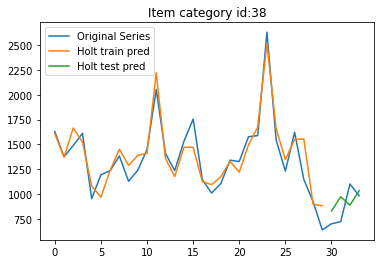

30 38 201.3001490312414 178.43359960988883


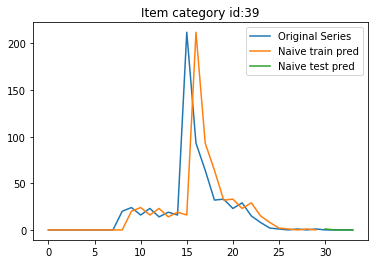

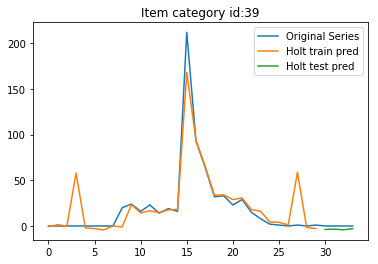

30 39 0.5 3.621954604830795


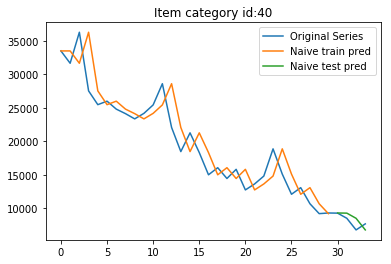

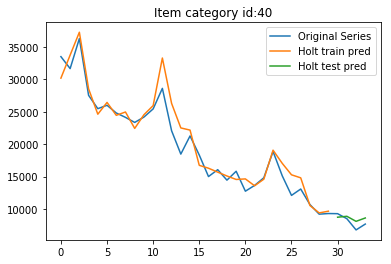

30 40 1050.2259280745263 874.5402613907725


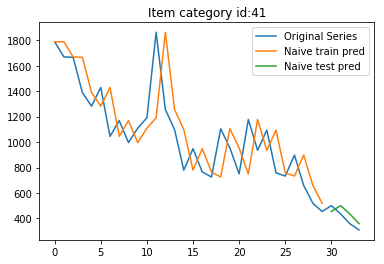

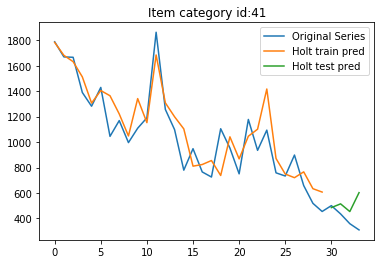

30 41 60.56195175190443 159.34874603117873


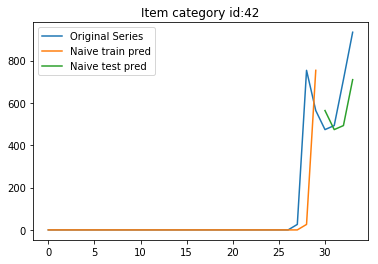

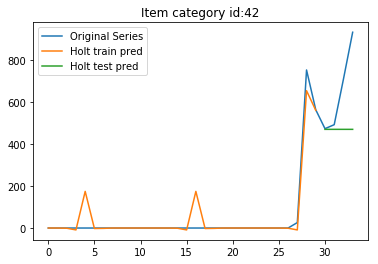

30 42 162.5776737439677 260.9277680623902


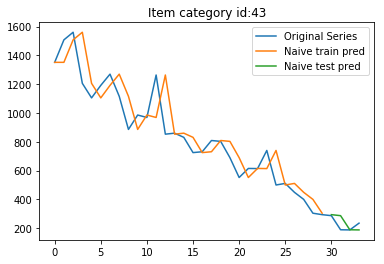

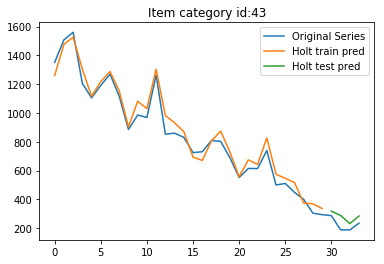

30 43 54.458699947758575 61.753186201707905


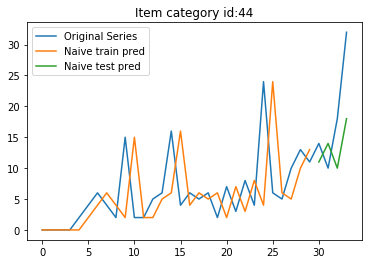

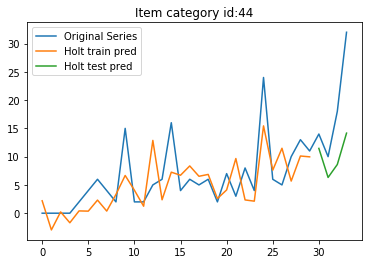

30 44 8.440971508067067 10.326206014806516


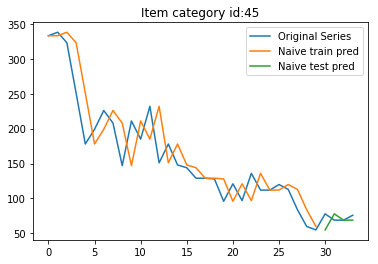

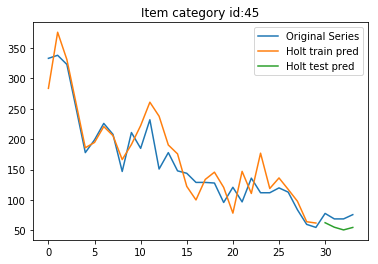

30 45 12.835497652993435 17.248343304620533


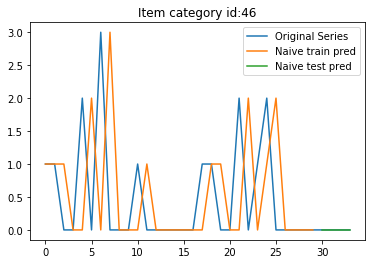

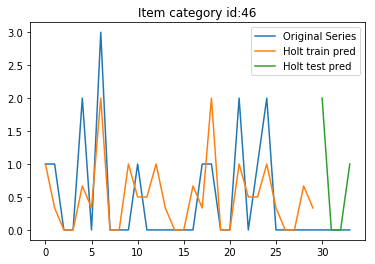

30 46 0.0 1.1180339616019568


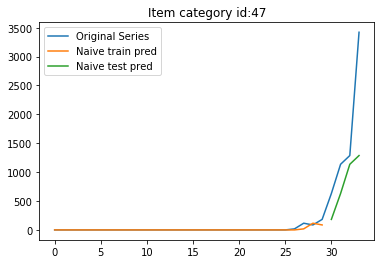

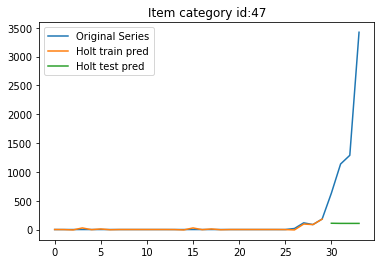

30 47 1121.7728156806083 1851.5632776627685


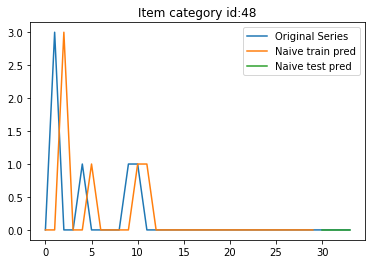

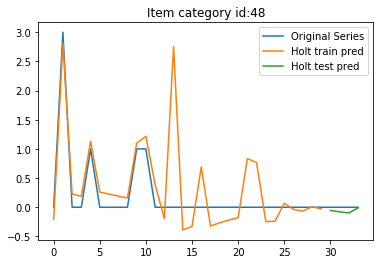

30 48 0.0 0.06864164298452125


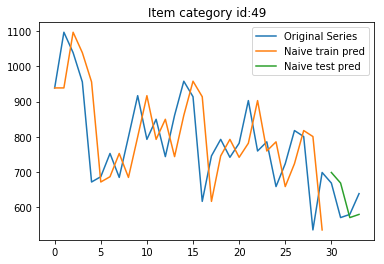

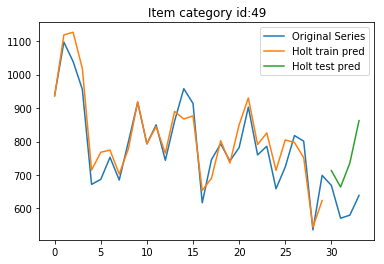

30 49 59.3000843169721 145.60640539913672


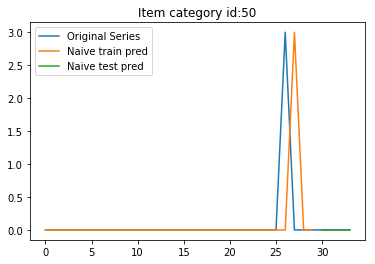

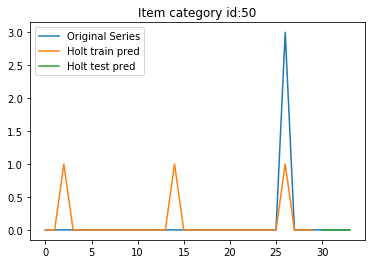

30 50 0.0 2.331468876011214e-08


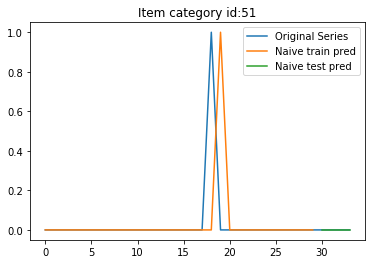

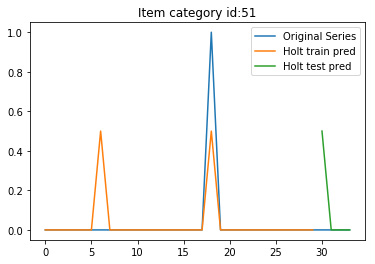

30 51 0.0 0.2500000718327372


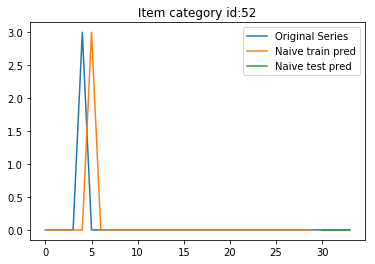

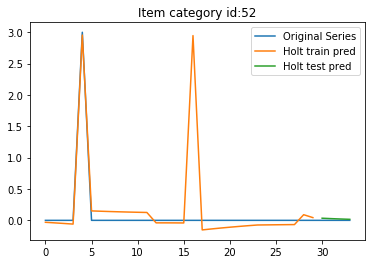

30 52 0.0 0.025640673432544267


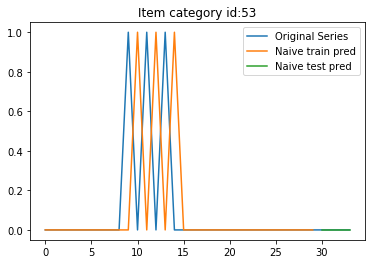

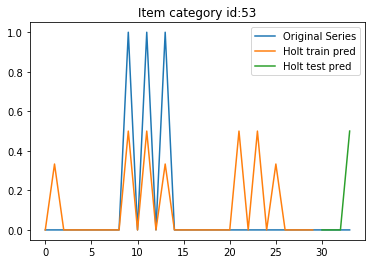

30 53 0.0 0.2499999738260812


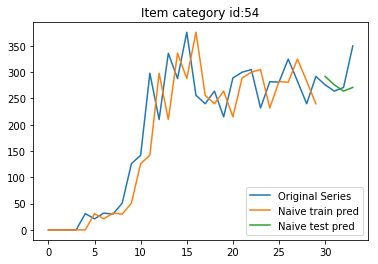

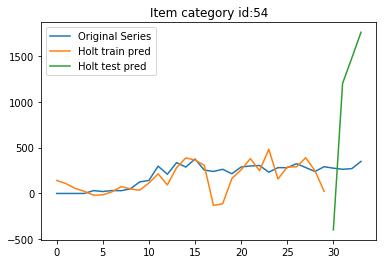

30 54 40.89621009335706 1093.1567536208581


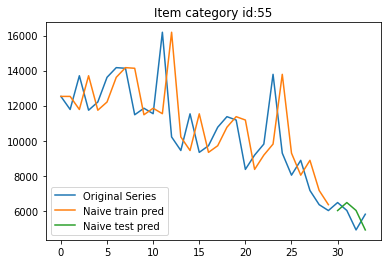

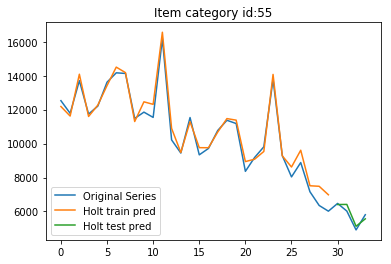

30 55 781.6743247670349 256.4713245667833


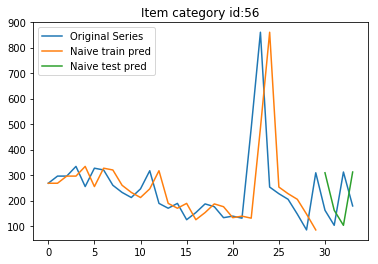

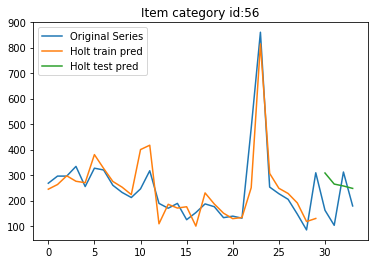

30 56 147.02040674681865 117.51404537584385


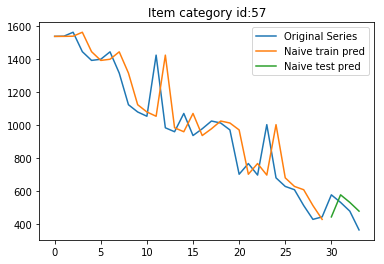

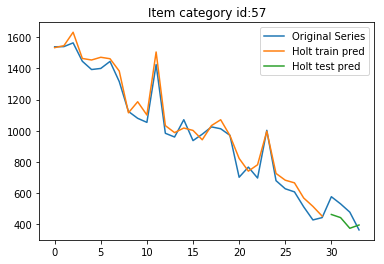

30 57 94.70612440597493 90.0900373183265


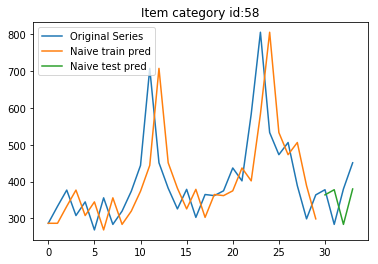

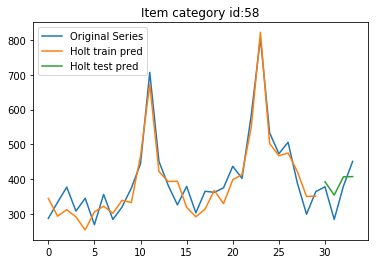

30 58 76.30366963652534 43.99518416449147


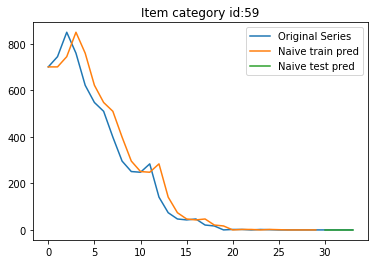

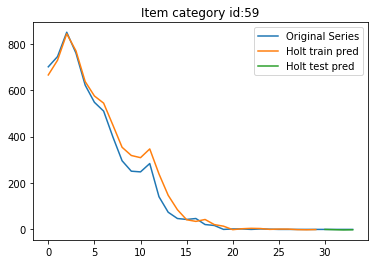

30 59 0.0 1.478921374612262


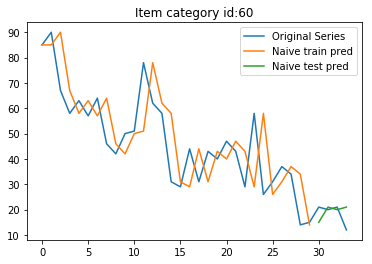

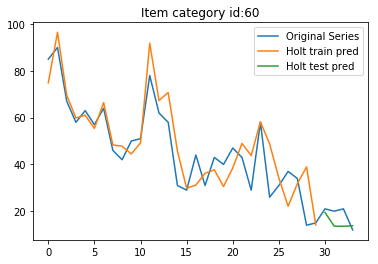

30 60 5.454356057317857 5.037262290949036


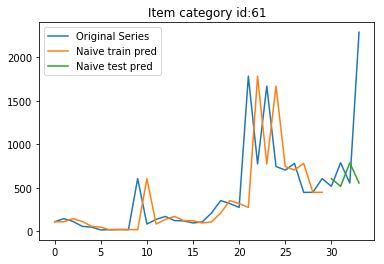

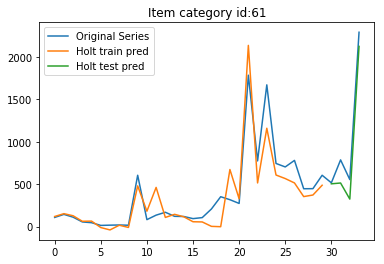

30 61 887.17825153686 196.7830345852928


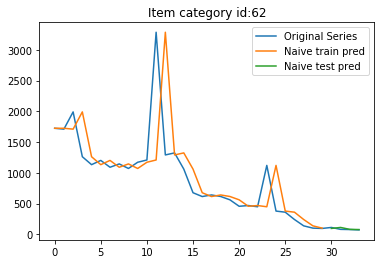

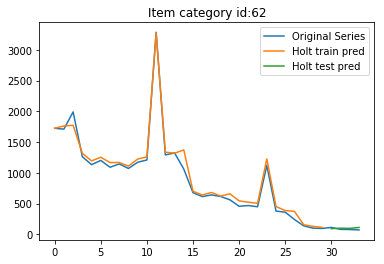

30 62 17.76231966833161 25.917316880132788


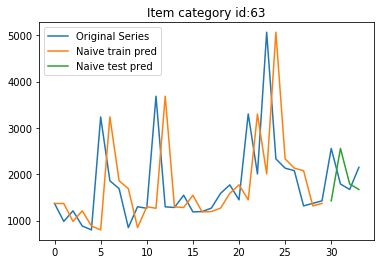

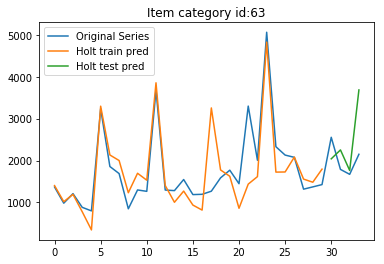

30 63 726.0430428011827 844.3659805665169


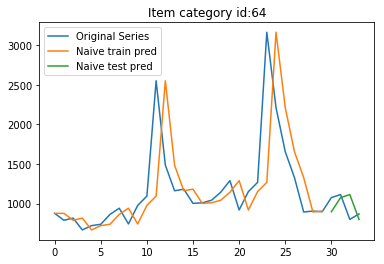

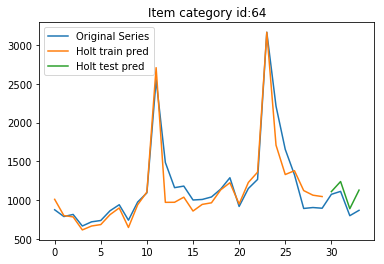

30 64 184.5365817392313 152.6185107486317


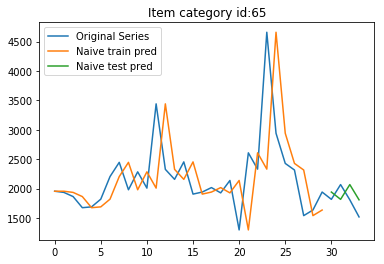

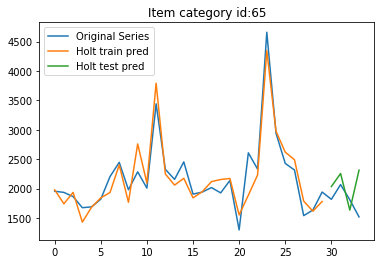

30 65 239.86402398025427 431.8311619516645


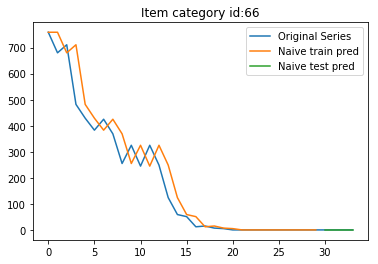

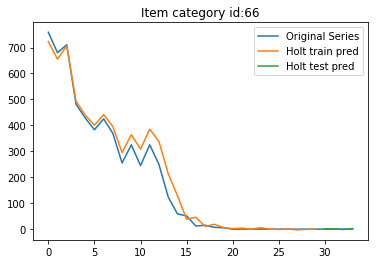

30 66 0.0 1.526347131653028


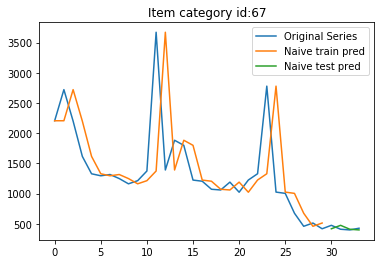

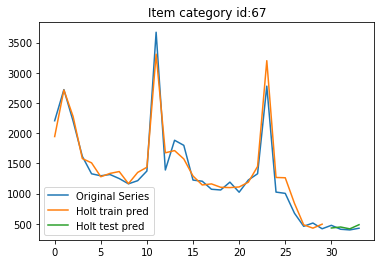

30 67 45.76843890717707 41.90543518767443


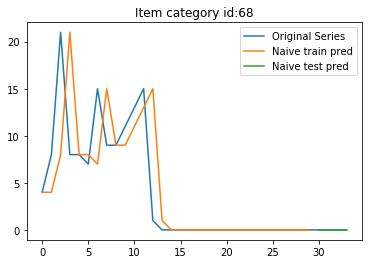

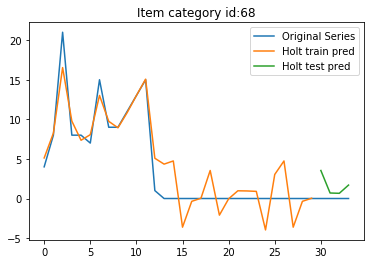

30 68 0.0 2.020029710195013


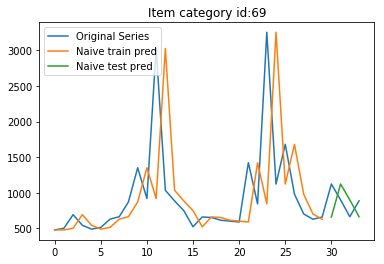

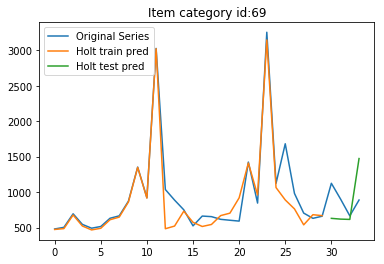

30 69 304.32301917534926 408.62992866971206


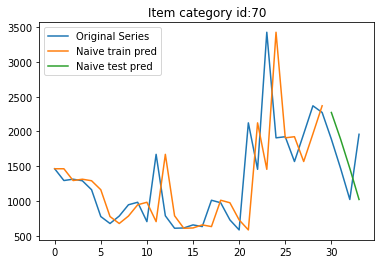

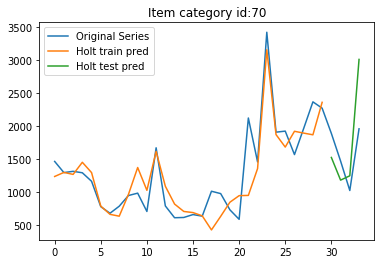

30 70 591.2180223910634 586.1961105891137


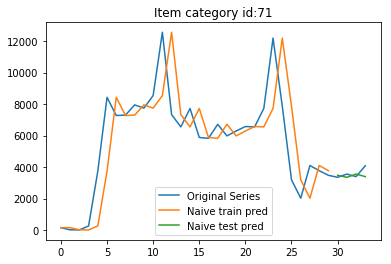

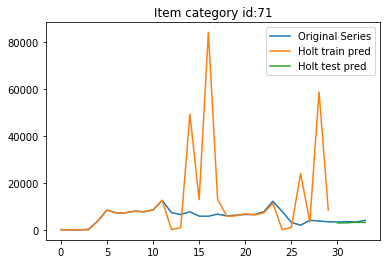

30 71 373.080755333212 553.1729504858804


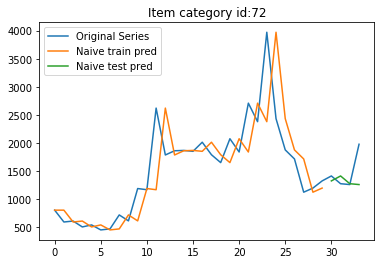

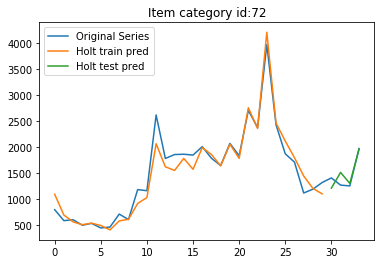

30 72 368.28555497059614 158.45967241353375


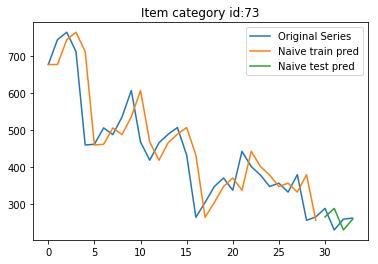

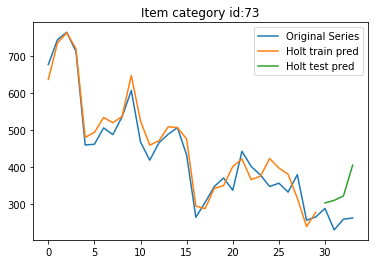

30 73 34.43472084974699 87.80392004355383


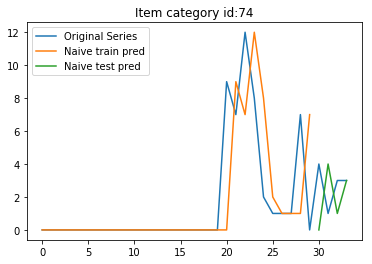

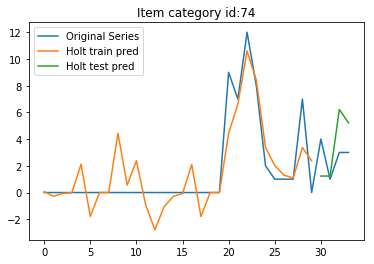

30 74 2.692582403567252 2.397794996631166


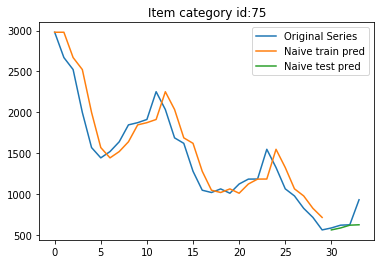

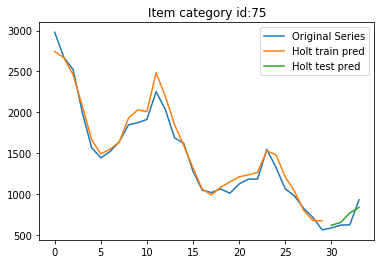

30 75 154.42878617667108 89.11722941517068


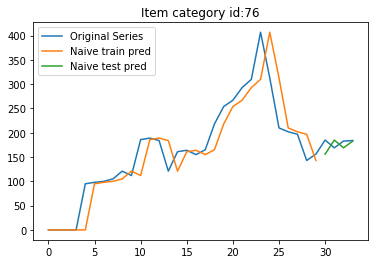

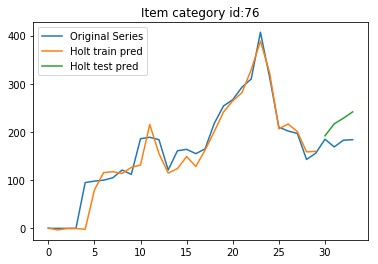

30 76 17.98610574860495 44.03899779500458


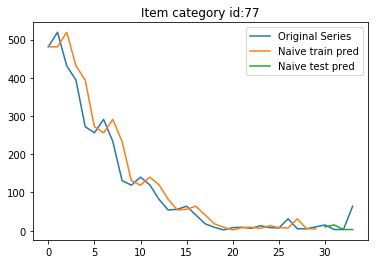

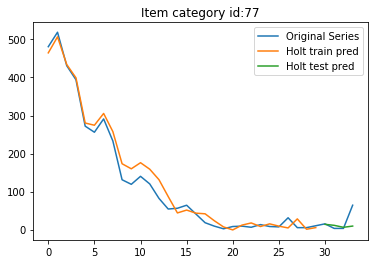

30 77 31.184932259025352 27.772972908492953


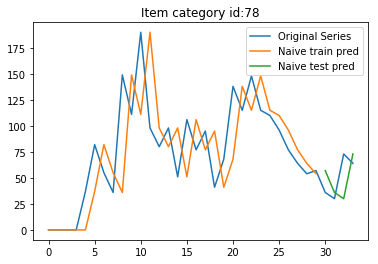

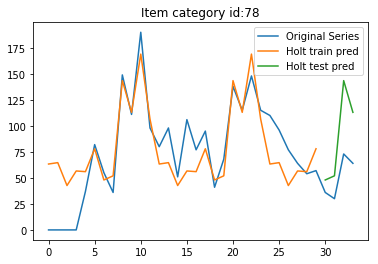

30 78 24.53059314407216 44.71897513120226


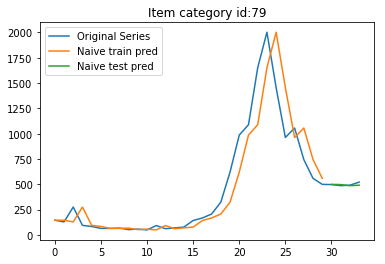

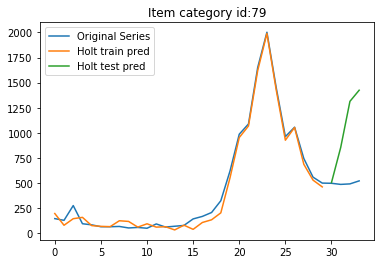

30 79 16.20185174601965 637.9634623731871


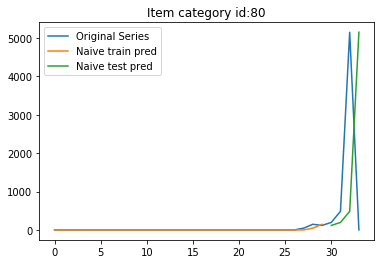

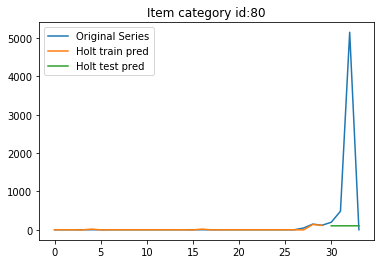

30 80 3477.5273183686136 2531.302846018972


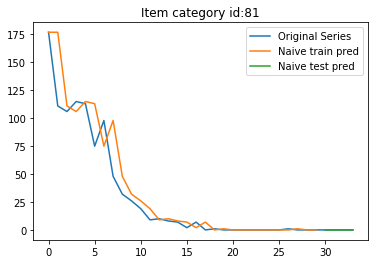

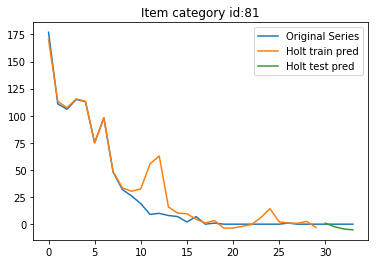

30 81 0.0 3.6628600203415846


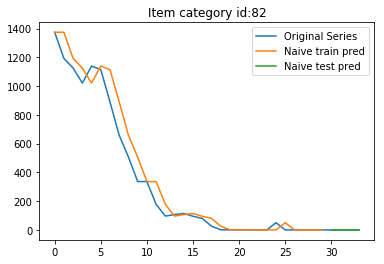

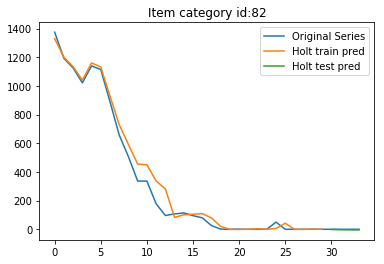

30 82 0.0 3.420803817662684


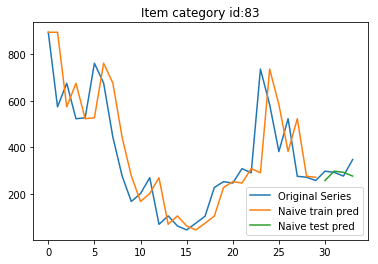

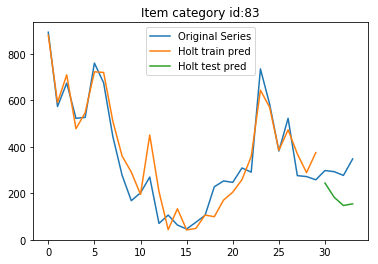

30 83 41.59927883990298 131.7244290613471


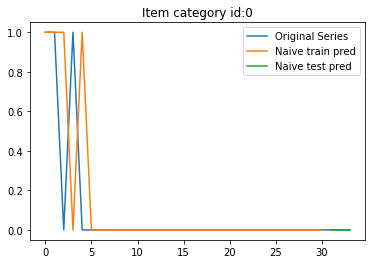

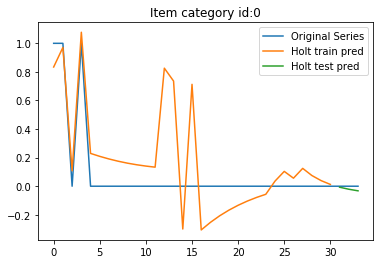

31 0 0.0 0.02259674952409278


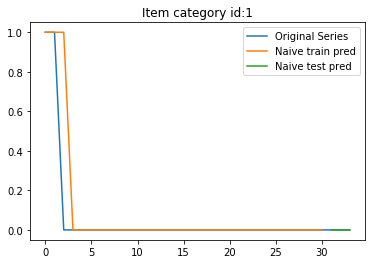

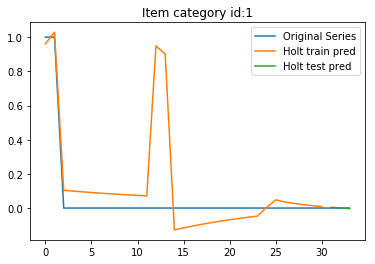

31 1 0.0 0.0028438426808015485


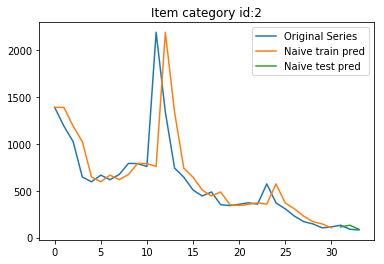

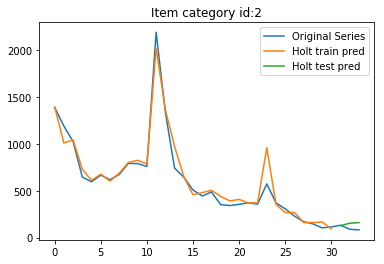

31 2 27.215191835933595 58.64181130709813


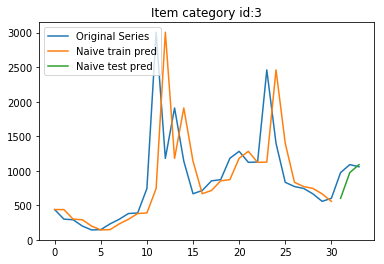

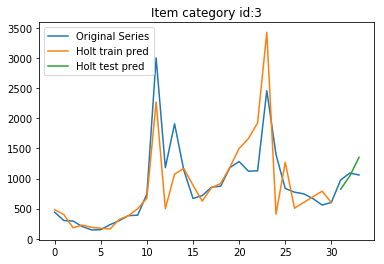

31 3 225.51422719346704 192.97456792600218


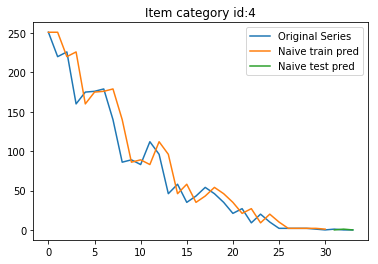

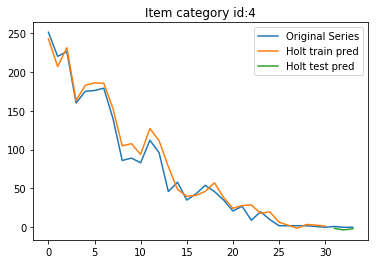

31 4 0.816496580927726 2.651350707787801


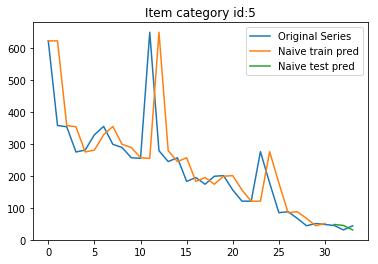

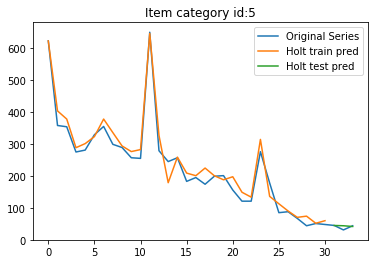

31 5 11.16542281629615 7.627103698789369


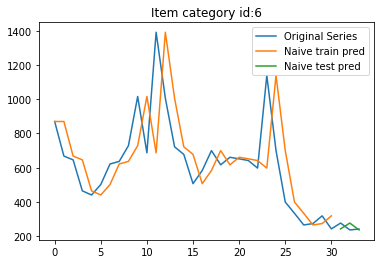

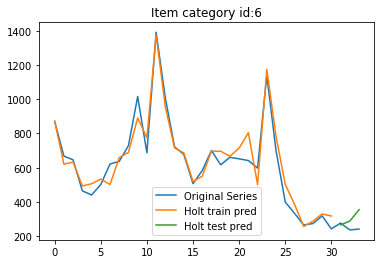

31 6 30.44667469527666 71.93378094370604


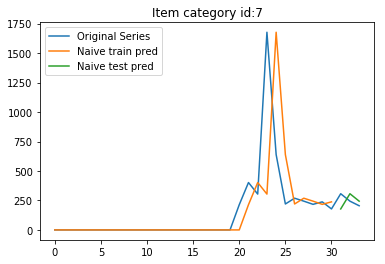

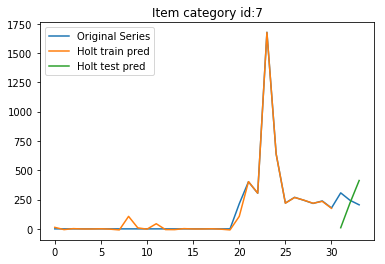

31 7 85.8894638474359 209.7706007503784


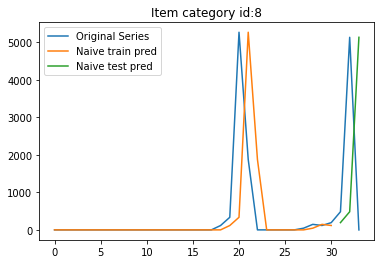

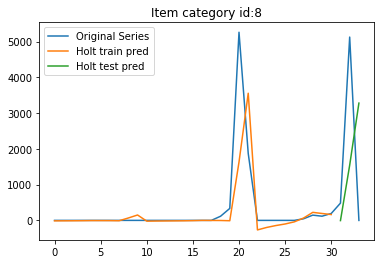

31 8 3998.6150102254155 2819.599581489563


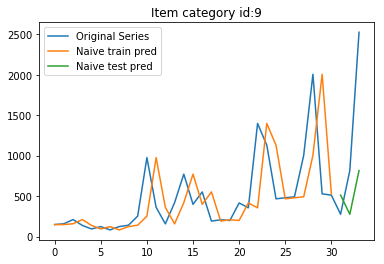

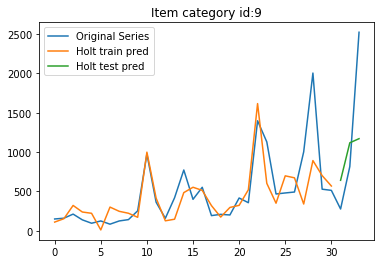

31 9 1043.2374290320172 828.0321293201699


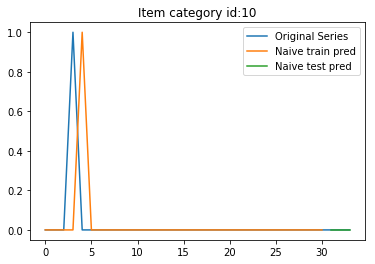

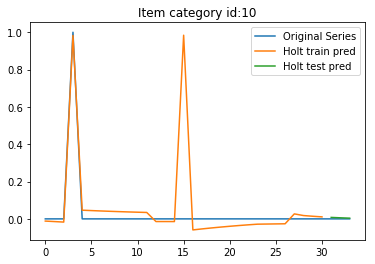

31 10 0.0 0.0060041581048574655


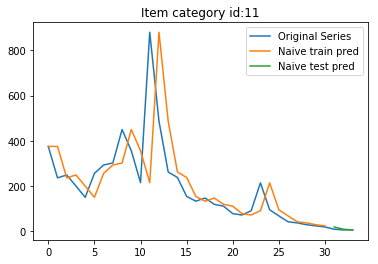

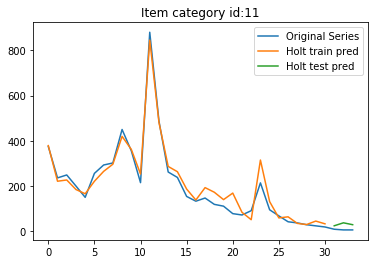

31 11 6.027713773341708 24.17090473213626


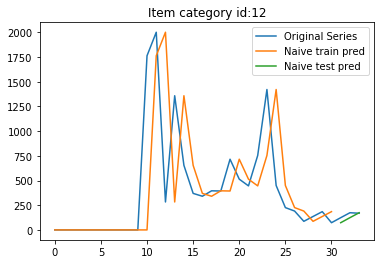

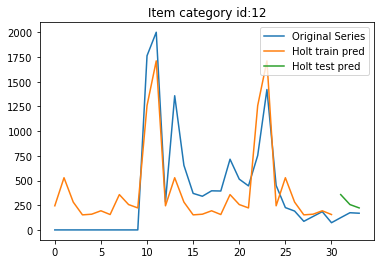

31 12 41.33602141796749 146.48516027193656


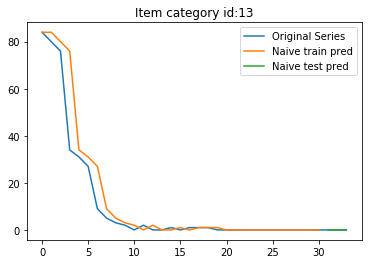

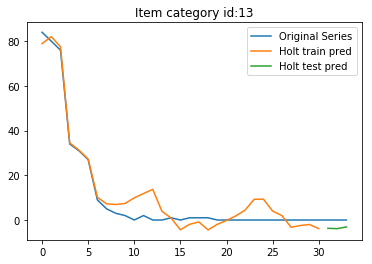

31 13 0.0 3.572063682178317


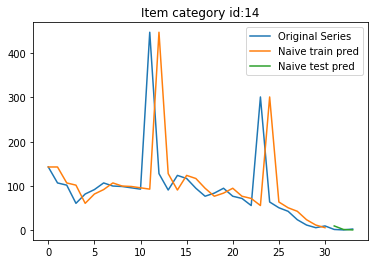

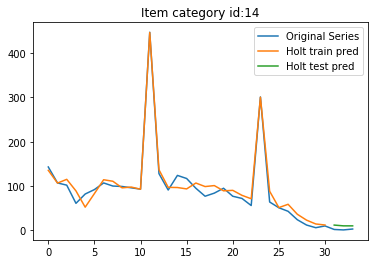

31 14 4.795831523312719 8.81671839923949


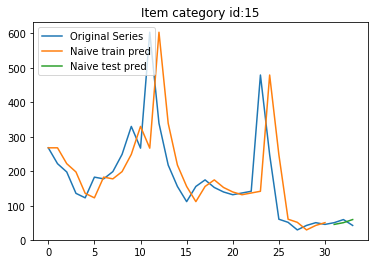

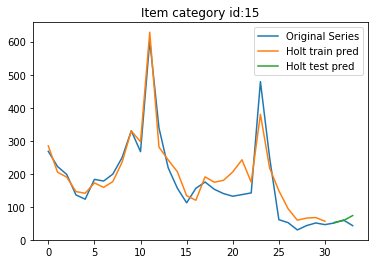

31 15 11.474609652039003 17.602049912765896


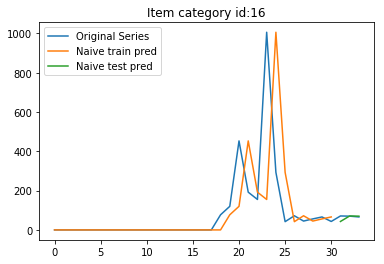

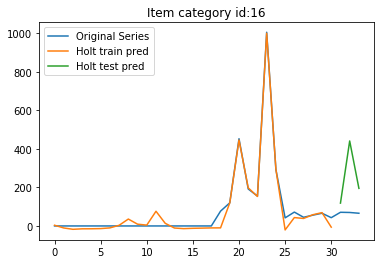

31 16 16.34013463836819 228.66534334856226


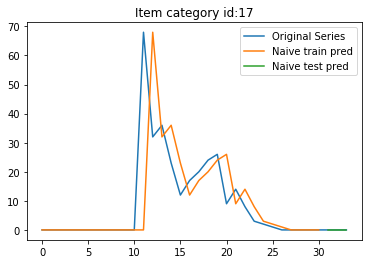

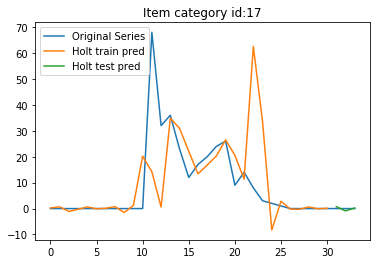

31 17 0.0 0.6838132298016663


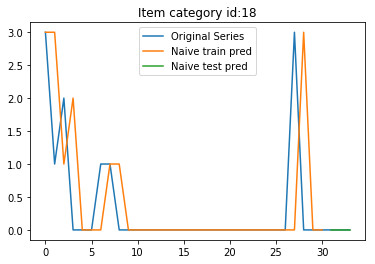

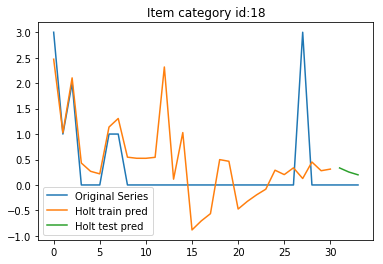

31 18 0.0 0.26847323773664805


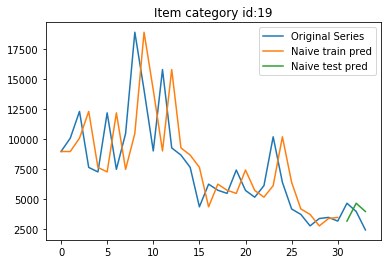

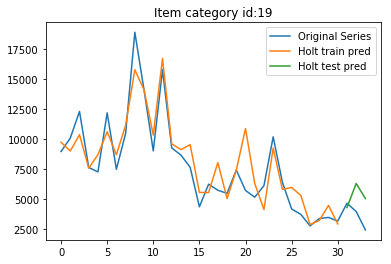

31 19 1297.4026617309935 2035.6167339199546


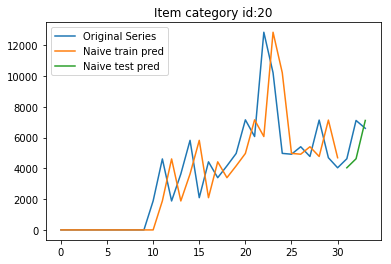

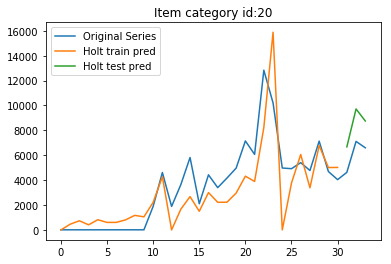

31 20 1504.4030931458053 2284.678605615165


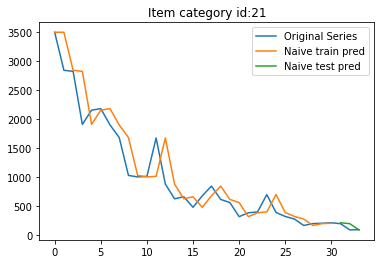

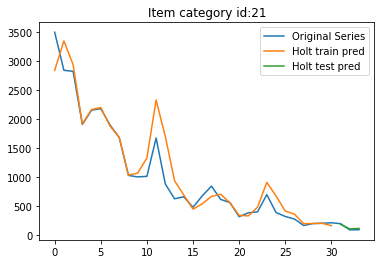

31 21 62.505999712027645 17.402965367336417


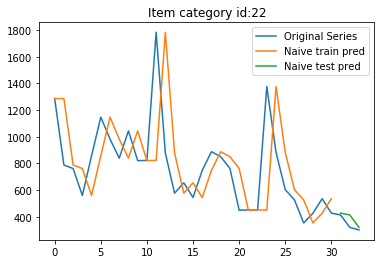

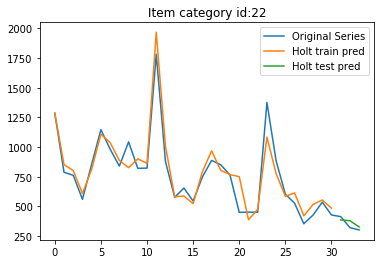

31 22 55.395547354157145 40.24245086535705


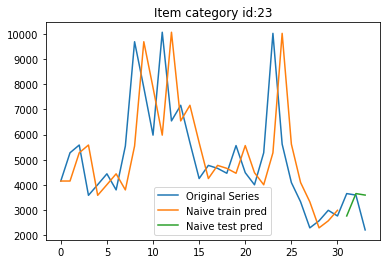

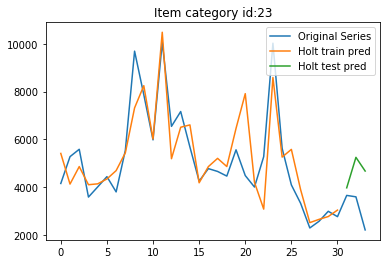

31 23 952.4092257707993 1725.736402942729


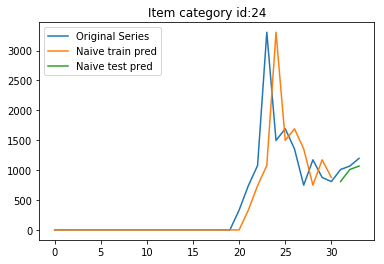

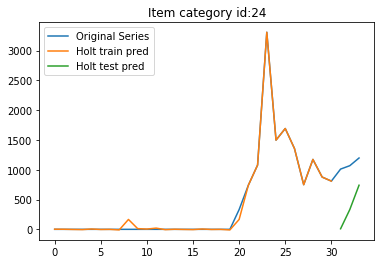

31 24 142.23689160458102 764.4782002368626


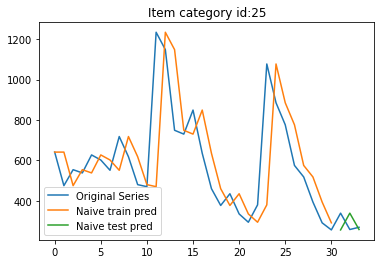

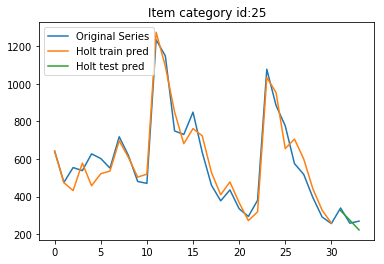

31 25 67.25820891658257 29.663142669633036


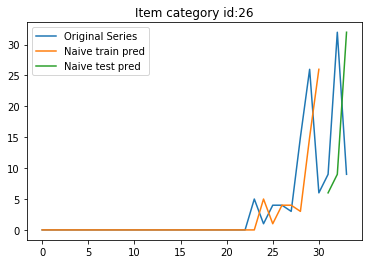

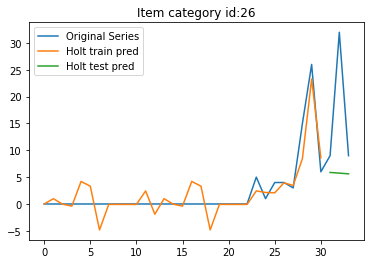

31 26 18.859126879754182 15.387661849833608


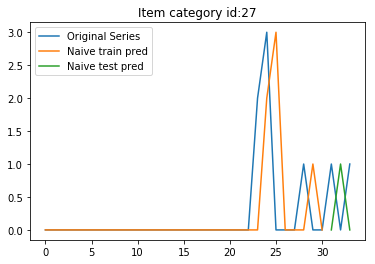

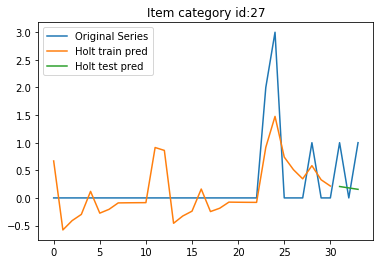

31 27 1.0 0.6770937437701532


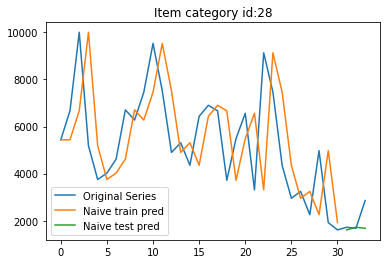

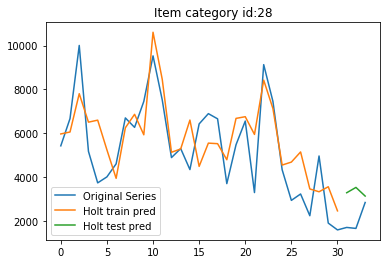

31 28 684.8829583707472 1421.218257530202


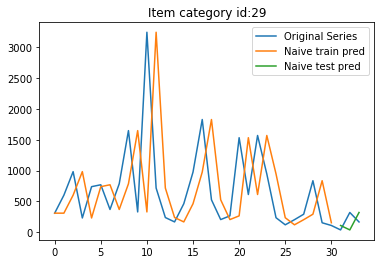

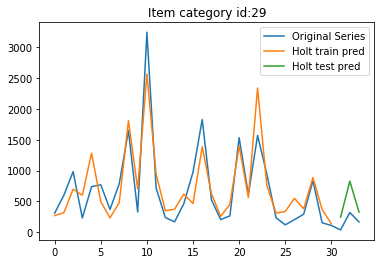

31 29 190.60342774112607 330.3081624419257


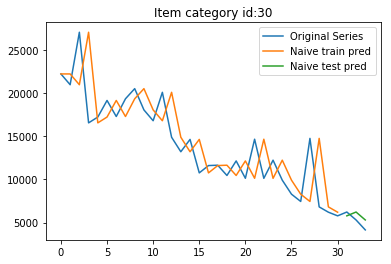

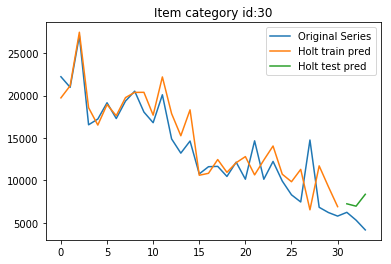

31 30 888.6945481997737 2668.6668124004


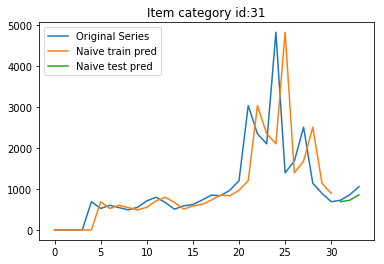

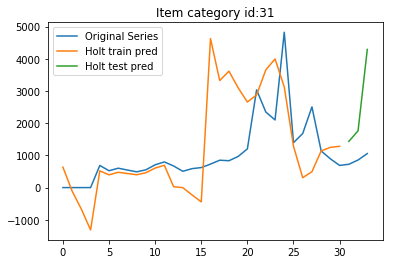

31 31 139.90472948879653 1982.2490784205625


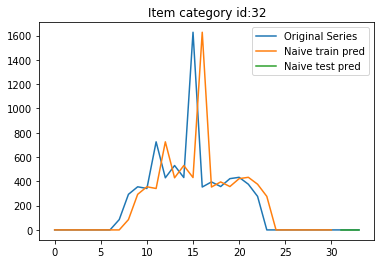

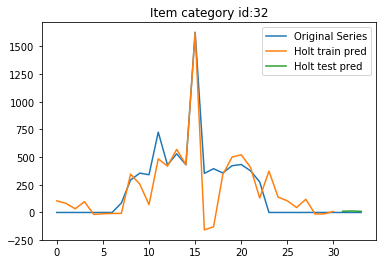

31 32 0.0 11.733462367504623


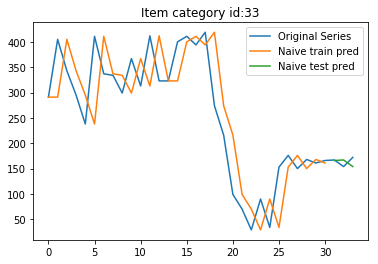

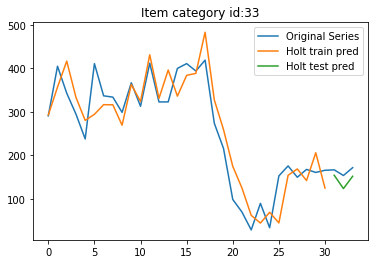

31 33 12.832251036613439 21.96944068794327


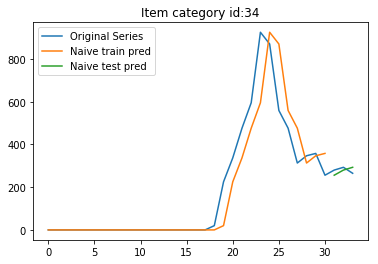

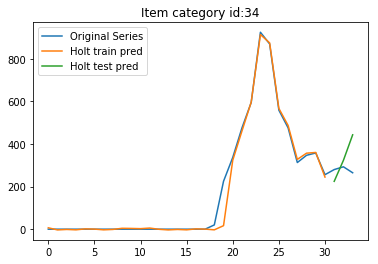

31 34 22.575798250929395 109.15697582757653


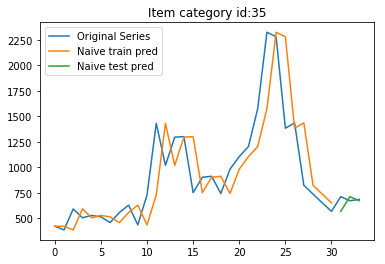

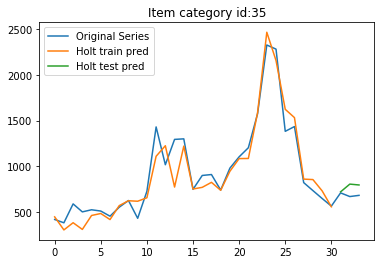

31 35 86.61216234840617 102.2494841226386


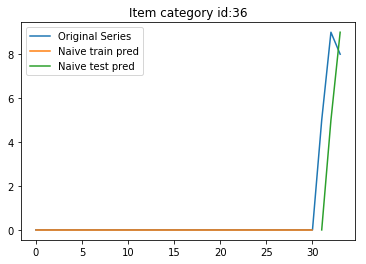

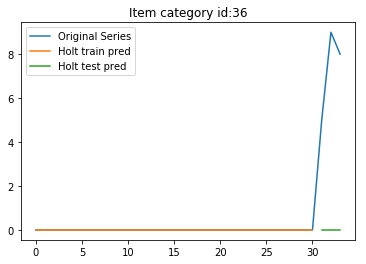

31 36 3.7416573867739413 7.52772652709081


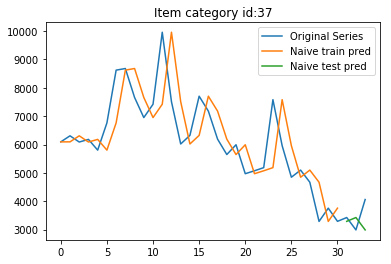

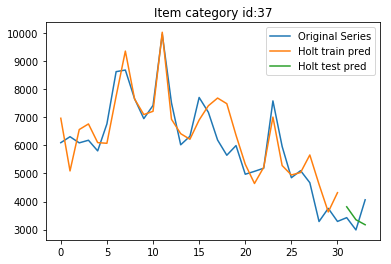

31 37 672.8987046106321 596.7820495613475


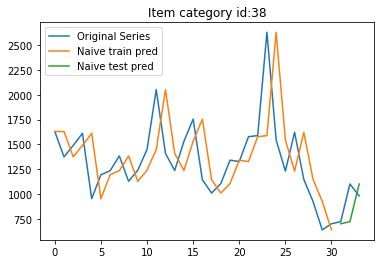

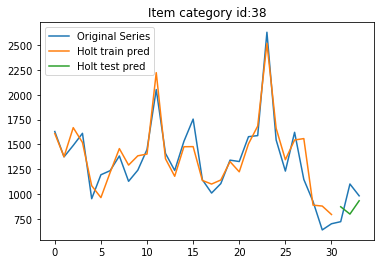

31 38 229.66860183026034 197.10163193747033


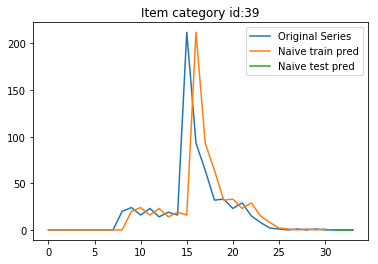

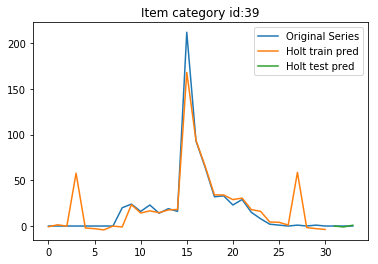

31 39 0.0 0.759967294150944


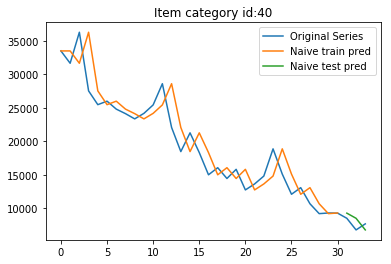

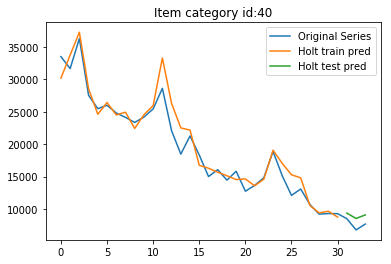

31 40 1212.635834315755 1395.8344501687639


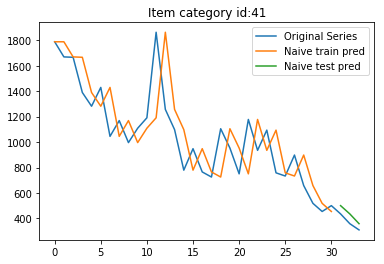

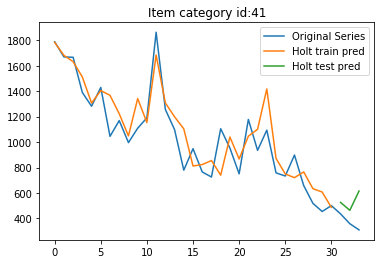

31 41 64.69157595854347 193.8747251086105


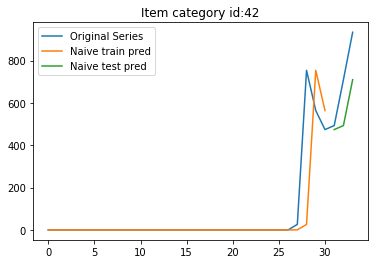

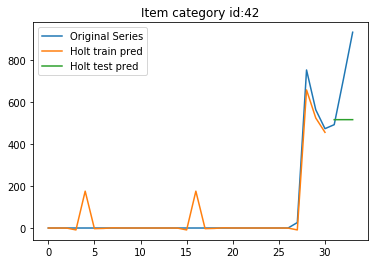

31 42 180.39401320442983 265.6726992788771


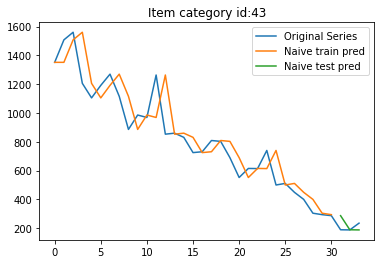

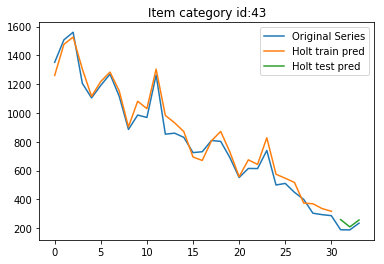

31 43 62.75348595894893 44.51042448236148


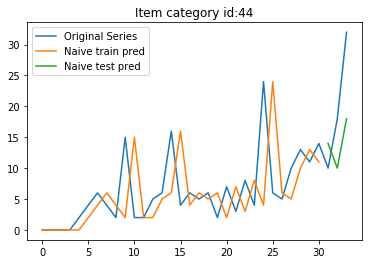

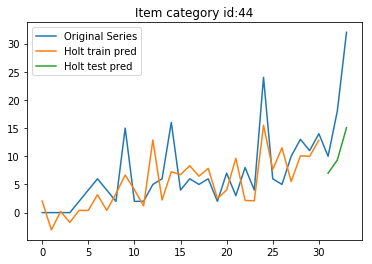

31 44 9.591663046625438 11.12262403457128


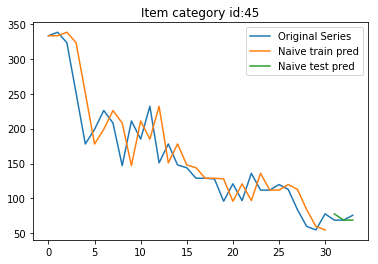

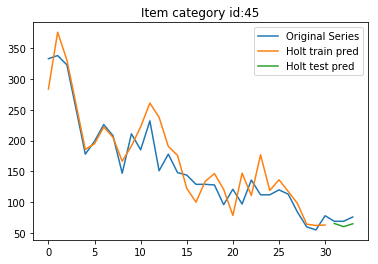

31 45 6.582805886043833 8.377515720631882


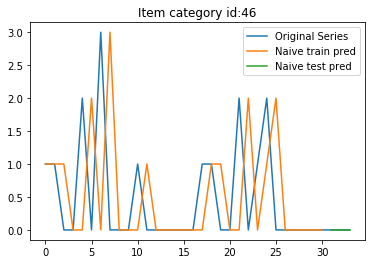

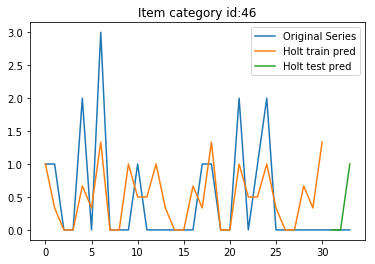

31 46 0.0 0.5773503216411078


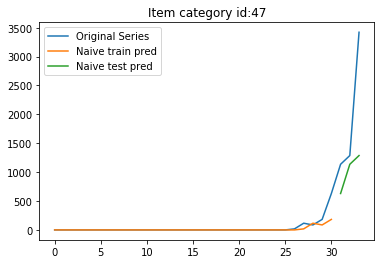

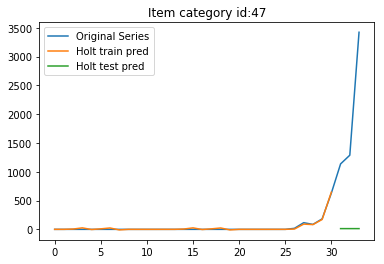

31 47 1269.2245664184097 2198.4270896942908


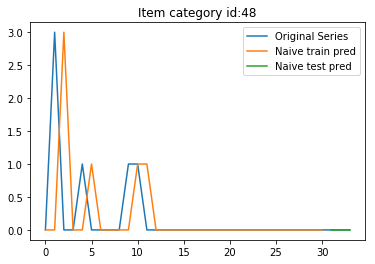

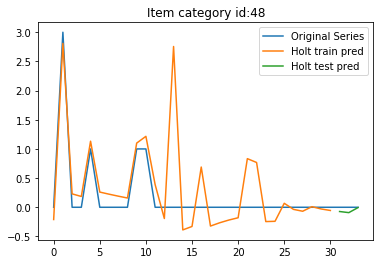

31 48 0.0 0.06771629001045981


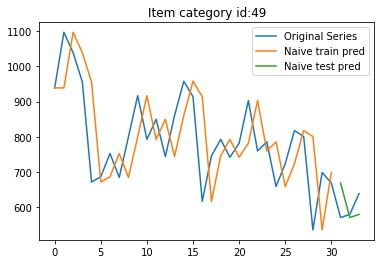

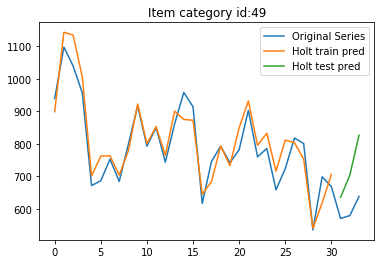

31 49 66.2470125112572 135.0794859648194


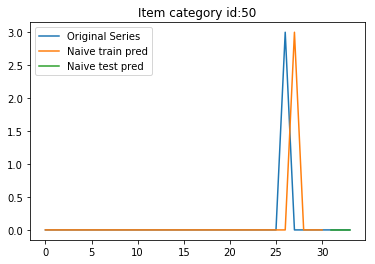

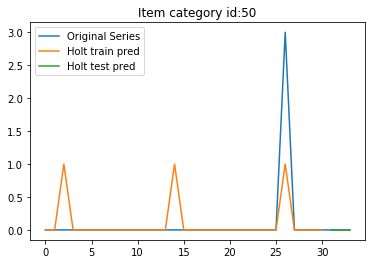

31 50 0.0 5.961029267217168e-08


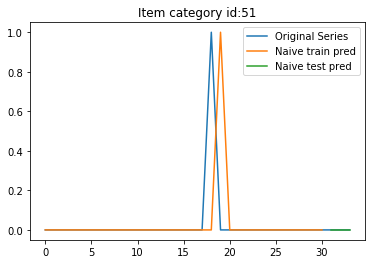

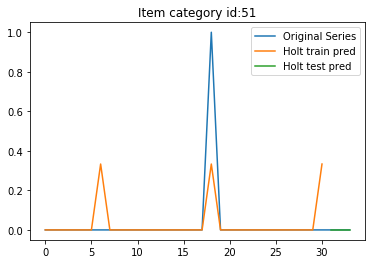

31 51 0.0 1.6924459682663673e-08


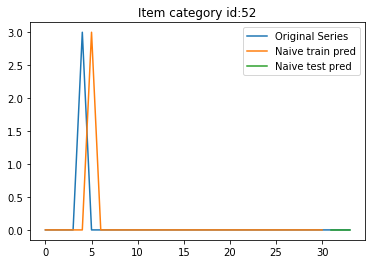

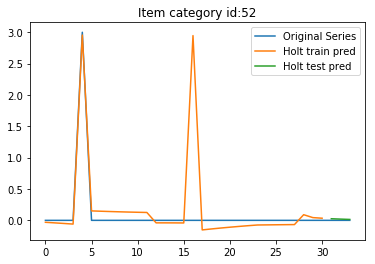

31 52 0.0 0.020452326122900787


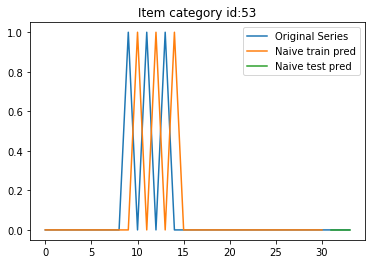

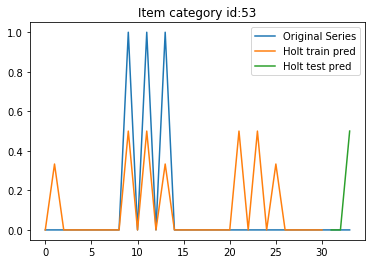

31 53 0.0 0.2886751090525795


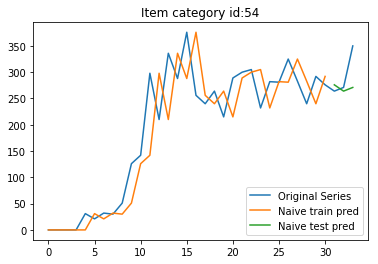

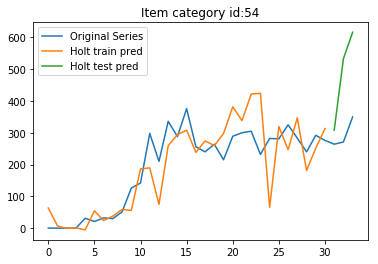

31 54 46.31054595517814 217.25093091931225


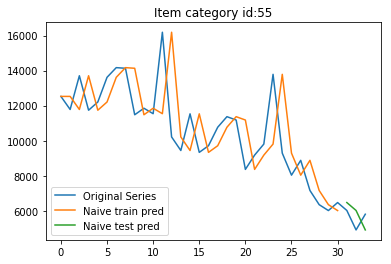

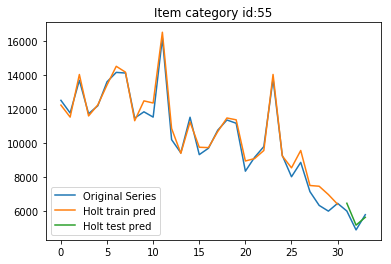

31 55 863.1743740403789 322.8609474759825


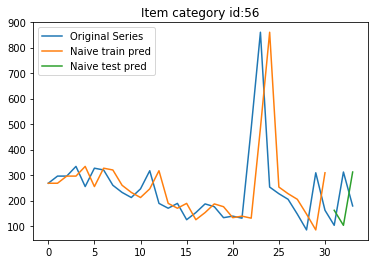

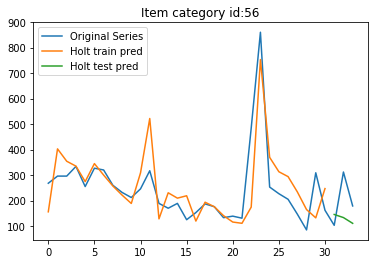

31 56 147.02720836634285 113.06209267333973


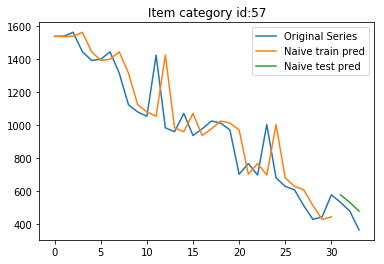

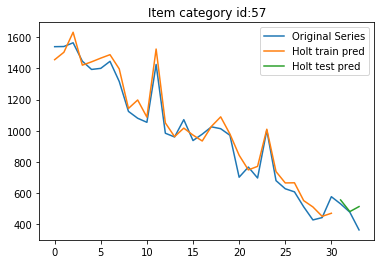

31 57 77.289499071133 87.62777777268526


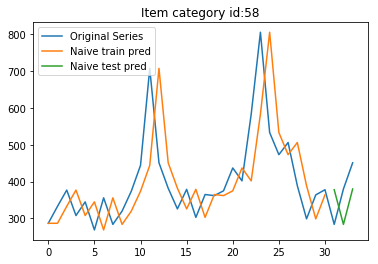

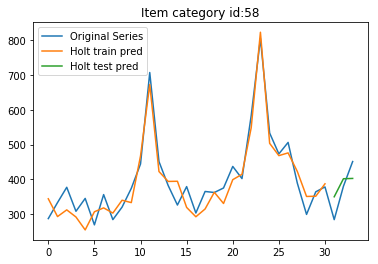

31 58 87.73634746595431 48.781646913172644


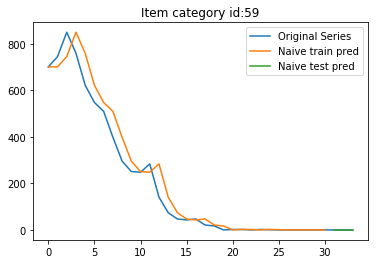

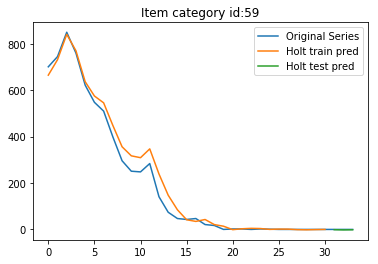

31 59 0.0 1.6609432566721503


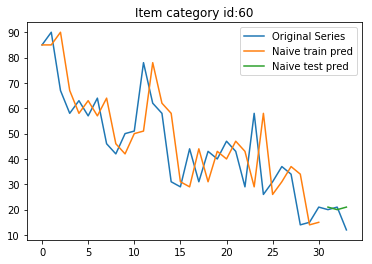

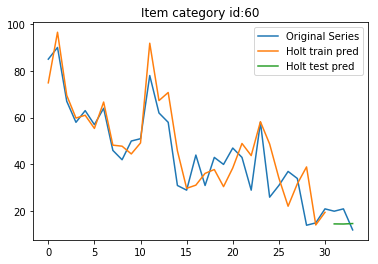

31 60 5.259911279353167 5.1254385600705135


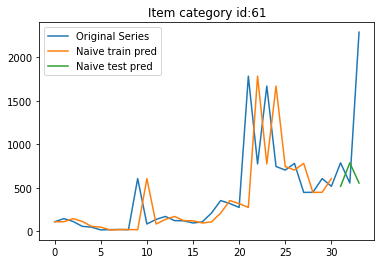

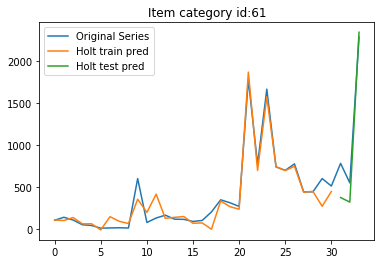

31 61 1023.1357029576608 271.7939289442324


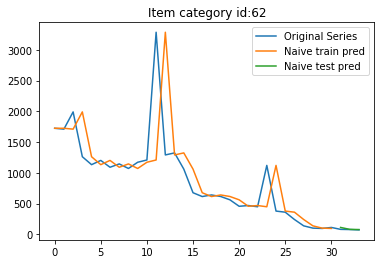

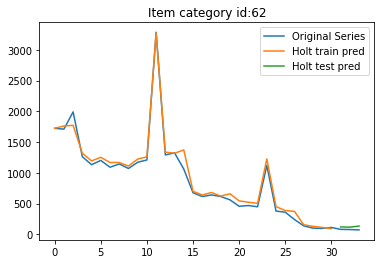

31 62 18.31210892642716 48.29714992957354


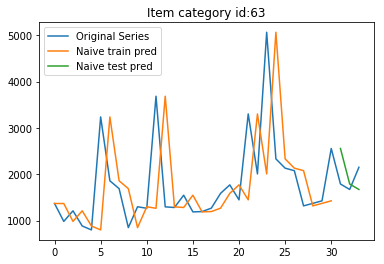

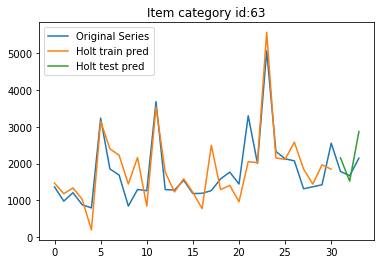

31 63 526.5149570525039 474.70432662006334


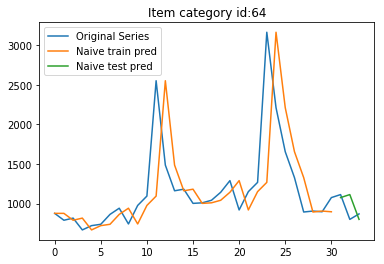

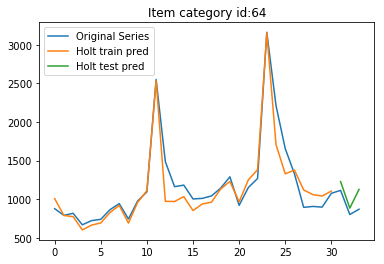

31 64 186.3455571422798 169.07689526717664


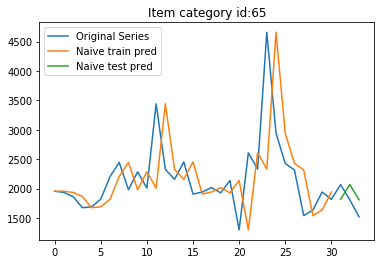

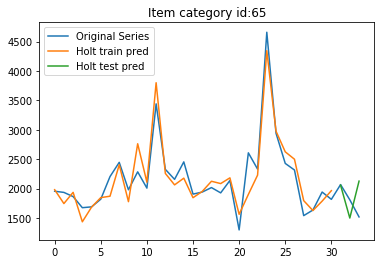

31 65 267.5587162973142 394.4280960795614


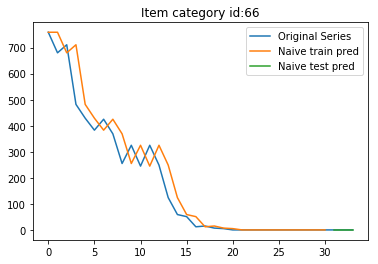

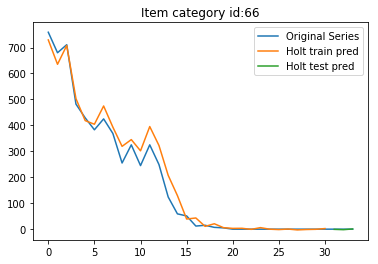

31 66 0.0 1.2841104678234543


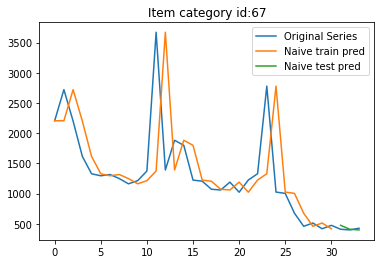

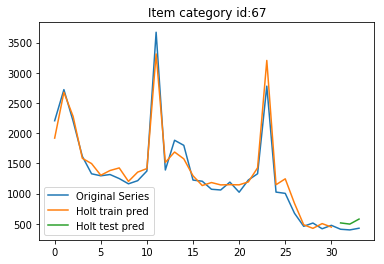

31 67 41.352146256270665 120.0441387242596


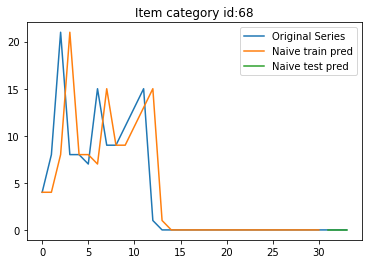

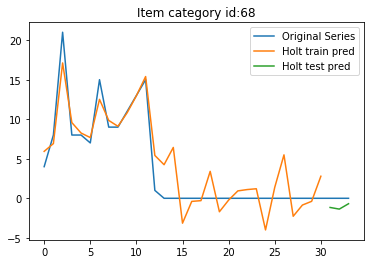

31 68 0.0 1.1085691174946195


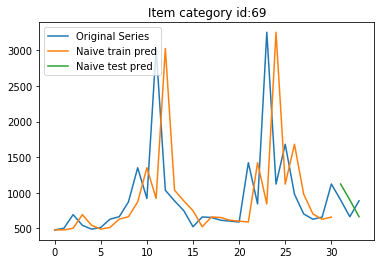

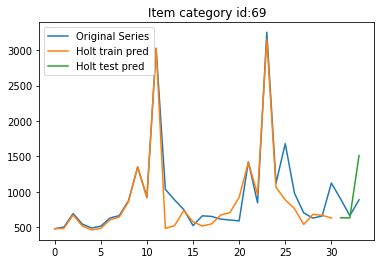

31 69 227.41591852814526 392.2706364635948


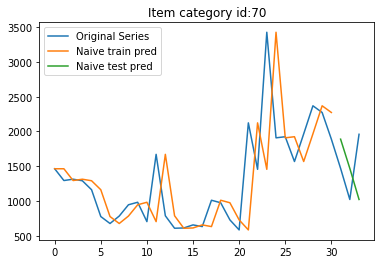

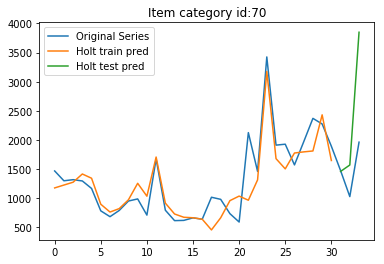

31 70 645.8756330233657 1135.1751465462157


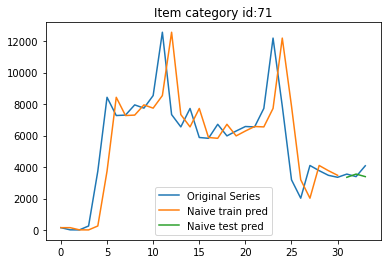

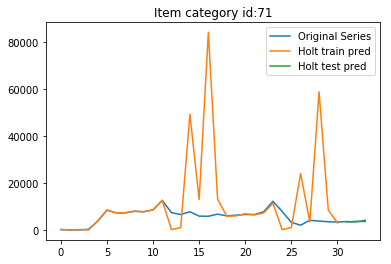

31 71 424.61001715299494 353.00754644011636


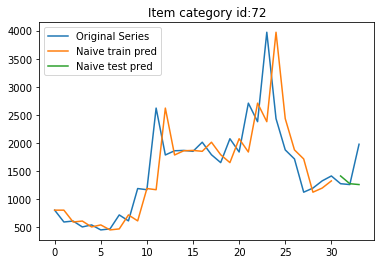

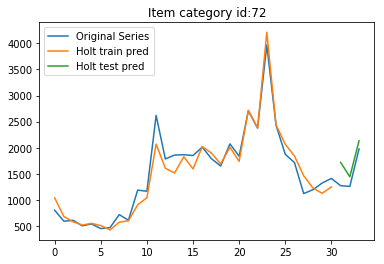

31 72 422.21361102329865 293.71161282023826


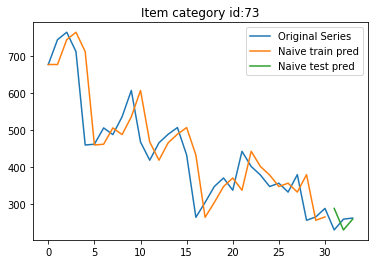

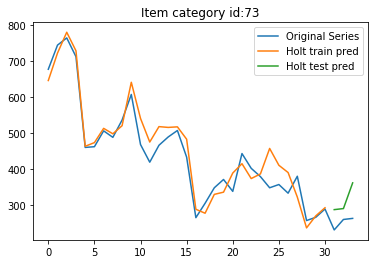

31 73 37.47888294315436 67.84788060452357


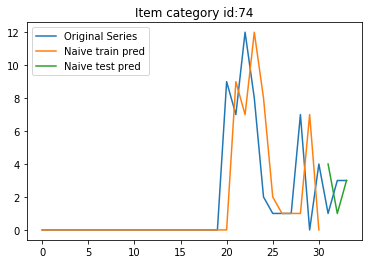

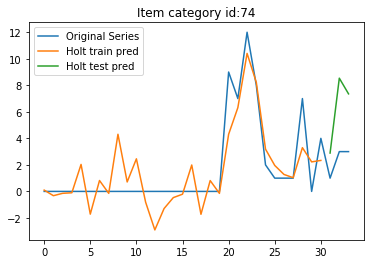

31 74 2.0816659994661326 4.211332112735956


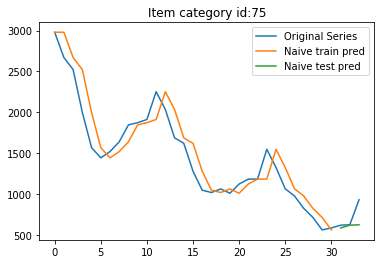

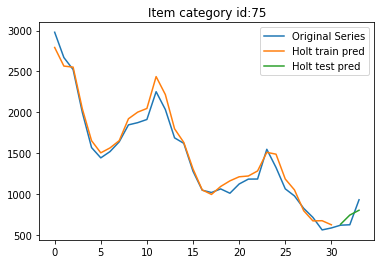

31 75 177.7798263770855 101.10868414168675


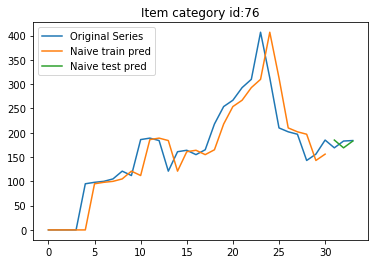

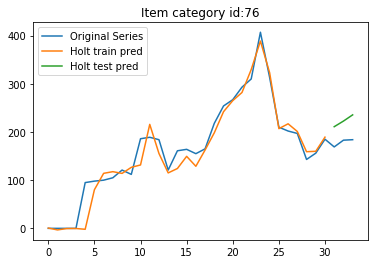

31 76 12.288205727444508 44.68014099036503


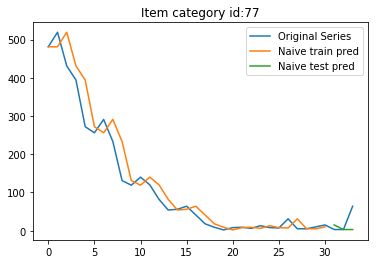

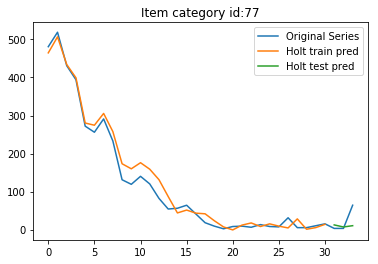

31 77 35.89336057453151 31.60563328292619


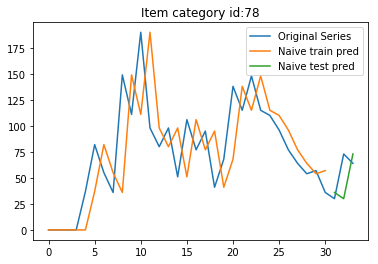

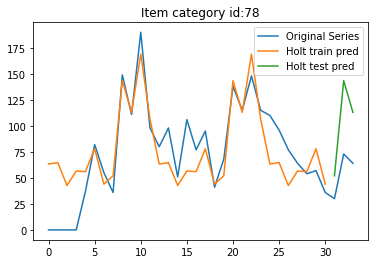

31 78 25.599479161368368 51.16819361958577


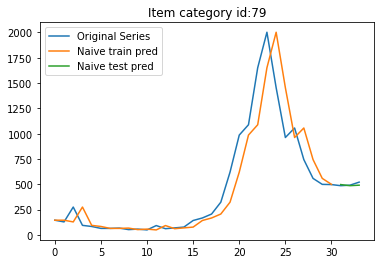

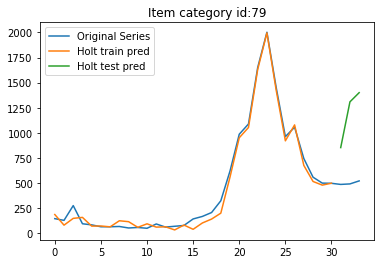

31 79 18.672618098881223 724.7329340778793


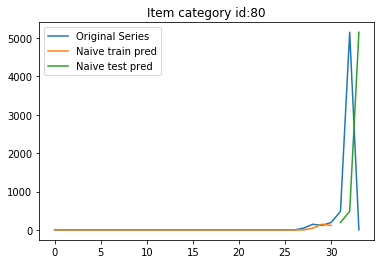

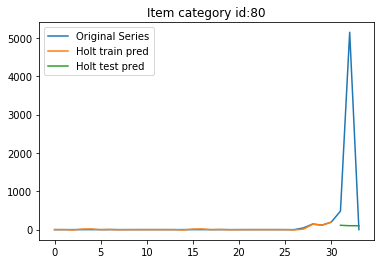

31 80 4015.250137496625 2922.4536078551964


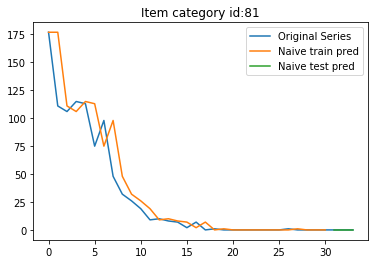

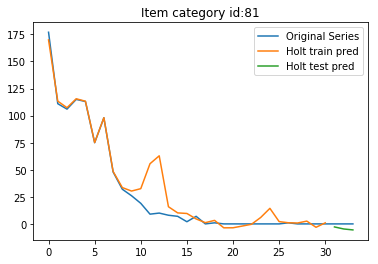

31 81 0.0 4.492658012631706


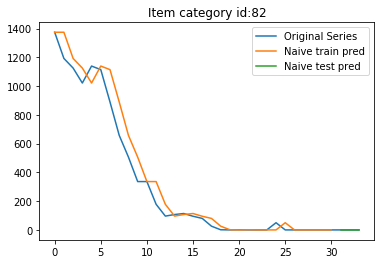

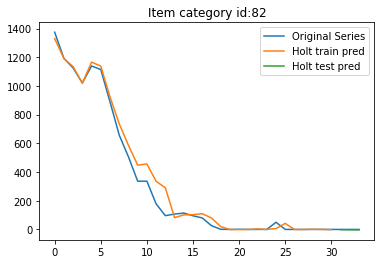

31 82 0.0 2.6624481490520115


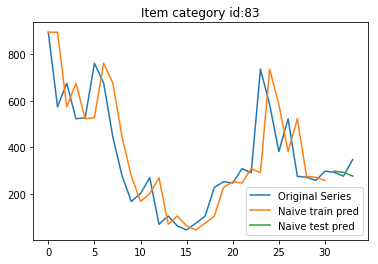

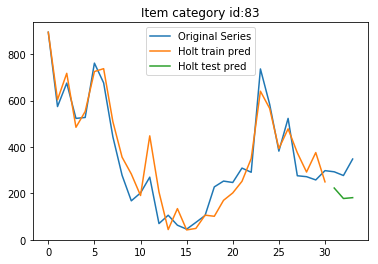

31 83 42.118879377305376 118.81626065264278


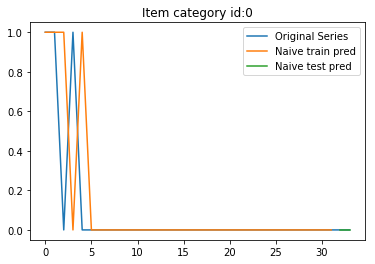

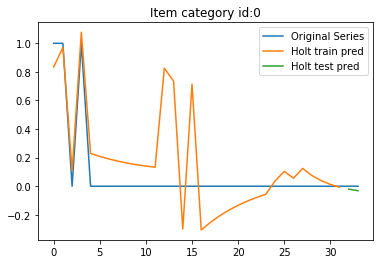

32 0 0.0 0.02654913522389809


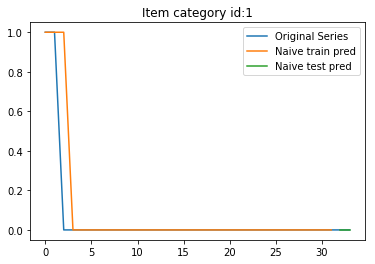

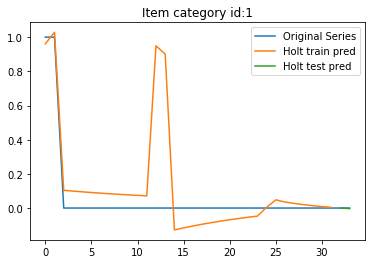

32 1 0.0 0.0021841956358044632


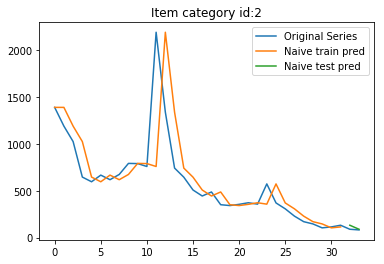

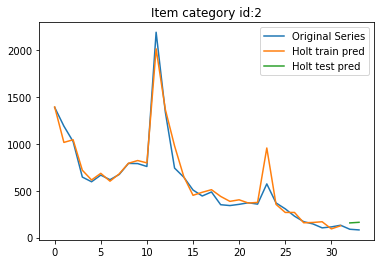

32 2 30.805843601498726 74.75824766544477


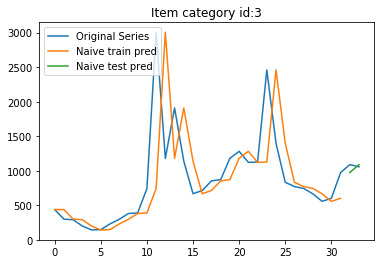

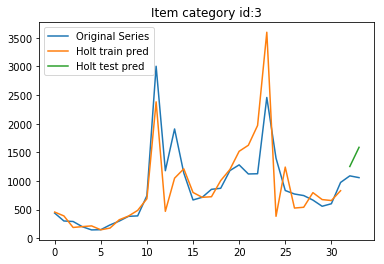

32 3 84.21995013059554 391.73724397999433


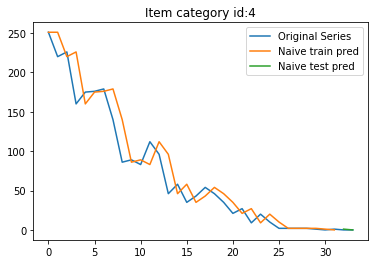

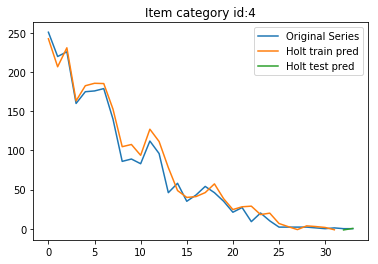

32 4 0.7071067811865476 1.140875324212332


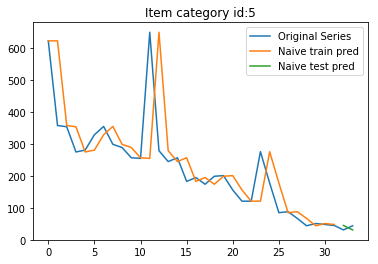

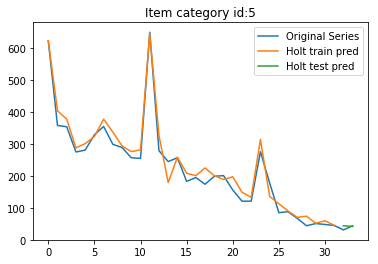

32 5 13.509256086106296 9.380354228269663


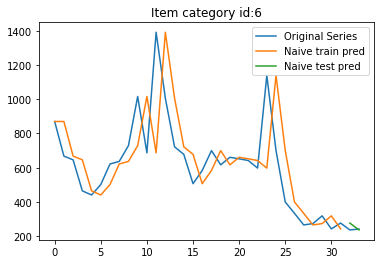

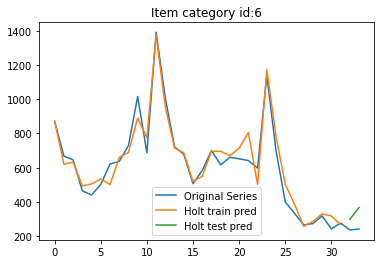

32 6 28.50438562747845 99.03074929032195


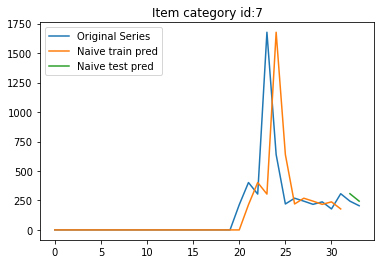

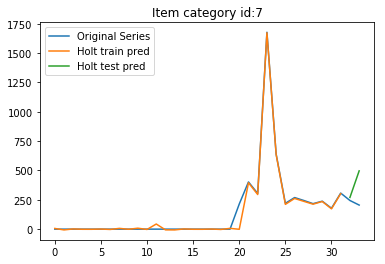

32 7 52.392747589718944 206.733942729061


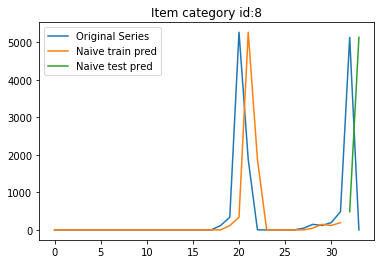

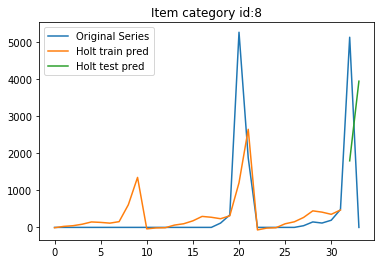

32 8 4892.988146317136 3651.1317239224345


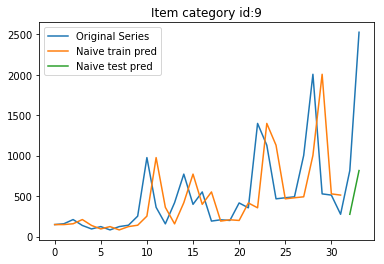

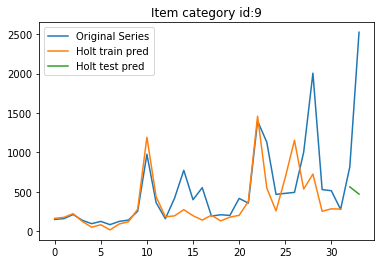

32 9 1266.6617543764396 1463.2817700986066


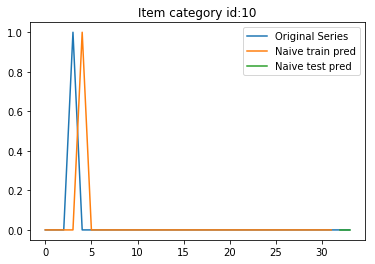

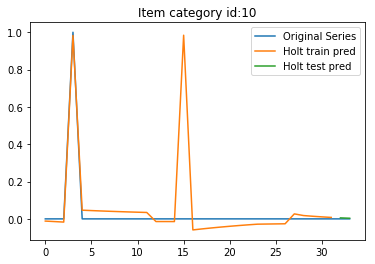

32 10 0.0 0.004455438859169663


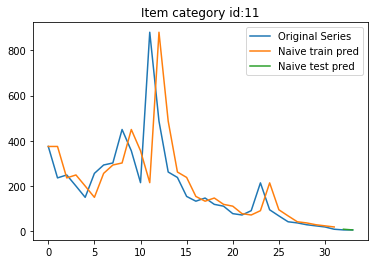

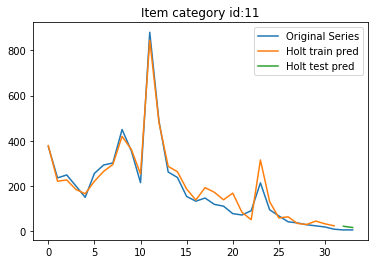

32 11 2.1213203435596424 13.70274564235553


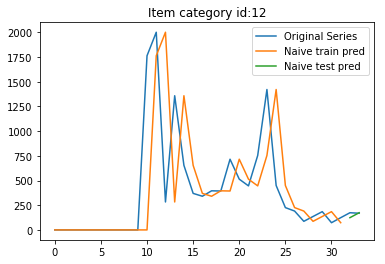

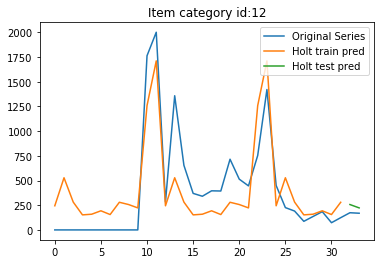

32 12 35.531676008879735 70.0147840178174


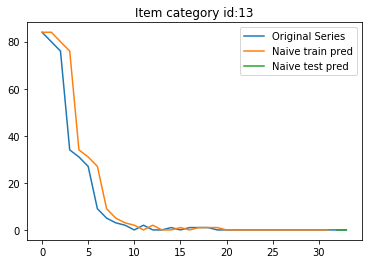

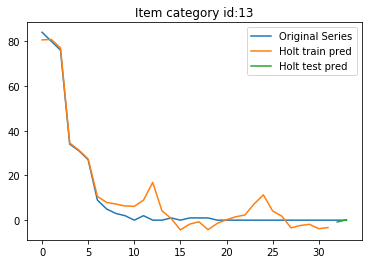

32 13 0.0 0.6070291767966517


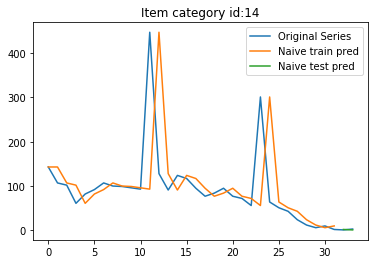

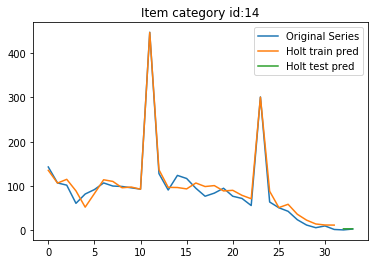

32 14 1.5811388300841898 1.758365432393597


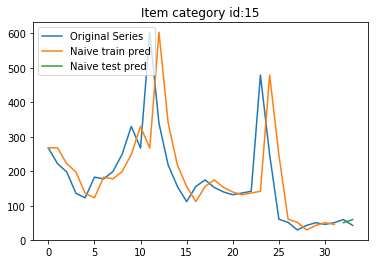

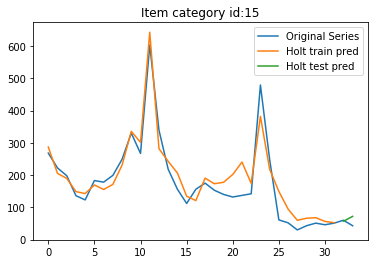

32 15 13.601470508735444 20.567992294431296


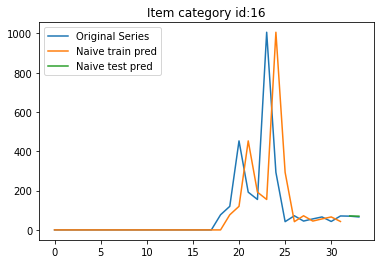

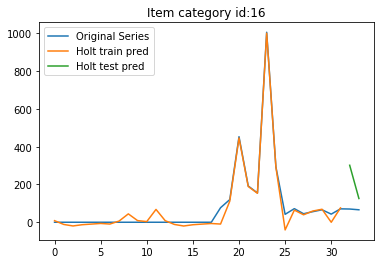

32 16 2.9154759474226504 169.23491627537632


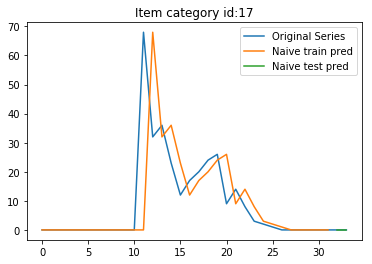

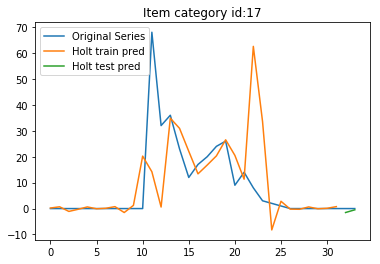

32 17 0.0 1.1316660230591413


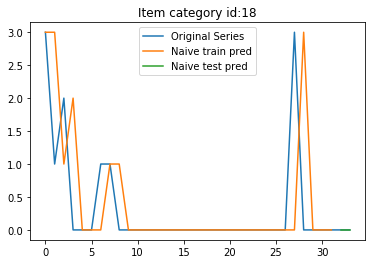

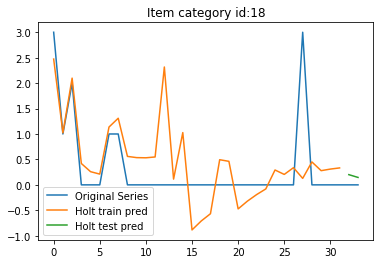

32 18 0.0 0.1755022207271105


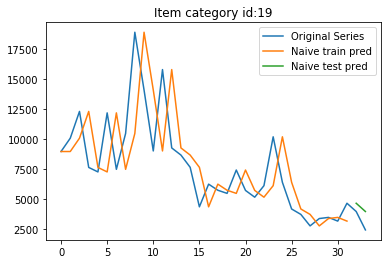

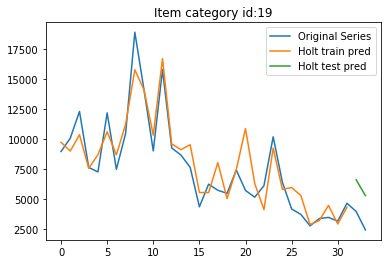

32 19 1190.0924333849032 2754.3457421136986


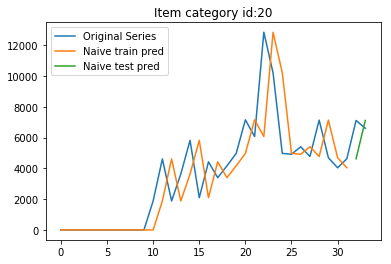

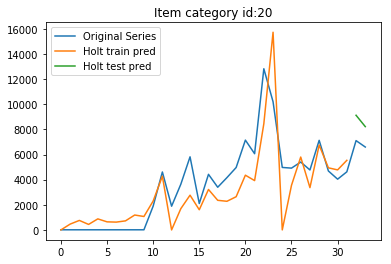

32 20 1795.3119506091414 1834.00006934496


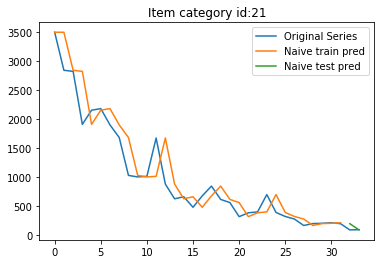

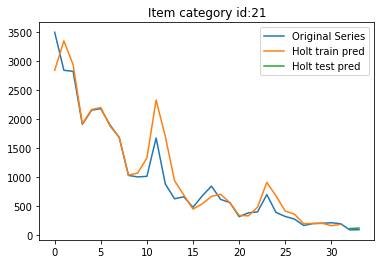

32 21 75.71327492586752 25.93469755130746


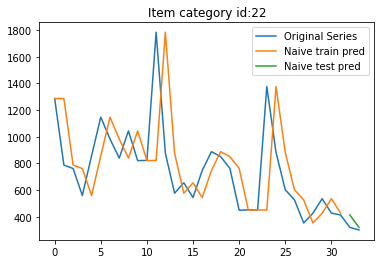

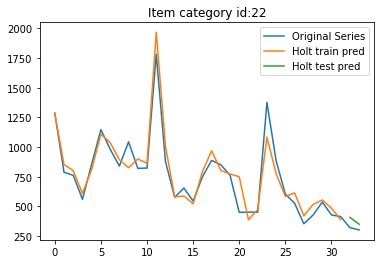

32 22 67.11929677819934 69.74916797563328


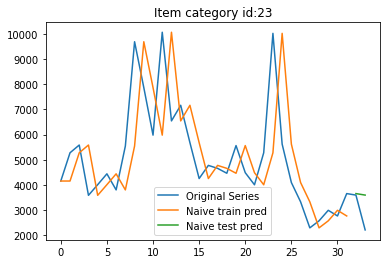

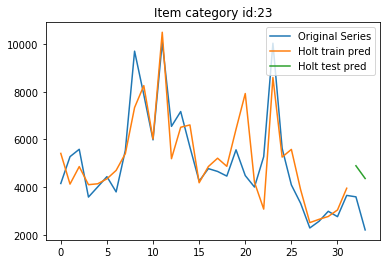

32 23 981.6743350011755 1780.888133588424


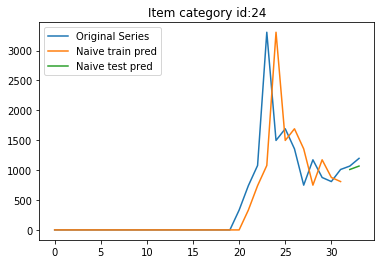

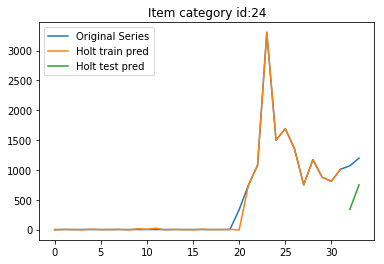

32 24 99.72462083156798 606.5816107936158


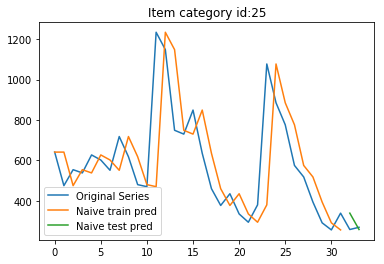

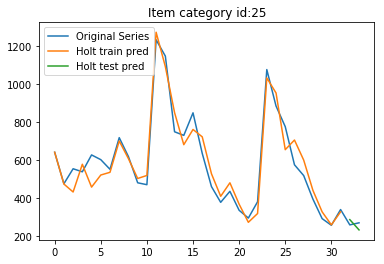

32 25 57.8013840664737 32.99804647583202


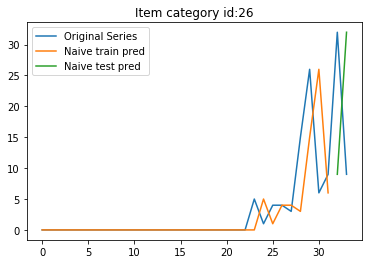

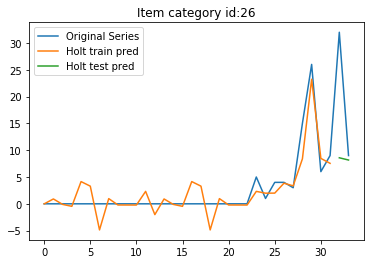

32 26 23.0 16.568633718705495


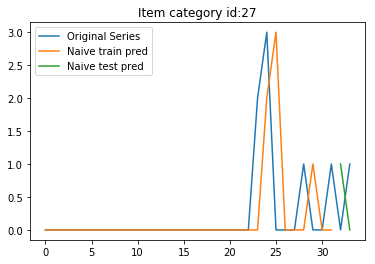

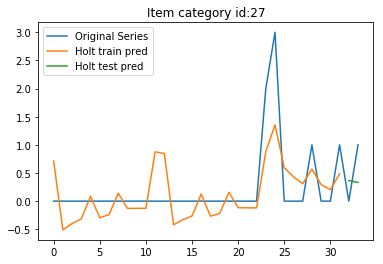

32 27 1.0 0.5374835300421175


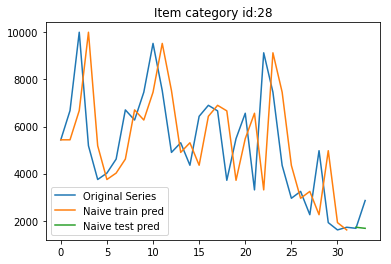

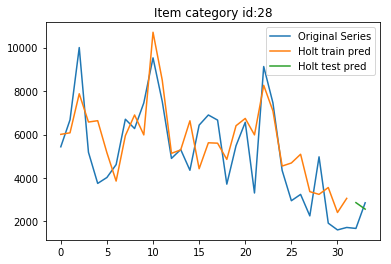

32 28 834.9925149365113 864.4142688312596


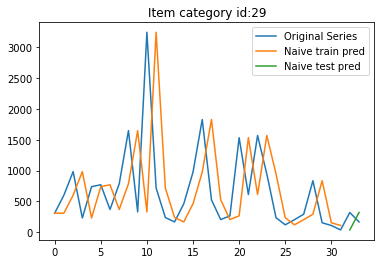

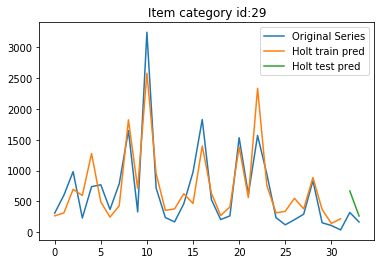

32 29 227.821201822833 256.4842310292802


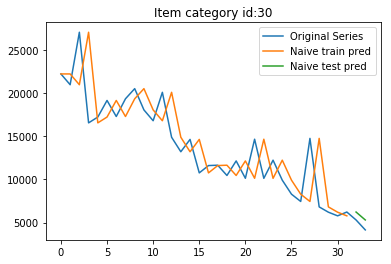

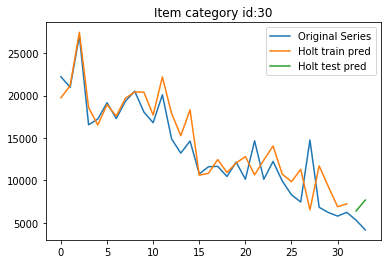

32 30 1042.5857278900378 2605.5903167989813


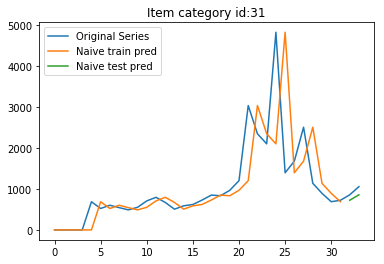

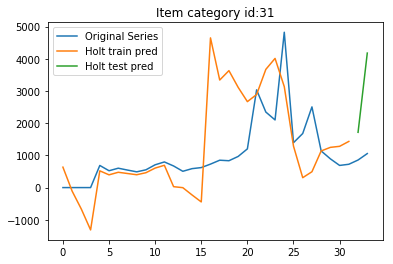

32 31 169.44615663980107 2289.2861716368725


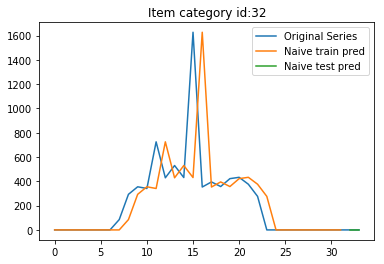

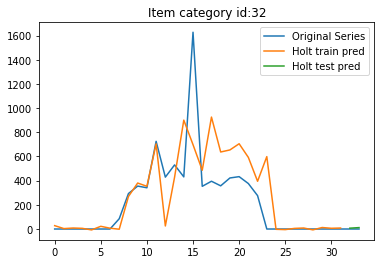

32 32 0.0 9.594804013940955


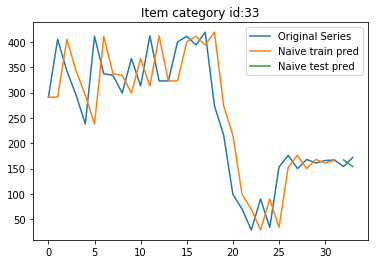

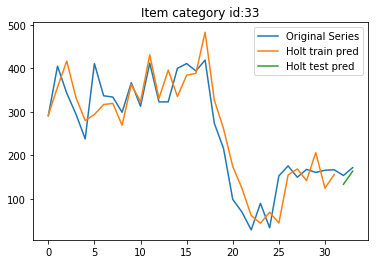

32 33 15.700318468107582 15.504243925024749


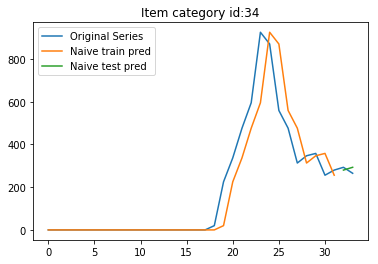

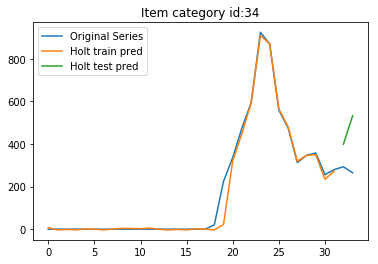

32 34 21.828879952943073 203.74282906733958


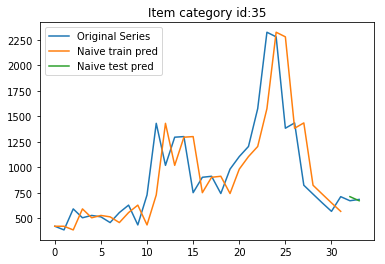

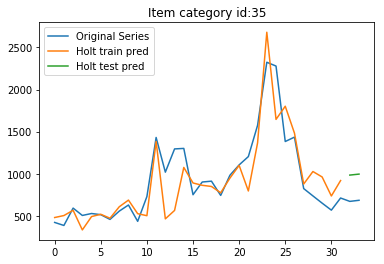

32 35 29.740544715926102 311.5221136498146


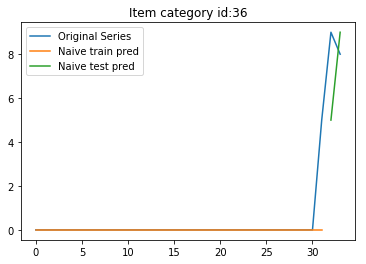

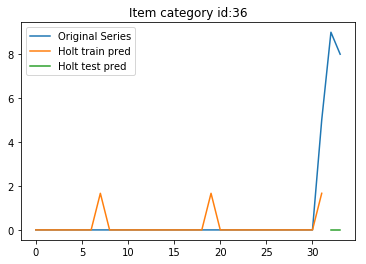

32 36 2.9154759474226504 8.51469341114379


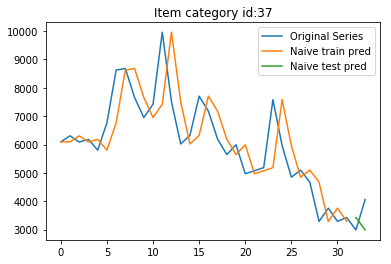

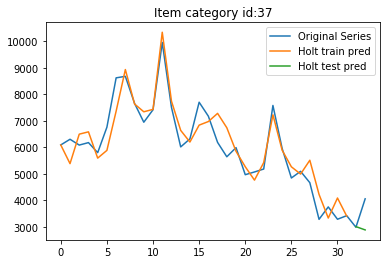

32 37 818.5820056658954 829.0443449972091


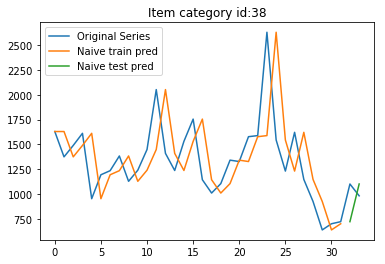

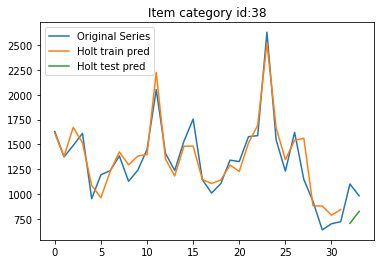

32 38 280.8932181452589 300.96308096663205


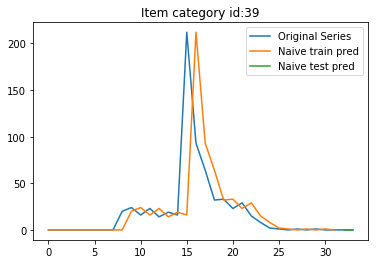

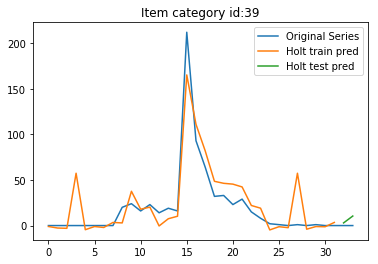

32 39 0.0 7.666337523636041


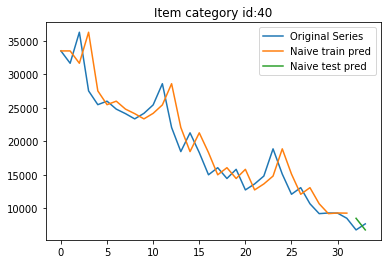

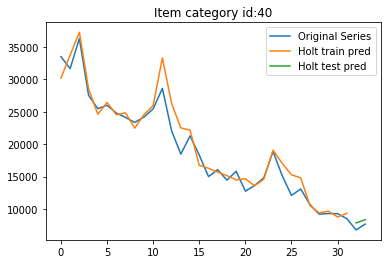

32 40 1381.7664419141174 898.4298769730543


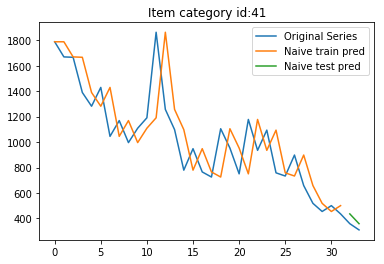

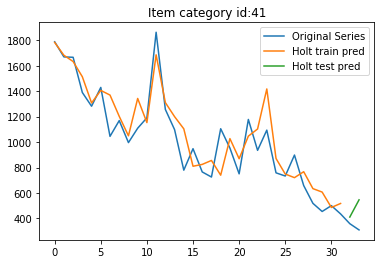

32 41 64.53681120105021 171.2850242640464


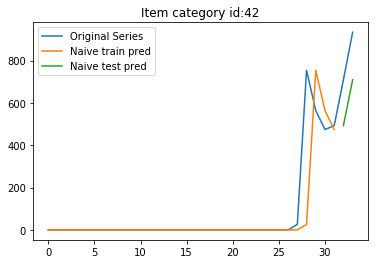

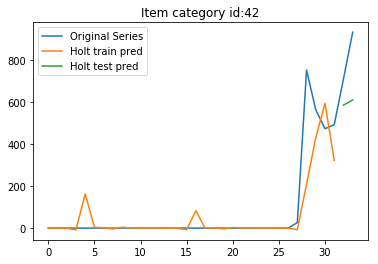

32 42 220.5277760283271 244.70496228427544


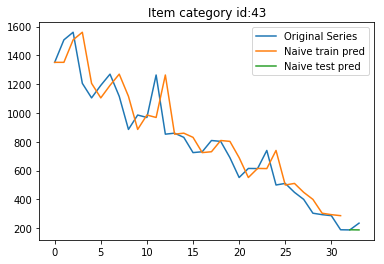

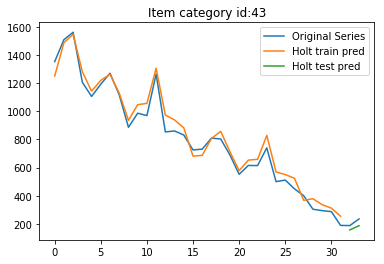

32 43 33.24154027718932 40.341509827520284


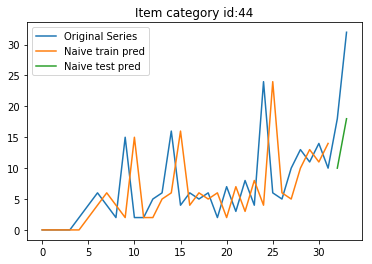

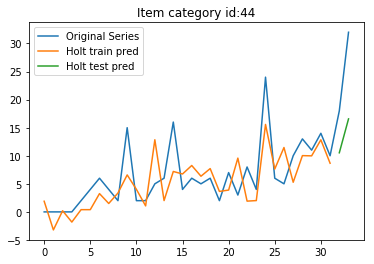

32 44 11.40175425099138 12.125337833194575


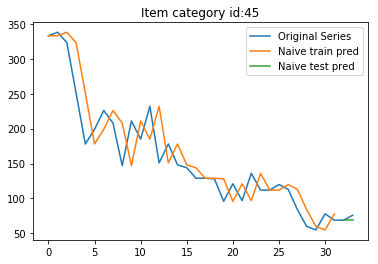

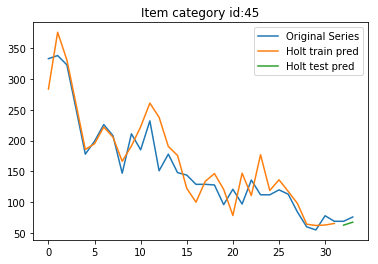

32 45 4.949747468305833 7.429807947860746


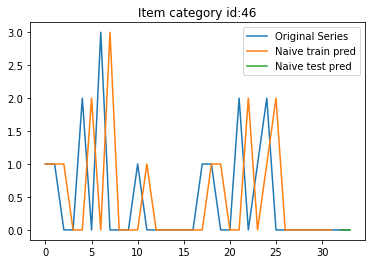

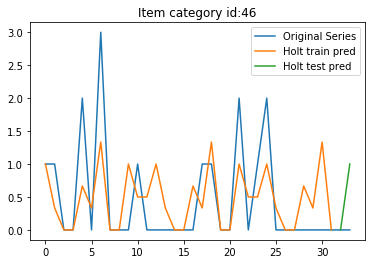

32 46 0.0 0.7071067983618117


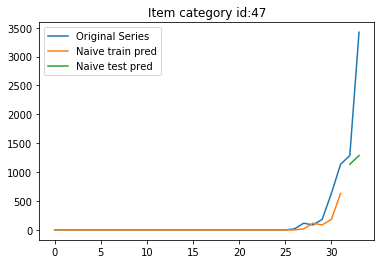

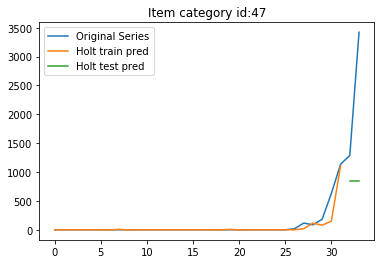

32 47 1512.7387414884304 1842.285003291645


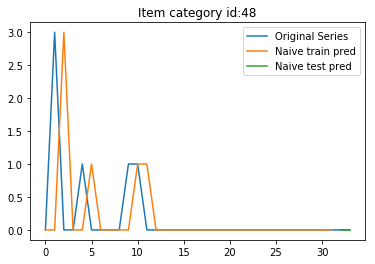

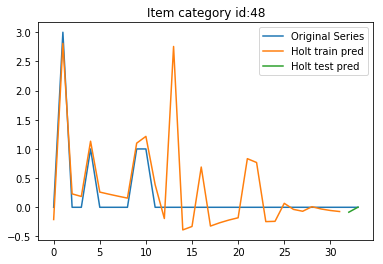

32 48 0.0 0.05956902261658768


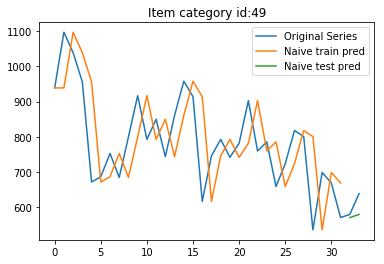

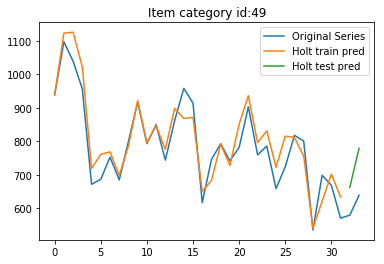

32 49 42.20189569201838 115.24537896285145


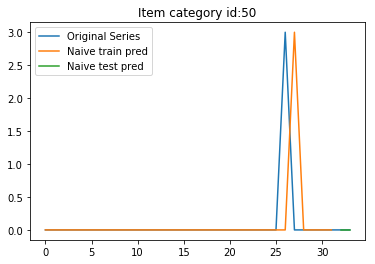

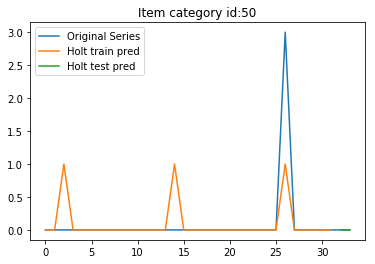

32 50 0.0 1.5285115964907925e-07


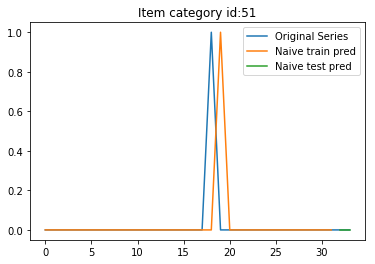

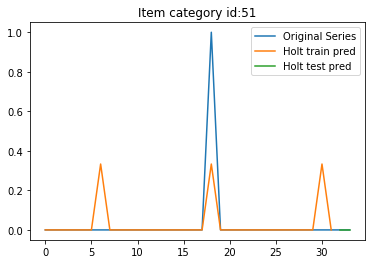

32 51 0.0 1.519892916724965e-08


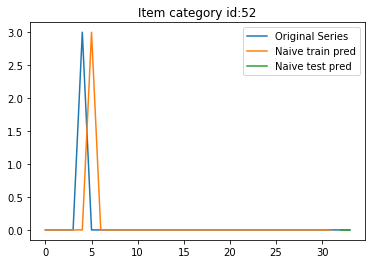

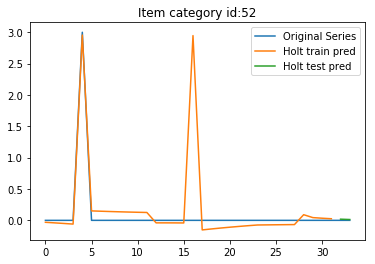

32 52 0.0 0.0160067016187356


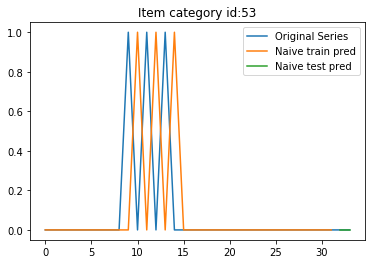

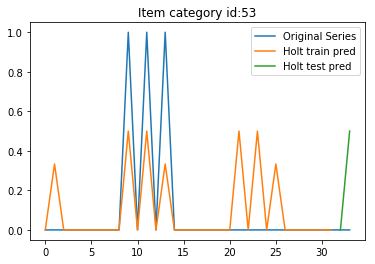

32 53 0.0 0.3535533624695778


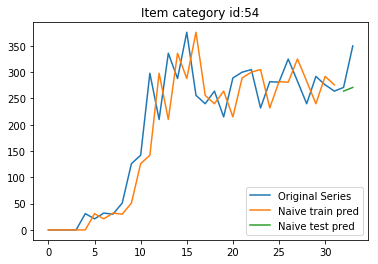

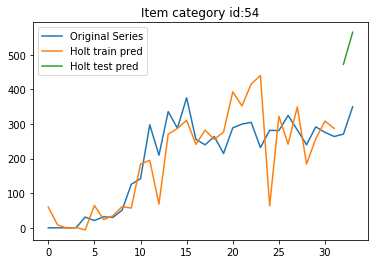

32 54 56.08029957123981 208.7823149525304


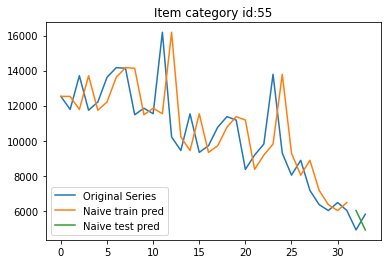

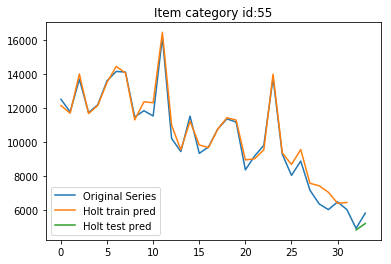

32 55 1007.6968790266247 436.8395631204244


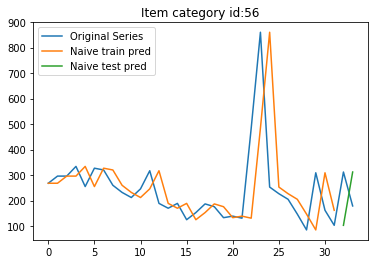

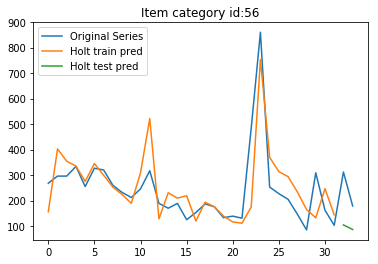

32 56 175.17134468856486 160.57660254776795


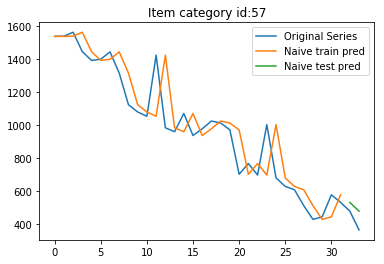

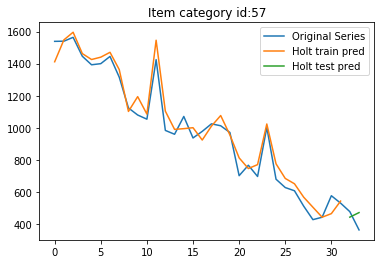

32 57 88.89600665946699 80.11519752138543


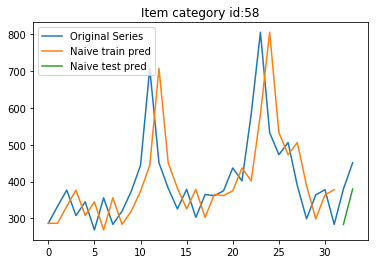

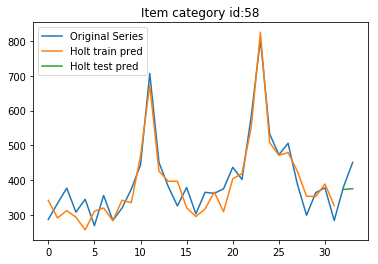

32 58 84.43044474595642 53.77275830287221


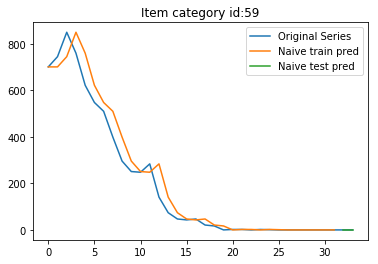

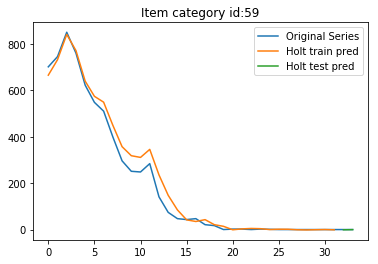

32 59 0.0 0.7730442218010015


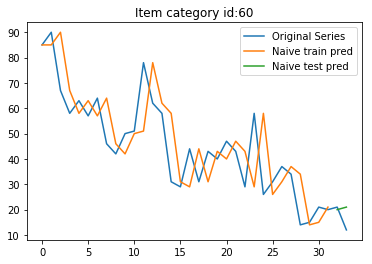

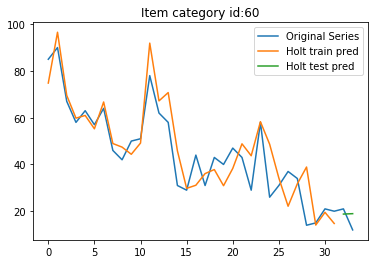

32 60 6.4031242374328485 5.160534847932774


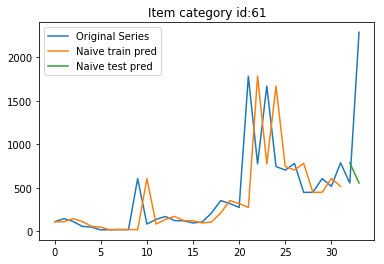

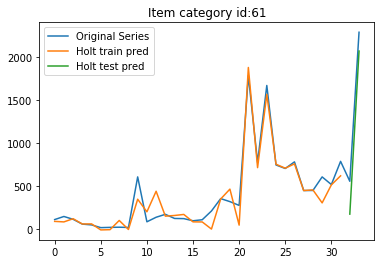

32 61 1238.450644959257 311.72803160908205


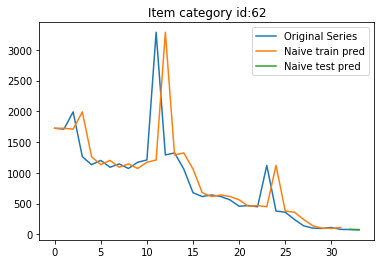

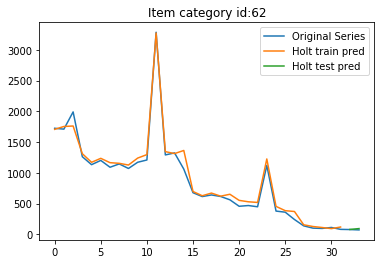

32 62 4.743416490252569 15.3843195306877


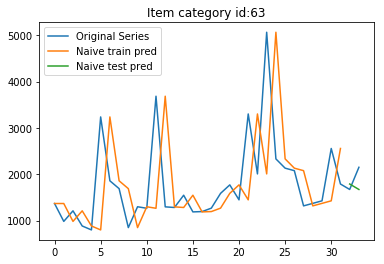

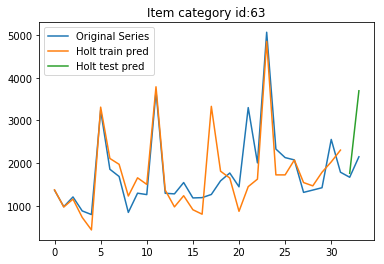

32 63 348.83018791383296 1094.4379601750136


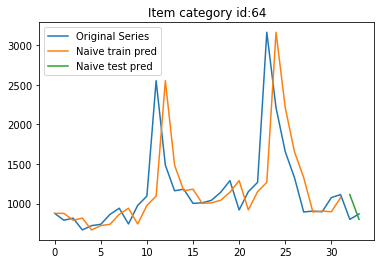

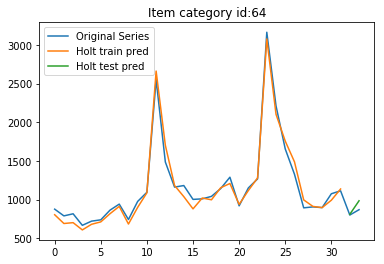

32 64 226.63847863944022 81.72222891732767


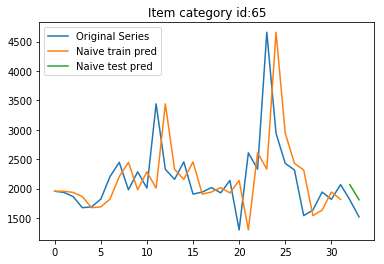

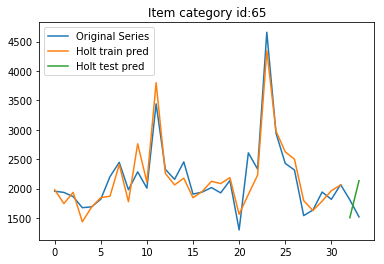

32 65 275.4650613054222 486.35700301043784


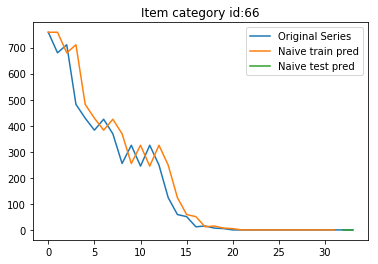

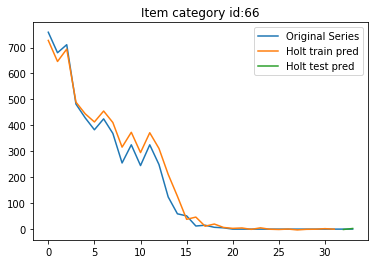

32 66 0.0 1.9913987014390253


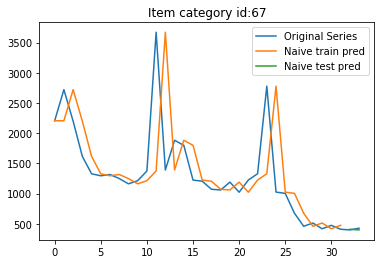

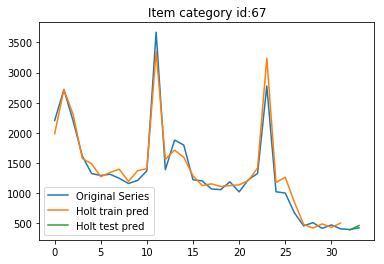

32 67 21.27204738618265 27.791763109252503


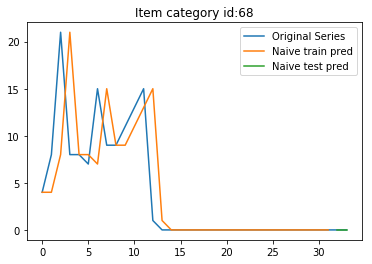

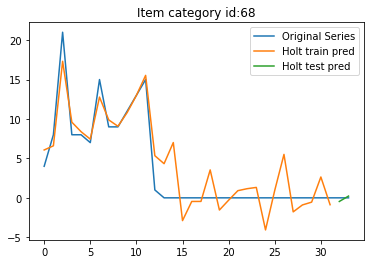

32 68 0.0 0.3611699750928382


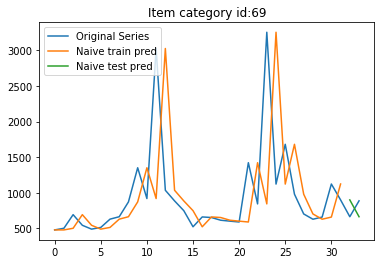

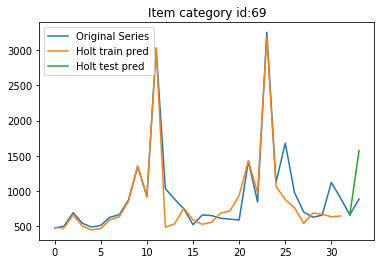

32 69 229.59202947837716 486.33871694140294


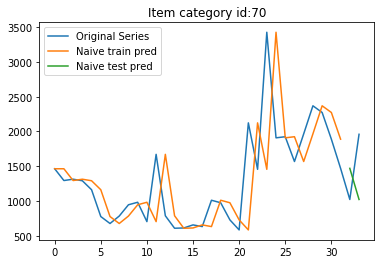

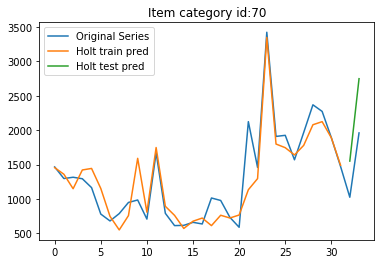

32 70 733.4524524466464 670.56865896964


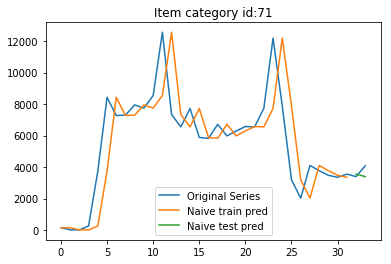

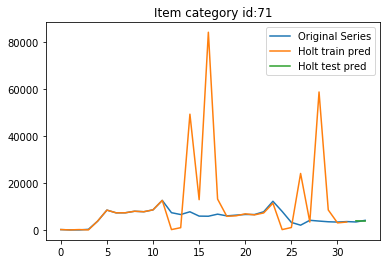

32 71 499.6323648443924 403.0600619584699


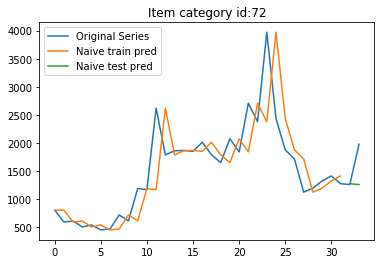

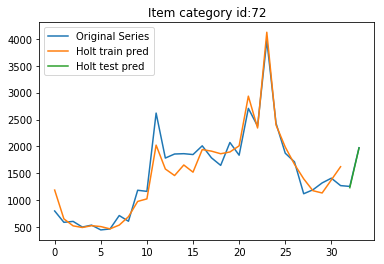

32 72 507.8134499991114 16.62924429057843


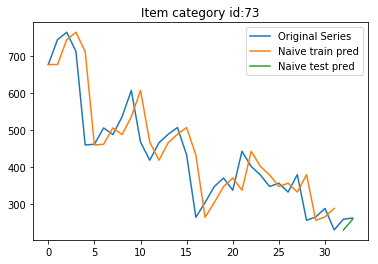

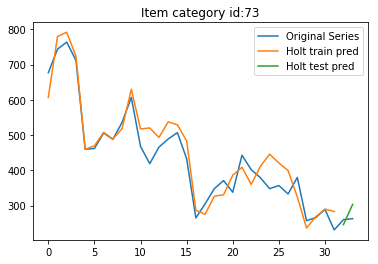

32 73 20.615528128088304 30.357083355209724


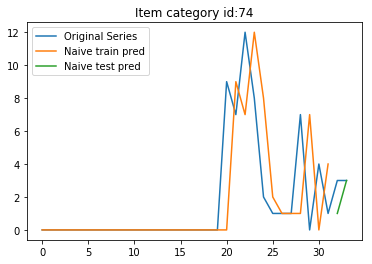

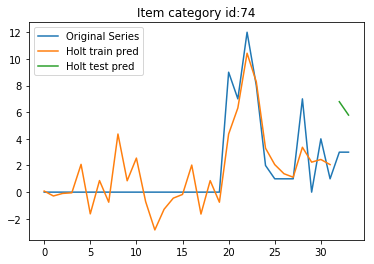

32 74 1.4142135623730951 3.323801220434454


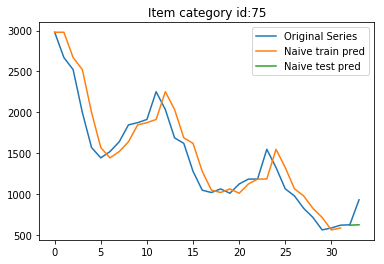

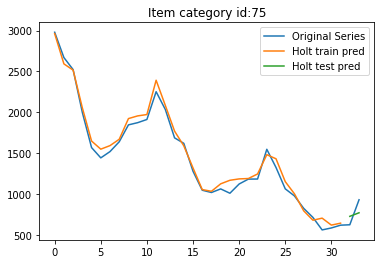

32 75 216.40355819625518 134.15742184082958


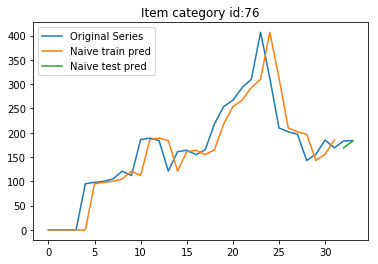

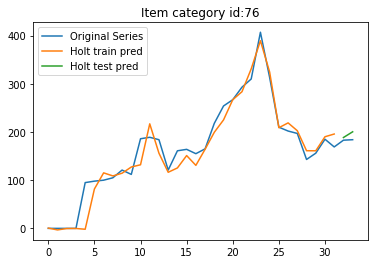

32 76 9.924716620639604 12.2560847218976


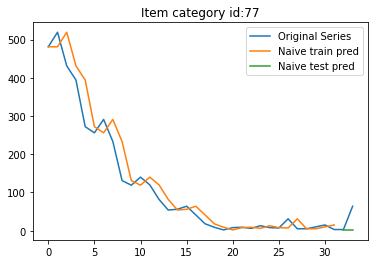

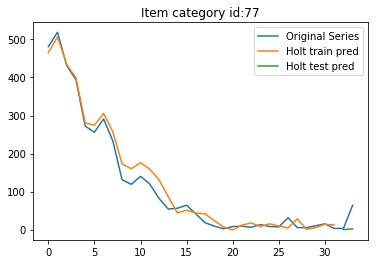

32 77 43.1335136523794 44.03759390764707


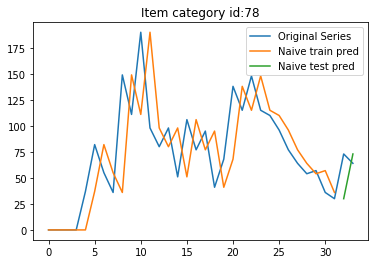

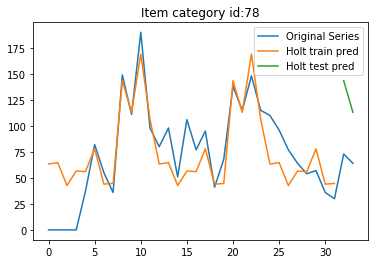

32 78 31.064449134018133 60.70935636373018


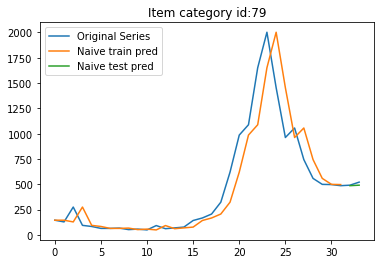

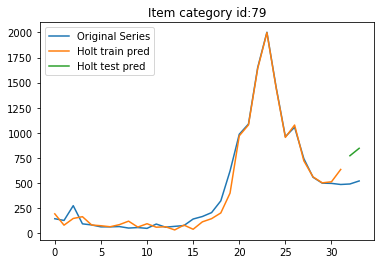

32 79 21.50581316760657 304.0287334525453


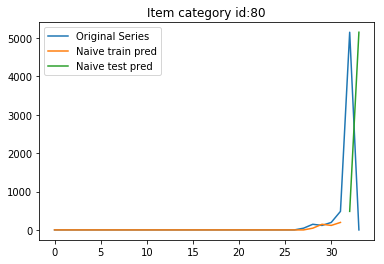

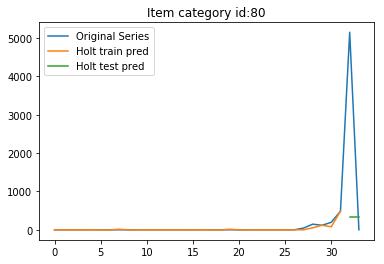

32 80 4913.438561740647 3418.9410921592735


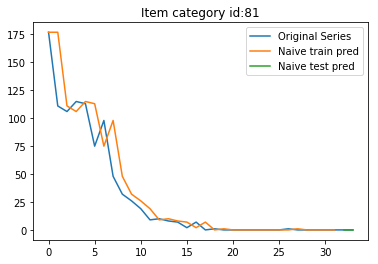

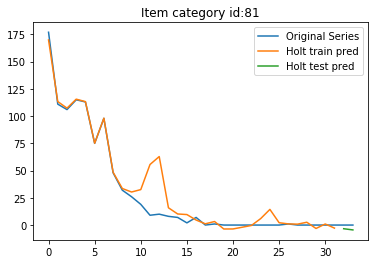

32 81 0.0 3.956574747672288


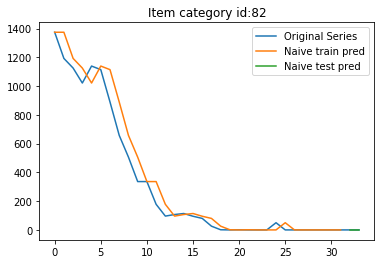

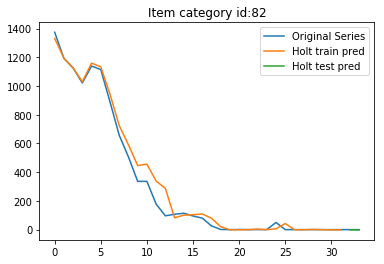

32 82 0.0 1.6122779374687188


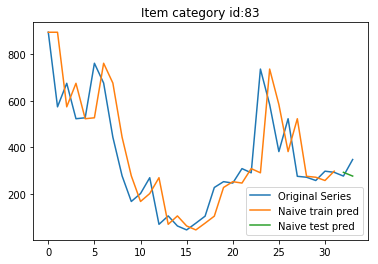

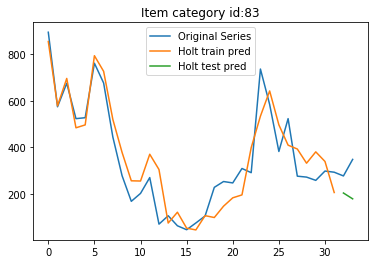

32 83 51.46357935472425 130.50576891717634


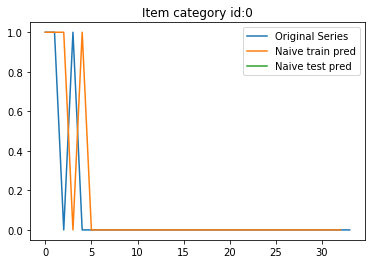

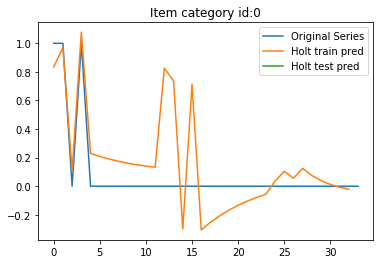

33 0 0.0 0.029348028587762087


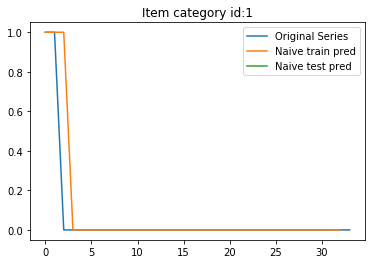

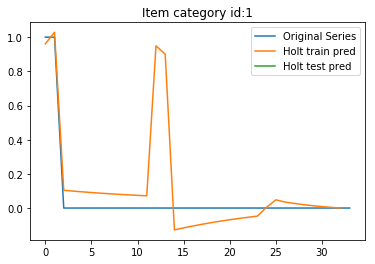

33 1 0.0 0.0030931857733680346


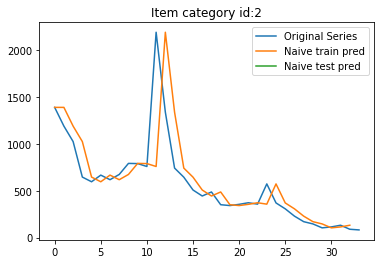

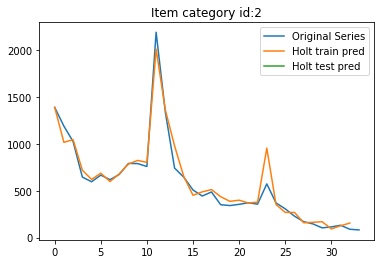

33 2 7.0 10.927232379880351


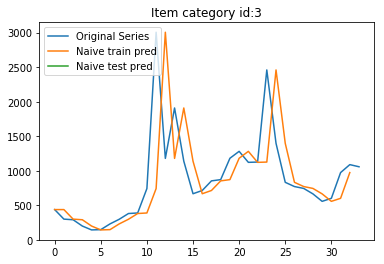

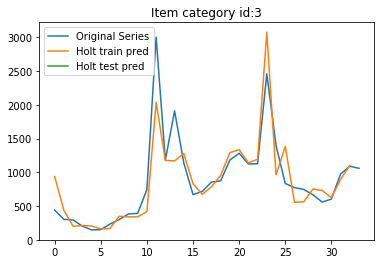

33 3 31.0 89.74206079634246


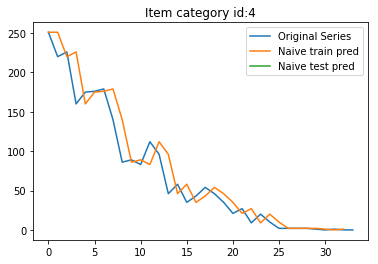

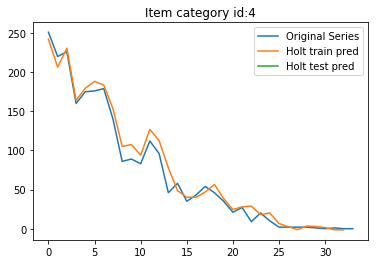

33 4 0.0 2.2412787459802654


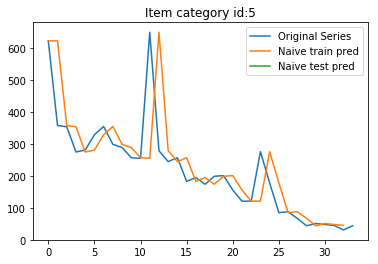

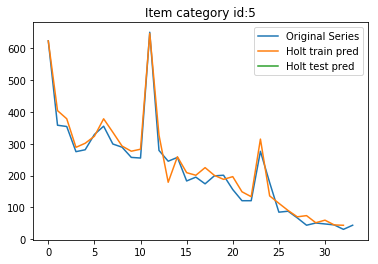

33 5 13.0 14.722272996554288


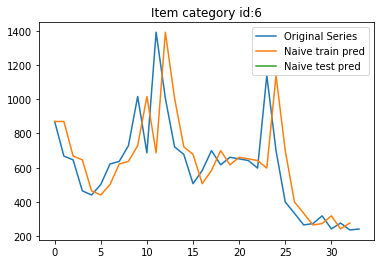

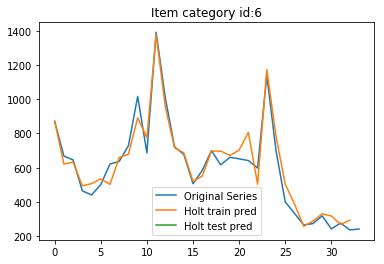

33 6 5.0 56.20642924514908


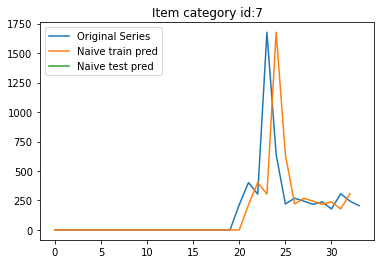

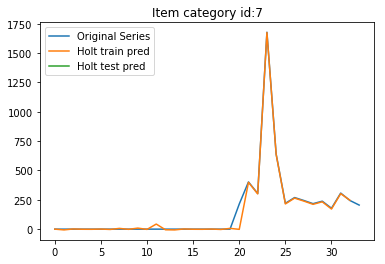

33 7 39.0 268.52735078120315


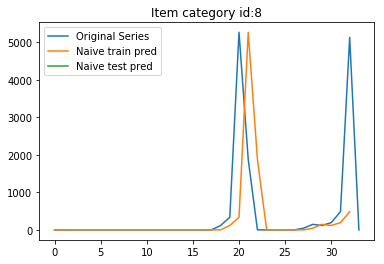

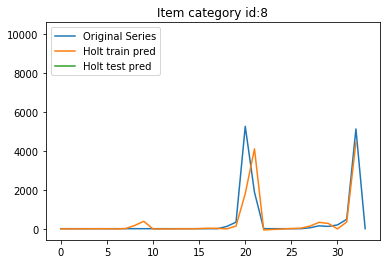

33 8 5129.0 10106.420579054291


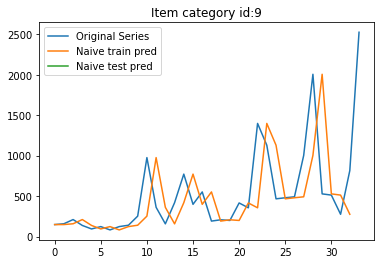

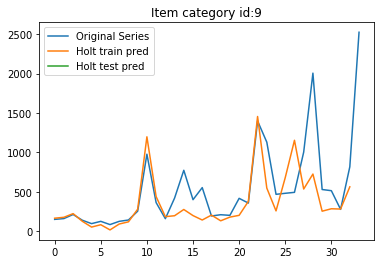

33 9 1708.0 2042.2983218387376


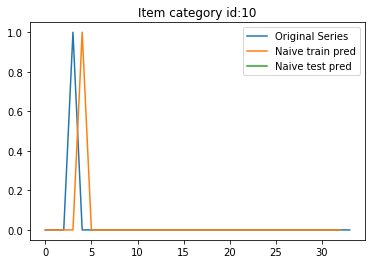

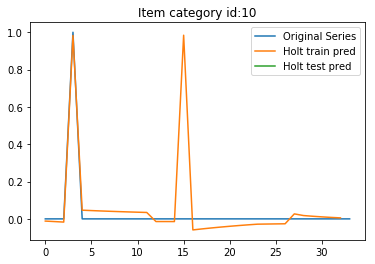

33 10 0.0 0.0031335939587489037


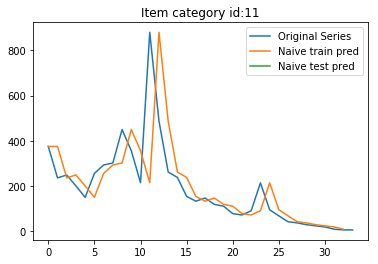

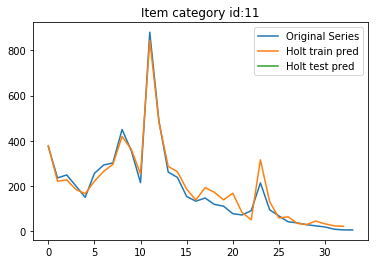

33 11 0.0 0.9072624075746454


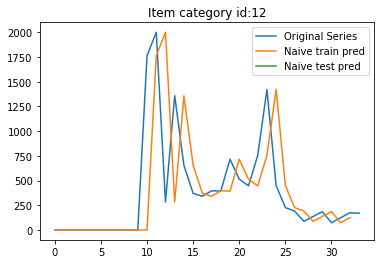

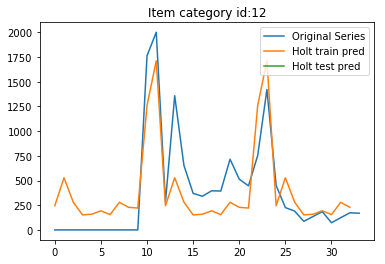

33 12 5.0 52.277791210257135


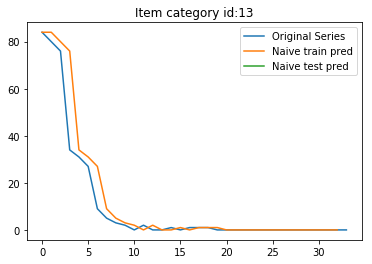

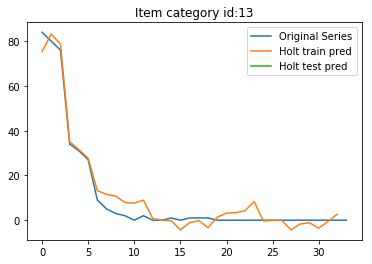

33 13 0.0 3.261305672251039


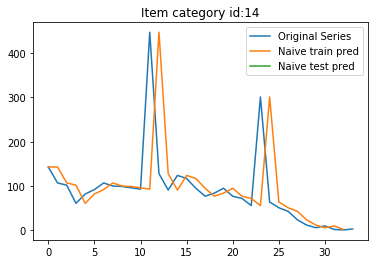

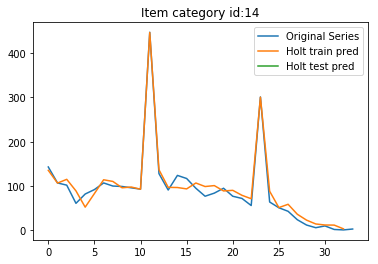

33 14 2.0 1.3742145645274828


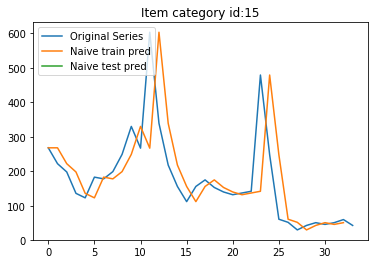

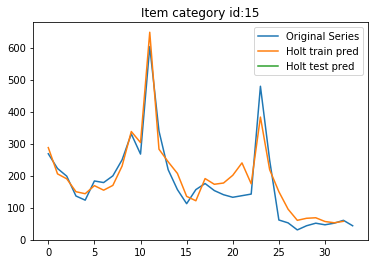

33 15 17.0 29.890225625293766


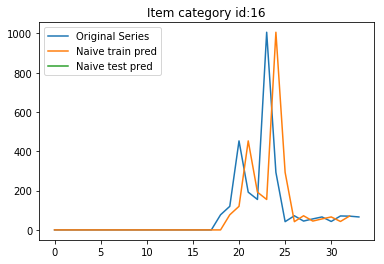

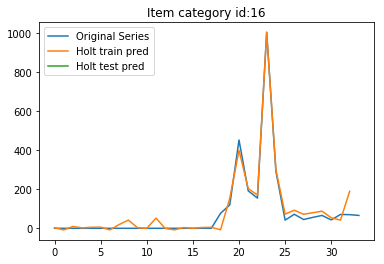

33 16 4.0 13.488285946797589


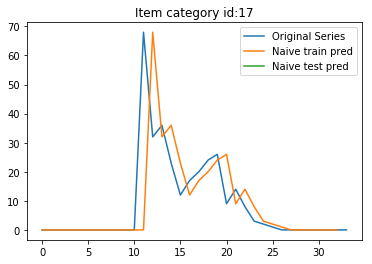

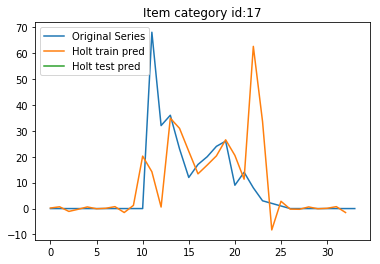

33 17 0.0 1.2274544695763403


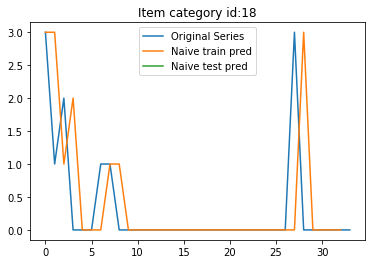

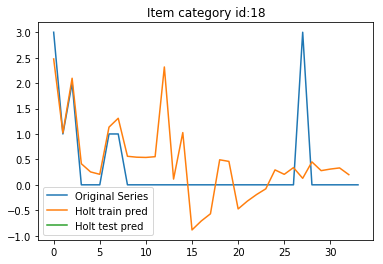

33 18 0.0 0.11372580432672663


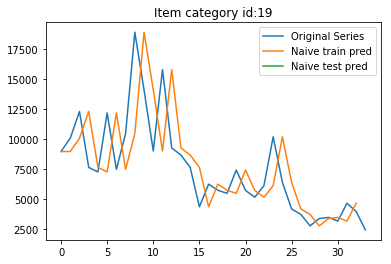

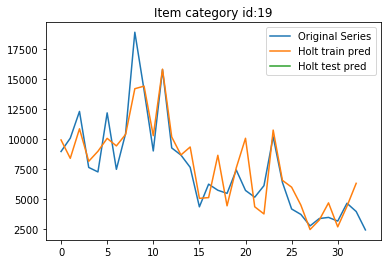

33 19 1536.0 589.2956829553391


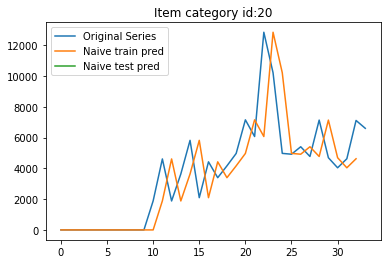

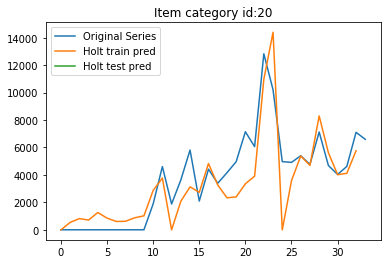

33 20 511.0 119.16851845705423


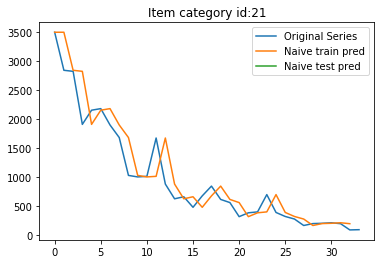

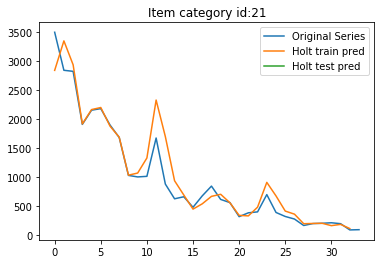

33 21 4.0 6.663563325211101


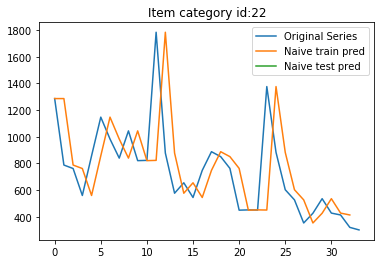

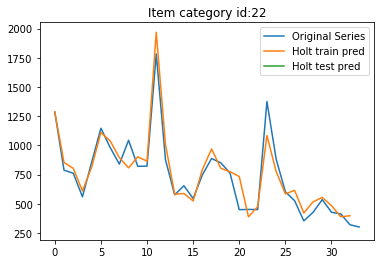

33 22 19.0 25.340368022369034


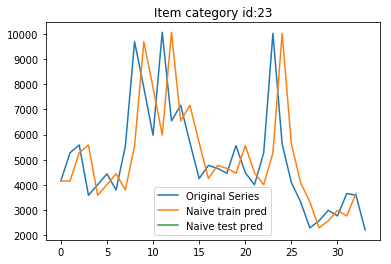

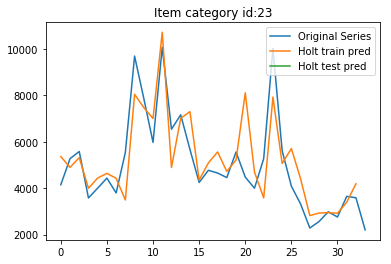

33 23 1387.0 1266.6754730614139


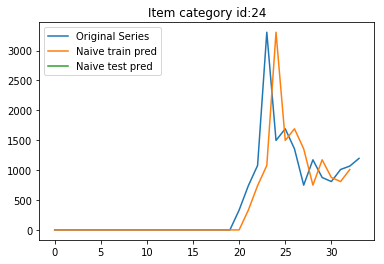

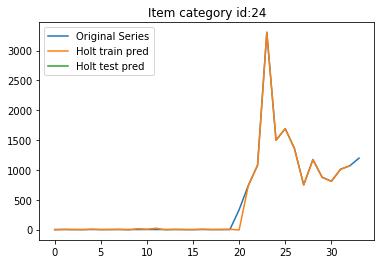

33 24 129.0 441.9953213367569


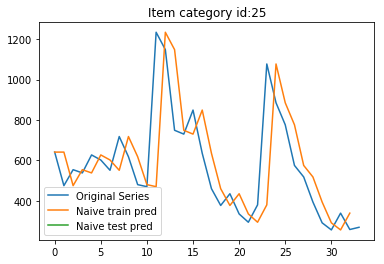

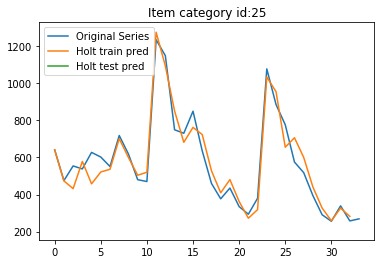

33 25 11.0 59.607412444773445


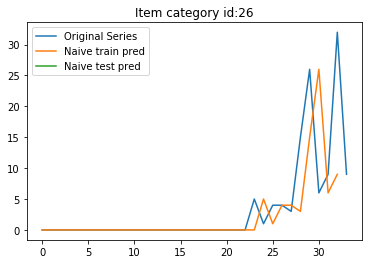

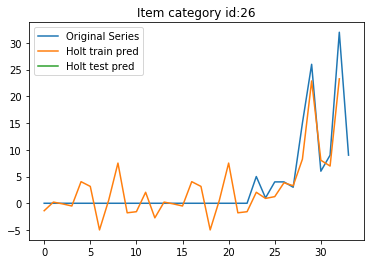

33 26 23.0 15.503992774330072


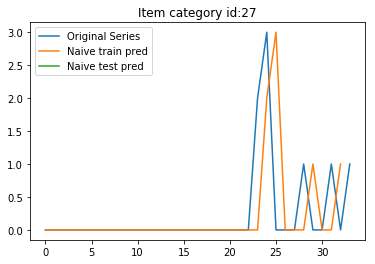

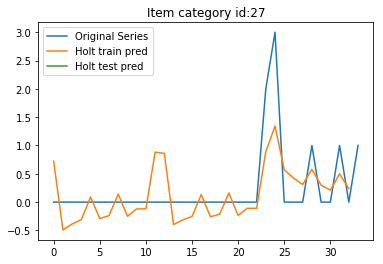

33 27 1.0 0.7432621102057109


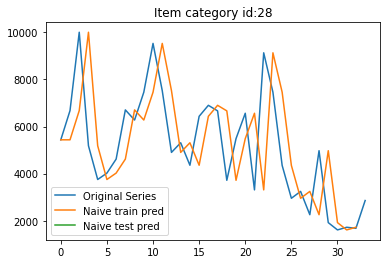

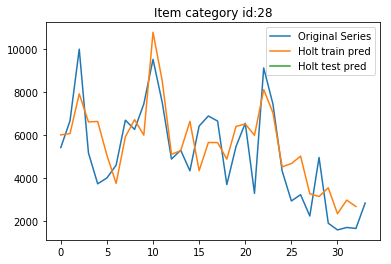

33 28 1180.0 750.5843196557867


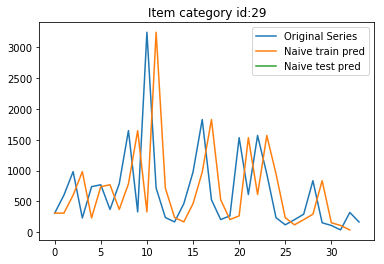

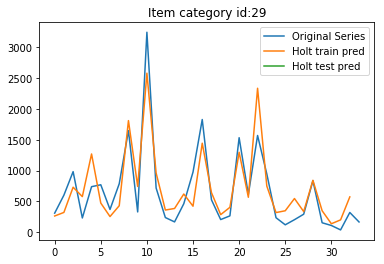

33 29 154.0 44.103405659104396


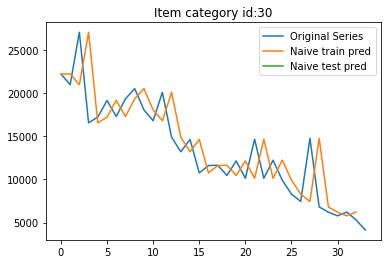

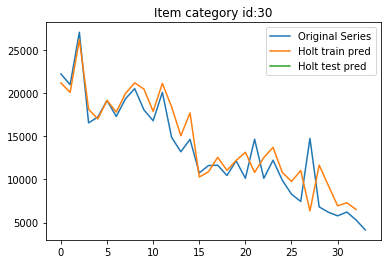

33 30 1153.0 2871.2066064598584


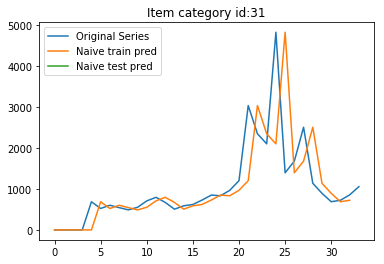

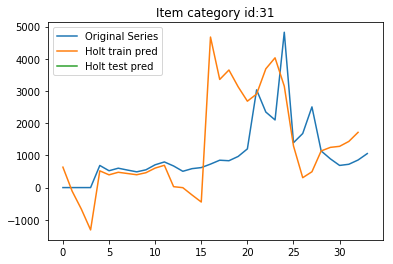

33 31 200.0 3009.2379091192834


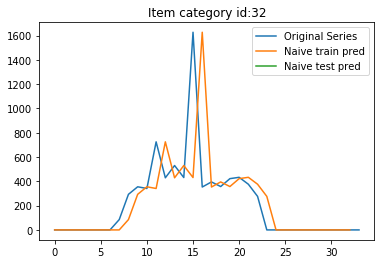

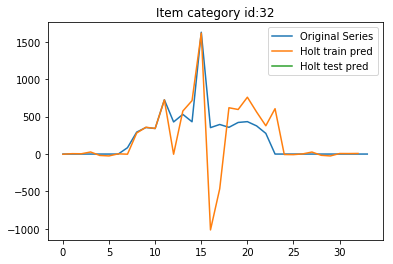

33 32 0.0 3.0839839441850003


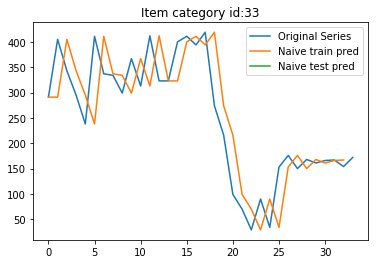

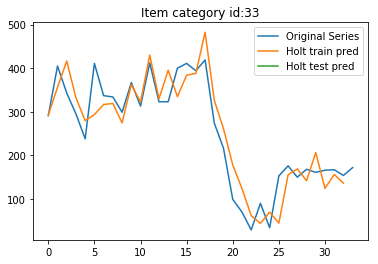

33 33 18.0 15.463552175846871


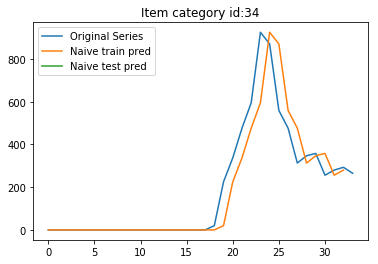

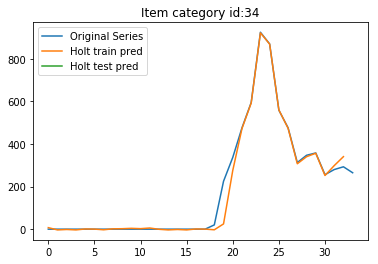

33 34 28.0 146.62693274544682


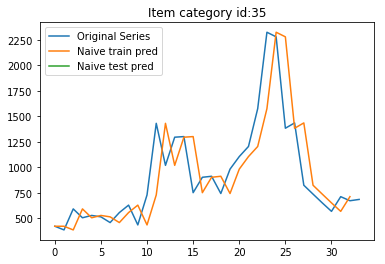

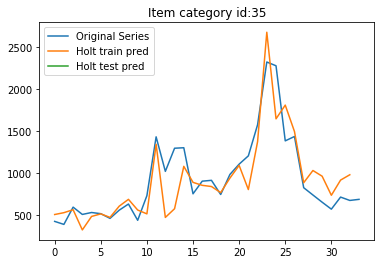

33 35 13.0 240.86549709681367


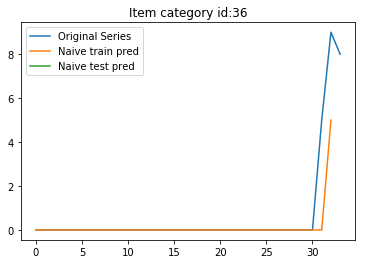

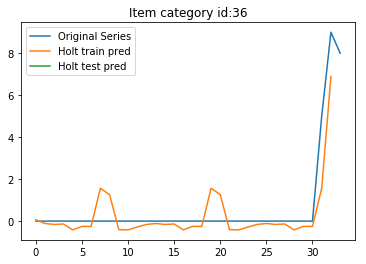

33 36 1.0 0.2260737581019221


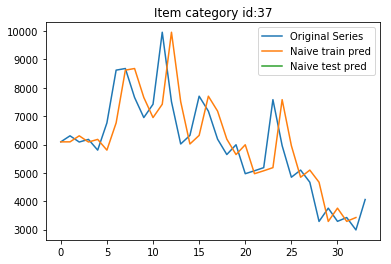

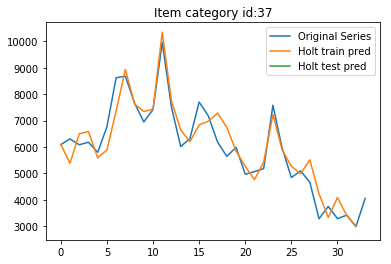

33 37 1072.0 1195.2182647506802


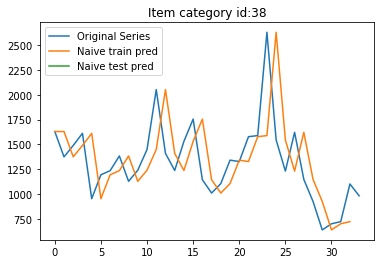

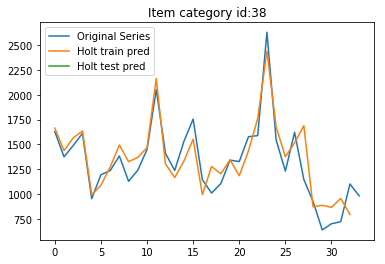

33 38 119.0 83.47033382502264


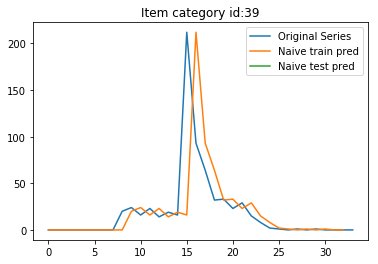

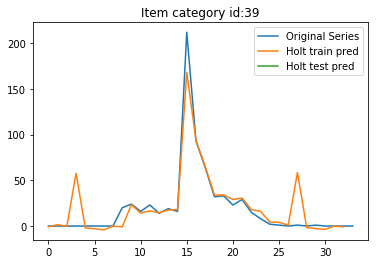

33 39 0.0 1.9264244803748287


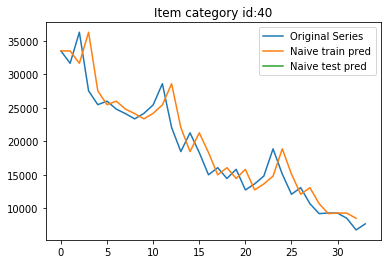

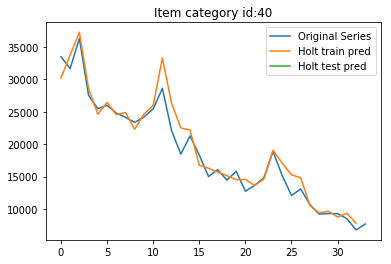

33 40 901.0 329.9674524587381


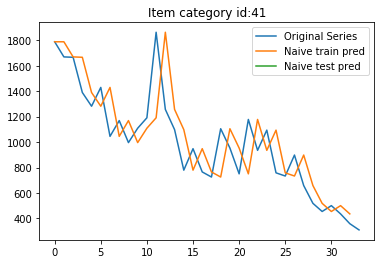

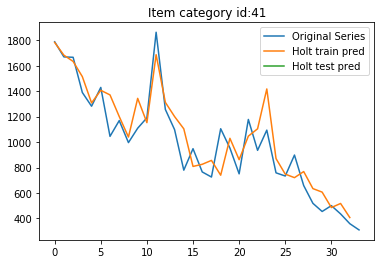

33 41 49.0 190.12883513694572


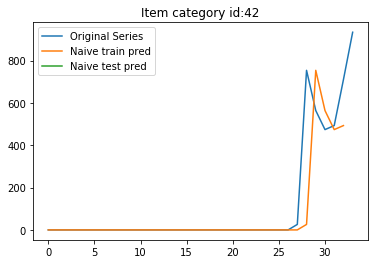

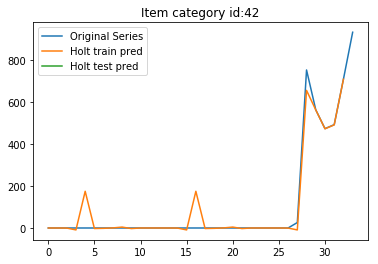

33 42 224.0 417.642002150517


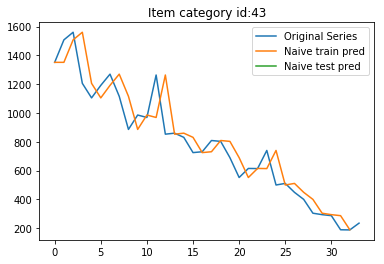

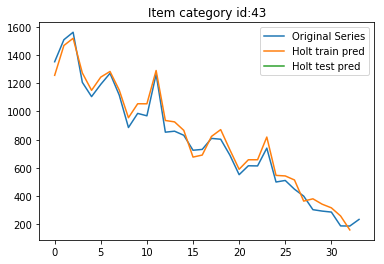

33 43 47.0 9.799633973535919


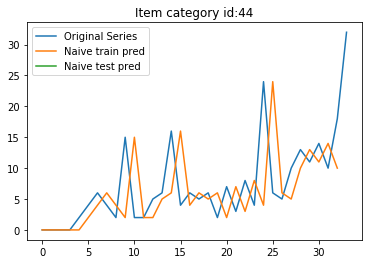

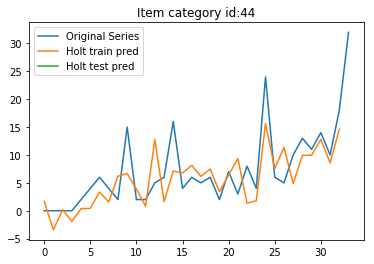

33 44 14.0 11.72026988451498


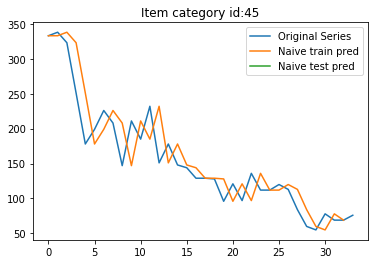

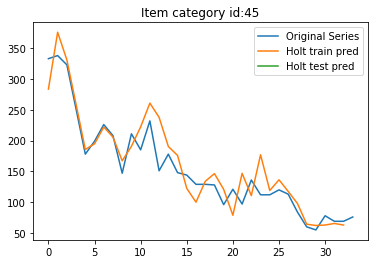

33 45 7.0 3.5313418056498875


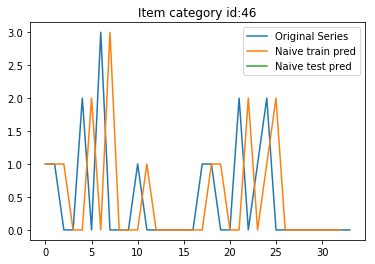

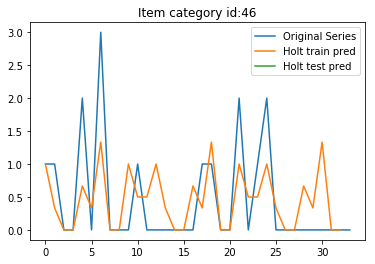

33 46 0.0 1.0000000351037492


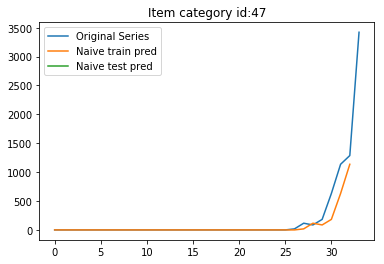

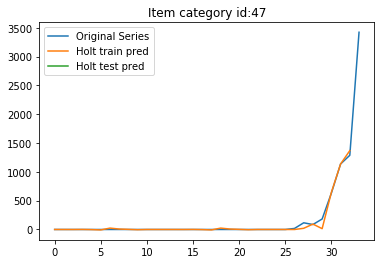

33 47 2134.0 2627.856803764035


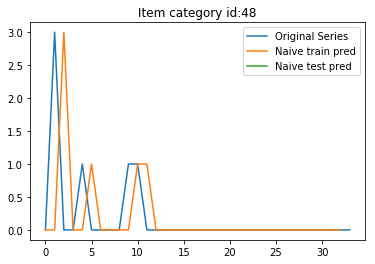

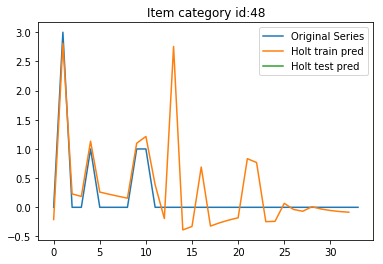

33 48 0.0 0.011455263220307543


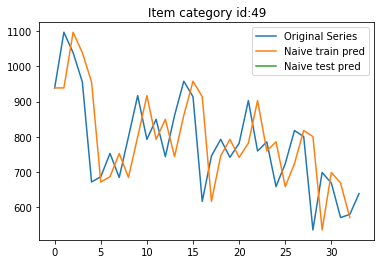

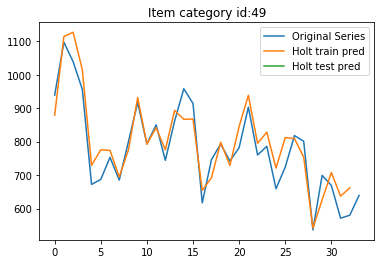

33 49 59.0 89.56227848139758


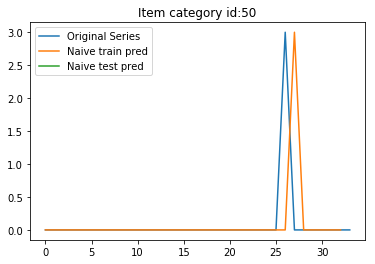

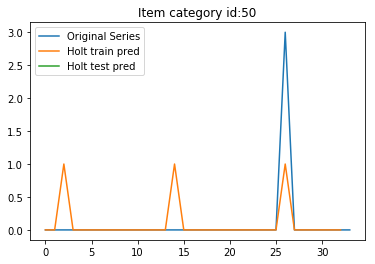

33 50 0.0 7.107524702121282e-08


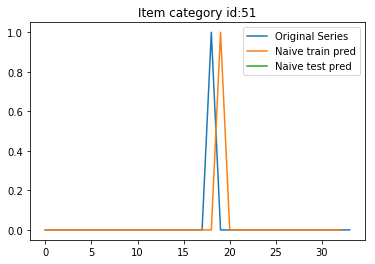

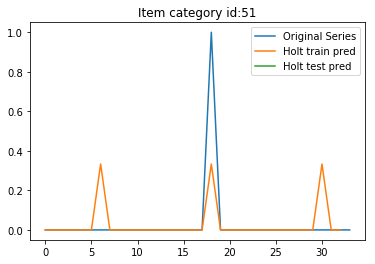

33 51 0.0 1.7604717683639137e-08


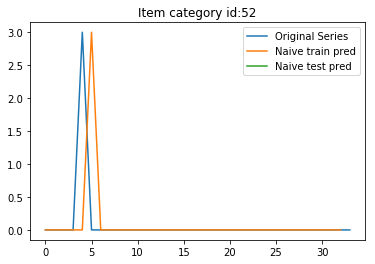

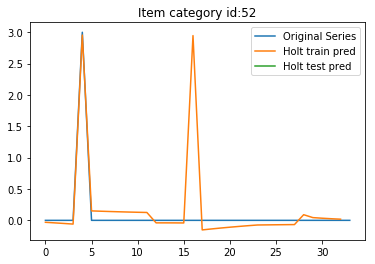

33 52 0.0 0.012248120999185375


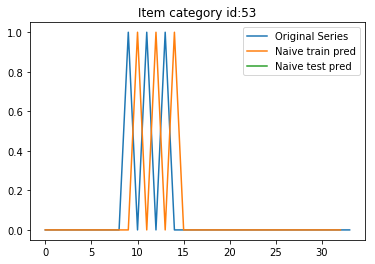

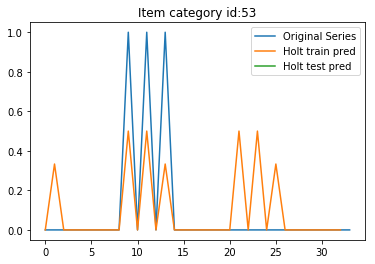

33 53 0.0 0.49999985147783477


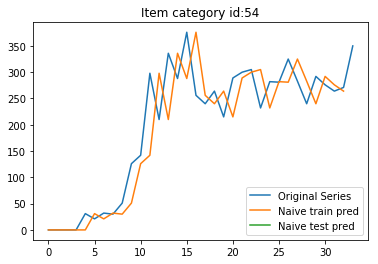

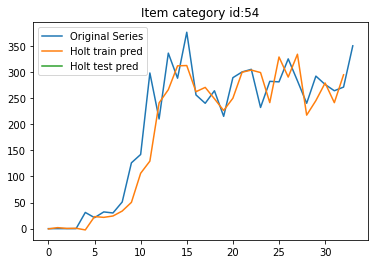

33 54 79.0 50.796063257439414


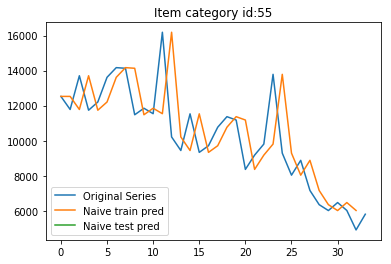

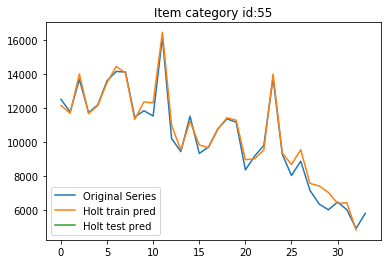

33 55 895.0 511.2328651532225


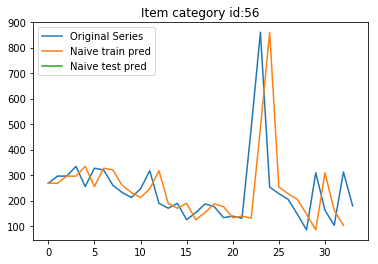

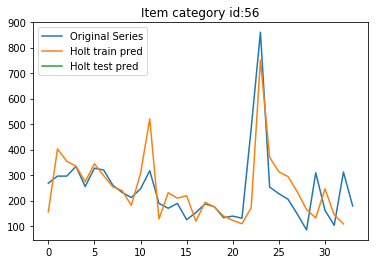

33 56 133.0 35.526130805187194


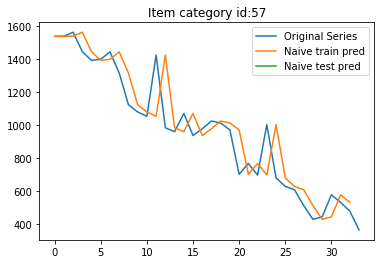

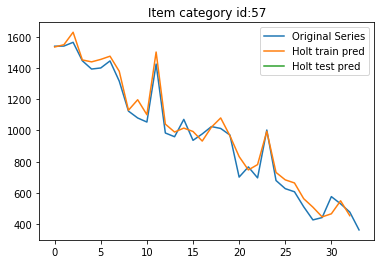

33 57 114.0 145.28274770657129


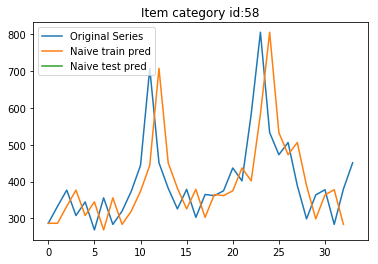

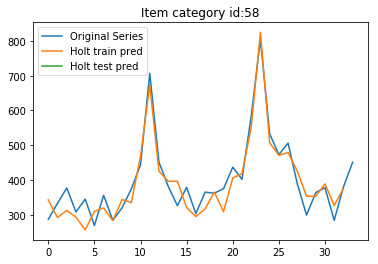

33 58 71.0 72.99852495230874


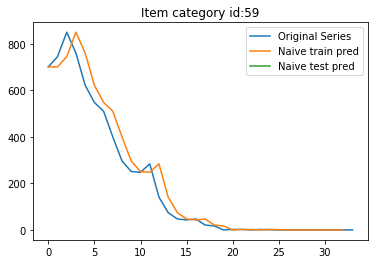

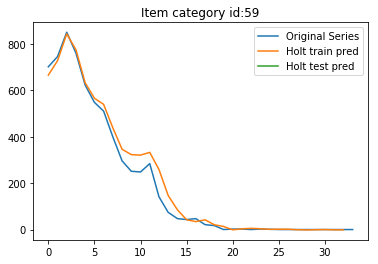

33 59 0.0 0.872819109058268


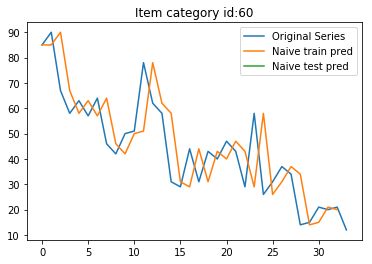

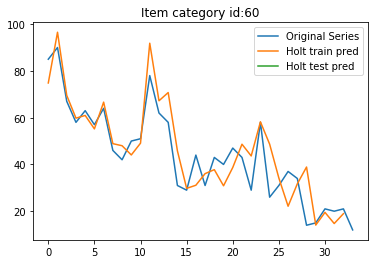

33 60 9.0 8.689177676204345


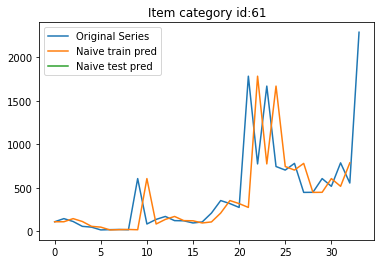

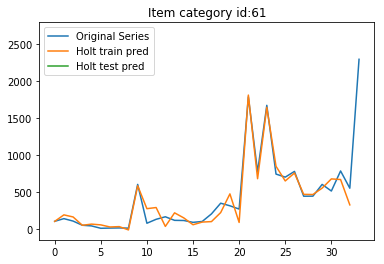

33 61 1736.0 364.32783514782614


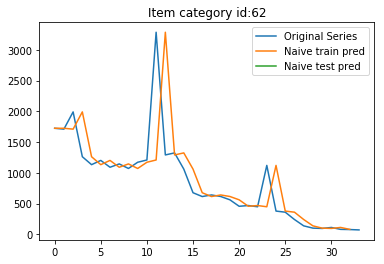

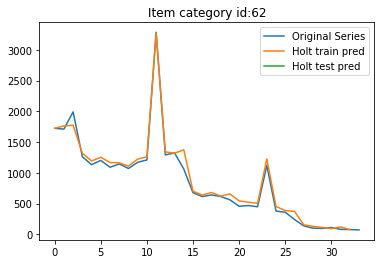

33 62 6.0 18.516147591387707


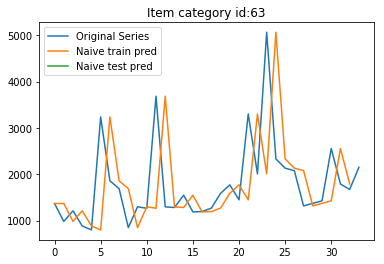

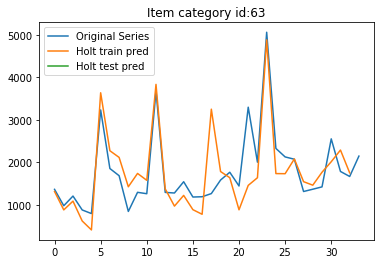

33 63 479.0 1516.1310915683312


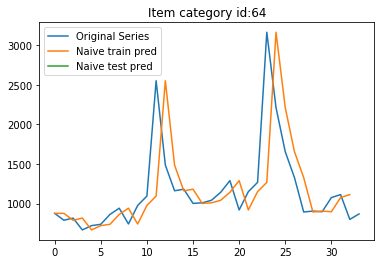

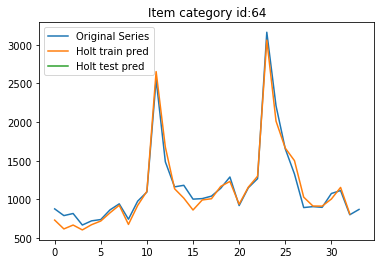

33 64 69.0 140.50500465019547


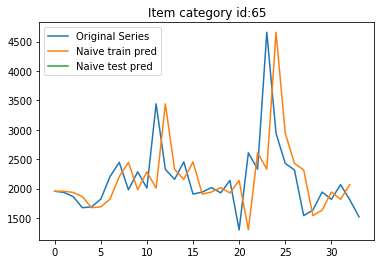

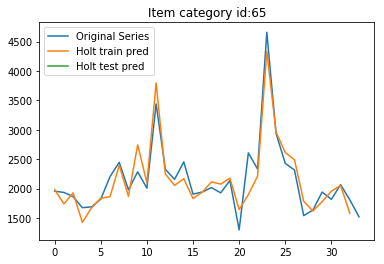

33 65 291.0 961.7251197968039


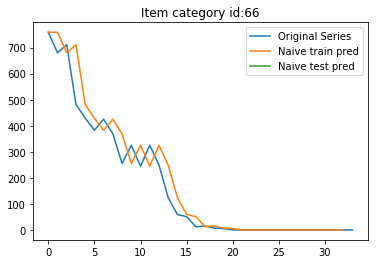

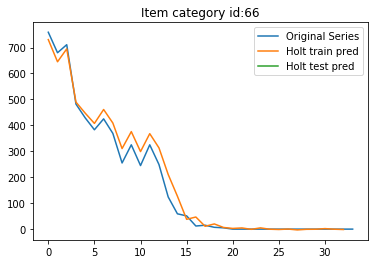

33 66 0.0 4.562337016383157


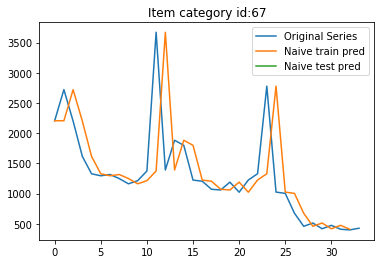

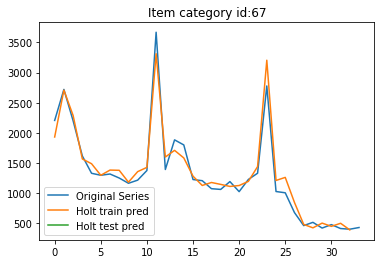

33 67 28.0 39.38511186807341


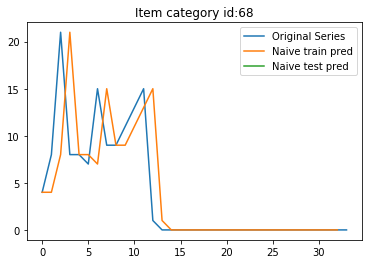

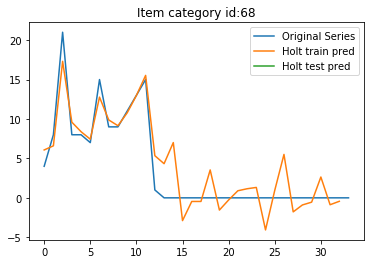

33 68 0.0 0.6076304782513979


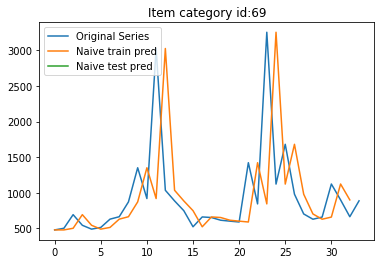

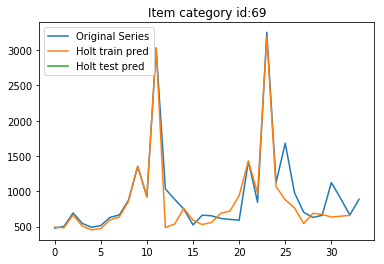

33 69 223.0 687.5094357469841


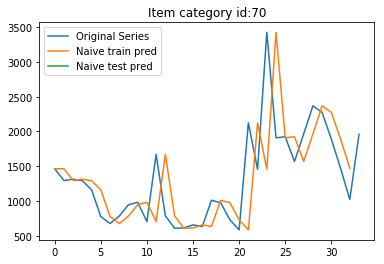

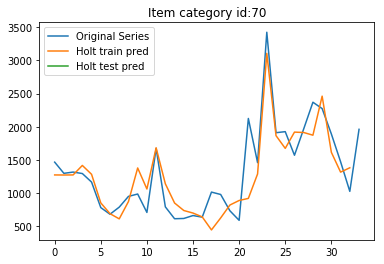

33 70 936.0 1098.9957472825904


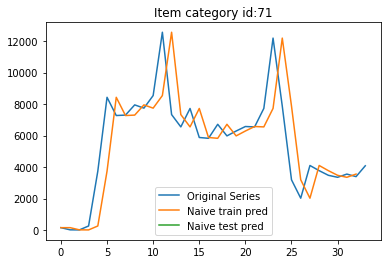

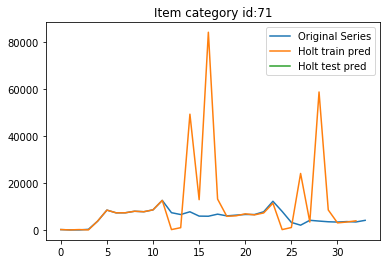

33 71 688.0 776.4726454635579


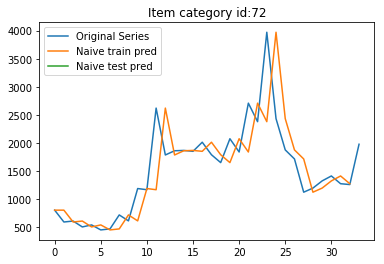

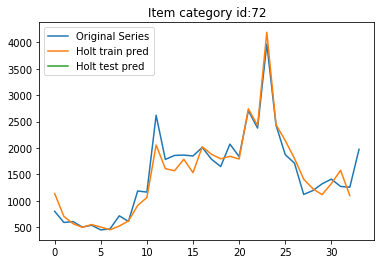

33 72 718.0 98.77221305614694


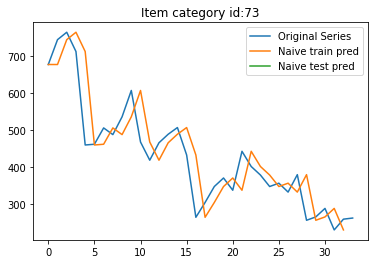

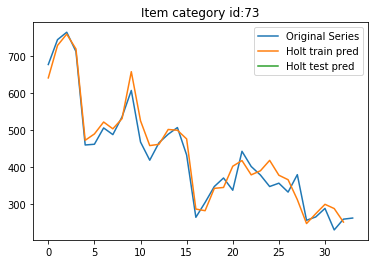

33 73 3.0 59.09537047605255


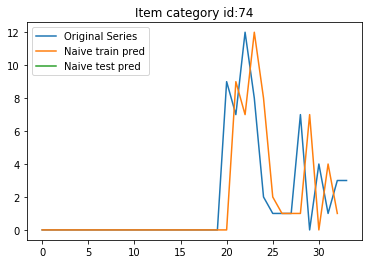

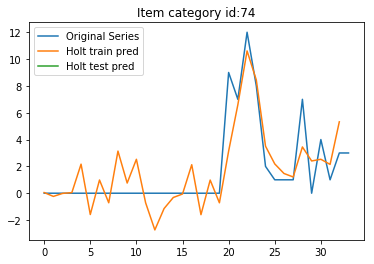

33 74 0.0 0.4141776319093431


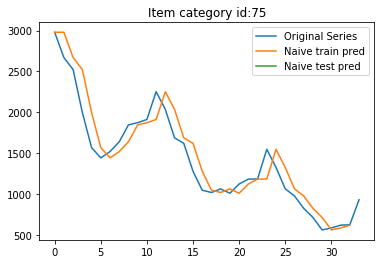

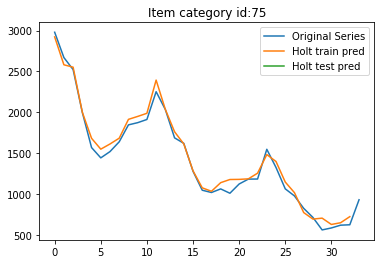

33 75 306.0 270.71886307237025


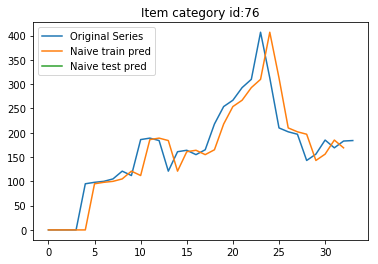

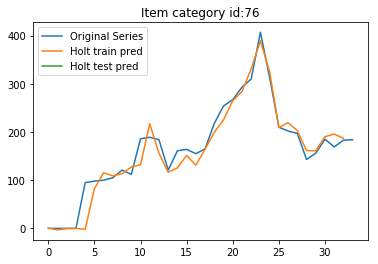

33 76 1.0 11.864087008546306


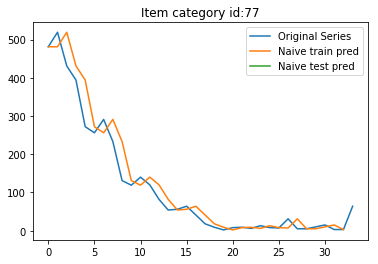

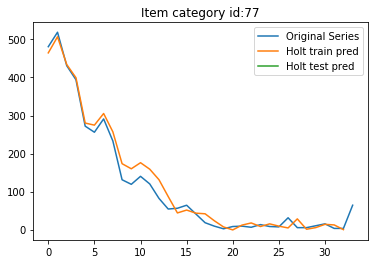

33 77 61.0 58.338567214004925


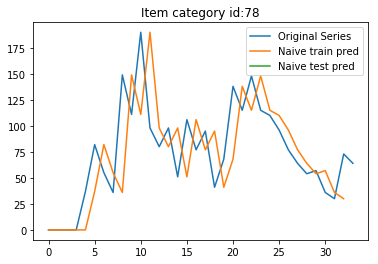

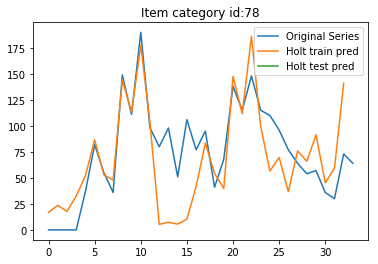

33 78 9.0 49.971886303394214


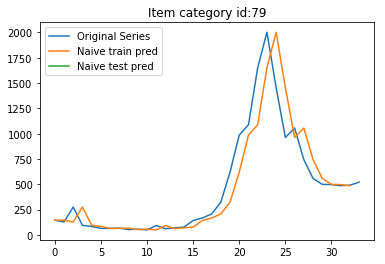

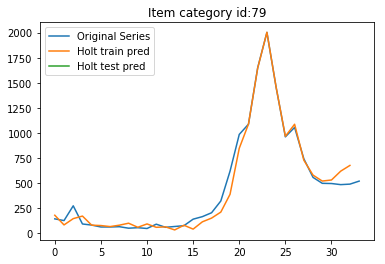

33 79 30.0 36.15941940721257


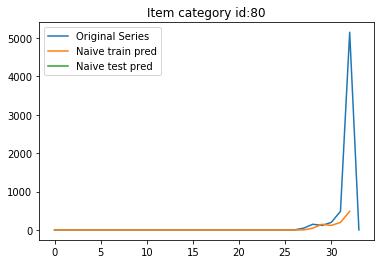

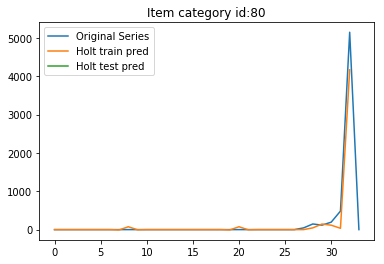

33 80 5149.0 2844.1852291685673


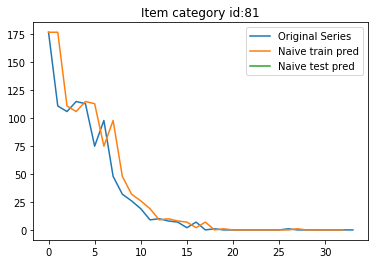

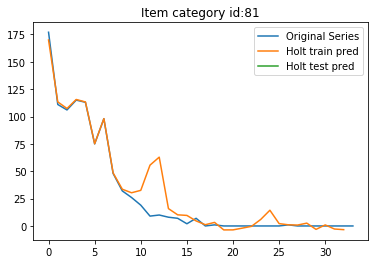

33 81 0.0 2.68512970236218


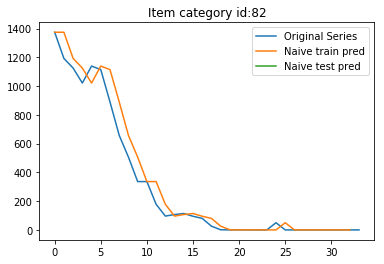

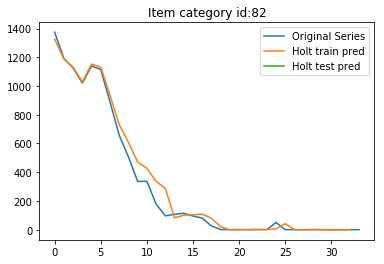

33 82 0.0 0.6915807455424368


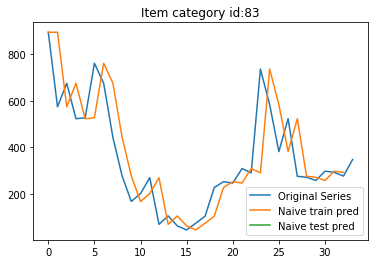

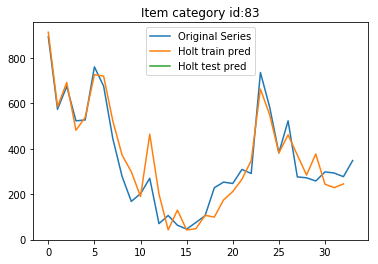

33 83 71.0 50.16981271131897


In [392]:
#this function receive the object sales_by_cat
sales_by_cat = sales_extd.pivot_table(index=['item_category_id'], values = ['item_cnt_day'], columns=['date_block_num'], 
                     aggfunc = np.sum, fill_value = 0 ).reset_index()
sales_by_cat.columns = sales_by_cat.columns.droplevel().map(str)
sales_by_cat = sales_by_cat.reset_index(drop=True).rename_axis(None, axis=1)
sales_by_cat.columns.values[0]= 'item_category_id'

list_of_catid = []
list_of_ntrain = []
list_of_naive_error = []
list_of_holt_error = []

for ntrain in range(24,34,1):
    for cat_id in sales_by_cat['item_category_id']:
     
        naive_error = Multiple_Model_Prediction(sales_by_cat, cat_id, ntrain, 0)
        holt_error = Multiple_Model_Prediction(sales_by_cat, cat_id, ntrain, 1)

        print(ntrain, cat_id, naive_error, holt_error)
            
        list_of_catid.append(cat_id)
        list_of_ntrain.append(ntrain)
        list_of_naive_error.append(naive_error)
        list_of_holt_error.append(holt_error)   

In [393]:
#check df       
model_checks = pd.DataFrame({"item_category_id":list_of_catid,"train_sample":list_of_ntrain,
                         "naive_error":list_of_naive_error,
                         "holt_error":list_of_holt_error},
                          columns=["item_category_id","train_sample","naive_error","holt_error"]) 

In [394]:
model_checks

,item_category_id,train_sample,naive_error,holt_error
0,0,24,0.000000,0.183007
1,1,24,0.000000,0.346358
2,2,24,77.074639,63.167301
3,3,24,402.576452,630.951329
4,4,24,4.098780,11.113022
5,5,24,44.344109,44.028160
6,6,24,173.881281,291.492601
7,7,24,358.180401,748.615061
8,8,24,2190.567757,1548.711752
9,9,24,845.604458,821.396801


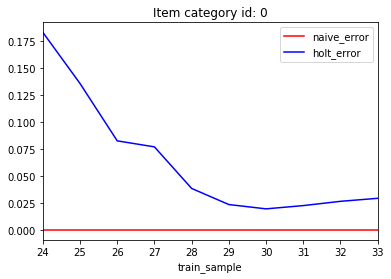

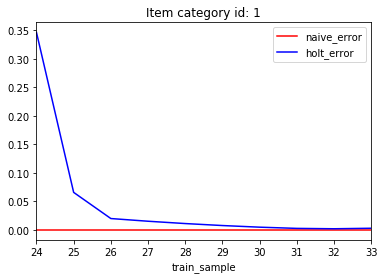

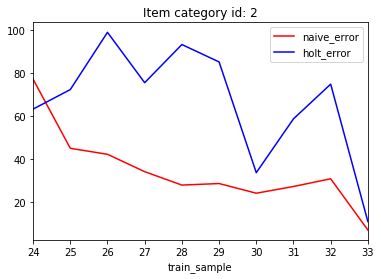

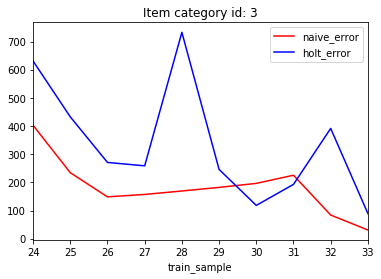

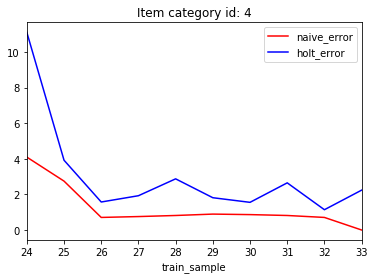

...

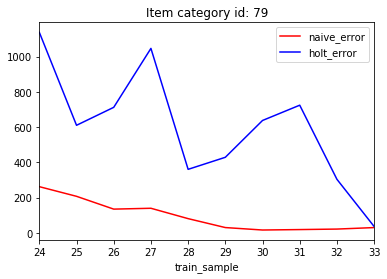

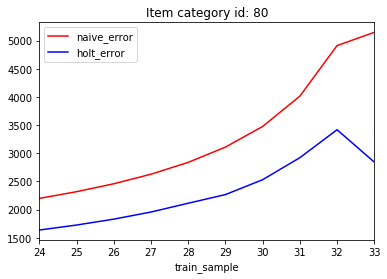

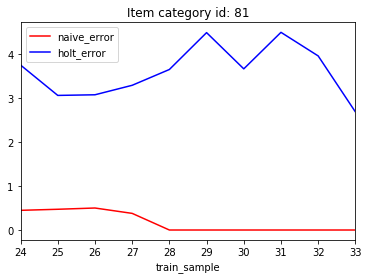

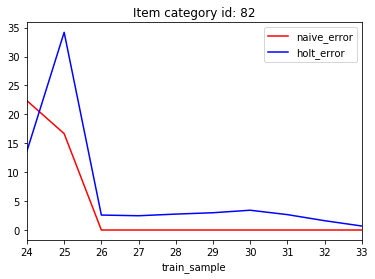

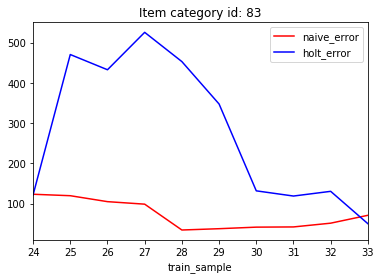

In [395]:
for cat_id in sales_by_cat['item_category_id']:
    cat_summary = model_checks[(model_checks.item_category_id == cat_id)].drop(['item_category_id'],axis=1)
    ax = plt.gca()
    cat_summary.plot(kind='line',x='train_sample',y='naive_error',color='red', ax=ax)
    cat_summary.plot(kind='line',x='train_sample',y='holt_error',color='blue', ax=ax)
    
    plt.title('Item category id: ' + str(cat_id))
    plt.show()

In [399]:
model_eval_summary = model_checks.groupby('item_category_id').mean()
model_eval_summary

,train_sample,naive_error,holt_error
item_category_id,,,
0,28.5,0.000000,0.063831
1,28.5,0.000000,0.047998
2,28.5,34.389261,66.585032
3,28.5,183.213164,336.530174
4,28.5,1.241111,3.081979
5,28.5,17.462088,29.237565
6,28.5,57.881367,147.196036
7,28.5,102.994838,800.906646
8,28.5,3297.618175,3040.911928


In [403]:
#df['color'] = np.where(df['Set']=='Z', 'green', 'red')
model_eval_summary['model'] = np.where(model_eval_summary['naive_error'] < model_eval_summary['holt_error'],0,1)

In [404]:
model_eval_summary

,train_sample,naive_error,holt_error,model
item_category_id,,,,
0,28.5,0.000000,0.063831,0
1,28.5,0.000000,0.047998,0
2,28.5,34.389261,66.585032,0
3,28.5,183.213164,336.530174,0
4,28.5,1.241111,3.081979,0
5,28.5,17.462088,29.237565,0
6,28.5,57.881367,147.196036,0
7,28.5,102.994838,800.906646,0
8,28.5,3297.618175,3040.911928,1
